In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import glob
from pathlib import Path
from scipy import stats
from matplotlib import colors
from matplotlib.colors import DivergingNorm

import seaborn as sns
import scipy as sp
from sklearn import metrics
from collections import Counter
os.getcwd()
## navigate to /udd/redmo
os.chdir('../..')

# os.chdir('../proj/regeps/regep00/')#studies/LTRC/data/epigenetic/methylation/TopMed/data/tests/rejpz/LEVEL4')
# os.chdir("../../../../proj/regeps/regep00/studies/COPDGene/analyses/rebdh/ltrc/")

os.getcwd()

'/udd/redmo'

In [6]:

trace='data/MotifPipeline/sthlm_motif_0_QCbeta/A549_CTCF'
data=pd.read_csv(trace,sep='\t',usecols=[0,1,2,3,4,5,6,7,8,9,10,11,15,16],names=["chr", "start", "end",'weight','pval','chr1','st1','end1',"hits1",'W1','array','region','ChIPTF','gene'])
Col1=os.path.basename(trace).split('_')[0] #cell
Col2=os.path.basename(trace).split('_')[1] #TF
data=data.fillna(0)
data.ChIPTF=data.ChIPTF.replace('.',0)
data.ChIPTF[(data.ChIPTF==Col2)]=1
data=data[(data.ChIPTF==0)|(data.ChIPTF==1)]
data.ChIPTF=pd.to_numeric(data.ChIPTF)
data.weight=(data.weight-data.weight.min())/(data.weight.max()-data.weight.min())

# #     data=data[data.ChIPTF!='.']

data['wgbs']=data.W1/100
data.wgbs=1-data.wgbs
data.array=1-data.array
# data['st1']=data['st1']+5
# data['end1']=data['end1']-5
chr=10
data=data[data['chr']=='chr'+str(chr)]
data=data[(data['start']>400000)&(data['end']<4500000)]
# data


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


Text(0.5, 0, 'genome location (x10,000,000) on chr10 of CTCF in A549')

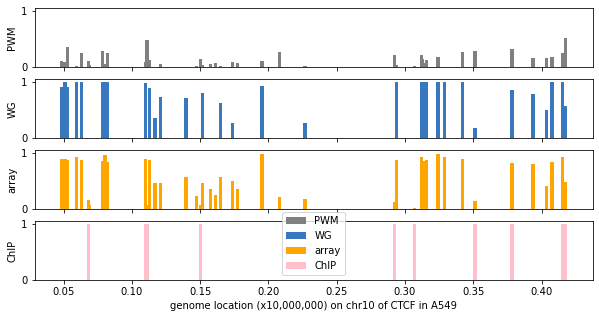

In [7]:
cdict={'GM12878':'red','K-562':'blue','A-549':'green',
       'Hep-G2':'orange','HeLa-S3':'yellow','SK-N-SH':'pink'}
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, sharex=True, sharey=True,figsize=(10,5))
x=(data.start)/10000000

binwidth = 0.0025

l1=ax1.bar(x,data.weight, width=binwidth,label='PWM',color='grey')
l2=ax2.bar(x,1-data.wgbs, width=binwidth,label='WG',color=sns.xkcd_rgb["windows blue"])
l3=ax3.bar(x,1-data.array, width=binwidth,label='array',color='orange')
l4=ax4.bar(x,data.ChIPTF, width=binwidth,label='ChIP',color='pink')
plt.legend([l1, l2, l3, l4],["PWM", "WG", "array","ChIP"])
ax1.set_ylabel('PWM')
ax2.set_ylabel('WG')
ax3.set_ylabel('array')
ax4.set_ylabel('ChIP')
ax4.set_xlabel('genome location (x10,000,000) on chr'+str(chr)+" of CTCF in A549")
# plt.savefig("Desktop/"+Col1+'_'+Col2+"_chr"+str(chr)+"of CTCF in A549.png",dpi=300,bbox_inches = "tight")

#     axs.legend(ncol=3,loc=8)

## process various different window buffers

In [91]:

import glob, os
import numpy as np
from matplotlib import colors as mcolors
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from pathlib import Path
import warnings
from sklearn import metrics

warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
# import matplotlib.backends.backend_pdf

# agg_meth='median'
# buffer='500' -- inherited from outdir

def buffer_distr_comp(agg_meth='mean',outdir='data/MotifPipeline/sthlm_motif_50_QCbeta/red/'):
    i=0
    traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/*')
    traces = list(filter(lambda file: os.stat(file).st_size > 0, traces))
    buffer=outdir.split('/')[2]
    buffer=buffer.split('_')[2]
    pwm_sp=[]
    wg_sp=[]
    me_sp=[]
    Path(outdir+'/'+agg_meth).mkdir(parents=True, exist_ok=True)
    # indices = [i for i, s in enumerate(traces) if 'sthml_auroc_meltbox' in s]
    for trace in (traces):

        try:
            data=pd.read_csv(trace,sep='\t',usecols=[0,1,2,3,4,8,9,10,11,15,16],
                             names=["chr", "start", "end",'weight','pval',"hits1",'W1','array','region','gene','ChIPTF'],engine='python')
            data.weight=(data.weight-data.weight.min())/(data.weight.max()-data.weight.min())
            data['wgbs']=data.W1/100
            data.wgbs=1-data.wgbs
            data.array=1-data.array
            # print(data)

            trace2=os.path.basename(trace)#.split('/')[4]
        
            com_data=pd.read_csv(outdir+'/'+trace2,sep='\t',usecols=[0,1,2,3,4,8,9,10,11,15,16],
                                 names=["chr", "start", "end",'weight','pval',"hits1",'W1','array','region','gene','ChIPTF'],engine='python')
            com_data.weight=(data.weight-data.weight.min())/(data.weight.max()-data.weight.min())
            com_data['wgbs']=com_data.W1/100
            com_data.wgbs=1-com_data.wgbs
            com_data.array=1-com_data.array
#         print(com_data)
        
            cell=os.path.basename(trace).split('_')[0]
            TF=os.path.basename(trace).split('_')[1]
            data = data.groupby([data.chr,data.start,data.end]).agg({'weight':agg_meth,"wgbs":agg_meth,"ChIPTF":'max',"array":agg_meth,'hits1':'mean','W1':'mean'})
            com_data = com_data.groupby([com_data.chr,com_data.start,com_data.end]).agg({'weight':agg_meth,"wgbs":agg_meth,"ChIPTF":'max',"array":agg_meth,'hits1':'mean','W1':'mean'})

            data2=data.merge(com_data,on=['chr','start','end'])
            pwm=(sp.stats.spearmanr(data2.weight_x,data2.weight_y)[0])
            wg=(sp.stats.spearmanr(data2.wgbs_x,data2.wgbs_y)[0])
            me=(sp.stats.spearmanr(data2.array_x,data2.array_y)[0])
            i=i+1
            column= pwm,wg,me
#             print(pwm_sp,wg_sp,me_sp)
            np.transpose(pd.DataFrame((column))).to_csv(outdir+'/'+agg_meth+'/'+buffer+'_'+agg_meth+'_sthlm_distr_comp.txt',mode='a',index=False,header=False)
#             print('running distribution comparison between 0 and '+buffer+' for '+TF+' in '+cell)
        #         return pwm_sp
            pwm_sp.append(pwm)
            wg_sp.append(wg)
            me_sp.append(me)
            column= pwm_sp,wg_sp,me_sp
        except:
            pass
            print('missing data for taking '+agg_meth+' of '+TF+' in '+cell)
    return column

In [ ]:
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_5_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_5_QCbeta/red/')
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_50_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_50_QCbeta/red/')
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_10_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_10_QCbeta/red/')
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_20_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_20_QCbeta/red/')
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_100_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_100_QCbeta/red/')
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_250_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_250_QCbeta/red/')
ww=buffer_distr_comp('mean','data/MotifPipeline/sthlm_motif_500_QCbeta/red/')
cc=buffer_distr_comp('median','data/MotifPipeline/sthlm_motif_500_QCbeta/red/')

## plot various different window buffers

In [ ]:
allbox = pd.DataFrame()
agg_meth='mean'
method='auroc'
traces= glob.glob('data/MotifPipeline/**/red/test/'+agg_meth+'/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_'+method+'_meltbox' in s]
for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
#     print(buffer)
    meltbox=pd.read_csv(trace,sep='\t',index_col=0)
    meltbox['buffer']=buffer
    allbox=pd.concat([allbox,meltbox],axis=0)
#     allbox
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
allbox['data_buff']=allbox['data']+'_'+allbox['buffer'].astype(str)
from pathlib import Path
outdir='data/MotifPipeline/compare'
Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
# col_list = [A549]
cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
# for cell in cells:
for test in tests:
    allbox2=allbox[allbox['data_buff'].str.contains(pat=test)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
    allbox2.buffer=(allbox2.buffer).astype(int)
    allbox2=allbox2.sort_values(by='buffer')
    ##limit TF to those found with no buffer
#         TFF=allbox2[allbox2.buffer==0]
#         allbox2=allbox2[allbox2.TF.isin(TFF.TF)]

    g=sns.boxplot(x='buffer',y='AUROC', data=allbox2)
    g=sns.swarmplot(x='buffer',y='AUROC', data=allbox2,size=2, color=".3", linewidth=0)
    g.set(ylim=(0, 1))
    g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
    g=plt.title(test)

    plt.savefig(outdir+"/sthlm_allCell"+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
    plt.show()
    plt.close()

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5208: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


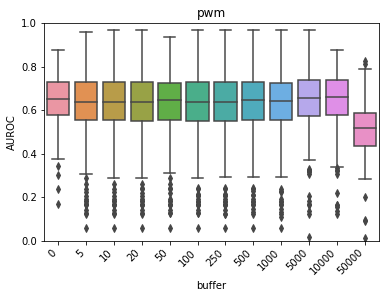

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5208: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


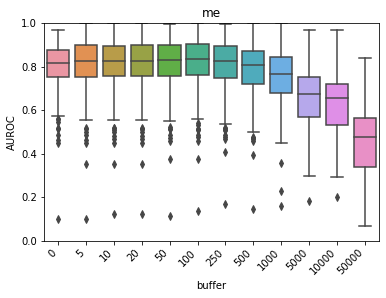

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5208: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


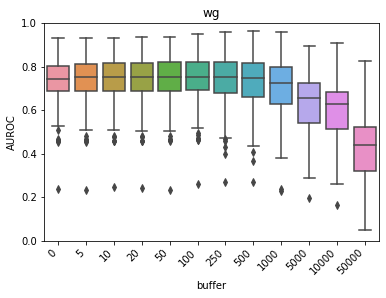

In [780]:
allbox = pd.DataFrame()
agg_meth='mean'
method='auroc'
traces= glob.glob('data/MotifPipeline/**/red/test/all/all/*.txt',recursive = True)
traces2= glob.glob('/pc/redmo/data/MotifPipeline/**/red/test/all/all/*.txt',recursive = True)
traces=traces+traces2
indices = [i for i, s in enumerate(traces) if 'sthlm_'+method+'_meltbox' in s]
for jac in (indices):
    trace=traces[jac]
    if 'pc' in trace:
        buffer=(trace).split('/')[5]
        buffer=(buffer).split('_')[2]
    else:
        buffer=(trace).split('/')[2]
        buffer=(buffer).split('_')[2]
#     print(buffer)
    meltbox=pd.read_csv(trace,sep='\t',index_col=0)
    meltbox['buffer']=buffer
    allbox=pd.concat([allbox,meltbox],axis=0)
#     allbox
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
allbox['data_buff']=allbox['data']+'_'+allbox['buffer'].astype(str)
from pathlib import Path
outdir='data/MotifPipeline/compare'
Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
# col_list = [A549]
cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
# for cell in cells:
for test in tests:

    allbox2=allbox[allbox['data_buff'].str.contains(pat=test)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
    allbox2.buffer=(allbox2.buffer).astype(int)
    allbox2=allbox2.sort_values(by='buffer')
    ##limit TF to those found with no buffer
#         TFF=allbox2[allbox2.buffer==0]
#         allbox2=allbox2[allbox2.TF.isin(TFF.TF)]
    g=sns.boxplot(x='buffer',y='AUROC', data=allbox2)
#     g=sns.swarmplot(x='buffer',y='AUROC', data=allbox2,size=2, color=".3", linewidth=0)
    g.set(ylim=(0, 1))
    g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
    g=plt.title(test)

    plt.savefig(outdir+"/sthlm_allCell"+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
    plt.show()
    plt.close()

## gather and plot methyl datatype distance across buffers

Text(0.5, 1.0, 'mean pairwise distance across all TF/cell combs')

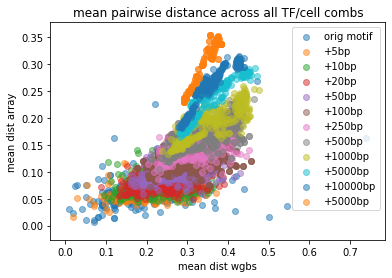

In [844]:
d1=pd.read_table('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d1=d1[d1.cell!='0']

d2=pd.read_table('data/MotifPipeline/sthlm_motif_5_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d2=d2[d2.cell!='0']

d3=pd.read_table('data/MotifPipeline/sthlm_motif_10_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d3=d3[d3.cell!='0']

d4=pd.read_table('data/MotifPipeline/sthlm_motif_20_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d4=d4[d4.cell!='0']

d5=pd.read_table('data/MotifPipeline/sthlm_motif_50_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d5=d5[d5.cell!='0']

d6=pd.read_table('data/MotifPipeline/sthlm_motif_100_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d6=d6[d6.cell!='0']  

d7=pd.read_table('data/MotifPipeline/sthlm_motif_250_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d7=d7[d7.cell!='0']  

d8=pd.read_table('data/MotifPipeline/sthlm_motif_500_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d8=d8[d8.cell!='0'] 

d9=pd.read_table('data/MotifPipeline/sthlm_motif_1000_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d9=d9[d9.cell!='0']  

d10=pd.read_table('../../../pc/redmo/data/MotifPipeline/sthlm_motif_5000_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d10=d10[d10.cell!='0']  

d11=pd.read_table('../../../pc/redmo/data/MotifPipeline/sthlm_motif_10000_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d11=d11[d11.cell!='0']  

d12=pd.read_table('../../../pc/redmo/data/MotifPipeline/sthlm_motif_50000_QCbeta/red/test/all/all/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d12=d12[d12.cell!='0']  

plt.scatter(d1.mean_dist_array,d1.mean_dist_wg,label='orig motif',alpha=.5)
plt.scatter(d2.mean_dist_array,d2.mean_dist_wg,label='+5bp',alpha=.5)
plt.scatter(d3.mean_dist_array,d3.mean_dist_wg,label='+10bp',alpha=.5)
plt.scatter(d4.mean_dist_array,d4.mean_dist_wg,label='+20bp',alpha=.5)
plt.scatter(d5.mean_dist_array,d5.mean_dist_wg,label='+50bp',alpha=.5)
plt.scatter(d6.mean_dist_array,d6.mean_dist_wg,label='+100bp',alpha=.5)
plt.scatter(d7.mean_dist_array,d7.mean_dist_wg,label='+250bp',alpha=.5)
plt.scatter(d8.mean_dist_array,d8.mean_dist_wg,label='+500bp',alpha=.5)
plt.scatter(d9.mean_dist_array,d9.mean_dist_wg,label='+1000bp',alpha=.5)
plt.scatter(d10.mean_dist_array,d10.mean_dist_wg,label='+5000bp',alpha=.5)
plt.scatter(d11.mean_dist_array,d11.mean_dist_wg,label='+10000bp',alpha=.5)
plt.scatter(d12.mean_dist_array,d12.mean_dist_wg,label='+5000bp',alpha=.5)

# plt.xlim(0, 1)
# plt.ylim(0, 1)
plt.legend(loc="best")#,bbox_to_anchor=(1,1))
plt.xlabel('mean dist wgbs')
plt.ylabel('mean dist array')
plt.title('mean pairwise distance across all TF/cell combs')

Text(0.5, 1.0, 'median pairwise distance across all TF/cell combs')

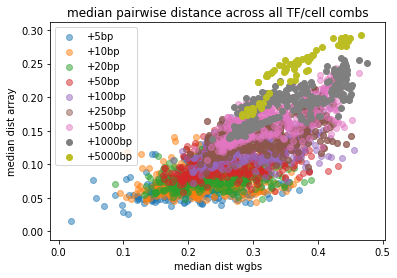

In [111]:
# d1=pd.read_table('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
# d1=d1[d1.cell!='0']

d2=pd.read_table('data/MotifPipeline/sthlm_motif_5_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d2=d2[d2.cell!='0']

d3=pd.read_table('data/MotifPipeline/sthlm_motif_10_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d3=d3[d3.cell!='0']

d4=pd.read_table('data/MotifPipeline/sthlm_motif_20_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d4=d4[d4.cell!='0']

d5=pd.read_table('data/MotifPipeline/sthlm_motif_50_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d5=d5[d5.cell!='0']

d6=pd.read_table('data/MotifPipeline/sthlm_motif_100_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d6=d6[d6.cell!='0']  

d7=pd.read_table('data/MotifPipeline/sthlm_motif_250_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d7=d7[d7.cell!='0']  

d8=pd.read_table('data/MotifPipeline/sthlm_motif_500_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d8=d8[d8.cell!='0'] 

d9=pd.read_table('data/MotifPipeline/sthlm_motif_1000_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d9=d9[d9.cell!='0']  

d10=pd.read_table('data/MotifPipeline/sthlm_motif_5000_QCbeta/red/test/median/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,9,10,11,12,13,14,15,16,17],names=['cell','TF','size','counts','length','mean_dist_array','mean_dist_wg','mean_dist_pwm','hits_array','hits_wg','hits_pwm'])
d10=d10[d10.cell!='0']  

# plt.scatter(d1.mean_dist_array,d1.mean_dist_wg,label='orig motif',alpha=.5)
plt.scatter(d2.mean_dist_array,d2.mean_dist_wg,label='+5bp',alpha=.5)
plt.scatter(d3.mean_dist_array,d3.mean_dist_wg,label='+10bp',alpha=.5)
plt.scatter(d4.mean_dist_array,d4.mean_dist_wg,label='+20bp',alpha=.5)
plt.scatter(d5.mean_dist_array,d5.mean_dist_wg,label='+50bp',alpha=.5)
plt.scatter(d6.mean_dist_array,d6.mean_dist_wg,label='+100bp',alpha=.5)
plt.scatter(d7.mean_dist_array,d7.mean_dist_wg,label='+250bp',alpha=.5)
plt.scatter(d8.mean_dist_array,d8.mean_dist_wg,label='+500bp',alpha=.5)
plt.scatter(d9.mean_dist_array,d9.mean_dist_wg,label='+1000bp')
plt.scatter(d10.mean_dist_array,d10.mean_dist_wg,label='+5000bp')

# plt.xlim(0, 1)
# plt.ylim(0, 1)
plt.legend(loc="best")#,bbox_to_anchor=(1,1))
plt.xlabel('median dist wgbs')
plt.ylabel('median dist array')
plt.title('median pairwise distance across all TF/cell combs')

## begin regional analysis

In [22]:
# indir="data/MotifPipeline/sthlm_motif_0_QCbeta/"
indir="data/MotifPipeline/sthlm_motif_10000_QCbeta/red/"

outdir="data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/"
traces= glob.glob(indir+'/*')
traces = list(filter(lambda file: os.stat(file).st_size > 0, traces))
for jac,trace in enumerate(traces):
    if (os.path.isfile(trace) & os.stat(trace).st_size != 0):
    #     try:
    # trace='data/MotifPipeline/sthlm_motif_5_QCbeta/red/A549_ATF3'
        data=pd.read_csv(trace,sep='\t',usecols=[0,1,2,3,4,8,9,10,11,15,16],names=["chr", "start", "end",'weight','pval',"hits1",'W1','array','region','gene','ChIPTF'])
        Col1=os.path.basename(trace).split('_')[0] #cell
        Col2=os.path.basename(trace).split('_')[1] #TF
        #         except:
        #             pass
        data.ChIPTF=data.ChIPTF.replace('.',0)
        data.ChIPTF[(data.gene==Col2)]=1
        data=data[(data.ChIPTF==0)|(data.ChIPTF==1)]
        data.ChIPTF=pd.to_numeric(data.ChIPTF)
        if np.sum(data.ChIPTF)>5:
            try:
        #         data=pd.read_csv(trace,sep='\t',usecols=[0,1,2,3,4,8,9,10,11,15,16],names=["chr", "start", "end",'weight','pval',"hits1",'W1','array','region','gene','ChIPTF'])
        #         Col1=os.path.basename(trace).split('_')[0] #cell
        #         Col2=os.path.basename(trace).split('_')[1] #TF


                data.weight=(data.weight-data.weight.min())/(data.weight.max()-data.weight.min())
                data['wgbs']=data.W1/100
                data.wgbs=1-data.wgbs
                data.array=1-data.array
                data['cell']=Col1#os.path.basename(trace).split('_')[0]
                data['TF']=Col2
                aaa=(data[(data.ChIPTF-data.wgbs)>=-.5]['region']) #FP
                bbb=(data[(data.ChIPTF-data.wgbs)<-.5]['region']) #T
                ccc=(data[(data.ChIPTF-data.wgbs)>=.5]['region']) #FN
                ddd=(data[(data.ChIPTF-data.wgbs)<.5]['region']) #T

                # from collections import Counter
                aa = dict(Counter(aaa))
                bb = dict(Counter(bbb))
                cc = dict(Counter(ccc))
                dd = dict(Counter(ddd))

            #         column = Col1, Col2, Col3, Col4, Col10, Col5, Col6, Col11,Col7,Col8,Col12,Col9,Col13,Col14,Col15,Col16
                column = data.cell[1],data.TF[1],aa['N_Shore'],aa['S_Shore'],aa['OpenSea'],aa['N_Shelf'],aa['Island'],bb['N_Shore'],bb['S_Shore'],bb['OpenSea'],bb['N_Shelf'],bb['Island'],
                cc['N_Shore'],cc['S_Shore'],cc['OpenSea'],cc['N_Shelf'],cc['Island'],dd['N_Shore'],dd['S_Shore'],dd['OpenSea'],dd['N_Shelf'],dd['Island']
            #             table.append(column)
                print("calculating chromosomal region stats for "+Col2+' in '+Col1)

                np.transpose(pd.DataFrame((column))).to_csv(outdir+'/sthlm_regionPRE_indv.txt',mode='a',header=None)#,header=['cell','tf','mauroc','wauroc','meauroc','maupr','waupr','meaupr','size','max_hit','mo_length'])
            except:
                pass



In [135]:
data.weight=(data.weight-data.weight.min())/(data.weight.max()-data.weight.min())
data['wgbs']=data.W1/100
data.wgbs=1-data.wgbs
data.array=1-data.array
data['cell']=Col1#os.path.basename(trace).split('_')[0]
data['TF']=Col2
aaa=(data[(data.ChIPTF-data.wgbs)>=-.5]['region']) #FP
bbb=(data[(data.ChIPTF-data.wgbs)<-.5]['region']) #T
ccc=(data[(data.ChIPTF-data.wgbs)>=.5]['region']) #FN
ddd=(data[(data.ChIPTF-data.wgbs)<.5]['region']) #T
aa = dict(Counter(aaa))
bb = dict(Counter(bbb))
cc = dict(Counter(ccc))
dd = dict(Counter(ddd))
dd

{'OpenSea': 232,
 'S_Shelf': 14,
 'N_Shore': 22,
 'Island': 4,
 'S_Shore': 23,
 'N_Shelf': 12}

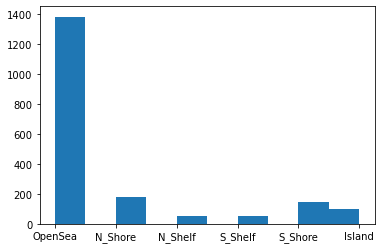

In [3]:
data=pd.read_csv('data/MotifPipeline/sthlm_motif_50_QCbeta/red/SKNSH_ZNF232',sep='\t',usecols=[0,1,2,3,4,8,9,10,11,15,16],names=["chr", "start", "end",'weight','pval',"hits1",'W1','array','region','ChIPTF','gene'])
n=plt.hist(data['region'])


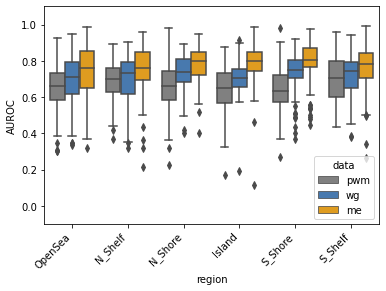

In [2]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/**/all/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
# it='me'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='buffer')
allbox2=allbox[allbox['data']!='wg']
allbox2=allbox2[allbox2['region']!='all']

# allbox2=allbox2.sort_values('region', axis=0)

aa=allbox[allbox['region']=='OpenSea']
bb=allbox[allbox['region']=='N_Shelf']
cc=allbox[allbox['region']=='N_Shore']
dd=allbox[allbox['region']=='Island']
ee=allbox[allbox['region']=='S_Shore']
ff=allbox[allbox['region']=='S_Shelf']
allbox2=pd.concat([aa,bb,cc,dd,ee,ff])

aa=allbox2[allbox2['data']=='pwm']
bb=allbox2[allbox2['data']=='wg']
cc=allbox2[allbox2['data']=='me']
allbox2=pd.concat([aa,bb,cc])

g=sns.boxplot(x='region',y=method.upper(), data=allbox2,hue='data',palette=['grey',sns.xkcd_rgb["windows blue"],'orange'])
# g=sns.swarmplot(x='region',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
g.set(ylim=(-0.1, 1.1))
#     plt.title=it
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()
allboxxx=allbox

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [3]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
allbox=allboxxx[allboxxx['data']=='pwm']
# allbox=allbox[allbox['data']=='wg']
# allbox=allbox[allbox['data']=='me']
aa=allbox[allbox['region']=='OpenSea']
bb=allbox[allbox['region']=='N_Shelf']
cc=allbox[allbox['region']=='N_Shore']
dd=allbox[allbox['region']=='Island']
ee=allbox[allbox['region']=='S_Shore']
ff=allbox[allbox['region']=='S_Shelf']



t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())

t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())

t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())

t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())

# initialise data of lists. 
ttest = {'OpenSea ttest':[t0a,t0b,t1a,t1b,t2a,1], 
         'N_Shelf ttest':[t2b,t3a,t3b,t4a,1,0],
        'N_Shore ttest':[t4b,t5a,t5b,1,0,0],
        'Island ttest':[t6a,t6b,1,0,0,0],
        'S_Shore ttest':[t7a,1,0,0,0,0],
        'S_Shelf ttest':[1,0,0,0,0,0]}
        
pval = {'OpenSea pval':[p0a,p0b,p1a,p1b,p2a,1], 
         'N_Shelf pval':[p2b,p3a,p3b,p4a,1,0],
        'N_Shore pval':[p4b,p5a,p5b,1,0,0],
        'Island pval':[p6a,p6b,1,0,0,0],
        'S_Shore pval':[p7a,1,0,0,0,0],
        'S_Shelf pval':[1,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 
df_pval = pd.DataFrame(pval, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='pwm_'+df_pval.index

df_pval_pwm=df_pval

In [4]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
# allbox=allbox[allbox['data']=='pwm']

allbox=allboxxx[allboxxx['data']=='wg']
# allbox=allbox[allbox['data']=='me']
aa=allbox[allbox['region']=='OpenSea']
bb=allbox[allbox['region']=='N_Shelf']
cc=allbox[allbox['region']=='N_Shore']
dd=allbox[allbox['region']=='Island']
ee=allbox[allbox['region']=='S_Shore']
ff=allbox[allbox['region']=='S_Shelf']



t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())

t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())

t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())

t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())

# initialise data of lists. 
ttest = {'OpenSea ttest':[t0a,t0b,t1a,t1b,t2a,1], 
         'N_Shelf ttest':[t2b,t3a,t3b,t4a,1,0],
        'N_Shore ttest':[t4b,t5a,t5b,1,0,0],
        'Island ttest':[t6a,t6b,1,0,0,0],
        'S_Shore ttest':[t7a,1,0,0,0,0],
        'S_Shelf ttest':[1,0,0,0,0,0]}
        
pval = {'OpenSea pval':[p0a,p0b,p1a,p1b,p2a,1], 
         'N_Shelf pval':[p2b,p3a,p3b,p4a,1,0],
        'N_Shore pval':[p4b,p5a,p5b,1,0,0],
        'Island pval':[p6a,p6b,1,0,0,0],
        'S_Shore pval':[p7a,1,0,0,0,0],
        'S_Shelf pval':[1,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 
df_pval = pd.DataFrame(pval, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='wg_'+df_pval.index

df_pval_wg=df_pval

In [5]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
allbox=allboxxx[allboxxx['data']=='me']

aa=allbox[allbox['region']=='OpenSea']
bb=allbox[allbox['region']=='N_Shelf']
cc=allbox[allbox['region']=='N_Shore']
dd=allbox[allbox['region']=='Island']
ee=allbox[allbox['region']=='S_Shore']
ff=allbox[allbox['region']=='S_Shelf']



t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())

t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())

t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())

t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())

# initialise data of lists. 
ttest = {'OpenSea ttest':[t0a,t0b,t1a,t1b,t2a,1], 
         'N_Shelf ttest':[t2b,t3a,t3b,t4a,1,0],
        'N_Shore ttest':[t4b,t5a,t5b,1,0,0],
        'Island ttest':[t6a,t6b,1,0,0,0],
        'S_Shore ttest':[t7a,1,0,0,0,0],
        'S_Shelf ttest':[1,0,0,0,0,0]}
        
pval = {'OpenSea pval':[p0a,p0b,p1a,p1b,p2a,1], 
         'N_Shelf pval':[p2b,p3a,p3b,p4a,1,0],
        'N_Shore pval':[p4b,p5a,p5b,1,0,0],
        'Island pval':[p6a,p6b,1,0,0,0],
        'S_Shore pval':[p7a,1,0,0,0,0],
        'S_Shelf pval':[1,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 
df_pval = pd.DataFrame(pval, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='me_'+df_pval.index
df_pval_me=df_pval

In [6]:
allPval=pd.concat([df_pval_pwm,df_pval_wg,df_pval_me])
# del allPval['S_Shelf pval']
# allPval=allPval.T

In [7]:
allPval=pd.concat([df_pval_pwm,df_pval_wg,df_pval_me])

mask = np.zeros_like(allPval)
mask[np.triu_indices_from(allPval)] = True
cc=pd.DataFrame(np.flip(mask[0:6,0:6],axis=0))
mask=np.array(pd.concat([cc.T,cc.T,cc.T]))

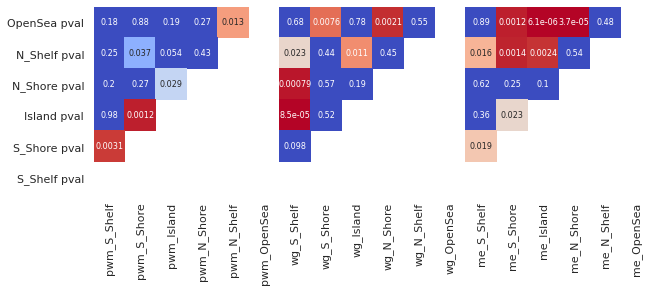

In [12]:
sns.set(font_scale=1)

with sns.axes_style("white"):

    f, ax = plt.subplots(figsize=(10, 7))
    
    ax = sns.heatmap(allPval.T,annot=True,mask=mask.T,cbar=False,
                     vmax=.05, square=True,cmap='coolwarm_r',
                    annot_kws={"size":8})
#     plt.xticks(rotation=30)

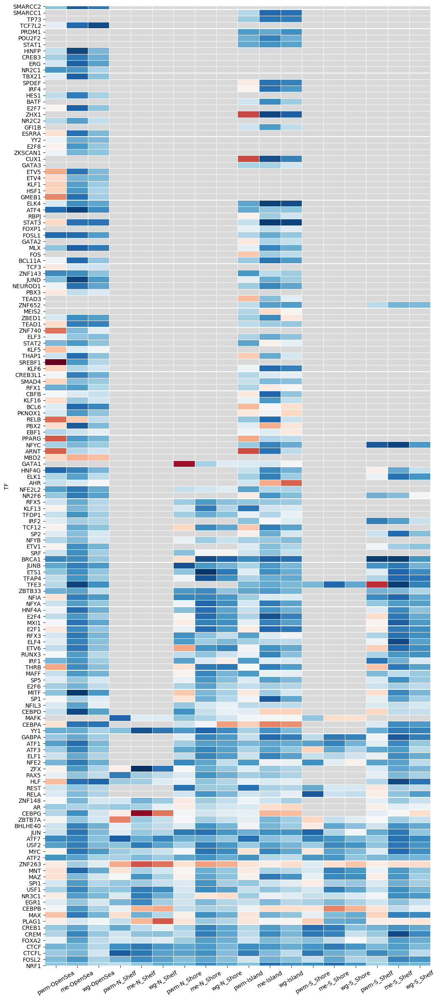

In [81]:
allbox=pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/**/all/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_PRE_overall' in s]
measure='auroc'

for jac in (indices):
    trace=traces[jac]
    aurocs=pd.read_table(trace,sep=',',usecols=[1,2,3,4,5],names=['cell','TF','mo_auroc','wgbs_auroc','me_auroc'])#,'mo_aupr','wgbs_aupr','me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_auroc','tr_me_auroc','tr_wg_aupr','tr_me_aupr'])
    aurocs=aurocs[aurocs.cell!='0']
    aurocs['region']=(trace.split('/')[5])
    
#     if measure=='auroc':
#         aurocs.drop(['mo_aupr','wgbs_aupr','me_aupr','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc'],axis=1,inplace=True)
#     elif measure=='aupr':
#         aurocs.drop(['mo_auroc','wgbs_auroc','me_auroc','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr',],axis=1,inplace=True)

    allbox=pd.concat([allbox,aurocs],axis=0)
    ###PLOT
    # measure="wg_auroc"
    # measure='auroc'

    ##sum across cells and sort
allbox=allbox[allbox['region']!='all']
heat=allbox.pivot_table(index=['TF'], columns='region')
# heat=heat[[measure]]
heat['mean']=np.nanmean(heat,axis=1)
heat['count']=heat.isnull().sum(axis=1)
#     heat['count']=(21-heat['count'])
# heat=heat.sort_values(by=['count'],ascending=True)
# heat=heat.sort_values(by=['mean'],ascending=False)
heat['weight']=heat['mean']*(heat['count'])
heat=heat.sort_values(by=['weight'],ascending=False)
# heat=heat[heat.index.str.contains(pat='CEB')]

# heat=heat[heat['count']==5]
# heat=heat[heat['mean']<0.1]
# del heat.iloc[:,0]
heat=heat.dropna(axis=1, how='all')
del heat['count']
del heat['mean']
del heat['weight']
# heat['sum']=heat.isnull().sum(axis=0)
# heat=heat.sort_values(by=['sum'],ascending=True)
# del heat['sum']
heat=pd.DataFrame(heat.to_records())

heat.columns=['TF','me-OpenSea','me-N_Shelf','me-N_Shore','me-Island','me-S_Shore','me-S_Shelf',
             'pwm-OpenSea','pwm-N_Shelf','pwm-N_Shore','pwm-Island','pwm-S_Shore','pwm-S_Shelf',
             'wg-OpenSea','wg-N_Shelf','wg-N_Shore','wg-Island','wg-S_Shore','wg-S_Shelf']

# heat=heat[['TF','pwm-OpenSea','pwm-N_Shelf','pwm-N_Shore','pwm-Island','pwm-S_Shore','pwm-S_Shelf',
#           'me-OpenSea','me-N_Shelf','me-N_Shore','me-Island','me-S_Shore','me-S_Shelf',
#              'wg-OpenSea','wg-N_Shelf','wg-N_Shore','wg-Island','wg-S_Shore','wg-S_Shelf']]


heat=heat[['TF','pwm-OpenSea','me-OpenSea','wg-OpenSea',
           'pwm-N_Shelf','me-N_Shelf','wg-N_Shelf',
           'pwm-N_Shore', 'me-N_Shore','wg-N_Shore',
           'pwm-Island','me-Island','wg-Island',
           'pwm-S_Shore','me-S_Shore','wg-S_Shore',
           'pwm-S_Shelf','me-S_Shelf','wg-S_Shelf']]
heat55=heat
heat=heat.set_index('TF')

plt.figure(figsize=(12, 30))
# grid_kws = {"height_ratios": (60,12), "hspace": .3}

# f, (ax, cbar_ax) = plt.subplots(2)#, gridspec_kw=grid_kws)
# rdgn = sns.diverging_palette(h_neg=200, h_pos=20, s=99, l=55, sep=3, as_cmap=True)
# rdgn=sns.diverging_palette(220, 20, sep=20, as_cmap=True)
# rdgn=sns.color_palette("RdBu", 100)
rdgn = plt.get_cmap("RdBu")
rdgn.set_bad(color='black', alpha=0.15)
# f,(ax1,ax2) = plt.subplots(1,2,sharey=True)
g1 = sns.heatmap(heat,linewidth=.1,cmap=rdgn, cbar=False,mask=heat.isnull(),yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
mappable = ax.get_children()[0]
plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40
plt.xticks(rotation=30)

# plt.imshow(heat, cmap='hot', interpolation='nearest')
# ax= sns.heatmap(heat, center=.5,cmap=rdgn,linewidth=.1)
# ax= sns.heatmap(heat, linewidth=.1,cmap="YlGnBu")

#     plt.savefig(outdir+"sthlm_"+measure+"_heat.png",dpi=300,bbox_inches = "tight")
plt.show

#     print([(heat55['pwm-OpenSea'].dropna().shape),(heat55['pwm-N_Shelf'].dropna().shape),(heat55['pwm-N_Shore'].dropna().shape),(heat55['pwm-Island'].dropna().shape),(heat55['pwm-S_Shore'].dropna().shape),(heat55['pwm-S_Shelf'].dropna().shape)])

box=heat55

In [ ]:
t0a, p0a = stats.ttest_ind(box['pwm-OpenSea'].dropna(),box['wg-OpenSea'].dropna())
t0b, p0b = stats.ttest_ind(box['pwm-OpenSea'].dropna(),box['me-OpenSea'].dropna())
t1a, p1a = stats.ttest_ind(box['pwm-N_Shelf'].dropna(),box['wg-N_Shelf'].dropna())
t1b, p1b = stats.ttest_ind(box['pwm-N_Shelf'].dropna(),box['me-N_Shelf'].dropna())
t2a, p2a = stats.ttest_ind(box['pwm-N_Shore'].dropna(),box['wg-N_Shore'].dropna())
t2b, p2b = stats.ttest_ind(box['pwm-N_Shore'].dropna(),box['me-N_Shore'].dropna())
t3a, p3a = stats.ttest_ind(box['pwm-Island'].dropna(),box['wg-Island'].dropna())
t3b, p3b = stats.ttest_ind(box['pwm-Island'].dropna(),box['me-Island'].dropna())
t4a, p4a = stats.ttest_ind(box['pwm-S_Shore'].dropna(),box['wg-S_Shore'].dropna())
t4b, p4b = stats.ttest_ind(box['pwm-S_Shore'].dropna(),box['me-S_Shore'].dropna())
t5a, p5a = stats.ttest_ind(box['pwm-S_Shelf'].dropna(),box['wg-S_Shelf'].dropna())
t5b, p5b = stats.ttest_ind(box['pwm-S_Shelf'].dropna(),box['me-S_Shelf'].dropna())


# initialise data of lists. 
ttest = {'WG ttest':[t0a,t1a,t2a,t3a,t4a,t5a], 'WG pvalue':[p0a,p1a,p2a,p3a,p4a,p5a], 'Me ttest':[t0b,t1b,t2b,t3b,t4b,t5b],'Me pvalue':[p0b,p1b,p2b,p3b,p4b,p5b]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_ttest

In [ ]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
allbox=allboxxx[allboxxx['data']=='pwm']
# allbox=allbox[allbox['data']=='wg']
# allbox=allbox[allbox['data']=='me']
aa=allbox[allbox['depth']=='0']
bb=allbox[allbox['depth']=='5']
cc=allbox[allbox['depth']=='10']
dd=allbox[allbox['depth']=='15']
ee=allbox[allbox['depth']=='20']
ff=allbox[allbox['depth']=='30']
gg=allbox[allbox['depth']=='50']

t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())


t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())

t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())

t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())

# initialise data of lists. 
ttest = {'OpenSea ttest':[t0a,t0b,t1a,t1b,t2a,1], 
         'N_Shelf ttest':[t2b,t3a,t3b,t4a,1,0],
        'N_Shore ttest':[t4b,t5a,t5b,1,0,0],
        'Island ttest':[t6a,t6b,1,0,0,0],
        'S_Shore ttest':[t7a,1,0,0,0,0],
        'S_Shelf ttest':[1,0,0,0,0,0]}
        
pval = {'OpenSea pval':[p0a,p0b,p1a,p1b,p2a,1], 
         'N_Shelf pval':[p2b,p3a,p3b,p4a,1,0],
        'N_Shore pval':[p4b,p5a,p5b,1,0,0],
        'Island pval':[p6a,p6b,1,0,0,0],
        'S_Shore pval':[p7a,1,0,0,0,0],
        'S_Shelf pval':[1,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 
df_pval = pd.DataFrame(pval, index =['S_Shelf','S_Shore', 'Island',  'N_Shore','N_Shelf','OpenSea']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='pwm_'+df_pval.index

df_pval_pwm=df_pval

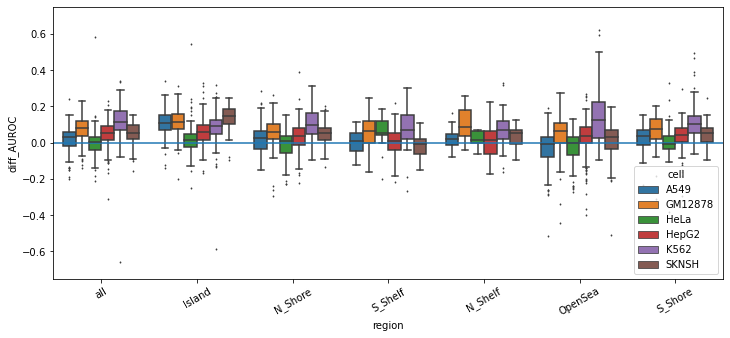

In [8]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/**/all/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox2=allbox.sort_values('cell', axis=0)
# for cell in cells:
# it='pwm'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='cell')
    
# allbox2=allbox[allbox['cell']==cell]
#     allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
#     allbox2=allbox2[allbox2['data']!='me']
# allbox2=allbox2.sort_values('data', axis=0)
aa=allbox2[allbox2['data']=='pwm']
bb=allbox2[allbox2['data']=='wg']
cc=allbox2[allbox2['data']=='me']
dd=(cc.merge(bb,left_on=['TF','region'],right_on=['TF','region']))
dd['diff_AUROC']=(dd['AUROC_x']-dd['AUROC_y'])
dd['data']='me-wg'
dd['depth']=dd['depth_y']
dd['cell']=dd['cell_y']
allbox2=pd.concat([dd])
g=sns.boxplot(x='region',y='diff_AUROC', data=allbox2,hue='cell',fliersize=1)#.set(title = cell)
# g=sns.swarmplot(x='cell',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
plt.axhline(y=0, xmin=-1, xmax=6)

g.set(ylim=(-.75, .75))
#     plt.title=it
#     g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [10]:
CGcont=pd.read_table('tmp1.txt',sep=' ',names=['CG','total','motif','gene'])
type(CGcont['CG'])
# CGcont['frac_CG']=CGcont['CG']/CGcont['total']
# CGcont=CGcont[CGcont['CG'] == int]

# cc=np.log10(CGcont[CGcont['CG']>0]['total'])
# plt.hist(cc,bins=50)
# plt.title(str(cc.shape)+' of 733 have some CGs')
# plt.xlabel('log CG count')
# plt.ylabel('frequency')

pandas.core.series.Series

Text(0, 0.5, 'frequency')

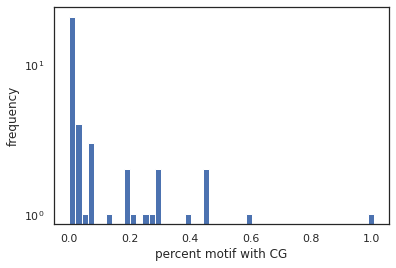

In [27]:
plt.hist(CGcont['CG']/CGcont['total'],bins=50,log=True)
plt.xlabel('percent motif with CG')
plt.ylabel('frequency')

## back to original cell line specific AUROC analysis

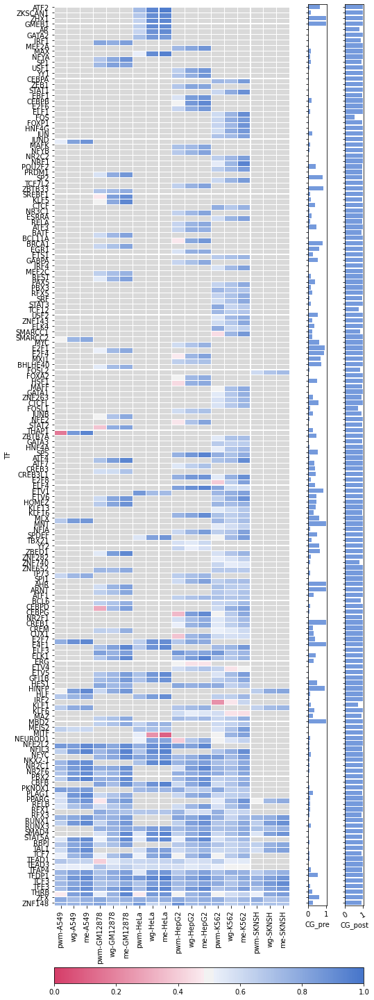

In [87]:
measure='auroc'
aurocs=pd.read_table('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/'+'all'+'/'+'all'+'/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,3,4,5,6,7,8,18,19,20,21,22,23,24,25,26,27],names=['cell','TF','mo_auroc','wgbs_auroc','me_auroc','mo_aupr','wgbs_aupr','me_aupr',
    'rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_auroc','tr_me_auroc','tr_wg_aupr','tr_me_aupr'])
aurocs=aurocs[aurocs.cell!='0']

if measure=='auroc':
    aurocs.drop(['mo_aupr','wgbs_aupr','me_aupr','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc'],axis=1,inplace=True)
elif measure=='aupr':
    aurocs.drop(['mo_auroc','wgbs_auroc','me_auroc','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr',],axis=1,inplace=True)

CGcont=pd.read_table('data/MotifPipeline/total_CGandNonCont.txt',sep=' ',names=['CG','total','motif','gene'])
CGcont['CG_pre']=CGcont['CG']/CGcont['total']
CGcont=CGcont[CGcont.CG_pre<=1]

CGcont2=pd.read_table('data/MotifPipeline/CGcont.txt',sep=' ',names=['CG','total','motif','gene'])
CGcont2['CG_post']=CGcont2['CG']/CGcont2['total']
###PLOT
# measure="wg_auroc"
# measure='auroc'

##sum across cells and sort
heat=aurocs.pivot_table(index=['TF'], columns='cell')
# heat=heat[[measure]]
heat['mean']=np.nanmean(heat,axis=1)
heat['count']=heat.isnull().sum(axis=1)
# heat['count']=(21-heat['count'])
# heat=heat.sort_values(by=['count'],ascending=True)
# heat=heat.sort_values(by=['mean'],ascending=False)
heat['weight']=heat['mean']*(heat['count'])
heat=heat.sort_values(by=['weight'],ascending=False)
# heat=heat[heat.index.str.contains(pat='CEB')]

# heat=heat[heat['count']==5]
# heat=heat[heat['mean']<0.1]
# del heat.iloc[:,0]
heat=heat.dropna(axis=1, how='all')
del heat['count']
del heat['mean']
del heat['weight']
# heat['sum']=heat.isnull().sum(axis=0)
# heat=heat.sort_values(by=['sum'],ascending=True)
# del heat['sum']
heat=pd.DataFrame(heat.to_records())

heat.columns=['TF','me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
             'pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
             'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']

# heat=heat[['TF','pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
#           'me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
#              'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']]


heat=heat[['TF','pwm-A549','wg-A549','me-A549',
           'pwm-GM12878','wg-GM12878','me-GM12878',
           'pwm-HeLa', 'wg-HeLa','me-HeLa',
           'pwm-HepG2','wg-HepG2','me-HepG2',
           'pwm-K562','wg-K562','me-K562',
           'pwm-SKNSH','wg-SKNSH','me-SKNSH']]
heat55=heat
heat=heat.set_index('TF')
# heat.sort_values(by='pwm-A549',ascending=False,inplace=True)
# heat=heat.iloc[::-1]

# plt.figure(figsize=(8, 30))
f,(ax1,ax2,ax3) = plt.subplots(1,3,sharey=True,figsize=(8, 30),gridspec_kw={'width_ratios':[1,0.08,0.08]})
# grid_kws = {"height_ratios": (60,12), "hspace": .3}

# f, (ax, cbar_ax) = plt.subplots(2)#, gridspec_kw=grid_kws)
# rdgn = sns.diverging_palette(h_neg=200, h_pos=20, s=99, l=55, sep=3, as_cmap=True)
# rdgn=sns.diverging_palette(220, 20, sep=20, as_cmap=True)
rdgn=sns.diverging_palette(0.5, 255, sep=8, n=256,as_cmap=True)#sns.color_palette("RdBu",norm=DivergingNorm(0.5))

# offset=colors.DivergingNorm(vmin=0.0, vcenter=0.5, vmax=1.0)
# rdgn = plt.get_cmap("RdBu")
rdgn.set_bad(color='black', alpha=0.15)

# im = ax1.imshow(heat, norm=DivergingNorm(0.5), cmap=rdgn, interpolation='none')
# fig.colorbar(im)
# rdgn.set_bad(color='red')

g1 = sns.heatmap(heat,linewidth=.1,cmap=rdgn, vmin=0, vmax=1,cbar=False,mask=heat.isnull(),yticklabels=True,ax=ax1)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})

g2 = sns.barplot(x='CG_pre',y='gene',color='cornflowerblue',data=CGcont[CGcont['gene'].isin(heat.index)].dropna(),ax=ax2,linewidth=.1,errwidth=0,capsize=0,ci=None)
g2.set(ylabel=None)
# g2.xticks(rotation=30)

# for p in g2.patches:
#     height = p.get_height()
#     g2.text(p.get_x()+p.get_width()/2.,
#             height + 3,
#             '{:1.2f}'.format(height),
#             ha="center") 
# plt.show

g3 = sns.barplot(x='CG_post',y='gene',color='cornflowerblue',data=CGcont2[CGcont2['gene'].isin(heat.index)].dropna(),ax=ax3,linewidth=.1,errwidth=0,capsize=0,ci=None)
g3.set(ylabel=None)
# g3.xticks(rotation=30)
# for p in g3.patches:
#     height = p.get_height()
#     g3.text(p.get_x()+p.get_width()/2.,
#             height + 3,
#             '{:1.2f}'.format(height),
#             ha="center") 
# plt.show

mappable = g1.get_children()[0]
plt.colorbar(mappable, ax = [g1,g2,g3],orientation = 'horizontal',pad=.055) #.02 with 12x60, .03 for 12x40
plt.xticks(rotation=30)

# for ax in [g1,g2,g3]:
#     tl = ax.get_xticklabels()
#     ax.set_xticklabels(tl, rotation=30)
#     tly = ax.get_yticklabels()
#     ax.set_yticklabels(tly, rotation=0)

# plt.imshow(heat, cmap='hot', interpolation='nearest')
# ax= sns.heatmap(heat, center=.5,cmap=rdgn,linewidth=.1)
# ax= sns.heatmap(heat, linewidth=.1,cmap="YlGnBu")

plt.savefig(outdir+"camb_"+measure+"_heat.png",dpi=300,bbox_inches = "tight")
plt.show()

# print([(heat55['pwm-A549'].dropna().shape),(heat55['pwm-GM12878'].dropna().shape),(heat55['pwm-HeLa'].dropna().shape),(heat55['pwm-HepG2'].dropna().shape),(heat55['pwm-K562'].dropna().shape),(heat55['pwm-SKNSH'].dropna().shape)])

# box=heat55
# # box.columns=['TF','A549','GM12878','H1','HeLa','HepG2','K562','SKNSH']
# meltbox=pd.melt(box,id_vars=['TF'])
# # del box.TF
# if measure=='auroc':
#     meltbox.columns=['TF','data - cell line','AUROC']
#     plt.figure(figsize=(18, 5))
#     plt.xticks(rotation=30)
#     g=sns.boxplot(x='data - cell line',y='AUROC', data=meltbox)
#     g=sns.swarmplot(x='data - cell line',y='AUROC', data=meltbox,
#                   size=2, color=".3", linewidth=0)
# elif measure=='aupr':
#     meltbox.columns=['TF','data - cell line','AUPR']
#     plt.figure(figsize=(12, 5))
#     plt.xticks(rotation=30)
#     g=sns.boxplot(x='data - cell line',y='AUPR', data=meltbox)
#     g=sns.swarmplot(x='data - cell line',y='AUPR', data=meltbox,
#                   size=2, color=".3", linewidth=0)
# g.set(ylim=(0, 1))
# plt.savefig(outdir+"sthlm_"+measure+"_box.png",dpi=300,bbox_inches = "tight")
# # meltbox.to_csv(outdir+measure+"meltbox.txt")

# plt.show
# # Tweak the visual presentation
# # ax.xaxis.grid(True)
# # ax.set(ylabel="")
# sns.despine(trim=True, left=True)

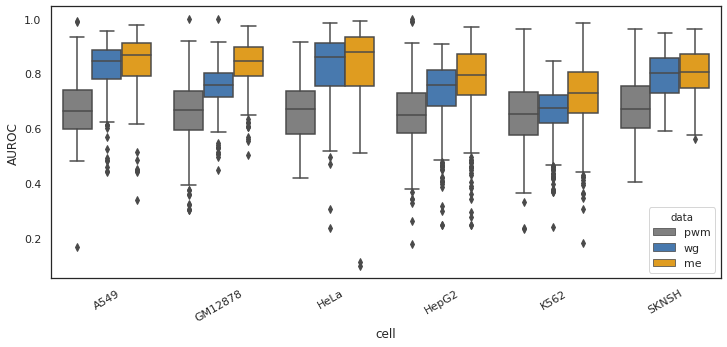

In [25]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox2=allbox.sort_values('cell', axis=0)
# for cell in cells:
# it='pwm'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='cell')
    
# allbox2=allbox[allbox['cell']==cell]
#     allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
#     allbox2=allbox2[allbox2['data']!='me']
# allbox2=allbox2.sort_values('data', axis=0)
aa=allbox2[allbox2['data']=='pwm']
bb=allbox2[allbox2['data']=='wg']
cc=allbox2[allbox2['data']=='me']
allbox2=pd.concat([aa,bb,cc])
g=sns.boxplot(x='cell',y=method.upper(), data=allbox2,hue='data',palette=['grey',sns.xkcd_rgb["windows blue"],'orange'])#.set(title = cell)
# g=sns.swarmplot(x='cell',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
# g.set(ylim=(-0.1, 1.1))

# x1, x2 = 0, 1   # columns 'Sat' and 'Sun' (first column: 0, see plt.xticks())
# y, h, col = allbox2['AUROC'].max() , .1, 'k'
# plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
# plt.text((x1+x2)*.5, y+h, "ns", ha='center', va='bottom', color=col)

#     plt.title=it
#     g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [ ]:
pwmmm=np.mean(heat[heat.columns[heat.columns.str.contains('pwm')]],axis=1)
wgbsss=np.mean(heat[heat.columns[heat.columns.str.contains('wg')]],axis=1)
meee=np.mean(heat[heat.columns[heat.columns.str.contains('me')]],axis=1)
heat2=np.transpose([wgbsss-pwmmm,meee-wgbsss])
heat2=pd.DataFrame(heat2,columns=['wg-pwm','me-pwm'],index=heat.index)
plt.figure(figsize=(3, 30))
heat3=heat2['me-pwm']
# del heat2['me-pwm']
heat4['mean']=np.mean([heat4['wg-pwm'],heat4['me-pwm']],axis=0)
heat2=heat2.sort_index()#(by=heat2.index,ascending=False)
ax = sns.heatmap(heat2,linewidth=.1,center=0,cmap='RdBu',yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
plt.xticks(rotation=30)


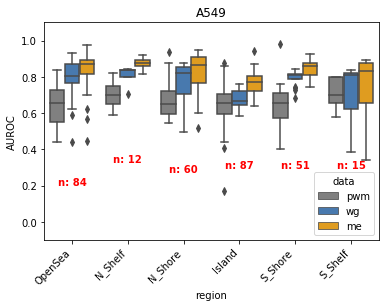

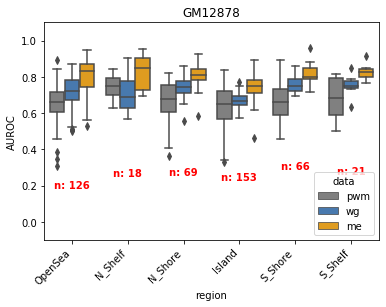

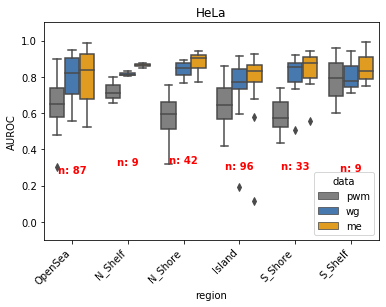

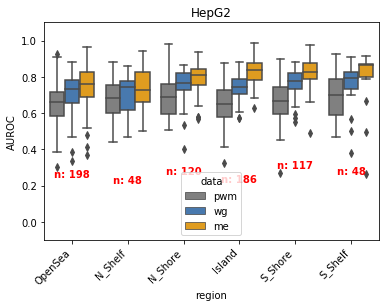

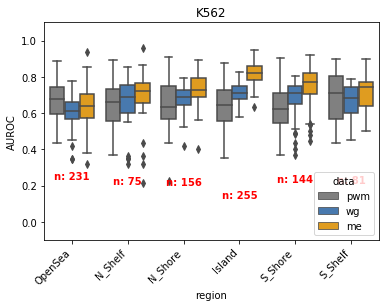

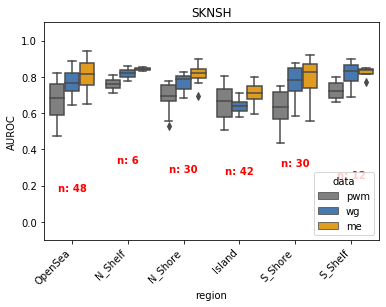

In [925]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/**/all/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
# it='me'
for cell in cells:
    allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='buffer')
#     allbox2=allbox[allbox['cell line']!='']
    allbox2=allbox2[allbox2['region']!='all']

    # allbox2=allbox2.sort_values('region', axis=0)

    aa=allbox2[allbox2['region']=='OpenSea']
    bb=allbox2[allbox2['region']=='N_Shelf']
    cc=allbox2[allbox2['region']=='N_Shore']
    dd=allbox2[allbox2['region']=='Island']
    ee=allbox2[allbox2['region']=='S_Shore']
    ff=allbox2[allbox2['region']=='S_Shelf']
    allbox2=pd.concat([aa,bb,cc,dd,ee,ff])

    aa=allbox2[allbox2['data']=='pwm']
    bb=allbox2[allbox2['data']=='wg']
    cc=allbox2[allbox2['data']=='me']
    allbox2=pd.concat([aa,bb,cc])

    g=sns.boxplot(x='region',y=method.upper(), data=allbox2,hue='data',palette=['grey',sns.xkcd_rgb["windows blue"],'orange'])#
#     g=sns.swarmplot(x='region',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
    medians = allbox2.groupby(['region'])['AUROC'].median().values
    nobs = np.array([allbox2[(allbox2['region']=='OpenSea')]['AUROC'].dropna().shape[0],
allbox2[(allbox2['region']=='N_Shelf')]['AUROC'].dropna().shape[0],
allbox2[(allbox2['region']=='N_Shore')]['AUROC'].dropna().shape[0],
allbox2[(allbox2['region']=='Island')]['AUROC'].dropna().shape[0],
allbox2[(allbox2['region']=='S_Shore')]['AUROC'].dropna().shape[0],
allbox2[(allbox2['region']=='S_Shelf')]['AUROC'].dropna().shape[0]])
    nobs = [str(x) for x in nobs.tolist()]
    nobs = ["n: " + i for i in nobs]
    pos = range(len(nobs))
    for tick,label in zip(pos,ax.get_xticklabels()):
        g.text(pos[tick], medians[tick] - 0.5, nobs[tick],
        horizontalalignment='center', size='medium', color='r', weight='semibold')
    g.set(ylim=(-0.1, 1.1))
    g.set(title = cell)
    #     plt.title=it
    g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
    plt.show()

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [ ]:
heat3=pd.DataFrame(heat3)
heat3=heat3.sort_values(by=['me-pwm'],ascending=False)
plt.figure(figsize=(.5, 30))
ax = sns.heatmap(heat3,linewidth=.1,center=0,cmap='RdBu',yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
plt.xticks(rotation=30)

### subset performing worse than PWM

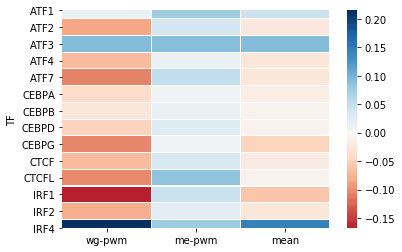

In [271]:
heat4=heat2[(heat2.index.str.contains('IRF'))|(heat2.index.str.contains('CTCF'))|
      (heat2.index.str.contains('ATF'))|(heat2.index.str.contains('CEB'))]
heat4=heat4[(heat4.index.str.contains('BATF'))==False]
heat4['mean']=np.mean([heat4['wg-pwm'],heat4['me-pwm']],axis=0)
heat4
ax = sns.heatmap(heat4,linewidth=.1,center=0,cmap='RdBu',yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})


In [6]:
chA549=pd.read_csv('data/MotifPipeline/remap/remap_TFcell.txt',sep=':',names=['TF','cell'])


In [ ]:
# chA549['TF']=(chA549['TF:cell'].str.split(':').str[0].tolist())
# chA549['cell']=(chA549['TF:cell'].str.split(':').str[1].tolist())

In [31]:
sub=chA549[(chA549['cell']=='A-549')|
           (chA549['cell']=='GM12878')|
           (chA549['cell']=='Hep-G2')|
           (chA549['cell']=='HeLa')|
            (chA549['cell']=='K-562')|
            (chA549['cell']=='SK-N-SH')]



In [33]:
pd.unique(sub.cell)

array(['GM12878', 'K-562', 'A-549', 'Hep-G2', 'HeLa', 'SK-N-SH'],
      dtype=object)

In [38]:
remap=sub.groupby(sub.columns.tolist(),as_index=False).size()

In [49]:
reA549=chA549[chA549['cell']=='A-549']
reA549=reA549.groupby(reA549.columns.tolist(),as_index=False).size()

reGM12878=chA549[chA549['cell']=='GM12878']
reGM12878=reGM12878.groupby(reGM12878.columns.tolist(),as_index=False).size()

reHepG2=chA549[chA549['cell']=='Hep-G2']
reHepG2=reHepG2.groupby(reHepG2.columns.tolist(),as_index=False).size()

reHeLa=chA549[chA549['cell']=='HeLa']
reHeLa=reHeLa.groupby(reHeLa.columns.tolist(),as_index=False).size()

reK562=chA549[chA549['cell']=='K-562']
reK562=reK562.groupby(reK562.columns.tolist(),as_index=False).size()

reSKNSH=chA549[chA549['cell']=='SK-N-SH']
reSKNSH=reSKNSH.groupby(reSKNSH.columns.tolist(),as_index=False).size()


[Text(0, 0.5, 'count'), Text(0.5, 0, 'log10 TF reads')]

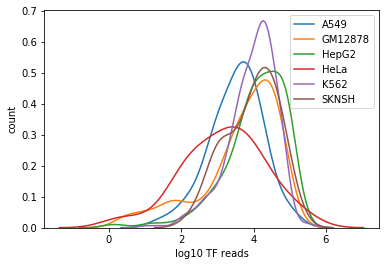

In [69]:
y=sns.distplot(np.log10(reA549),hist=None,kde_kws={"label":'A549'})
y=sns.distplot(np.log10(reGM12878),hist=None,kde_kws={"label":'GM12878'})
y=sns.distplot(np.log10(reHepG2),hist=None,kde_kws={"label":'HepG2'})
y=sns.distplot(np.log10(reHeLa),hist=None,kde_kws={"label":'HeLa'})
y=sns.distplot(np.log10(reK562),hist=None,kde_kws={"label":'K562'})
y=sns.distplot(np.log10(reSKNSH),hist=None,kde_kws={"label":'SKNSH'})
y.set(xlabel='log10 TF reads', ylabel='count')





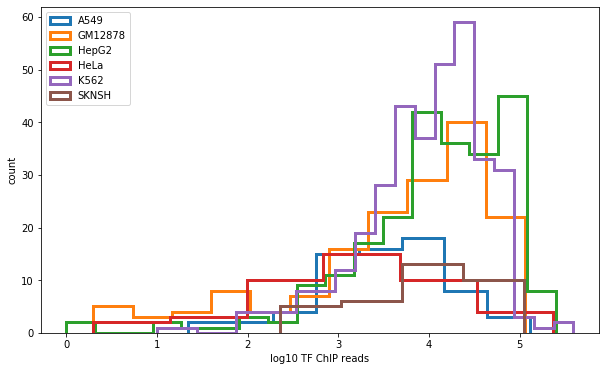

In [86]:
plt.figure(figsize=(10, 6))
x=sns.distplot(np.log10(reA549),kde=0,label='A549',
             hist_kws={"histtype": "step", "linewidth": 3,"alpha": 1})
x=sns.distplot(np.log10(reGM12878),kde=0,label='GM12878',hist_kws={"histtype": "step", "linewidth": 3,"alpha": 1})
x=sns.distplot(np.log10(reHepG2),kde=0,label='HepG2',hist_kws={"histtype": "step", "linewidth": 3,"alpha": 1})
x=sns.distplot(np.log10(reHeLa),kde=0,label='HeLa',hist_kws={"histtype": "step", "linewidth": 3,"alpha": 1})
x=sns.distplot(np.log10(reK562),kde=0,label='K562',hist_kws={"histtype": "step", "linewidth": 3,"alpha": 1})
x=sns.distplot(np.log10(reSKNSH),kde=0,label='SKNSH',hist_kws={"histtype": "step", "linewidth": 3,"alpha": 1})

x.set(xlabel='log10 TF ChIP reads', ylabel='count')
plt.legend(loc='upper left')


## read depth analysis

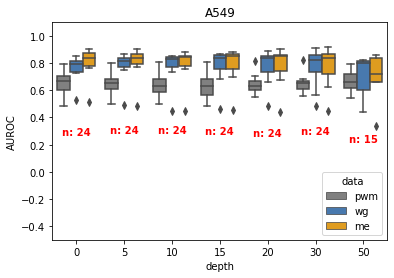

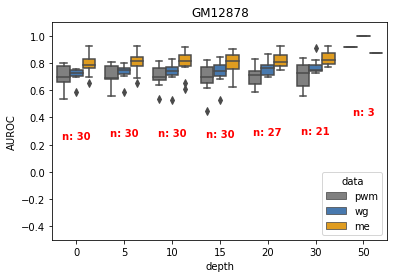

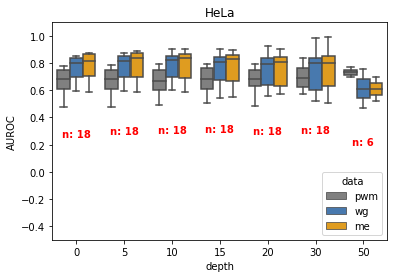

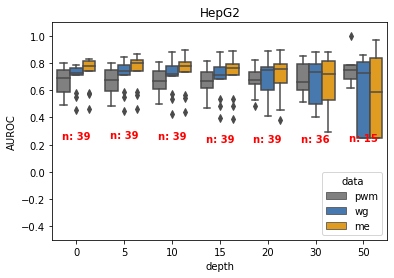

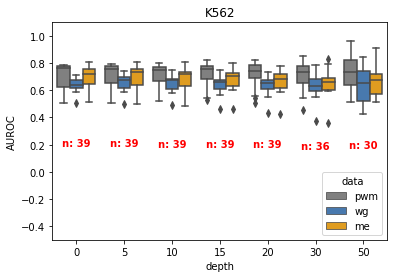

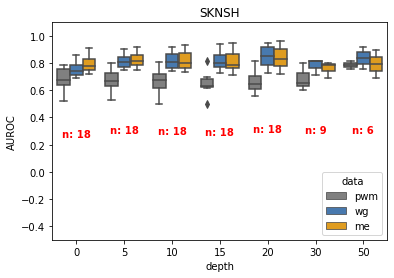

In [967]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)

# plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox=allbox.sort_values('depth', axis=0)
for cell in cells:
# it='pwm'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='buffer')
#     plt.figure(figsize=(8, 5))
    allbox2=allbox[allbox['cell']==cell]
    allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
#     allbox2=allbox2[allbox2['data']!='me']
    aa=allbox2[allbox2['data']=='pwm']
    bb=allbox2[allbox2['data']=='wg']
    cc=allbox2[allbox2['data']=='me']
#     dd=(cc.merge(bb,left_on=['TF','region'],right_on=['TF','region']))
#     dd['AUROC']=(dd['AUROC_x']-dd['AUROC_y'])
#     dd['data']='me-wg'
#     dd['depth']=dd['depth_y']
    allbox2=pd.concat([aa,bb,cc])
#     cc=allbox2[allbox2['data']=='me']
#     allbox2=pd.concat([aa,bb])
#     allbox3['diff_auroc']=aa[method.upper()]-bb[method.upper()]
#     allbox3['depth']=allbox2['depth'][allbox2['data']=='wg']
#     allbox2=allbox2.sort_values('data', axis=0)

    ax=sns.boxplot(x='depth',y=method.upper(), data=allbox2,hue='data',palette=['grey',sns.xkcd_rgb["windows blue"],'orange','deeppink'])#,fliersize=1,meanline=True)
    medians = allbox2.groupby(['depth'])['AUROC'].median().values
    nobs = np.array([allbox2[(allbox2['depth']==0)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==5)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==10)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==15)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==20)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==30)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==50)]['AUROC'].dropna().shape[0]])
    nobs = [str(x) for x in nobs.tolist()]
    nobs = ["n: " + i for i in nobs]

    # Add it to the plot
    pos = range(len(nobs))
    for tick,label in zip(pos,ax.get_xticklabels()):
        ax.text(pos[tick], medians[tick] - 0.5, nobs[tick],
        horizontalalignment='center', size='medium', color='r', weight='semibold')
    # g=sns.swarmplot(x='depth',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
    ax.set(ylim=(-0.5, 1.1))
    ax.set(title = cell)
    #     plt.title=it
    #     g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
    plt.show()

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [918]:
np.array([allbox2[(allbox2['depth']==0)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==5)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==10)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==15)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==20)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==30)]['AUROC'].dropna().shape[0],
allbox2[(allbox2['depth']==50)]['AUROC'].dropna().shape[0]])

array([24, 24, 24, 24, 24, 24, 15])

In [911]:
allbox2['depth'].value_counts().values

array([48, 48, 48, 48, 48, 48, 48])

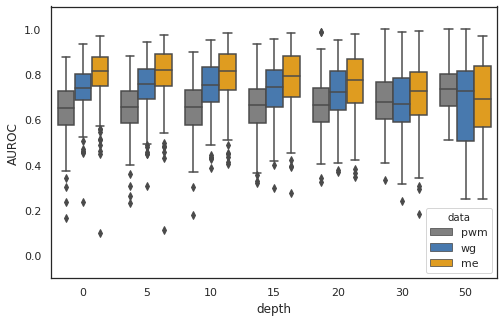

In [24]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)

# plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox=allbox.sort_values('depth', axis=0)
# for cell in cells:
# it='pwm'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='buffer')
plt.figure(figsize=(8, 5))
allbox2=allbox
# allbox2=allbox[allbox['cell']==cell]
# allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
#     allbox2=allbox2[allbox2['data']!='me']
aa=allbox2[allbox2['data']=='pwm']
bb=allbox2[allbox2['data']=='wg']
cc=allbox2[allbox2['data']=='me']
#     dd=(cc.merge(bb,left_on=['TF','region'],right_on=['TF','region']))
#     dd['AUROC']=(dd['AUROC_x']-dd['AUROC_y'])
#     dd['data']='me-wg'
#     dd['depth']=dd['depth_y']
allbox2=pd.concat([aa,bb,cc])
#     cc=allbox2[allbox2['data']=='me']
#     allbox2=pd.concat([aa,bb])
#     allbox3['diff_auroc']=aa[method.upper()]-bb[method.upper()]
#     allbox3['depth']=allbox2['depth'][allbox2['data']=='wg']
#     allbox2=allbox2.sort_values('data', axis=0)

g=sns.boxplot(x='depth',y=method.upper(), data=allbox2,hue='data',palette=['grey',sns.xkcd_rgb["windows blue"],'orange','deeppink'])
# g=sns.swarmplot(x='depth',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
g.set(ylim=(-0.1, 1.1))
# g.set(title = cell)
#     plt.title=it
#     g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()
allboxxx=allbox
#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [34]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
allbox=allboxxx[allboxxx['data']=='pwm']
# allbox=allbox[allbox['data']=='wg']
# allbox=allbox[allbox['data']=='me']
aa=allbox[allbox['depth']==0]
bb=allbox[allbox['depth']==5]
cc=allbox[allbox['depth']==10]
dd=allbox[allbox['depth']==15]
ee=allbox[allbox['depth']==20]
ff=allbox[allbox['depth']==30]
gg=allbox[allbox['depth']==50]



t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())
t2aa, p2aa = stats.ttest_ind(aa['AUROC'].dropna(),gg['AUROC'].dropna())


t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())
t4aa, p4aa = stats.ttest_ind(bb['AUROC'].dropna(),gg['AUROC'].dropna())


t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())
t5bb, p5bb = stats.ttest_ind(cc['AUROC'].dropna(),gg['AUROC'].dropna())


t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())
t6bb, p6bb = stats.ttest_ind(dd['AUROC'].dropna(),gg['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())
t7aa, p7aa = stats.ttest_ind(ee['AUROC'].dropna(),gg['AUROC'].dropna())

t8a, p8a = stats.ttest_ind(ee['AUROC'].dropna(),gg['AUROC'].dropna())


# initialise data of lists. 
ttest = {'0 ttest':[t0a,t0b,t1a,t1b,t2a,t2aa,1], 
         '5 ttest':[t2b,t3a,t3b,t4a,t4aa,1,0],
        '10 ttest':[t4b,t5a,t5b,t5bb,1,0,0],
        '15 ttest':[t6a,t6b,t6bb,1,0,0,0],
        '20 ttest':[t7a,t7aa,1,0,0,0,0],
        '30 ttest':[t8a,1,0,0,0,0,0],
        '50 ttest':[1,0,0,0,0,0,0]}
        
pval = {'0 pval':[p0a,p0b,p1a,p1b,p2a,p2aa,1], 
         '5 pval':[p2b,p3a,p3b,p4a,p4aa,1,0],
        '10 pval':[p4b,p5a,p5b,p5bb,1,0,0],
        '15 pval':[p6a,p6b,p6bb,1,0,0,0],
        '20 pval':[p7a,p7aa,1,0,0,0,0],
        '30 pval':[p8a,1,0,0,0,0,0],
        '50 pval':[1,0,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['50','30', '20',  '15','10','5','0']) 
df_pval = pd.DataFrame(pval, index =['50','30', '20',  '15','10','5','0']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='pwm_'+df_pval.index

df_pval_pwm=df_pval

In [35]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
allbox=allboxxx[allboxxx['data']=='wg']
# allbox=allbox[allbox['data']=='wg']
# allbox=allbox[allbox['data']=='me']
aa=allbox[allbox['depth']==0]
bb=allbox[allbox['depth']==5]
cc=allbox[allbox['depth']==10]
dd=allbox[allbox['depth']==15]
ee=allbox[allbox['depth']==20]
ff=allbox[allbox['depth']==30]
gg=allbox[allbox['depth']==50]



t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())
t2aa, p2aa = stats.ttest_ind(aa['AUROC'].dropna(),gg['AUROC'].dropna())


t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())
t4aa, p4aa = stats.ttest_ind(bb['AUROC'].dropna(),gg['AUROC'].dropna())


t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())
t5bb, p5bb = stats.ttest_ind(cc['AUROC'].dropna(),gg['AUROC'].dropna())


t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())
t6bb, p6bb = stats.ttest_ind(dd['AUROC'].dropna(),gg['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())
t7aa, p7aa = stats.ttest_ind(ee['AUROC'].dropna(),gg['AUROC'].dropna())

t8a, p8a = stats.ttest_ind(ee['AUROC'].dropna(),gg['AUROC'].dropna())


# initialise data of lists. 
ttest = {'0 ttest':[t0a,t0b,t1a,t1b,t2a,t2aa,1], 
         '5 ttest':[t2b,t3a,t3b,t4a,t4aa,1,0],
        '10 ttest':[t4b,t5a,t5b,t5bb,1,0,0],
        '15 ttest':[t6a,t6b,t6bb,1,0,0,0],
        '20 ttest':[t7a,t7aa,1,0,0,0,0],
        '30 ttest':[t8a,1,0,0,0,0,0],
        '50 ttest':[1,0,0,0,0,0,0]}
        
pval = {'0 pval':[p0a,p0b,p1a,p1b,p2a,p2aa,1], 
         '5 pval':[p2b,p3a,p3b,p4a,p4aa,1,0],
        '10 pval':[p4b,p5a,p5b,p5bb,1,0,0],
        '15 pval':[p6a,p6b,p6bb,1,0,0,0],
        '20 pval':[p7a,p7aa,1,0,0,0,0],
        '30 pval':[p8a,1,0,0,0,0,0],
        '50 pval':[1,0,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['50','30', '20',  '15','10','5','0']) 
df_pval = pd.DataFrame(pval, index =['50','30', '20',  '15','10','5','0']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='wg_'+df_pval.index

df_pval_wg=df_pval

In [36]:
# t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
allbox=allboxxx[allboxxx['data']=='me']
# allbox=allbox[allbox['data']=='wg']
# allbox=allbox[allbox['data']=='me']
aa=allbox[allbox['depth']==0]
bb=allbox[allbox['depth']==5]
cc=allbox[allbox['depth']==10]
dd=allbox[allbox['depth']==15]
ee=allbox[allbox['depth']==20]
ff=allbox[allbox['depth']==30]
gg=allbox[allbox['depth']==50]



t0a, p0a = stats.ttest_ind(aa['AUROC'].dropna(),bb['AUROC'].dropna())
t0b, p0b = stats.ttest_ind(aa['AUROC'].dropna(),cc['AUROC'].dropna())
t1a, p1a = stats.ttest_ind(aa['AUROC'].dropna(),dd['AUROC'].dropna())
t1b, p1b = stats.ttest_ind(aa['AUROC'].dropna(),ee['AUROC'].dropna())
t2a, p2a = stats.ttest_ind(aa['AUROC'].dropna(),ff['AUROC'].dropna())
t2aa, p2aa = stats.ttest_ind(aa['AUROC'].dropna(),gg['AUROC'].dropna())


t2b, p2b = stats.ttest_ind(bb['AUROC'].dropna(),cc['AUROC'].dropna())
t3a, p3a = stats.ttest_ind(bb['AUROC'].dropna(),dd['AUROC'].dropna())
t3b, p3b = stats.ttest_ind(bb['AUROC'].dropna(),ee['AUROC'].dropna())
t4a, p4a = stats.ttest_ind(bb['AUROC'].dropna(),ff['AUROC'].dropna())
t4aa, p4aa = stats.ttest_ind(bb['AUROC'].dropna(),gg['AUROC'].dropna())


t4b, p4b = stats.ttest_ind(cc['AUROC'].dropna(),dd['AUROC'].dropna())
t5a, p5a = stats.ttest_ind(cc['AUROC'].dropna(),ee['AUROC'].dropna())
t5b, p5b = stats.ttest_ind(cc['AUROC'].dropna(),ff['AUROC'].dropna())
t5bb, p5bb = stats.ttest_ind(cc['AUROC'].dropna(),gg['AUROC'].dropna())


t6a, p6a = stats.ttest_ind(dd['AUROC'].dropna(),ee['AUROC'].dropna())
t6b, p6b = stats.ttest_ind(dd['AUROC'].dropna(),ff['AUROC'].dropna())
t6bb, p6bb = stats.ttest_ind(dd['AUROC'].dropna(),gg['AUROC'].dropna())

t7a, p7a = stats.ttest_ind(ee['AUROC'].dropna(),ff['AUROC'].dropna())
t7aa, p7aa = stats.ttest_ind(ee['AUROC'].dropna(),gg['AUROC'].dropna())

t8a, p8a = stats.ttest_ind(ee['AUROC'].dropna(),gg['AUROC'].dropna())


# initialise data of lists. 
ttest = {'0 ttest':[t0a,t0b,t1a,t1b,t2a,t2aa,1], 
         '5 ttest':[t2b,t3a,t3b,t4a,t4aa,1,0],
        '10 ttest':[t4b,t5a,t5b,t5bb,1,0,0],
        '15 ttest':[t6a,t6b,t6bb,1,0,0,0],
        '20 ttest':[t7a,t7aa,1,0,0,0,0],
        '30 ttest':[t8a,1,0,0,0,0,0],
        '50 ttest':[1,0,0,0,0,0,0]}
        
pval = {'0 pval':[p0a,p0b,p1a,p1b,p2a,p2aa,1], 
         '5 pval':[p2b,p3a,p3b,p4a,p4aa,1,0],
        '10 pval':[p4b,p5a,p5b,p5bb,1,0,0],
        '15 pval':[p6a,p6b,p6bb,1,0,0,0],
        '20 pval':[p7a,p7aa,1,0,0,0,0],
        '30 pval':[p8a,1,0,0,0,0,0],
        '50 pval':[1,0,0,0,0,0,0]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['50','30', '20',  '15','10','5','0']) 
df_pval = pd.DataFrame(pval, index =['50','30', '20',  '15','10','5','0']) 

# df_ttest = pd.DataFrame(ttest, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
# df_pval = pd.DataFrame(pval, index =['OpenSea','N_Shelf', 'N_Shore', 'Island', 'S_Shore','S_Shelf']) 
df_pval.index='me_'+df_pval.index

df_pval_me=df_pval

In [37]:
allPval=pd.concat([df_pval_pwm,df_pval_wg,df_pval_me])

mask = np.zeros_like(allPval)
mask[np.triu_indices_from(allPval)] = True
cc=pd.DataFrame(np.flip(mask[0:7,0:7],axis=0))
mask=np.array(pd.concat([cc.T,cc.T,cc.T]))

In [38]:
pd.unique(allbox['depth'])

array([ 0,  5, 10, 15, 20, 30, 50])

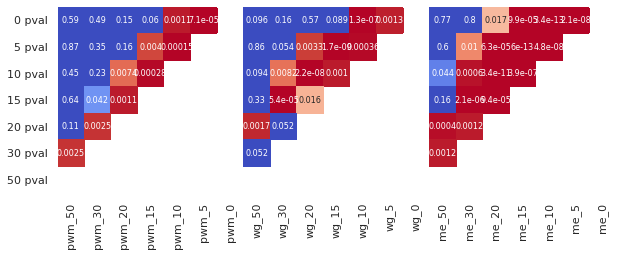

In [39]:
sns.set(font_scale=1)

with sns.axes_style("white"):

    f, ax = plt.subplots(figsize=(10, 7))
    
    ax = sns.heatmap(allPval.T,annot=True,mask=mask.T,cbar=False,
                     vmax=.05, square=True,cmap='coolwarm_r',
                    annot_kws={"size":8})
#     plt.xticks(rotation=30)

In [416]:
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
# plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox=allbox.sort_values('depth', axis=0)

In [ ]:
# aa=allbox[(allbox['data']=='pwm')&(allbox['cell']=='A549')]
# len((allbox[(allbox['data']=='pwm')&(allbox['cell']=='SKNSH')]['TF']))
# bb=allbox[(allbox['data']=='wg')&(allbox['cell']=='A549')]
# pd.DataFrame(aa['AUROC']-bb['AUROC']).dropna()
# bb.dropna()
# allbox=allbox[allbox['cell']=='A549']
cells=np.sort((pd.unique(allbox['cell'])).tolist())
# for cell in cells:
allbox2=allbox[allbox['cell']==cell]
allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
allbox2['merge']=allbox2['TF']+'_'+allbox2['depth'].astype('str')+allbox2['cell']
aa=allbox2[allbox2['data']=='wg']
bb=allbox2[allbox2['data']=='pwm']
cc=aa.merge(bb,left_on='merge',right_on='merge')
cc['diff_AUROC']=cc['AUROC_x']-cc['AUROC_y']
g=sns.boxplot(x='depth_x',y='diff_AUROC', hue=cell,data=cc).set(title = cell)
plt.show()

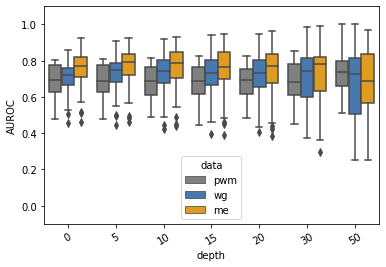

In [444]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox=allbox.sort_values('depth', axis=0)
# for cell in cells:
# it='pwm'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='buffer')
aa=allbox[allbox['data']=='pwm']
bb=allbox[allbox['data']=='wg']
cc=allbox[allbox['data']=='me']
allbox2=pd.concat([aa,bb,cc])
#     allbox2=allbox[allbox['cell']==cell]
allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
# allbox2=allbox2[allbox2['data']!='me']
#     allbox2=allbox2.sort_values('data', axis=0)

g=sns.boxplot(x='depth',y=method.upper(), data=allbox2,hue='data',palette=['grey',sns.xkcd_rgb["windows blue"],'orange'])#.set(title = cell)
# g=sns.swarmplot(x='depth',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
g.set(ylim=(-0.1, 1.1))
#     plt.title=it
#     g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

In [208]:
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/*',recursive = True)
for trace in (traces):
    data=pd.read_csv(trace,sep='\t',usecols=[0,1,2,3,4,8,9,10,11,15,16],names=["chr", "start", "end",'weight','pval',"depth",'W1','array','region','ChIPTF','gene'])
    data5=data[data['depth']>5]
    data10=data[data['depth']>10]
    data20=data[data['depth']>20]
    data30=data[data['depth']>30]
    data50=data[data['depth']>50]
    print(os.path.basename(trace),[data5.shape,data10.shape,data20.shape,data30.shape,data50.shape])

HeLa_FOXI1 [(661, 11), (513, 11), (231, 11), (93, 11), (5, 11)]
HeLa_E2F7 [(3238, 11), (2583, 11), (1203, 11), (544, 11), (69, 11)]
HeLa_HOXD9 [(0, 11), (0, 11), (0, 11), (0, 11), (0, 11)]
HeLa_CLOCK [(5746, 11), (4795, 11), (2548, 11), (1102, 11), (140, 11)]
HeLa_NFAT5 [(2405, 11), (1864, 11), (949, 11), (429, 11), (54, 11)]
A549_HOXB5 [(16, 11), (15, 11), (8, 11), (7, 11), (3, 11)]
HeLa_ARID3C [(150, 11), (134, 11), (92, 11), (55, 11), (6, 11)]
HepG2_TBX21 [(2126, 11), (1455, 11), (413, 11), (132, 11), (5, 11)]
SKNSH_SP5 [(6692, 11), (3295, 11), (1119, 11), (438, 11), (74, 11)]
SKNSH_RFX6 [(775, 11), (479, 11), (210, 11), (88, 11), (16, 11)]
GM12878_SNAI2 [(0, 11), (0, 11), (0, 11), (0, 11), (0, 11)]
GM12878_KLF2 [(11248, 11), (7447, 11), (2055, 11), (331, 11), (2, 11)]
K562_CREB3L2 [(13844, 11), (11369, 11), (5250, 11), (1748, 11), (200, 11)]
SKNSH_GATA2 [(621, 11), (475, 11), (256, 11), (155, 11), (46, 11)]
HepG2_ZFHX2 [(69, 11), (63, 11), (33, 11), (8, 11), (0, 11)]
GM12878_NFATC3

KeyboardInterrupt: 

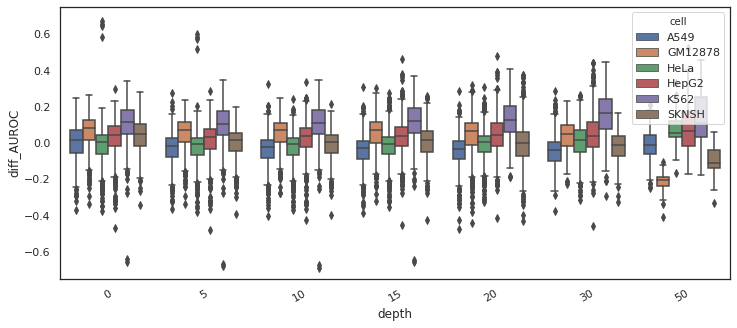

In [23]:
# def plot_allPredScore(directory,agg_meth='mean',method='auroc',region=None,depth=None):
allbox = pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_auroc_meltbox' in s]
method='AUROC'

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[2]
    buffer=(buffer).split('_')[2]
    region=(trace).split('/')[5]
    depth=(trace).split('/')[6]
    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    meltbox['region']=region
    meltbox['depth']=depth
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
allbox['depth']=allbox['depth'].replace('all',0)
# from pathlib import Path
# outdir='data/MotifPipeline/compare'
# Path(outdir).mkdir(parents=True, exist_ok=True)
plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
type=pd.unique(allbox['data'])
allbox['cell']=allbox['data - cell line'].str.split('-').str[1].tolist()
cells=pd.unique(allbox['cell'])
# cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
# tests=['pwm','me','wg']
allbox['depth']=allbox.depth.astype(int)
allbox2=allbox.sort_values('cell', axis=0)
# for cell in cells:
# it='pwm'
#     for test in tests:
#     allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
#     allbox2.buffer=(allbox2.buffer).astype(int)
#     allbox2=allbox2.sort_values(by='cell')
    
# allbox2=allbox[allbox['cell']==cell]
#     allbox2=allbox2[allbox2.TF.isin(allbox2[allbox2['depth']==50]['TF'])]
#     allbox2=allbox2[allbox2['data']!='me']
# allbox2=allbox2.sort_values('data', axis=0)
aa=allbox2[allbox2['data']=='pwm']
bb=allbox2[allbox2['data']=='wg']
cc=allbox2[allbox2['data']=='me']
dd=(cc.merge(bb,left_on=['TF','region'],right_on=['TF','region']))
dd['diff_AUROC']=(dd['AUROC_x']-dd['AUROC_y'])
dd['data']='me-wg'
dd['depth']=dd['depth_y']
dd['cell']=dd['cell_y']
allbox2=pd.concat([dd])
sns.set_style("white")
g=sns.boxplot(x='depth',y='diff_AUROC', data=allbox2,hue='cell')#.set(title = cell)
# g=sns.swarmplot(x='cell',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0,hue='data',palette="colorblind")
g.set(ylim=(-.75, .75))
#     plt.title=it
#     g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

#         plt.savefig(outdir+"/sthlm_"+cell+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
#     plt.close()
# return

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


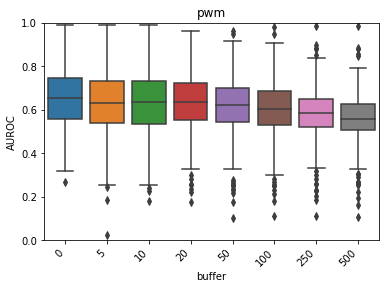

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


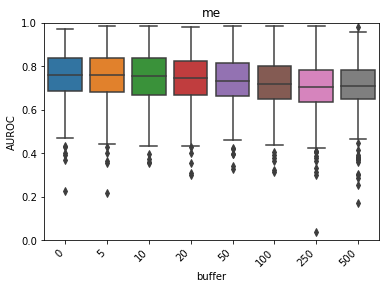

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


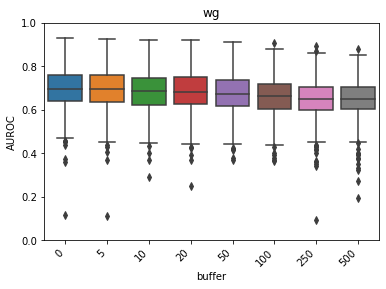

In [9]:

allbox['data']=allbox['data - cell line'].str.split('-').str[0].tolist()
allbox['data_buff']=allbox['data']+'_'+allbox['buffer'].astype(str)
from pathlib import Path
outdir='data/MotifPipeline/compare'
Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
# col_list = [A549]
cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
# for cell in cells:
for test in tests:

    allbox2=allbox[allbox['data_buff'].str.contains(pat=test)]
#     allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
    allbox2.buffer=(allbox2.buffer).astype(int)
    allbox2=allbox2.sort_values(by='buffer')
    ##limit TF to those found with no buffer
#         TFF=allbox2[allbox2.buffer==0]
#         allbox2=allbox2[allbox2.TF.isin(TFF.TF)]
    g=sns.boxplot(x='buffer',y='AUROC', data=allbox2)
#     g=sns.swarmplot(x='buffer',y='AUROC', data=allbox2,size=2, color=".3", linewidth=0)
    g.set(ylim=(0, 1))
    g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
    g=plt.title(test)

    plt.savefig(outdir+"/sthlm_allCell"+test+"_allbox_buff.png",dpi=300,bbox_inches = "tight")
    plt.show()
    plt.close()

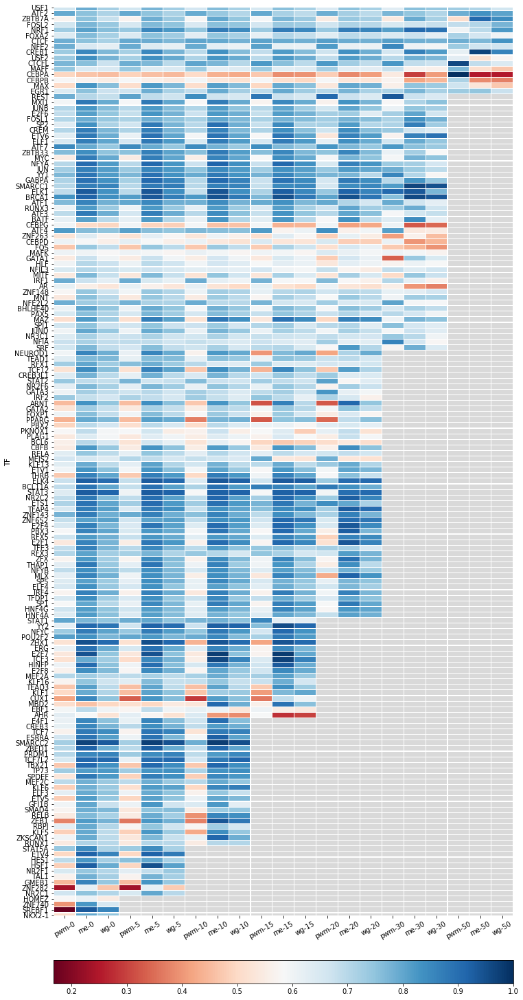

In [195]:
allbox=pd.DataFrame()
traces= glob.glob('data/MotifPipeline/sthlm_motif_0_QCbeta/red/test/all/**/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'sthlm_PRE_overall' in s]
measure='auroc'

for jac in (indices):
    trace=traces[jac]
    aurocs=pd.read_table(trace,sep=',',usecols=[1,2,3,4,5],names=['cell','TF','mo_auroc','wgbs_auroc','me_auroc'])#,'mo_aupr','wgbs_aupr','me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_auroc','tr_me_auroc','tr_wg_aupr','tr_me_aupr'])
    aurocs=aurocs[aurocs.cell!='0']
    aurocs['depth']=(trace.split('/')[6])
    
#     if measure=='auroc':
#         aurocs.drop(['mo_aupr','wgbs_aupr','me_aupr','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc'],axis=1,inplace=True)
#     elif measure=='aupr':
#         aurocs.drop(['mo_auroc','wgbs_auroc','me_auroc','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr',],axis=1,inplace=True)

    allbox=pd.concat([allbox,aurocs],axis=0)
    ###PLOT
    # measure="wg_auroc"
    # measure='auroc'

    ##sum across cells and sort
# allbox=allbox[allbox['depth']!='all']
allbox['depth']=allbox['depth'].replace('all',0)
allbox.depth=allbox.depth.astype(int)
allbox=allbox.sort_values(by='depth')

heat=allbox.pivot_table(index=['TF'], columns='depth')
# heat=heat[[measure]]
heat['mean']=np.nanmean(heat,axis=1)
heat['count']=heat.isnull().sum(axis=1)
#     heat['count']=(21-heat['count'])
# heat=heat.sort_values(by=['count'],ascending=True)
# heat=heat.sort_values(by=['mean'],ascending=False)
heat['weight']=heat['mean']*(heat['count'])
heat=heat.sort_values(by=['weight'],ascending=False)
# heat=heat[heat.index.str.contains(pat='CEB')]

# heat=heat[heat['count']==5]
# heat=heat[heat['mean']<0.1]
# del heat.iloc[:,0]
# heat=heat.dropna(axis=1, how='all')
del heat['count']
del heat['mean']
del heat['weight']
heat['sum']=heat.isnull().sum(axis=1)
heat=heat.sort_values(by=['sum'],ascending=True)
del heat['sum']
heat=pd.DataFrame(heat.to_records())


heat.columns=['TF','me-0','me-5','me-10','me-15','me-20','me-30','me-50',
             'pwm-0','pwm-5','pwm-10','pwm-15','pwm-20','pwm-30','pwm-50',
             'wg-0','wg-5','wg-10','wg-15','wg-20','wg-30','wg-50']

# heat=heat[['TF','pwm-0','pwm-5','pwm-10','pwm-20','pwm-30','pwm-50',
#           'me-0','me-5','me-10','me-20','me-30','me-50',
#              'wg-0','wg-5','wg-10','wg-20','wg-30','wg-50']]


heat=heat[['TF','pwm-0','me-0','wg-0',
           'pwm-5','me-5','wg-5',
           'pwm-10', 'me-10','wg-10',
           'pwm-15', 'me-15','wg-15',
           'pwm-20','me-20','wg-20',
           'pwm-30','me-30','wg-30',
           'pwm-50','me-50','wg-50']]
heat55=heat
heat=heat.set_index('TF')

plt.figure(figsize=(12, 30))
# grid_kws = {"height_ratios": (60,12), "hspace": .3}

# f, (ax, cbar_ax) = plt.subplots(2)#, gridspec_kw=grid_kws)
# rdgn = sns.diverging_palette(h_neg=200, h_pos=20, s=99, l=55, sep=3, as_cmap=True)
# rdgn=sns.diverging_palette(220, 20, sep=20, as_cmap=True)
# rdgn=sns.color_palette("RdBu", 100)
rdgn = plt.get_cmap("RdBu")
rdgn.set_bad(color='black', alpha=0.15)
# rdgn.set_bad(color='red')

ax = sns.heatmap(heat,linewidth=.1,cmap=rdgn, cbar=False,mask=heat.isnull(),yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
mappable = ax.get_children()[0]
plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40
plt.xticks(rotation=30)
# plt.imshow(heat, cmap='hot', interpolation='nearest')
# ax= sns.heatmap(heat, center=.5,cmap=rdgn,linewidth=.1)
# ax= sns.heatmap(heat, linewidth=.1,cmap="YlGnBu")

#     plt.savefig(outdir+"sthlm_"+measure+"_heat.png",dpi=300,bbox_inches = "tight")
plt.show

#     print([(heat55['pwm-OpenSea'].dropna().shape),(heat55['pwm-N_Shelf'].dropna().shape),(heat55['pwm-N_Shore'].dropna().shape),(heat55['pwm-Island'].dropna().shape),(heat55['pwm-S_Shore'].dropna().shape),(heat55['pwm-S_Shelf'].dropna().shape)])

box=heat55

In [555]:
t0a, p0a = stats.ttest_ind(box['pwm-0'].dropna(),box['wg-0'].dropna())
t0b, p0b = stats.ttest_ind(box['pwm-0'].dropna(),box['me-0'].dropna())
t1a, p1a = stats.ttest_ind(box['pwm-5'].dropna(),box['wg-5'].dropna())
t1b, p1b = stats.ttest_ind(box['pwm-5'].dropna(),box['me-5'].dropna())
t2a, p2a = stats.ttest_ind(box['pwm-10'].dropna(),box['wg-10'].dropna())
t2b, p2b = stats.ttest_ind(box['pwm-10'].dropna(),box['me-10'].dropna())
t3a, p3a = stats.ttest_ind(box['pwm-20'].dropna(),box['wg-20'].dropna())
t3b, p3b = stats.ttest_ind(box['pwm-20'].dropna(),box['me-20'].dropna())
t4a, p4a = stats.ttest_ind(box['pwm-30'].dropna(),box['wg-30'].dropna())
t4b, p4b = stats.ttest_ind(box['pwm-30'].dropna(),box['me-30'].dropna())
t5a, p5a = stats.ttest_ind(box['pwm-50'].dropna(),box['wg-50'].dropna())
t5b, p5b = stats.ttest_ind(box['pwm-50'].dropna(),box['me-50'].dropna())


# initialise data of lists. 
ttest = {'WG ttest':[t0a,t1a,t2a,t3a,t4a,t5a], 'WG pvalue':[p0a,p1a,p2a,p3a,p4a,p5a], 'Me ttest':[t0b,t1b,t2b,t3b,t4b,t5b],'Me pvalue':[p0b,p1b,p2b,p3b,p4b,p5b]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['0','5', '10', '20', '30','50']) 
df_ttest

,WG ttest,WG pvalue,Me ttest,Me pvalue
0,-9.456871,9.575567e-19,-13.295628,4.981942e-32
5,-5.609750,5.284593e-08,-8.561409,1.082559e-15
10,-4.106982,5.670626e-05,-6.643149,2.415537e-10
20,0.808903,4.201457e-01,-0.947738,3.451366e-01
30,-10.529872,1.928100e-22,-15.061454,4.539218e-39
50,1.501883,1.435810e-01,1.223309,2.307354e-01


In [557]:
P=stats.f_oneway(box['pwm-0'].dropna(),box['pwm-5'].dropna(),box['pwm-10'].dropna(),box['pwm-20'].dropna(),box['pwm-30'].dropna(),box['pwm-50'].dropna())
W=stats.f_oneway(box['wg-0'].dropna(),box['wg-5'].dropna(),box['wg-10'].dropna(),box['wg-20'].dropna(),box['wg-30'].dropna(),box['wg-50'].dropna())
A=stats.f_oneway(box['me-0'].dropna(),box['me-5'].dropna(),box['me-10'].dropna(),box['me-20'].dropna(),box['me-30'].dropna(),box['me-50'].dropna())

[P,W,A]


[F_onewayResult(statistic=4.244071488394406, pvalue=0.0008401777965445997),
 F_onewayResult(statistic=8.486759389948162, pvalue=8.769273065900511e-08),
 F_onewayResult(statistic=10.645830192381577, pvalue=7.896820332242624e-10)]

In [ ]:
indir="../../pc/redmo/data/MotifPipeline/sthlm_motif_50000_QCbeta/red/test/"
outdir=indir
agg_meth='mean'
measure='auroc'
region='all'
depth='all'

aurocs=pd.read_table(indir+'/'+region+'/'+depth+'/sthlm_PRE_overall.txt',sep=',',usecols=[1,2,3,4,5,6,7,8,18,19,20,21,22,23,24,25,26,27],names=['cell','TF','mo_auroc','wgbs_auroc','me_auroc','mo_aupr','wgbs_aupr','me_aupr',
'rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_auroc','tr_me_auroc','tr_wg_aupr','tr_me_aupr'])
aurocs=aurocs[aurocs.cell!='0']

if measure=='auroc':
    aurocs.drop(['mo_aupr','wgbs_aupr','me_aupr','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc'],axis=1,inplace=True)
elif measure=='aupr':
    aurocs.drop(['mo_auroc','wgbs_auroc','me_auroc','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr',],axis=1,inplace=True)


###PLOT
# measure="wg_auroc"
# measure='auroc'

##sum across cells and sort
heat=aurocs.pivot_table(index=['TF'], columns='cell')
# heat=heat[[measure]]
heat['mean']=np.nanmean(heat,axis=1)
heat['count']=heat.isnull().sum(axis=1)
# heat['count']=(21-heat['count'])
# heat=heat.sort_values(by=['count'],ascending=True)
# heat=heat.sort_values(by=['mean'],ascending=False)
heat['weight']=heat['mean']*(heat['count'])
heat=heat.sort_values(by=['weight'],ascending=False)
# heat=heat[heat.index.str.contains(pat='CEB')]

# heat=heat[heat['count']==5]
# heat=heat[heat['mean']<0.1]
# del heat.iloc[:,0]
heat=heat.dropna(axis=1, how='all')
del heat['count']
del heat['mean']
del heat['weight']
# heat['sum']=heat.isnull().sum(axis=0)
# heat=heat.sort_values(by=['sum'],ascending=True)
# del heat['sum']
heat=pd.DataFrame(heat.to_records())

heat.columns=['TF','me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562',
             'pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562',
             'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562']

# heat=heat[['TF','pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
#           'me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
#              'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']]


heat=heat[['TF','pwm-A549','me-A549','wg-A549',
           'pwm-GM12878','me-GM12878','wg-GM12878',
           'pwm-HeLa', 'me-HeLa','wg-HeLa',
           'pwm-HepG2','me-HepG2','wg-HepG2',
           'pwm-K562','me-K562','wg-K562',
           ]]
heat55=heat
heat=heat.set_index('TF')

plt.figure(figsize=(12, 30))
# grid_kws = {"height_ratios": (60,12), "hspace": .3}

# f, (ax, cbar_ax) = plt.subplots(2)#, gridspec_kw=grid_kws)
# rdgn = sns.diverging_palette(h_neg=200, h_pos=20, s=99, l=55, sep=3, as_cmap=True)
# rdgn=sns.diverging_palette(220, 20, sep=20, as_cmap=True)
rdgn=sns.color_palette("RdBu", 100)
ax = sns.heatmap(heat, center=.5,linewidth=.1,cmap=rdgn, cbar=False)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
mappable = ax.get_children()[0]
plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40
plt.xticks(rotation=30)
# plt.imshow(heat, cmap='hot', interpolation='nearest')
# ax= sns.heatmap(heat, center=.5,cmap=rdgn,linewidth=.1)
# ax= sns.heatmap(heat, linewidth=.1,cmap="YlGnBu")

plt.savefig(outdir+"sthlm_"+measure+"_heat.png",dpi=300,bbox_inches = "tight")
plt.show

print([(heat55['pwm-A549'].dropna().shape),(heat55['pwm-GM12878'].dropna().shape),(heat55['pwm-HeLa'].dropna().shape),(heat55['pwm-HepG2'].dropna().shape),(heat55['pwm-K562'].dropna().shape)])

box=heat55
# box.columns=['TF','A549','GM12878','H1','HeLa','HepG2','K562','SKNSH']
meltbox=pd.melt(box,id_vars=['TF'])
# del box.TF
if measure=='auroc':
    meltbox.columns=['TF','data - cell line','AUROC']
    plt.figure(figsize=(12, 5))
    plt.xticks(rotation=30)
    g=sns.boxplot(x='data - cell line',y='AUROC', data=meltbox)
    g=sns.swarmplot(x='data - cell line',y='AUROC', data=meltbox,
                  size=2, color=".3", linewidth=0)
elif measure=='aupr':
    meltbox.columns=['TF','data - cell line','AUPR']
    plt.figure(figsize=(12, 5))
    plt.xticks(rotation=30)
    g=sns.boxplot(x='data - cell line',y='AUPR', data=meltbox)
    g=sns.swarmplot(x='data - cell line',y='AUPR', data=meltbox,
                  size=2, color=".3", linewidth=0)
g.set(ylim=(0, 1))
plt.savefig(outdir+"sthlm_"+measure+"_box.png",dpi=300,bbox_inches = "tight")
# meltbox.to_csv(outdir+measure+"meltbox.txt")

plt.show
# Tweak the visual presentation
# ax.xaxis.grid(True)
# ax.set(ylabel="")
sns.despine(trim=True, left=True)
# plt.show()


t0a, p0a = stats.ttest_ind(box['pwm-A549'].dropna(),box['wg-A549'].dropna())
t0b, p0b = stats.ttest_ind(box['pwm-A549'].dropna(),box['me-A549'].dropna())
t1a, p1a = stats.ttest_ind(box['pwm-GM12878'].dropna(),box['wg-GM12878'].dropna())
t1b, p1b = stats.ttest_ind(box['pwm-GM12878'].dropna(),box['me-GM12878'].dropna())
t2a, p2a = stats.ttest_ind(box['pwm-HeLa'].dropna(),box['wg-HeLa'].dropna())
t2b, p2b = stats.ttest_ind(box['pwm-HeLa'].dropna(),box['me-HeLa'].dropna())
t3a, p3a = stats.ttest_ind(box['pwm-HepG2'].dropna(),box['wg-HepG2'].dropna())
t3b, p3b = stats.ttest_ind(box['pwm-HepG2'].dropna(),box['me-HepG2'].dropna())
t4a, p4a = stats.ttest_ind(box['pwm-K562'].dropna(),box['wg-K562'].dropna())
t4b, p4b = stats.ttest_ind(box['pwm-K562'].dropna(),box['me-K562'].dropna())


# initialise data of lists. 
ttest = {'WG ttest':[t0a,t1a,t2a,t3a,t4a], 'WG pvalue':[p0a,p1a,p2a,p3a,p4a], 'Me ttest':[t0b,t1b,t2b,t3b,t4b],'Me pvalue':[p0b,p1b,p2b,p3b,p4b]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['A549','GM12878', 'HeLa', 'HepG2', 'K562']) 

df_ttest.to_csv(outdir+'/'+region+'/'+depth+"/sthlm_"+measure+"_ttest.txt")
meltbox.to_csv(outdir+'/'+region+'/'+depth+"/sthlm_"+measure+"_meltbox.txt",sep='\t')

In [5]:
df_ttest

,WG ttest,WG pvalue,Me ttest,Me pvalue
A549,1.240375,0.261139,1.348357,0.226214
GM12878,-0.965909,0.353153,-1.052021,0.313514
HeLa,-0.045428,0.964408,-0.470350,0.645349
HepG2,2.269637,0.027100,1.463898,0.148813
K562,5.250068,0.000003,4.520186,0.000034


## CG content analysis

In [89]:
allbox = pd.DataFrame()
dirr='../../d/tmp/redmo/camb_motif_ALL/'
# dirrA='../../d/tmp/redmo/data/MotifPipeline/cbus_motif_pipeline_gamma0/

# dirr2='../../d/tmp/redmo/camb_motif_ALL/'
# dirr2A='../../d/tmp/redmo/camb_motif/'
outdir='../../d/tmp/redmo/camb_motif/'
traces= glob.glob(dirr+'CG/'+'*',recursive = False)
# traces2= glob.glob(dirrA+'CG/'+'*',recursive = False)
# traces=traces+traces2
# traces= glob.glob(dirrA+'*',recursive = False)


# trace=traces[0]
for i,trace in enumerate(traces):
#     print(trace)
#     plt.subplot(2, 2, 3)
    combo=trace.split('/')[7]
    TF=combo.split('_')[1]
    cell=combo.split('_')[0]
    dataCG=pd.read_csv(trace,sep='\t',names=['pwm','ChIPTF'])

    dataCG.ChIPTF=dataCG.ChIPTF.replace(' ',0)
    dataCG.ChIPTF=dataCG.ChIPTF.fillna(0)
    dataCG.ChIPTF[(dataCG.ChIPTF==TF)]=1
    dataCG=dataCG[(dataCG.ChIPTF==0)|(dataCG.ChIPTF==1)]
    dataCG.ChIPTF=pd.to_numeric(dataCG.ChIPTF)
    
    data_nonCG=pd.read_csv(dirr+'nonCG/'+combo,sep='\t',names=['pwm','ChIPTF'])

    data_nonCG.ChIPTF=data_nonCG.ChIPTF.replace(' ',0)
    data_nonCG.ChIPTF=data_nonCG.ChIPTF.fillna(0)
    data_nonCG.ChIPTF[(data_nonCG.ChIPTF==TF)]=1
    data_nonCG=data_nonCG[(data_nonCG.ChIPTF==0)|(data_nonCG.ChIPTF==1)]
    data_nonCG.ChIPTF=pd.to_numeric(data_nonCG.ChIPTF)

    if np.sum(dataCG.ChIPTF)>5 and np.sum(data_nonCG.ChIPTF)>5:
        plt.plot([0, 1], [0, 1], 'k--')
        fpr, tpr, thresholds = metrics.roc_curve(dataCG.ChIPTF, dataCG.pwm)
        roc_auc=metrics.auc(fpr, tpr)
        plt.plot(fpr, tpr,
                 label='CG (area = {0:0.2f})'
                     ''.format(roc_auc),
                 color='b', linestyle=':', linewidth=4)

        fpr2, tpr2, thresholds = metrics.roc_curve(data_nonCG.ChIPTF, data_nonCG.pwm)
        roc_auc2=metrics.auc(fpr2, tpr2)
        plt.plot(fpr2, tpr2,
                 label='nonCG (area = {0:0.2f})'
                       ''.format(roc_auc2),
                 color='r', linestyle=':', linewidth=4)
        
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('AUROC for '+TF+' in '+cell)
        plt.legend(loc="best")
        
        plt.show()

        Col1=cell
        Col2=TF
        Col3=roc_auc #motif auroc
        Col4=roc_auc2
        column = Col1, Col2, Col3, Col4
        np.transpose(pd.DataFrame((column))).to_csv(outdir+'camb_PRE_overall.txt',mode='a')
        del roc_auc, roc_auc2

In [ ]:
indir="../../d/tmp/redmo/camb_motif/camb_PRE_overall.txt"
# outdir="../../d/tmp/redmo/"
agg_meth='mean'
measure='auroc'
region='all'
depth='all'

aurocs=pd.read_table(indir,sep=',',names=['cell','TF','CG','nonCG'])
aurocs=aurocs[aurocs.cell!='0']

# if measure=='auroc':
#     aurocs.drop(['mo_aupr','wgbs_aupr','me_aupr','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc'],axis=1,inplace=True)


###PLOT
# measure="wg_auroc"
# measure='auroc'

##sum across cells and sort
# aurocs['diff']=aurocs['CG']-aurocs['nonCG']
heat=aurocs.pivot_table(index=['TF'], columns='cell')
# heat=heat[[measure]]
# heat['mean']=np.nanmean(heat,axis=1)
# heat['count']=heat.isnull().sum(axis=1)
# heat['count']=(21-heat['count'])
# heat=heat.sort_values(by=['count'],ascending=True)
# heat=heat.sort_values(by=['mean'],ascending=False)
# heat['diff']=heat['CG']-heat['nonCG']
# heat=heat.sort_values(by=['diff'],ascending=False)
# heat=heat[heat.index.str.contains(pat='CEB')]

# heat=heat[heat['count']==5]
# heat=heat[heat['mean']<0.1]
# del heat.iloc[:,0]
heat=heat.dropna(axis=1, how='all')
# del heat['count']
# del heat['mean']
# del heat['weight']
# heat['sum']=heat.isnull().sum(axis=0)
# heat=heat.sort_values(by=['sum'],ascending=True)
# del heat['sum']
heat=pd.DataFrame(heat.to_records())

heat.columns=['TF','CG_A549','CG_GM12878','CG_HeLa','CG_HepG2','CG_K562','CG_SKNSH',
             'nonCG_A549','nonCG_GM12878','nonCG_HeLa','nonCG_HepG2','nonCG_K562','nonCG_SKNSH']

# # heat=heat[['TF','pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
# #           'me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
# #              'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']]

# heat['A549_diff']=GM12878['CG_A549']-GM12878['nonCG_A549']

# heat['GM12878_diff']=heat['CG_GM12878']-heat['nonCG_GM12878']
# heat['HeLa_diff']=heat['CG_HeLa']-heat['nonCG_HeLa']
# heat['HepG2_diff']=heat['CG_HepG2']-heat['nonCG_HepG2']
# heat['K562_diff']=heat['CG_K562']-heat['nonCG_K562']
# heat['SKNSH_diff']=heat['CG_SKNSH']-heat['nonCG_SKNSH']

heat=heat[['TF','CG_A549','nonCG_A549',#'A549_diff',
           'CG_GM12878','nonCG_GM12878',#'GM12878_diff',
           'CG_HeLa','nonCG_HeLa',#'HeLa_diff',
           'CG_HepG2','nonCG_HepG2',#'HepG2_diff',
           'CG_K562','nonCG_K562',#'K562_diff',
           'CG_SKNSH','nonCG_SKNSH'#'SKNSH_diff'
           ]]
heat55=heat
heat=heat.set_index('TF')

plt.figure(figsize=(12, 30))
# grid_kws = {"height_ratios": (60,12), "hspace": .3}

# f, (ax, cbar_ax) = plt.subplots(2)#, gridspec_kw=grid_kws)
# rdgn = sns.diverging_palette(h_neg=200, h_pos=20, s=99, l=55, sep=3, as_cmap=True)
# rdgn=sns.diverging_palette(220, 20, sep=20, as_cmap=True)
rdgn=sns.color_palette("RdBu", 100)
ax = sns.heatmap(heat, center=.5,linewidth=.1,cmap=rdgn, cbar=False)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
mappable = ax.get_children()[0]
plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40
plt.xticks(rotation=30)
# plt.imshow(heat, cmap='hot', interpolation='nearest')
# ax= sns.heatmap(heat, center=.5,cmap=rdgn,linewidth=.1)
# ax= sns.heatmap(heat, linewidth=.1,cmap="YlGnBu")

plt.savefig(outdir+"sthlm_"+measure+"_heat.png",dpi=300,bbox_inches = "tight")
plt.show

# print([(heat55['pwm-A549'].dropna().shape),(heat55['pwm-GM12878'].dropna().shape),(heat55['pwm-HeLa'].dropna().shape),(heat55['pwm-HepG2'].dropna().shape),(heat55['pwm-K562'].dropna().shape)])

box=heat55
# box.columns=['TF','A549','GM12878','H1','HeLa','HepG2','K562','SKNSH']
meltbox=pd.melt(box,id_vars=['TF'])
# del box.TF
if measure=='auroc':
    meltbox.columns=['TF','cell line','AUROC']
    plt.figure(figsize=(12, 5))
    plt.xticks(rotation=30)
    g=sns.boxplot(x='cell line',y='AUROC', data=meltbox)
    g=sns.swarmplot(x='cell line',y='AUROC', data=meltbox,
                  size=2, color=".3", linewidth=0)
# elif measure=='aupr':
#     meltbox.columns=['TF','data - cell line','AUPR']
#     plt.figure(figsize=(12, 5))
#     plt.xticks(rotation=30)
#     g=sns.boxplot(x='data - cell line',y='AUPR', data=meltbox)
#     g=sns.swarmplot(x='data - cell line',y='AUPR', data=meltbox,
#                   size=2, color=".3", linewidth=0)
g.set(ylim=(0, 1))
plt.savefig(outdir+"camb_heat_CG-non.png",dpi=300,bbox_inches = "tight")
# meltbox.to_csv(outdir+measure+"meltbox.txt")

# plt.show
# Tweak the visual presentation
# ax.xaxis.grid(True)
# ax.set(ylabel="")
sns.despine(trim=True, left=True)
plt.show()


# t0a, p0a = stats.ttest_ind(box[''].dropna(),box['wg-A549'].dropna())
t0a, p0a = stats.ttest_ind(box['CG_A549'].dropna(),box['nonCG_A549'].dropna())
t1a, p1a = stats.ttest_ind(box['CG_GM12878'].dropna(),box['nonCG_GM12878'].dropna())
# t1b, p1b = stats.ttest_ind(box['pwm-GM12878'].dropna(),box['me-GM12878'].dropna())
t2a, p2a = stats.ttest_ind(box['CG_HeLa'].dropna(),box['nonCG_HeLa'].dropna())
# t2b, p2b = stats.ttest_ind(box['pwm-HeLa'].dropna(),box['me-HeLa'].dropna())
t3a, p3a = stats.ttest_ind(box['CG_HepG2'].dropna(),box['nonCG_HepG2'].dropna())
# t3b, p3b = stats.ttest_ind(box['pwm-HepG2'].dropna(),box['me-HepG2'].dropna())
t4a, p4a = stats.ttest_ind(box['CG_K562'].dropna(),box['nonCG_K562'].dropna())
# t4b, p4b = stats.ttest_ind(box['pwm-K562'].dropna(),box['me-K562'].dropna())
t5a, p5a = stats.ttest_ind(box['CG_SKNSH'].dropna(),box['nonCG_SKNSH'].dropna())


# initialise data of lists. 
ttest = {'CG-nonCG ttest':[t0a,t1a,t2a,t3a,t4a,t5a], 'CG-non pvalue':[p0a,p1a,p2a,p3a,p4a,p5a],}# 'Me ttest':[t0b,t1b,t2b,t3b,t4b],'Me pvalue':[p0b,p1b,p2b,p3b,p4b]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']) 

df_ttest.to_csv(outdir+"/camb_ttest.txt")
meltbox.to_csv(outdir+"/camb_meltbox.txt",sep='\t')

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:87: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("RdBu"))


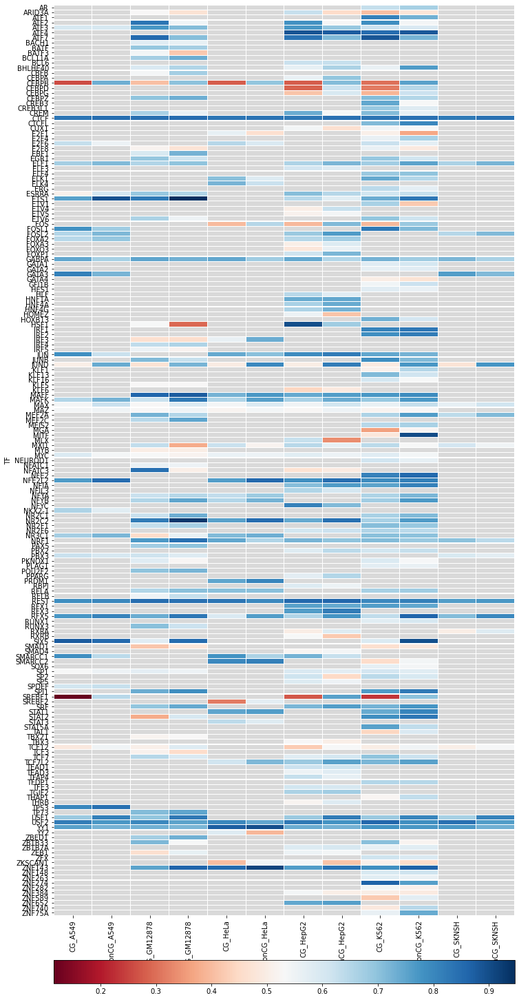

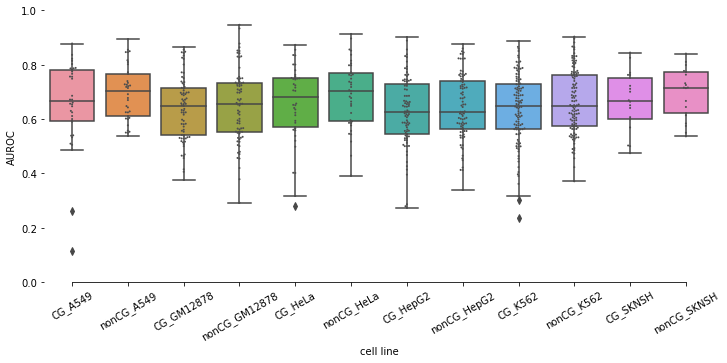

In [44]:
indir="../../d/tmp/redmo/camb_motif/camb_PRE_overall.txt"
# outdir="../../d/tmp/redmo/"
agg_meth='mean'
measure='auroc'
region='all'
depth='all'

aurocs=pd.read_table(indir,sep=',',names=['cell','TF','CG','nonCG'])
aurocs=aurocs[aurocs.cell!='0']

# if measure=='auroc':
#     aurocs.drop(['mo_aupr','wgbs_aupr','me_aupr','rand_mo_aupr','rand_wgbs_aupr','rand_me_aupr','tr_wg_aupr','tr_me_aupr','rand_mo_auroc','rand_wgbs_auroc','rand_me_auroc','tr_wg_auroc','tr_me_auroc'],axis=1,inplace=True)


###PLOT
# measure="wg_auroc"
# measure='auroc'

##sum across cells and sort
# aurocs['diff']=aurocs['CG']-aurocs['nonCG']
heat=aurocs.pivot_table(index=['TF'], columns='cell')
# heat=heat[[measure]]
# heat['mean']=np.nanmean(heat,axis=1)
# heat['count']=heat.isnull().sum(axis=1)
# heat['count']=(21-heat['count'])
# heat=heat.sort_values(by=['count'],ascending=True)
# heat=heat.sort_values(by=['mean'],ascending=False)
# heat['diff']=heat['CG']-heat['nonCG']
# heat=heat.sort_values(by=['diff'],ascending=False)
# heat=heat[heat.index.str.contains(pat='CEB')]

# heat=heat[heat['count']==5]
# heat=heat[heat['mean']<0.1]
# del heat.iloc[:,0]
heat=heat.dropna(axis=1, how='all')
# del heat['count']
# del heat['mean']
# del heat['weight']
# heat['sum']=heat.isnull().sum(axis=0)
# heat=heat.sort_values(by=['sum'],ascending=True)
# del heat['sum']
heat=pd.DataFrame(heat.to_records())

heat.columns=['TF','CG_A549','CG_GM12878','CG_HeLa','CG_HepG2','CG_K562','CG_SKNSH',
             'nonCG_A549','nonCG_GM12878','nonCG_HeLa','nonCG_HepG2','nonCG_K562','nonCG_SKNSH']

# # heat=heat[['TF','pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
# #           'me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
# #              'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']]

# heat['A549_diff']=GM12878['CG_A549']-GM12878['nonCG_A549']

# heat['GM12878_diff']=heat['CG_GM12878']-heat['nonCG_GM12878']
# heat['HeLa_diff']=heat['CG_HeLa']-heat['nonCG_HeLa']
# heat['HepG2_diff']=heat['CG_HepG2']-heat['nonCG_HepG2']
# heat['K562_diff']=heat['CG_K562']-heat['nonCG_K562']
# heat['SKNSH_diff']=heat['CG_SKNSH']-heat['nonCG_SKNSH']

heat=heat[['TF','CG_A549','nonCG_A549',#'A549_diff',
           'CG_GM12878','nonCG_GM12878',#'GM12878_diff',
           'CG_HeLa','nonCG_HeLa',#'HeLa_diff',
           'CG_HepG2','nonCG_HepG2',#'HepG2_diff',
           'CG_K562','nonCG_K562',#'K562_diff',
           'CG_SKNSH','nonCG_SKNSH'#'SKNSH_diff'
           ]]
heat55=heat
heat=heat.set_index('TF')

plt.figure(figsize=(12, 30))
# grid_kws = {"height_ratios": (60,12), "hspace": .3}

# f, (ax, cbar_ax) = plt.subplots(2)#, gridspec_kw=grid_kws)
# rdgn = sns.diverging_palette(h_neg=200, h_pos=20, s=99, l=55, sep=3, as_cmap=True)
# rdgn=sns.diverging_palette(220, 20, sep=20, as_cmap=True)
# rdgn=sns.color_palette("RdBu", 100)
# rdgn = plt.get_cmap("RdBu")
# rdgn.set_bad(color='black', alpha=0.15)
# # rdgn.set_bad(color='red')
# ax = sns.heatmap(heat, center=.5,linewidth=.1,cmap=rdgn,mask=heat.isnull(), cbar=False)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})

# mappable = ax.get_children()[0]
# plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40
# plt.xticks(rotation=30)


rdgn = plt.get_cmap("RdBu")
rdgn.set_bad(color='black', alpha=0.15)
# rdgn.set_bad(color='red')

ax = sns.heatmap(heat,linewidth=.1,cmap=rdgn, cbar=False,mask=heat.isnull(),yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
mappable = ax.get_children()[0]
plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40



# plt.imshow(heat, cmap='hot', interpolation='nearest')
# ax= sns.heatmap(heat, center=.5,cmap=rdgn,linewidth=.1)
# ax= sns.heatmap(heat, linewidth=.1,cmap="YlGnBu")

plt.savefig(outdir+"sthlm_"+measure+"_heat.png",dpi=300,bbox_inches = "tight")
plt.show

# print([(heat55['pwm-A549'].dropna().shape),(heat55['pwm-GM12878'].dropna().shape),(heat55['pwm-HeLa'].dropna().shape),(heat55['pwm-HepG2'].dropna().shape),(heat55['pwm-K562'].dropna().shape)])

box=heat55
# box.columns=['TF','A549','GM12878','H1','HeLa','HepG2','K562','SKNSH']
meltbox=pd.melt(box,id_vars=['TF'])
# del box.TF
if measure=='auroc':
    meltbox.columns=['TF','cell line','AUROC']
    plt.figure(figsize=(12, 5))
    plt.xticks(rotation=30)
    g=sns.boxplot(x='cell line',y='AUROC', data=meltbox)
    g=sns.swarmplot(x='cell line',y='AUROC', data=meltbox,
                  size=2, color=".3", linewidth=0)
# elif measure=='aupr':
#     meltbox.columns=['TF','data - cell line','AUPR']
#     plt.figure(figsize=(12, 5))
#     plt.xticks(rotation=30)
#     g=sns.boxplot(x='data - cell line',y='AUPR', data=meltbox)
#     g=sns.swarmplot(x='data - cell line',y='AUPR', data=meltbox,
#                   size=2, color=".3", linewidth=0)
g.set(ylim=(0, 1))
plt.savefig(outdir+"camb_heat_CG-non.png",dpi=300,bbox_inches = "tight")
# meltbox.to_csv(outdir+measure+"meltbox.txt")

# plt.show
# Tweak the visual presentation
# ax.xaxis.grid(True)
# ax.set(ylabel="")
sns.despine(trim=True, left=True)
plt.show()


# t0a, p0a = stats.ttest_ind(box[''].dropna(),box['wg-A549'].dropna())
t0a, p0a = stats.ttest_ind(box['CG_A549'].dropna(),box['nonCG_A549'].dropna())
t1a, p1a = stats.ttest_ind(box['CG_GM12878'].dropna(),box['nonCG_GM12878'].dropna())
# t1b, p1b = stats.ttest_ind(box['pwm-GM12878'].dropna(),box['me-GM12878'].dropna())
t2a, p2a = stats.ttest_ind(box['CG_HeLa'].dropna(),box['nonCG_HeLa'].dropna())
# t2b, p2b = stats.ttest_ind(box['pwm-HeLa'].dropna(),box['me-HeLa'].dropna())
t3a, p3a = stats.ttest_ind(box['CG_HepG2'].dropna(),box['nonCG_HepG2'].dropna())
# t3b, p3b = stats.ttest_ind(box['pwm-HepG2'].dropna(),box['me-HepG2'].dropna())
t4a, p4a = stats.ttest_ind(box['CG_K562'].dropna(),box['nonCG_K562'].dropna())
# t4b, p4b = stats.ttest_ind(box['pwm-K562'].dropna(),box['me-K562'].dropna())
t5a, p5a = stats.ttest_ind(box['CG_SKNSH'].dropna(),box['nonCG_SKNSH'].dropna())


# initialise data of lists. 
ttest = {'CG-nonCG ttest':[t0a,t1a,t2a,t3a,t4a,t5a], 'CG-non pvalue':[p0a,p1a,p2a,p3a,p4a,p5a],}# 'Me ttest':[t0b,t1b,t2b,t3b,t4b],'Me pvalue':[p0b,p1b,p2b,p3b,p4b]} 

# Creates pandas DataFrame. 
df_ttest = pd.DataFrame(ttest, index =['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']) 

df_ttest.to_csv(outdir+"/camb_ttest.txt")
meltbox.to_csv(outdir+"/camb_meltbox.txt",sep='\t')

## counts per window size ancilary analysis


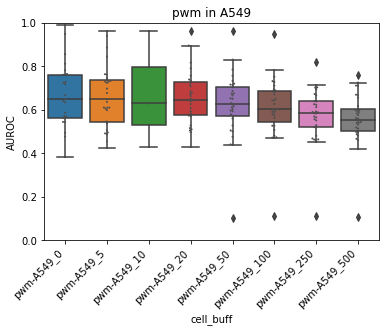

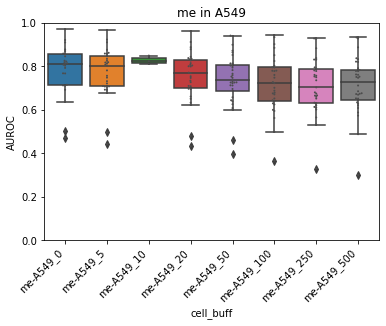

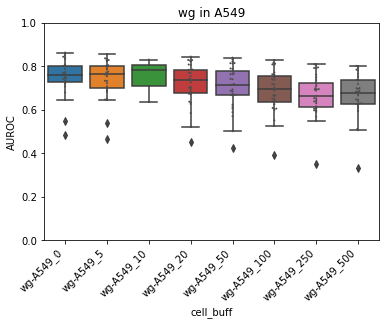

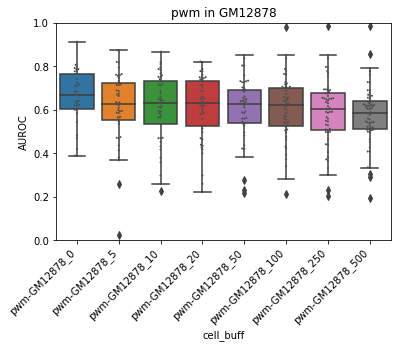

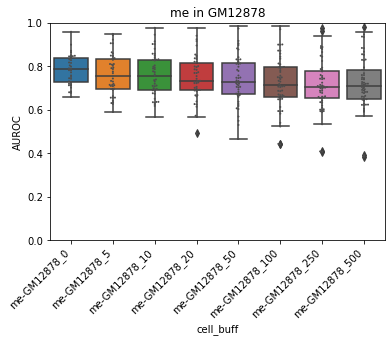

...

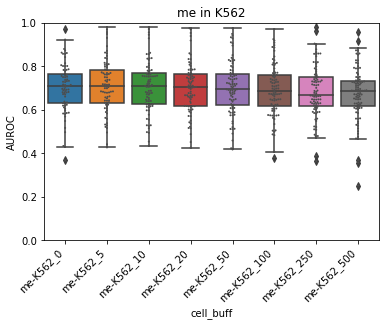

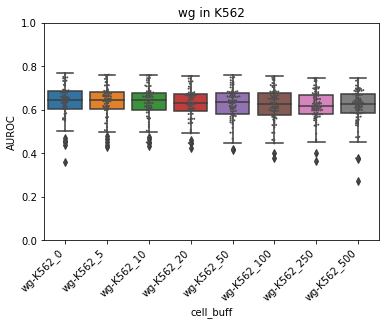

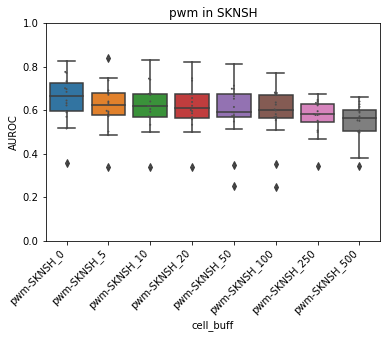

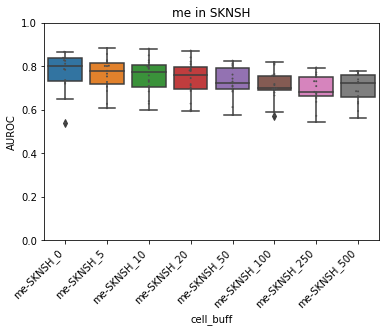

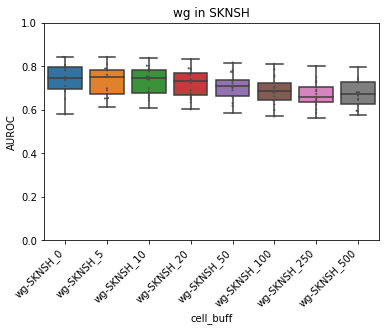

In [8]:
indir1='../../pc/redmo/data/MotifPipeline/**'
indir2='../../d/tmp/redmo/data/MotifPipeline/**'
outdir='../../pc/redmo/data/MotifPipeline'
allbox = pd.DataFrame()
traces1= glob.glob(indir1+'/test/*.txt',recursive = True)
traces2= glob.glob(indir2+'/test/*.txt',recursive = True)
traces=traces1+traces2
indices = [i for i, s in enumerate(traces) if 'camb_auroc_meltbox' in s]
method='auroc'

for jac in (indices):
    trace=traces[jac]
    if 'pc' in trace:
        buffer=(trace).split('/')[6]

    elif 'd/tmp' in trace:
        buffer=(trace).split('/')[7]
    buffer=(buffer).split('_')[3]
    buffer=(buffer).split('a')[2]

    meltbox=pd.read_csv(trace,sep='\t')
    meltbox['buffer']=buffer
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['data - cell line']+'_'+allbox['buffer'].astype(str)
from pathlib import Path
# outdir='data/MotifPipeline/compare'
Path(outdir).mkdir(parents=True, exist_ok=True)
# plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)

cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
for cell in cells: ##### aggregate across all cellines per data type
    for test in tests:
        allbox2=allbox[allbox['cell_buff'].str.contains(pat=cell)]
        allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
        allbox2.buffer=(allbox2.buffer).astype(int)
        allbox2=allbox2.sort_values(by='buffer')
        g=sns.boxplot(x='cell_buff',y=method.upper(), data=allbox2)
        g=sns.swarmplot(x='cell_buff',y=method.upper(), data=allbox2,size=2, color=".3", linewidth=0)
        g.set(ylim=(0, 1))
        g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
        g.set_title(test+' in '+cell)
        plt.show()
        plt.savefig(outdir+"camb_allbox_buff.png",dpi=300,bbox_inches = "tight")
        plt.close()
# return

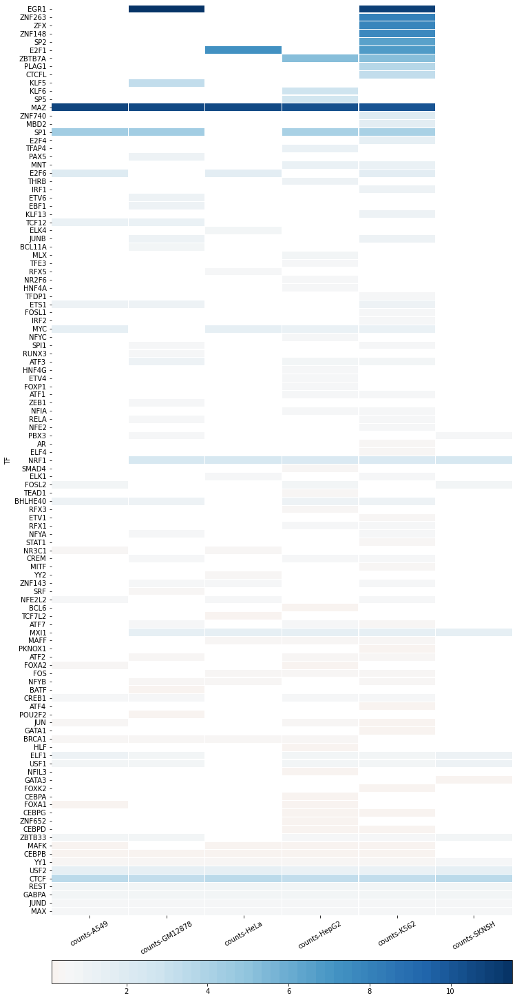

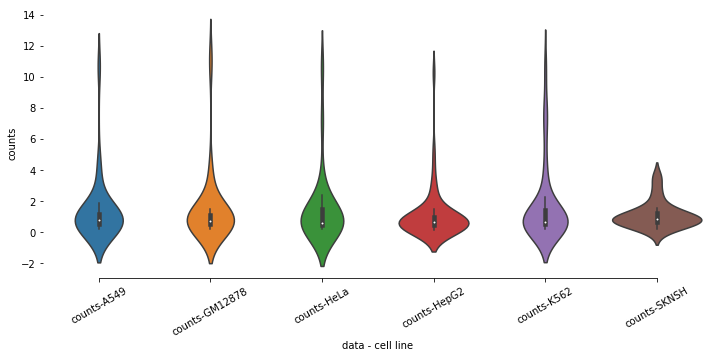

In [50]:

# aurocs.columns=['cell','TF','pwm','wgbs','array','counts']
##sum across cells and sort
heat=aurocs.pivot_table(index=['TF'], columns='cell',aggfunc='first')# heat=heat[[measure]]
heat['mean']=np.nanmean(heat,axis=1)
heat['count']=heat.isnull().sum(axis=1)

heat['weight']=heat['mean']*(heat['count'])
heat=heat.sort_values(by=['weight'],ascending=False)

heat=heat.dropna(axis=1, how='all')
del heat['count']
del heat['mean']
del heat['weight']

heat=pd.DataFrame(heat.to_records())

heat.columns=['TF','me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
              'counts-A549','counts-GM12878','counts-HeLa','counts-HepG2','counts-K562','counts-SKNSH',
              'pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
            'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']

heat=heat[['TF','counts-A549','counts-GM12878','counts-HeLa','counts-HepG2','counts-K562','counts-SKNSH']]
heat55=heat
heat=heat.set_index('TF')

plt.figure(figsize=(12, 30))
rdgn=sns.color_palette("RdBu", 100)
ax = sns.heatmap(heat/10000, center=.5,linewidth=.1,cmap=rdgn, cbar=False)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
mappable = ax.get_children()[0]
plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40
plt.xticks(rotation=30)

# plt.savefig(indir+"/test/camb_auroc_heat.png",dpi=300,bbox_inches = "tight")
plt.show

# print([(heat55['pwm-A549'].dropna().shape),(heat55['pwm-GM12878'].dropna().shape),(heat55['pwm-HeLa'].dropna().shape),(heat55['pwm-HepG2'].dropna().shape),(heat55['pwm-K562'].dropna().shape),(heat55['pwm-SKNSH'].dropna().shape)])

box=heat55
# box.columns=['TF','A549','GM12878','H1','HeLa','HepG2','K562','SKNSH']
countbox=pd.melt(box,id_vars=['TF'])
# del box.TF
# if measure=='auroc':
countbox.columns=['TF','data - cell line','counts']
plt.figure(figsize=(12, 5))
plt.xticks(rotation=30)
g=sns.violinplot(x='data - cell line',y=countbox.counts/10000, data=countbox)
# g=sns.swarmplot(x='data - cell line',y='AUROC', data=meltbox,
#               size=2, color=".3", linewidth=0)
plt.xticks(rotation=30)
# g.set(ylim=(0, 1))
# plt.savefig(indir+"/test/camb_auroc_box.png",dpi=300,bbox_inches = "tight")
countbox.to_csv(outdir+"countbox.txt")

plt.show

sns.despine(trim=True, left=True)
# plt.show()



/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/generic.py:5159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

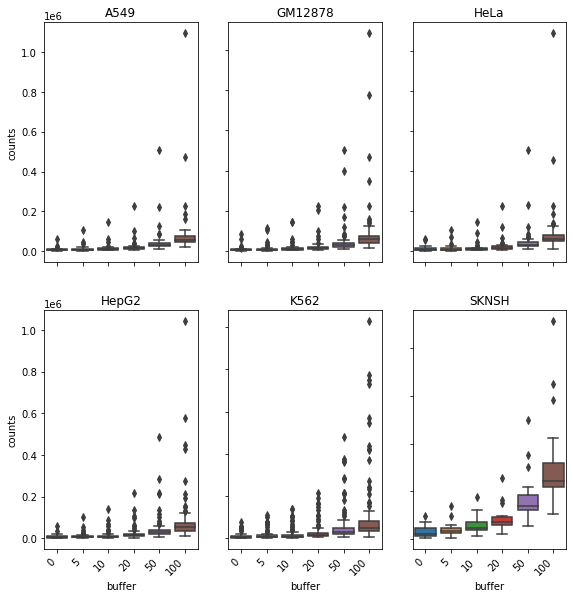

In [122]:
# indir='../../pc/redmo/data/MotifPipeline/**'

# # indir='../../pc/redmo/data/MotifPipeline/'
# # aurocs=pd.read_csv(indir+'/test/.txt',)

# # outdir='../../pc/redmo/data/MotifPipeline'
# allbox = pd.DataFrame()
# traces= glob.glob(indir+'/test/*',recursive = True)
# indices = [i for i, s in enumerate(traces) if '' in s]
# # method='auroc'


indir='../../pc/redmo/data/MotifPipeline/**'
outdir='../../pc/redmo/data/MotifPipeline'
allbox = pd.DataFrame()
traces= glob.glob(indir+'/test/*.txt',recursive = True)
indices = [i for i, s in enumerate(traces) if 'camb_PRE_window_methyl' in s]

for jac in (indices):
    trace=traces[jac]
    buffer=(trace).split('/')[6]
    buffer=(buffer).split('_')[3]
    buffer=(buffer).split('a')[2]

    meltbox=pd.read_csv(trace,sep=',',names=['cell','TF','pwm','wgbs','array','counts'])
    meltbox['buffer']=buffer
    allbox=pd.concat([allbox,meltbox],axis=0)
allbox['cell_buff']=allbox['cell']+'_'+allbox['buffer'].astype(str)
from pathlib import Path
# outdir='data/MotifPipeline/compare'
Path(outdir).mkdir(parents=True, exist_ok=True)
fig=plt.figure(figsize=(8, 8))
plt.xticks(rotation=30)
# plt.subplot(2, 2, 3)
cells=['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']
tests=['pwm','me','wg']
# for cell in (cells): ##### aggregate across all cellines per data type
#     for test in tests:
# fig, axes = plt.subplots(nrows=3, ncols=2)
fig.tight_layout()
plt.subplot(2,3,1)
allbox2=allbox[allbox['cell_buff'].str.contains(pat="A549")]
#         allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
allbox2.buffer=(allbox2.buffer).astype(int)
allbox2=allbox2.sort_values(by='buffer')
g=sns.boxplot(x='buffer',y='counts', data=allbox2)
# g=sns.swarmplot(x='cell_buff',y='counts', data=allbox2,size=2, color=".3", linewidth=0)
#     g.set(ylim=(0, 1))
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
g.set_title('A549')
# g.set_yticklabels([])
g.set_xticklabels([])
# g.set_ylabel([])
g.set_xlabel('')

plt.subplot(2,3,2)
allbox2=allbox[allbox['cell_buff'].str.contains(pat="GM12878")]
#         allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
allbox2.buffer=(allbox2.buffer).astype(int)
allbox2=allbox2.sort_values(by='buffer')
g=sns.boxplot(x='buffer',y='counts', data=allbox2)
# g=sns.swarmplot(x='cell_buff',y='counts', data=allbox2,size=2, color=".3", linewidth=0)
#     g.set(ylim=(0, 1))
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
g.set_title('GM12878')
g.set_yticklabels([])
g.set_xticklabels([])
g.set_ylabel('')
g.set_xlabel('')

plt.subplot(2,3,3)
allbox2=allbox[allbox['cell_buff'].str.contains(pat="HeLa")]
#         allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
allbox2.buffer=(allbox2.buffer).astype(int)
allbox2=allbox2.sort_values(by='buffer')
g=sns.boxplot(x='buffer',y='counts', data=allbox2)
# g=sns.swarmplot(x='cell_buff',y='counts', data=allbox2,size=2, color=".3", linewidth=0)
#     g.set(ylim=(0, 1))
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
g.set_title('HeLa')
g.set_yticklabels([])
g.set_xticklabels([])
g.set_ylabel('')
g.set_xlabel('')

plt.subplot(2,3,4)
allbox2=allbox[allbox['cell_buff'].str.contains(pat="HepG2")]
#         allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
allbox2.buffer=(allbox2.buffer).astype(int)
allbox2=allbox2.sort_values(by='buffer')
g=sns.boxplot(x='buffer',y='counts', data=allbox2)
# g=sns.swarmplot(x='cell_buff',y='counts', data=allbox2,size=2, color=".3", linewidth=0)
#     g.set(ylim=(0, 1))
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
g.set_title('HepG2')
# g.set_yticklabels([])
# g.set_xticklabels([])
# g.set_ylabel([])
# g.set_xlabel([])

plt.subplot(2,3,5)
allbox2=allbox[allbox['cell_buff'].str.contains(pat="K562")]
#         allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
allbox2.buffer=(allbox2.buffer).astype(int)
allbox2=allbox2.sort_values(by='buffer')
g=sns.boxplot(x='buffer',y='counts', data=allbox2)
# g=sns.swarmplot(x='cell_buff',y='counts', data=allbox2,size=2, color=".3", linewidth=0)
#     g.set(ylim=(0, 1))
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
g.set_title('K562')
g.set_yticklabels([])
# g.set_xticklabels([])
g.set_ylabel('')
# g.set_xlabel([])

plt.subplot(2,3,6)
allbox2=allbox[allbox['cell_buff'].str.contains(pat="SKNSH")]
#         allbox2=allbox2[allbox2['cell_buff'].str.contains(pat=test)]
allbox2.buffer=(allbox2.buffer).astype(int)
allbox2=allbox2.sort_values(by='buffer')
g=sns.boxplot(x='buffer',y='counts', data=allbox2)
# g=sns.swarmplot(x='cell_buff',y='counts', data=allbox2,size=2, color=".3", linewidth=0)
#     g.set(ylim=(0, 1))
g.set_xticklabels(g.get_xticklabels(), rotation=45, horizontalalignment='right')
g.set_title('SKNSH')
g.set_yticklabels([])
# g.set_xticklabels([])
g.set_ylabel('')
# g.set_xlabel([])

plt.show()
plt.savefig(outdir+"camb_allbox_buff.png",dpi=300,bbox_inches = "tight")
plt.close()
# return

## promoter centric analysis and functions

/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


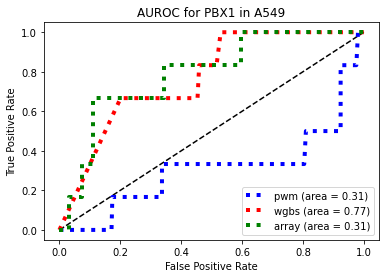

AUROC calculated for PBX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


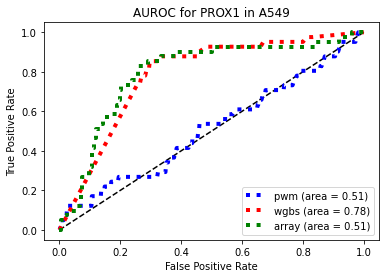

AUROC calculated for PROX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


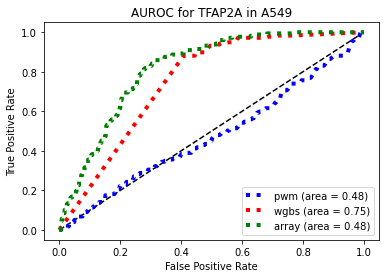

AUROC calculated for TFAP2A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


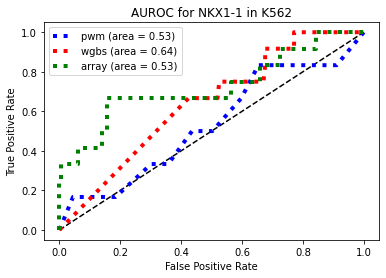

AUROC calculated for NKX1-1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


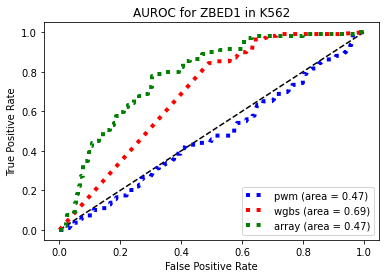

AUROC calculated for ZBED1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


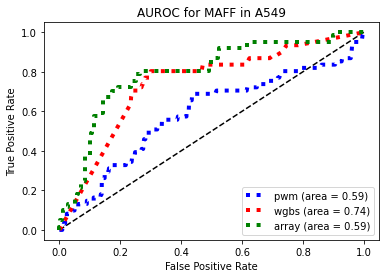

AUROC calculated for MAFF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


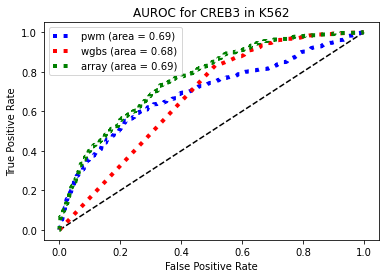

AUROC calculated for CREB3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


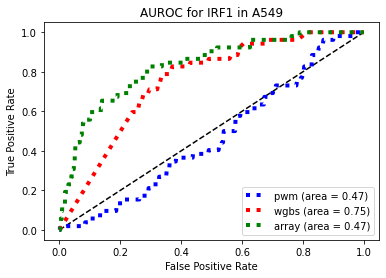

AUROC calculated for IRF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


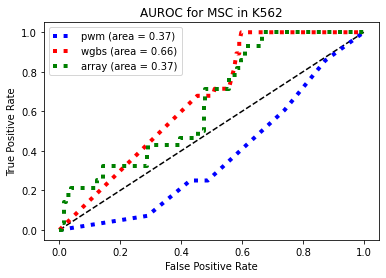

AUROC calculated for MSC in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


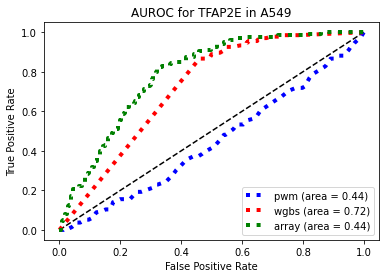

AUROC calculated for TFAP2E in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

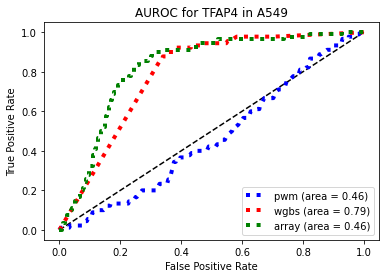

AUROC calculated for TFAP4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

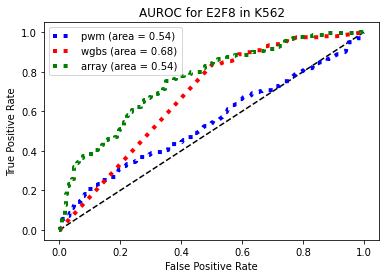

AUROC calculated for E2F8 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


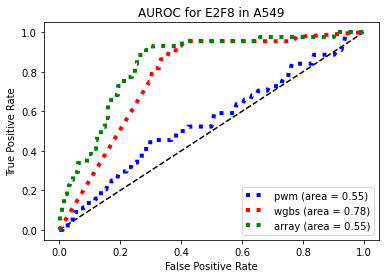

AUROC calculated for E2F8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


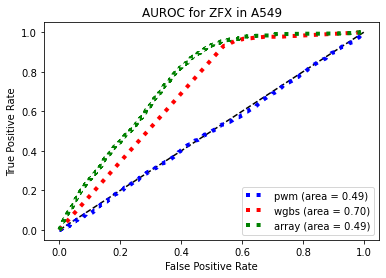

AUROC calculated for ZFX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


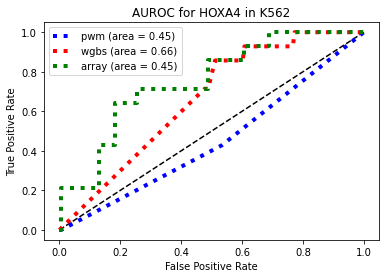

AUROC calculated for HOXA4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


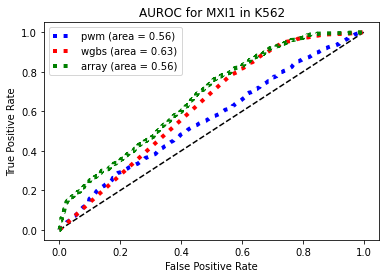

AUROC calculated for MXI1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


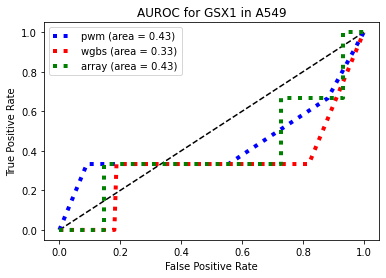

AUROC calculated for GSX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


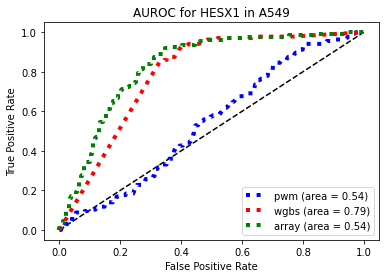

AUROC calculated for HESX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

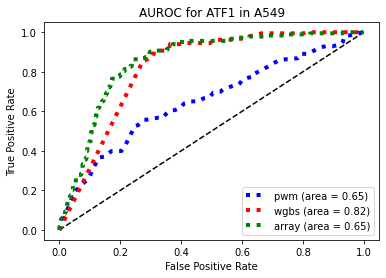

AUROC calculated for ATF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

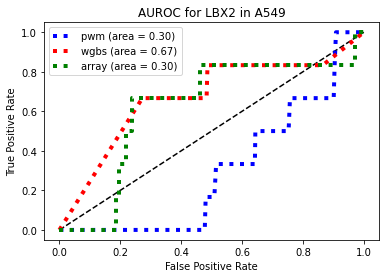

AUROC calculated for LBX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


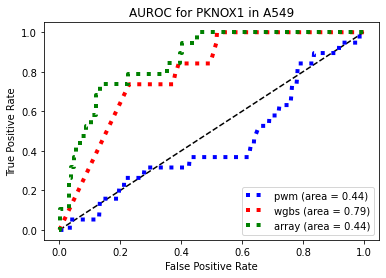

AUROC calculated for PKNOX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


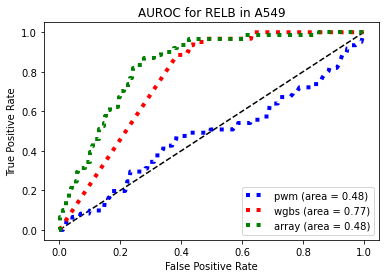

AUROC calculated for RELB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


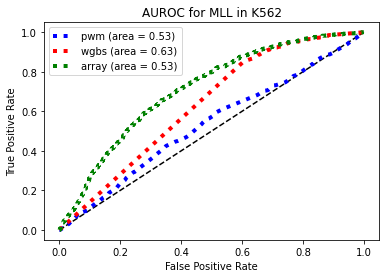

AUROC calculated for MLL in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


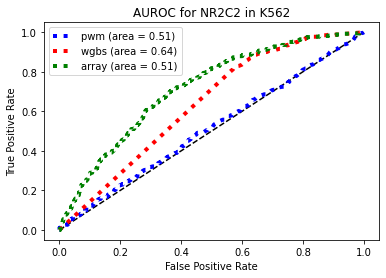

AUROC calculated for NR2C2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


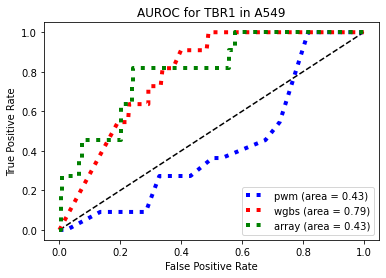

AUROC calculated for TBR1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

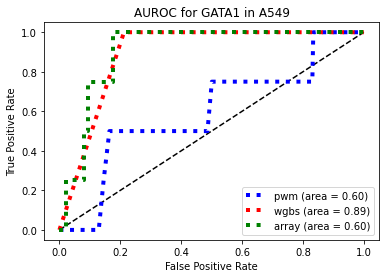

AUROC calculated for GATA1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


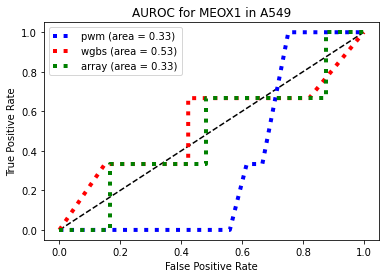

AUROC calculated for MEOX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


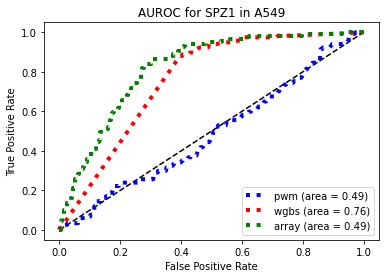

AUROC calculated for SPZ1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

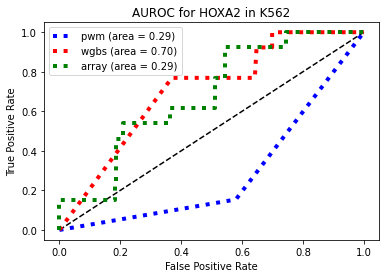

AUROC calculated for HOXA2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


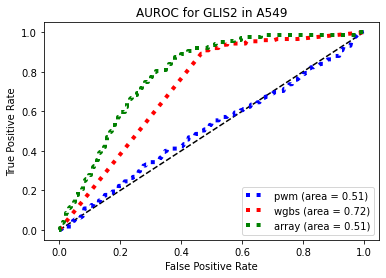

AUROC calculated for GLIS2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

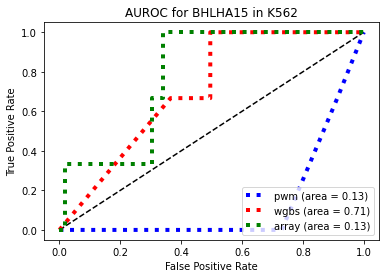

AUROC calculated for BHLHA15 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


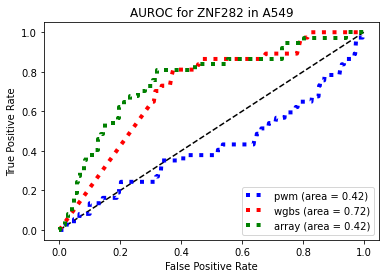

AUROC calculated for ZNF282 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


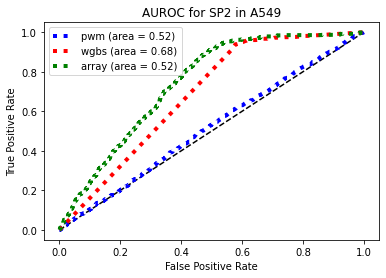

AUROC calculated for SP2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


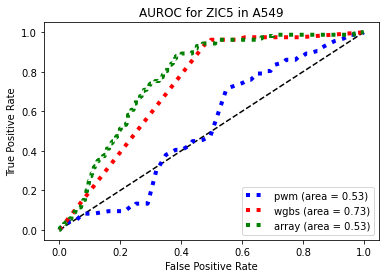

AUROC calculated for ZIC5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


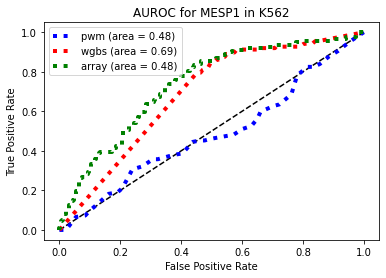

AUROC calculated for MESP1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


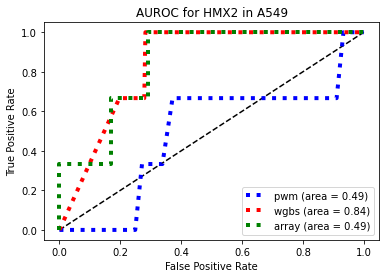

AUROC calculated for HMX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


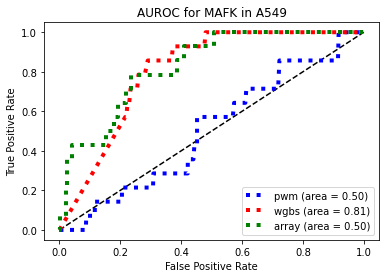

AUROC calculated for MAFK in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


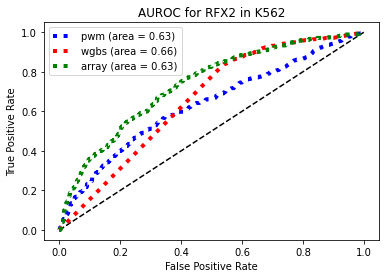

AUROC calculated for RFX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


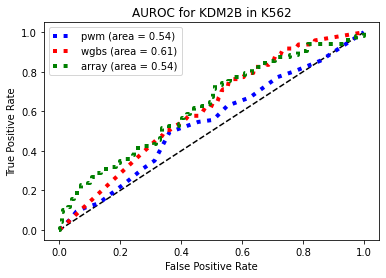

AUROC calculated for KDM2B in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


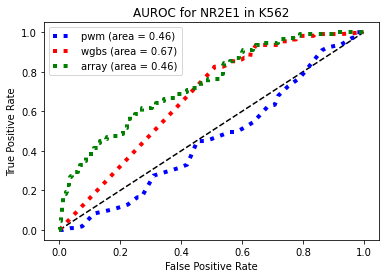

AUROC calculated for NR2E1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


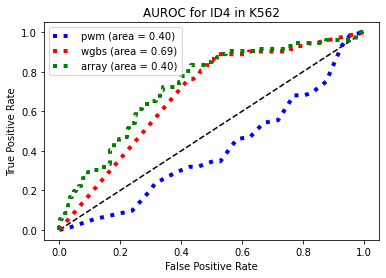

AUROC calculated for ID4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


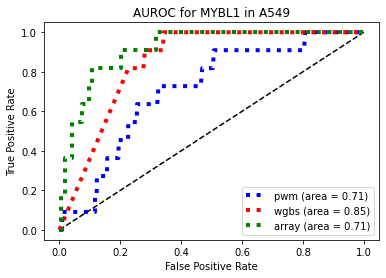

AUROC calculated for MYBL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


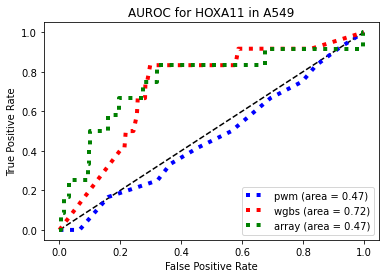

AUROC calculated for HOXA11 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


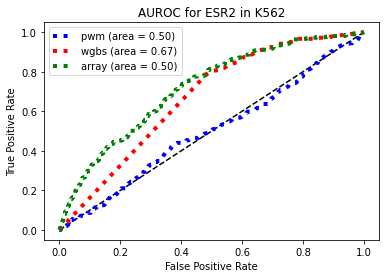

AUROC calculated for ESR2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


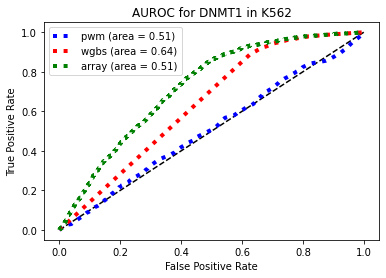

AUROC calculated for DNMT1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


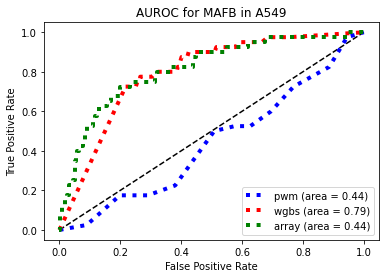

AUROC calculated for MAFB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


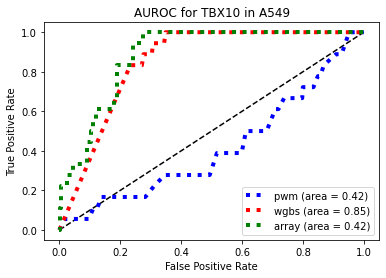

AUROC calculated for TBX10 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


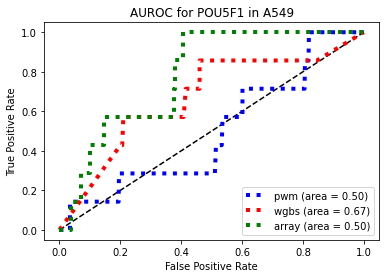

AUROC calculated for POU5F1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


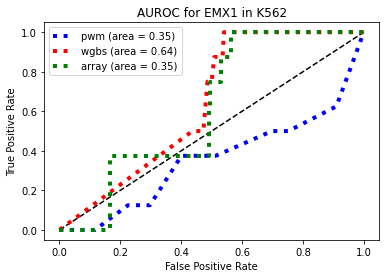

AUROC calculated for EMX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


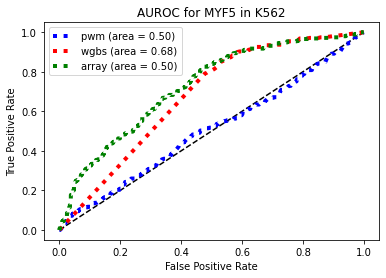

AUROC calculated for MYF5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


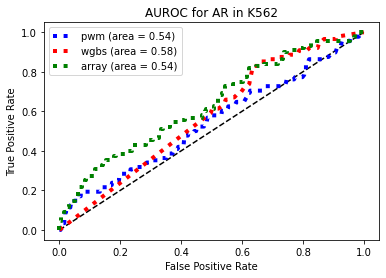

AUROC calculated for AR in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

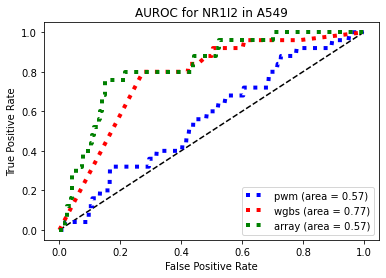

AUROC calculated for NR1I2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


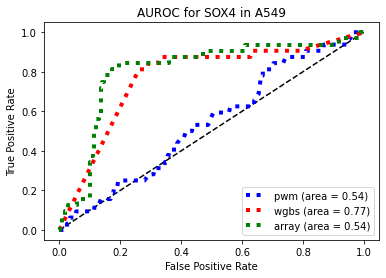

AUROC calculated for SOX4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

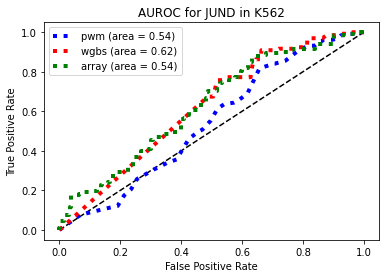

AUROC calculated for JUND in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


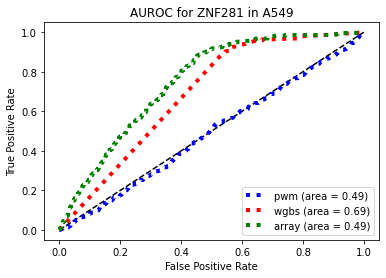

AUROC calculated for ZNF281 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


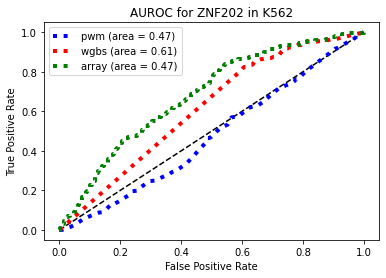

AUROC calculated for ZNF202 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


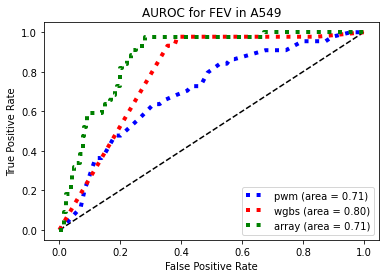

AUROC calculated for FEV in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


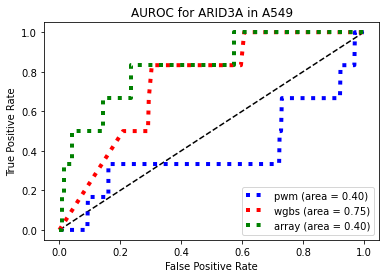

AUROC calculated for ARID3A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


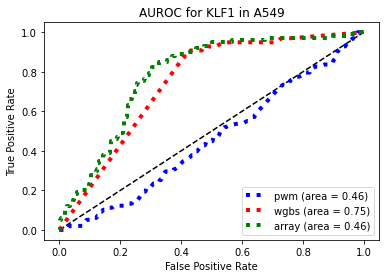

AUROC calculated for KLF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


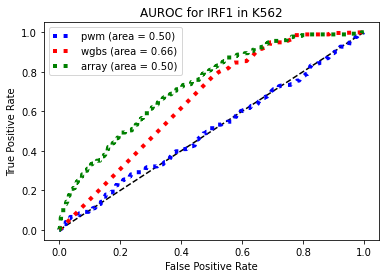

AUROC calculated for IRF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


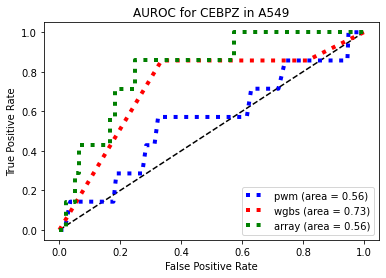

AUROC calculated for CEBPZ in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


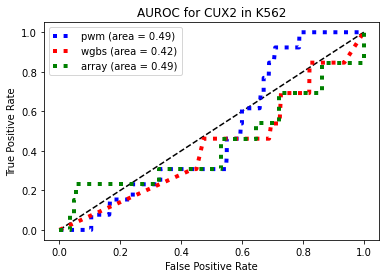

AUROC calculated for CUX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


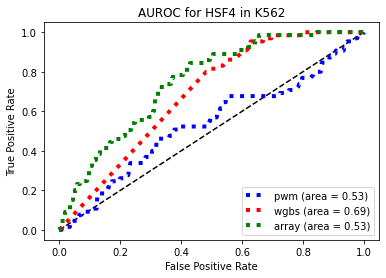

AUROC calculated for HSF4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


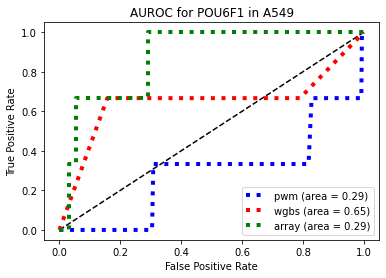

AUROC calculated for POU6F1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


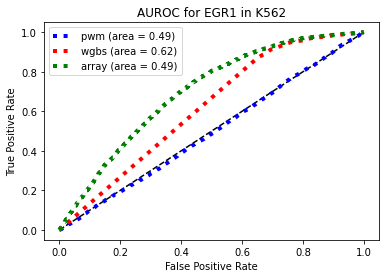

AUROC calculated for EGR1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


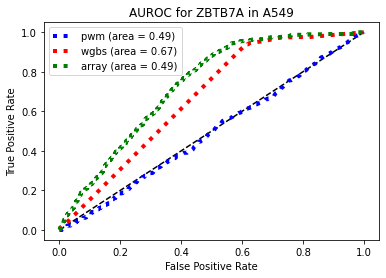

AUROC calculated for ZBTB7A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


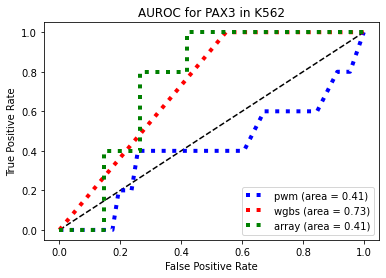

AUROC calculated for PAX3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


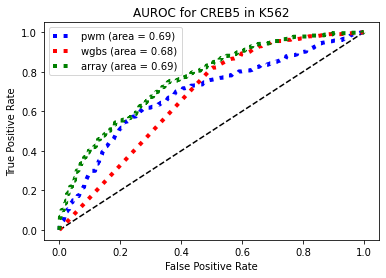

AUROC calculated for CREB5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


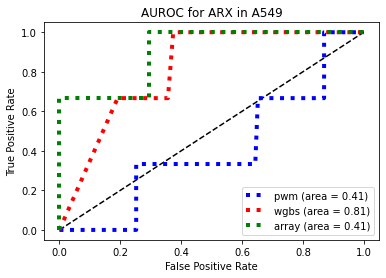

AUROC calculated for ARX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


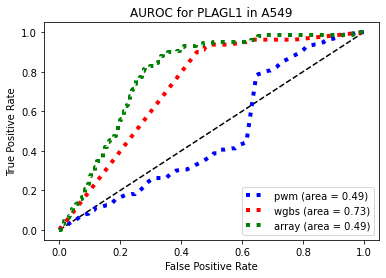

AUROC calculated for PLAGL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

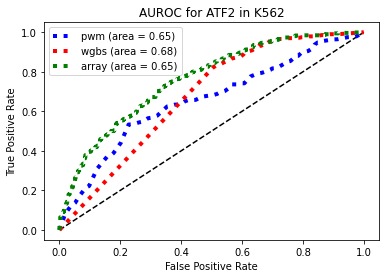

AUROC calculated for ATF2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

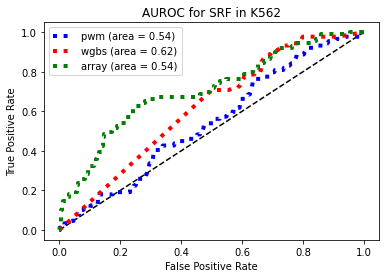

AUROC calculated for SRF in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


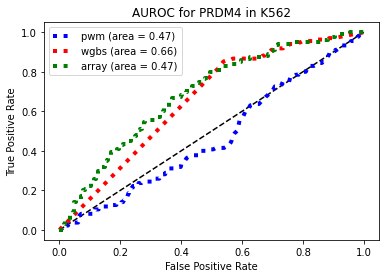

AUROC calculated for PRDM4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


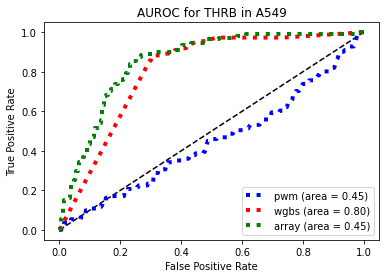

AUROC calculated for THRB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


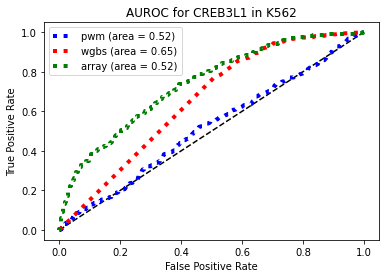

AUROC calculated for CREB3L1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


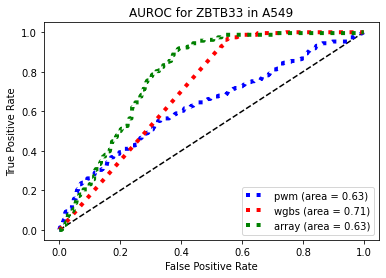

AUROC calculated for ZBTB33 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


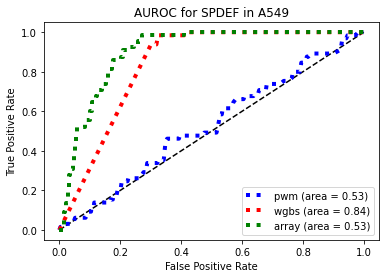

AUROC calculated for SPDEF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

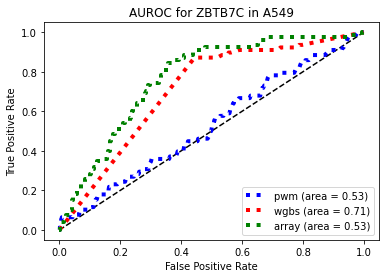

AUROC calculated for ZBTB7C in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


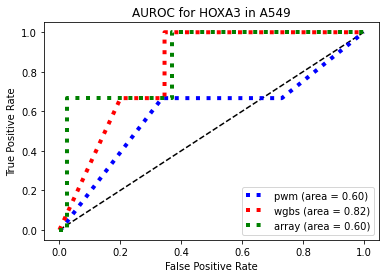

AUROC calculated for HOXA3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


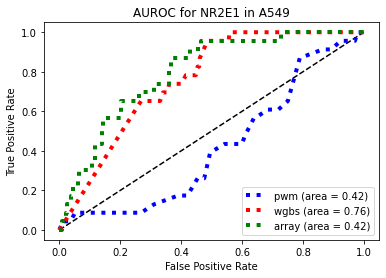

AUROC calculated for NR2E1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


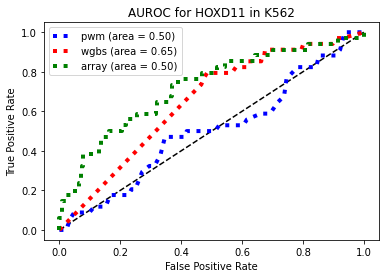

AUROC calculated for HOXD11 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


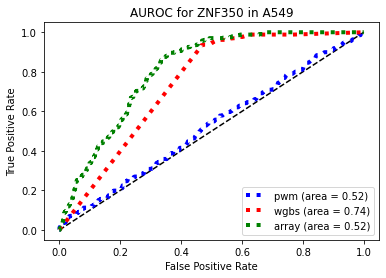

AUROC calculated for ZNF350 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


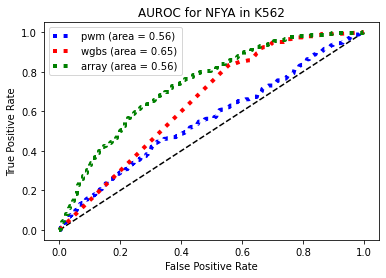

AUROC calculated for NFYA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


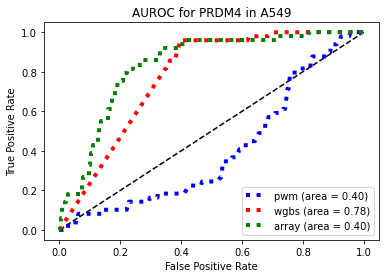

AUROC calculated for PRDM4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


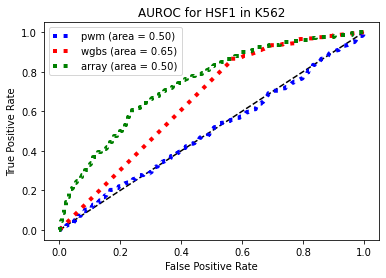

AUROC calculated for HSF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


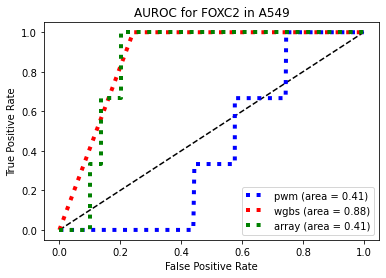

AUROC calculated for FOXC2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


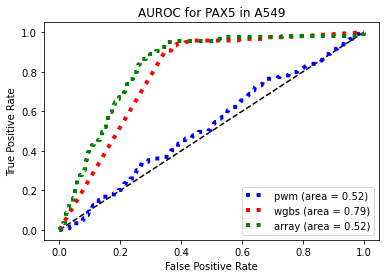

AUROC calculated for PAX5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


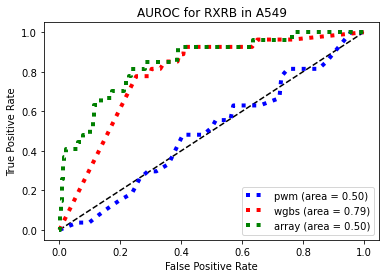

AUROC calculated for RXRB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

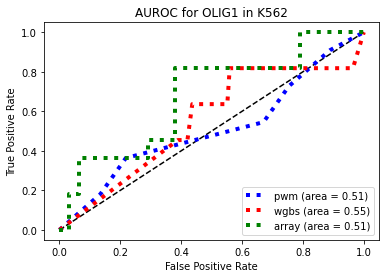

AUROC calculated for OLIG1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


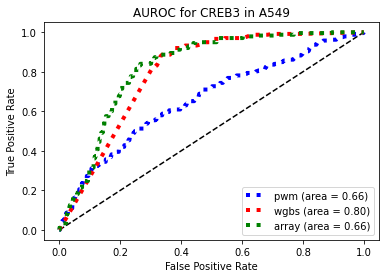

AUROC calculated for CREB3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


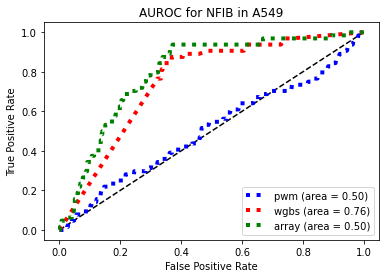

AUROC calculated for NFIB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


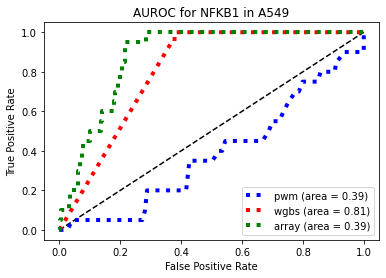

AUROC calculated for NFKB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


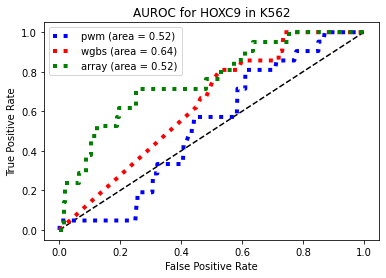

AUROC calculated for HOXC9 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

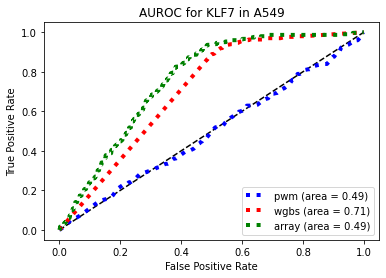

AUROC calculated for KLF7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


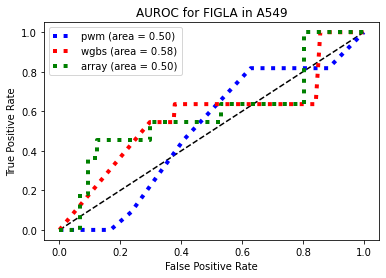

AUROC calculated for FIGLA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


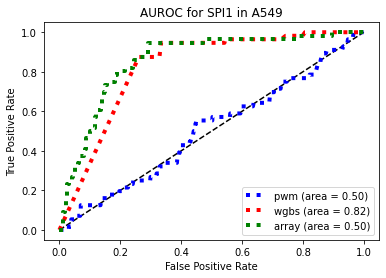

AUROC calculated for SPI1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


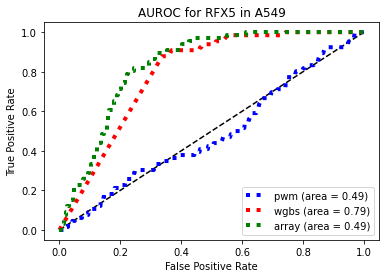

AUROC calculated for RFX5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

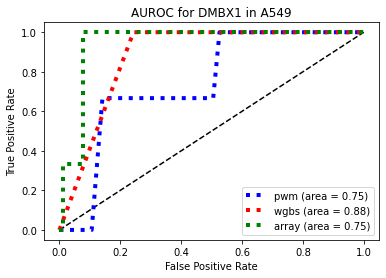

AUROC calculated for DMBX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


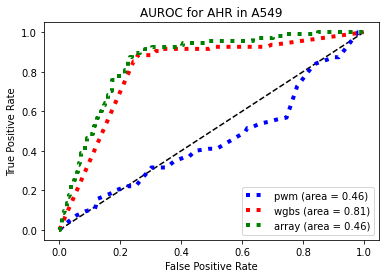

AUROC calculated for AHR in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


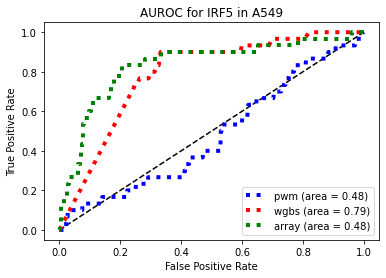

AUROC calculated for IRF5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


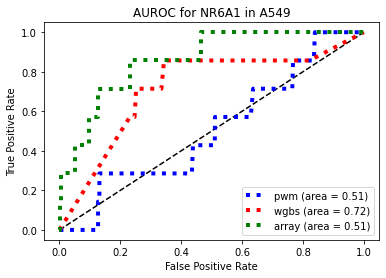

AUROC calculated for NR6A1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


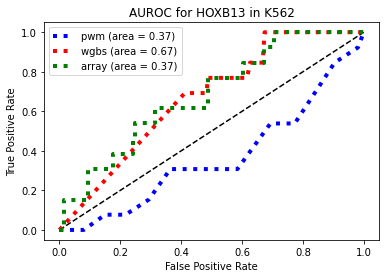

AUROC calculated for HOXB13 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


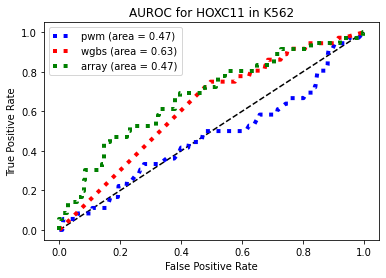

AUROC calculated for HOXC11 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


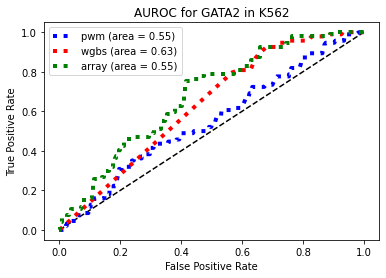

AUROC calculated for GATA2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


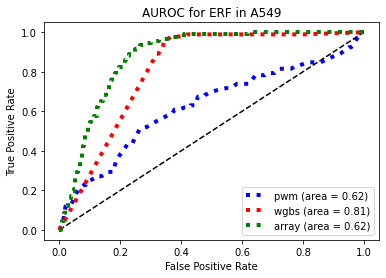

AUROC calculated for ERF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


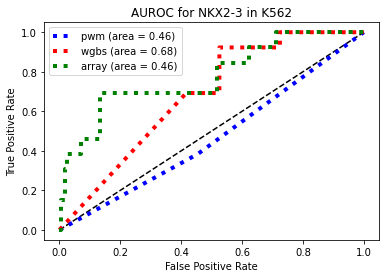

AUROC calculated for NKX2-3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


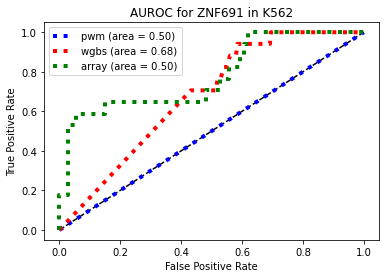

AUROC calculated for ZNF691 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

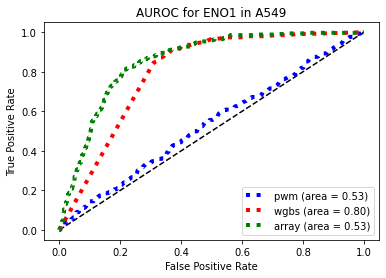

AUROC calculated for ENO1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

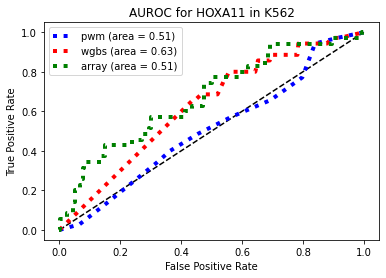

AUROC calculated for HOXA11 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


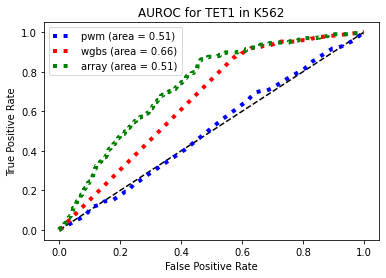

AUROC calculated for TET1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


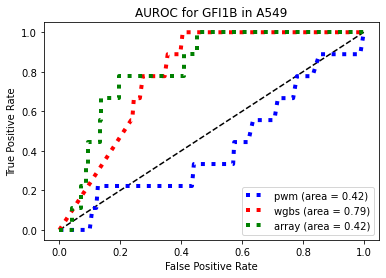

AUROC calculated for GFI1B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

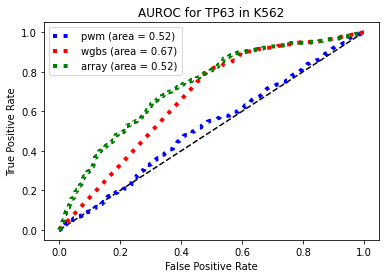

AUROC calculated for TP63 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

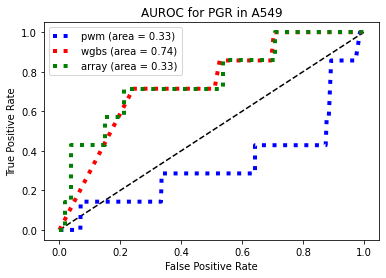

AUROC calculated for PGR in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


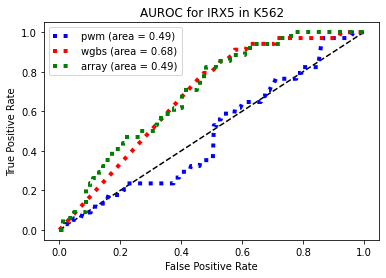

AUROC calculated for IRX5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


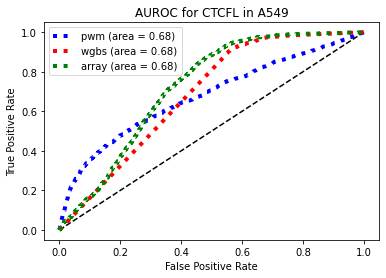

AUROC calculated for CTCFL in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

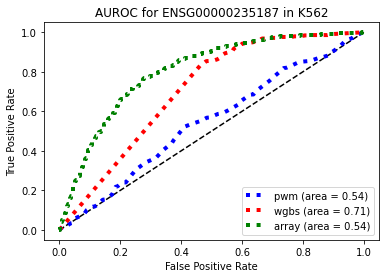

AUROC calculated for ENSG00000235187 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


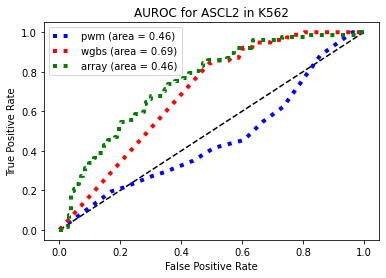

AUROC calculated for ASCL2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


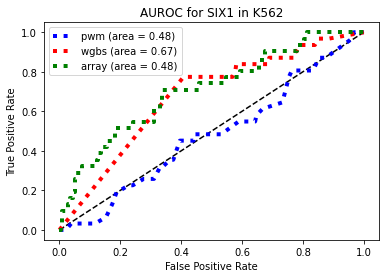

AUROC calculated for SIX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

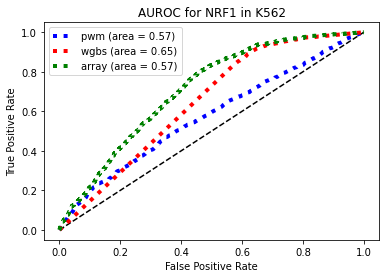

AUROC calculated for NRF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


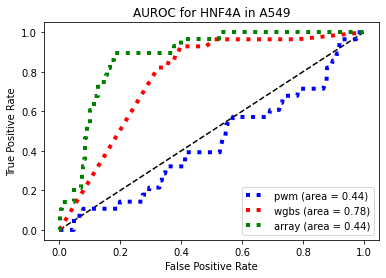

AUROC calculated for HNF4A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


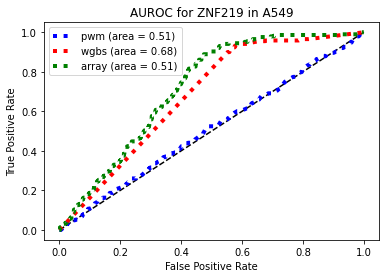

AUROC calculated for ZNF219 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


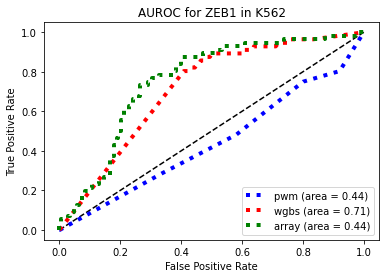

AUROC calculated for ZEB1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


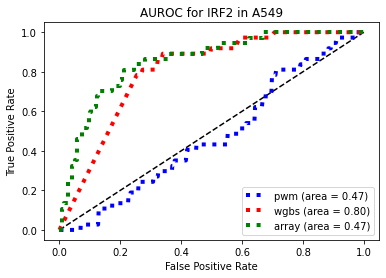

AUROC calculated for IRF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


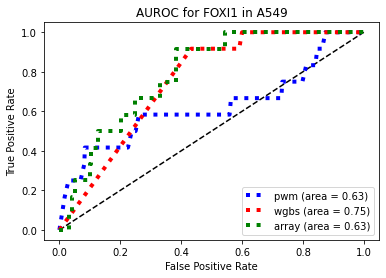

AUROC calculated for FOXI1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


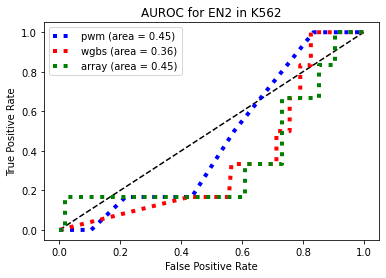

AUROC calculated for EN2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


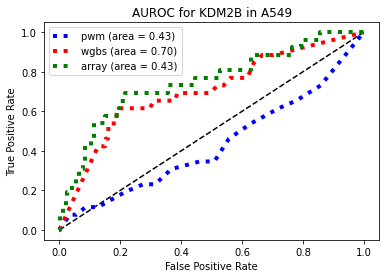

AUROC calculated for KDM2B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

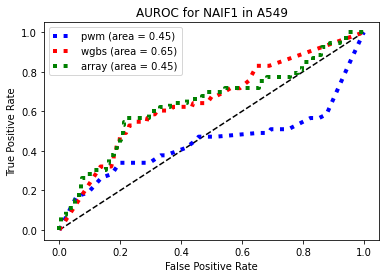

AUROC calculated for NAIF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


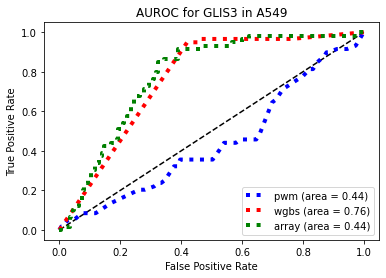

AUROC calculated for GLIS3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


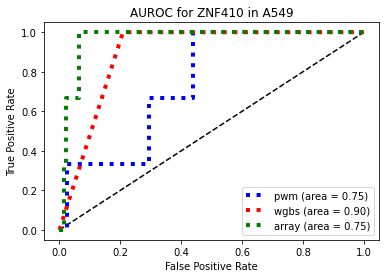

AUROC calculated for ZNF410 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


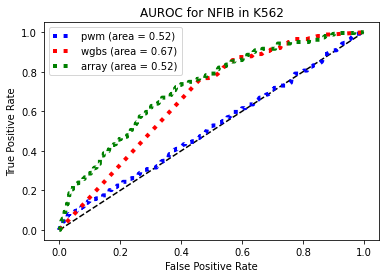

AUROC calculated for NFIB in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


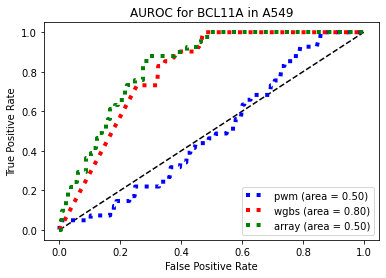

AUROC calculated for BCL11A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


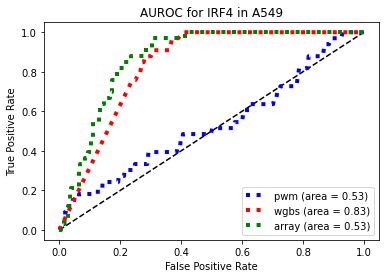

AUROC calculated for IRF4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


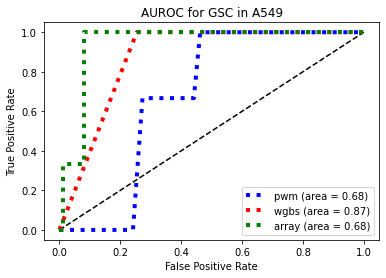

AUROC calculated for GSC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

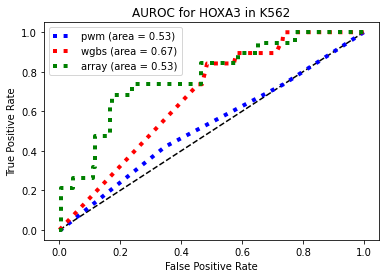

AUROC calculated for HOXA3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


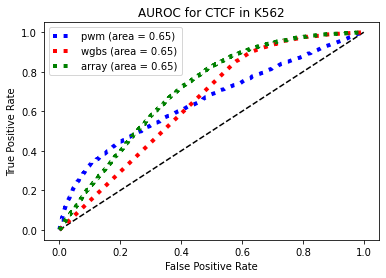

AUROC calculated for CTCF in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

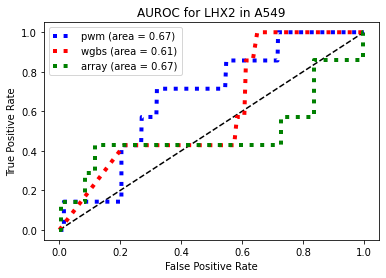

AUROC calculated for LHX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

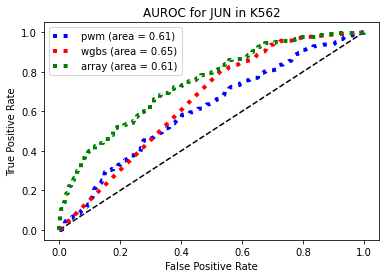

AUROC calculated for JUN in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


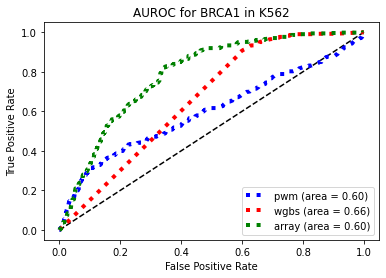

AUROC calculated for BRCA1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


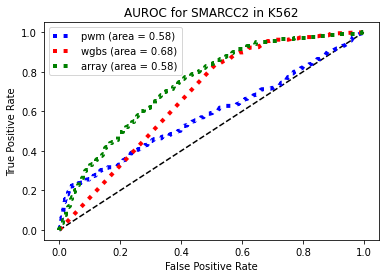

AUROC calculated for SMARCC2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


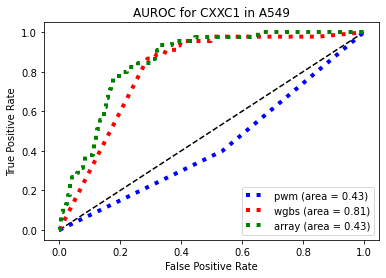

AUROC calculated for CXXC1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


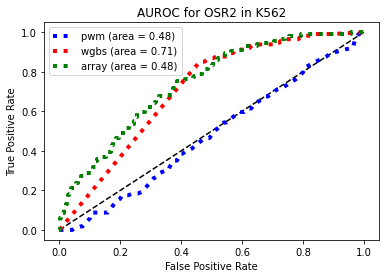

AUROC calculated for OSR2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


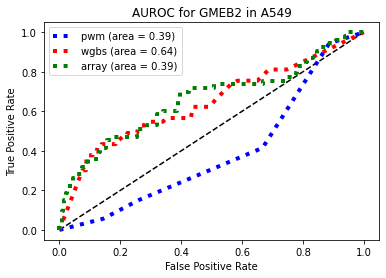

AUROC calculated for GMEB2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


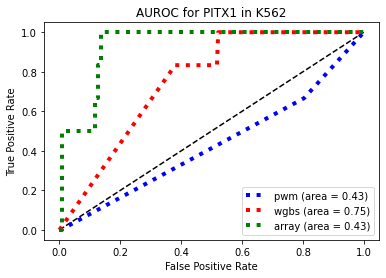

AUROC calculated for PITX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


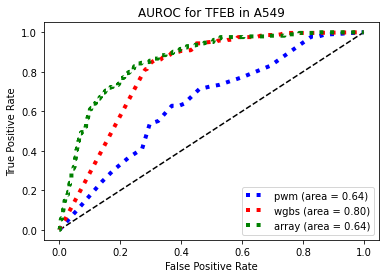

AUROC calculated for TFEB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


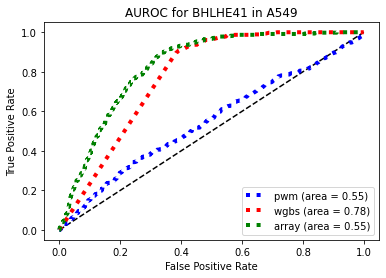

AUROC calculated for BHLHE41 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


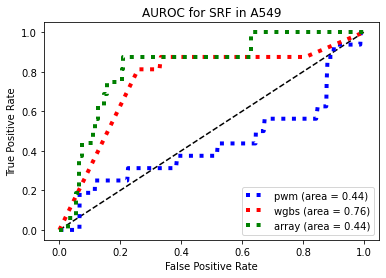

AUROC calculated for SRF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


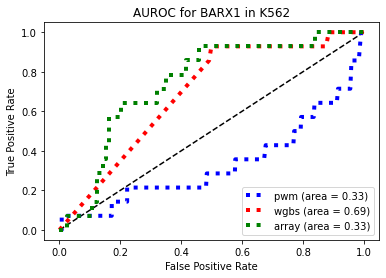

AUROC calculated for BARX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

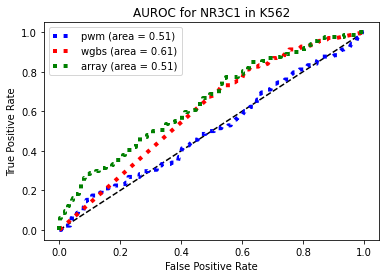

AUROC calculated for NR3C1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

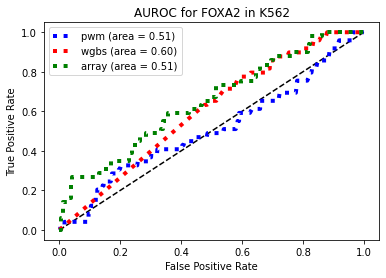

AUROC calculated for FOXA2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


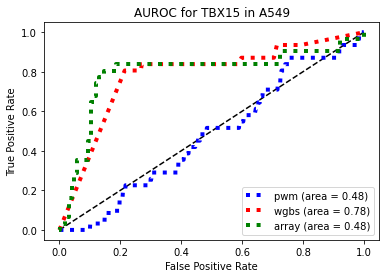

AUROC calculated for TBX15 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


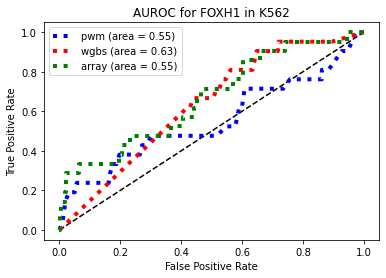

AUROC calculated for FOXH1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

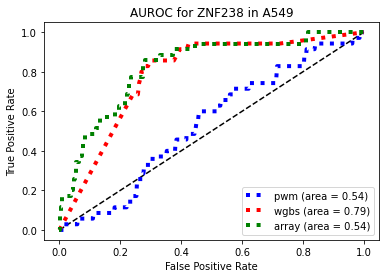

AUROC calculated for ZNF238 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


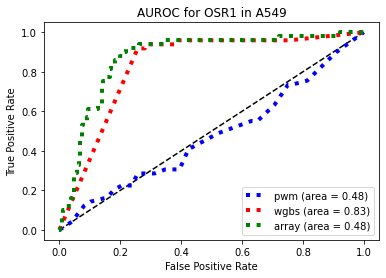

AUROC calculated for OSR1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


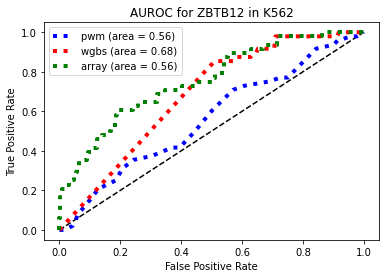

AUROC calculated for ZBTB12 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


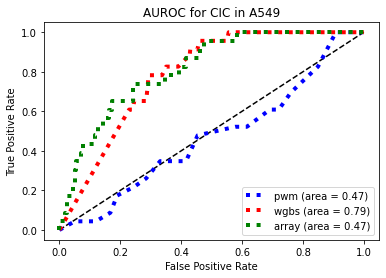

AUROC calculated for CIC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


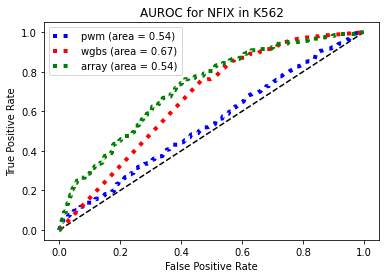

AUROC calculated for NFIX in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


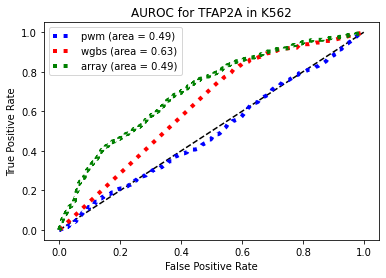

AUROC calculated for TFAP2A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


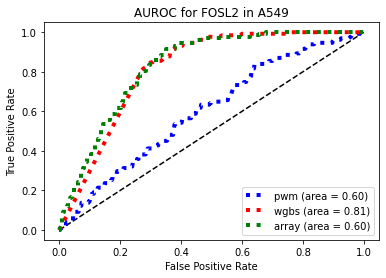

AUROC calculated for FOSL2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


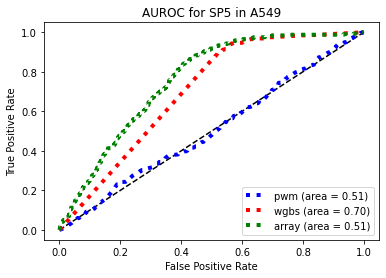

AUROC calculated for SP5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


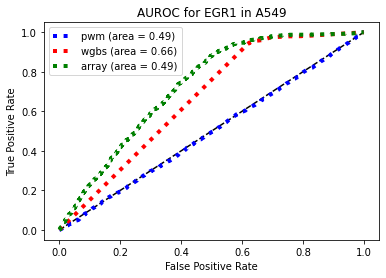

AUROC calculated for EGR1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


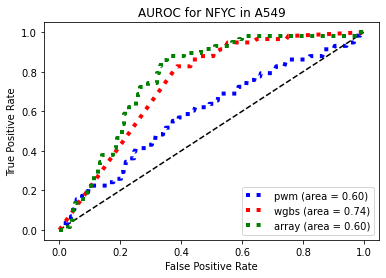

AUROC calculated for NFYC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


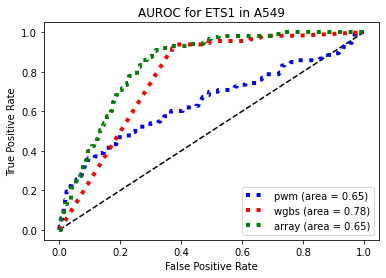

AUROC calculated for ETS1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


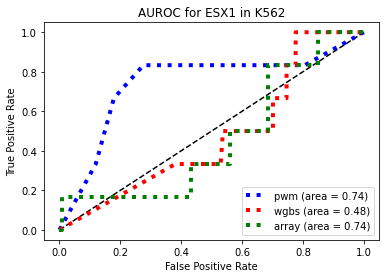

AUROC calculated for ESX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


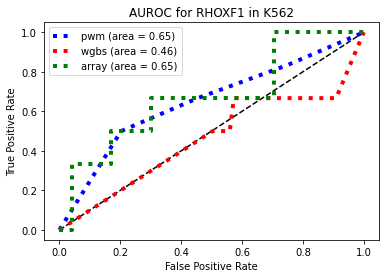

AUROC calculated for RHOXF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

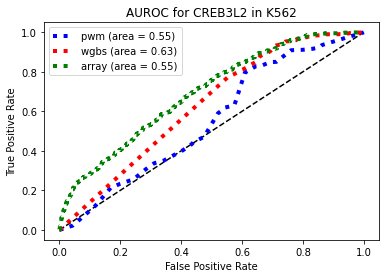

AUROC calculated for CREB3L2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


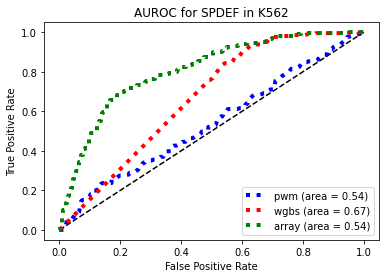

AUROC calculated for SPDEF in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


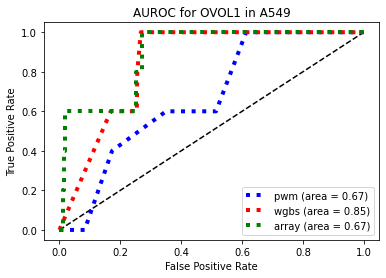

AUROC calculated for OVOL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

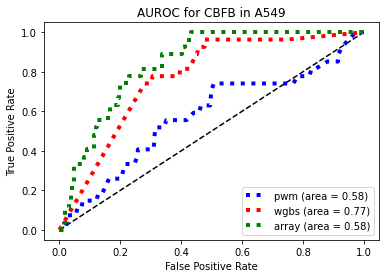

AUROC calculated for CBFB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


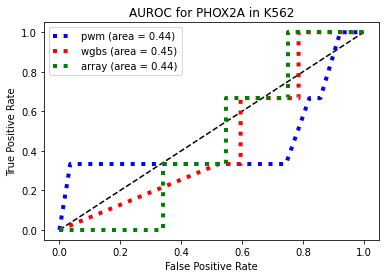

AUROC calculated for PHOX2A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


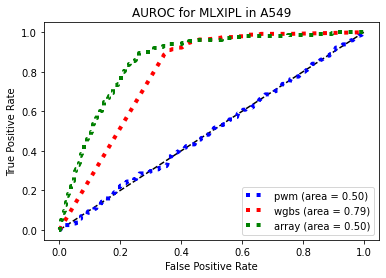

AUROC calculated for MLXIPL in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


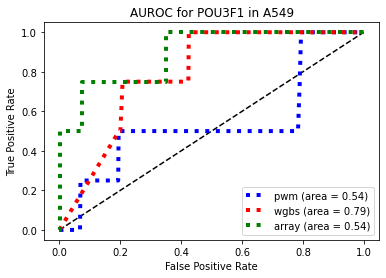

AUROC calculated for POU3F1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


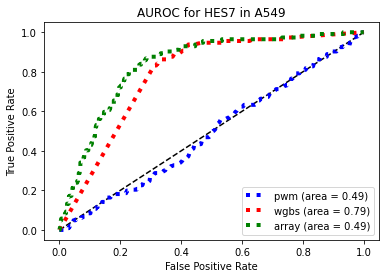

AUROC calculated for HES7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


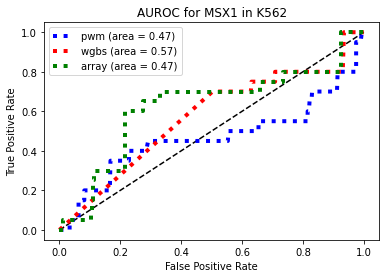

AUROC calculated for MSX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


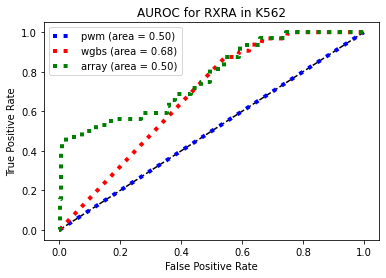

AUROC calculated for RXRA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


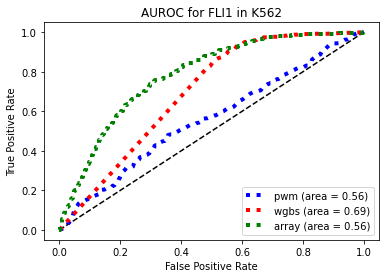

AUROC calculated for FLI1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


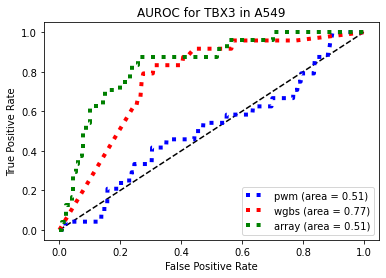

AUROC calculated for TBX3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


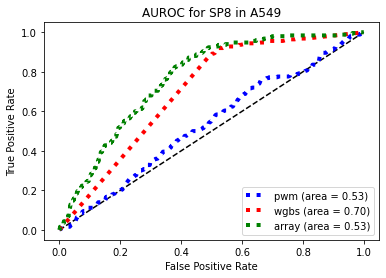

AUROC calculated for SP8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


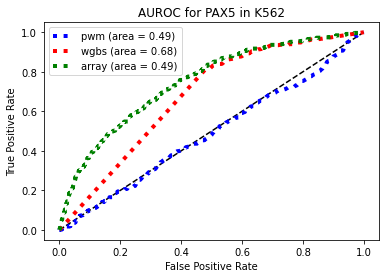

AUROC calculated for PAX5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

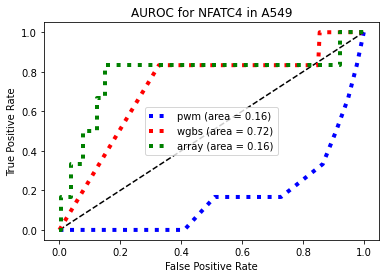

AUROC calculated for NFATC4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


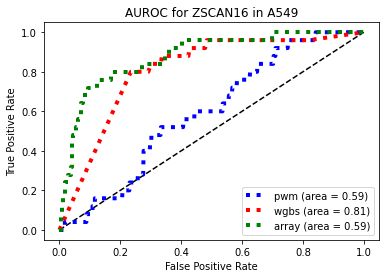

AUROC calculated for ZSCAN16 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


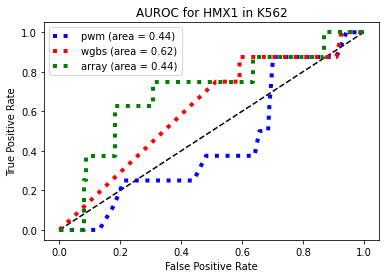

AUROC calculated for HMX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


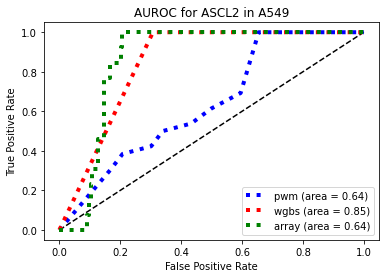

AUROC calculated for ASCL2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


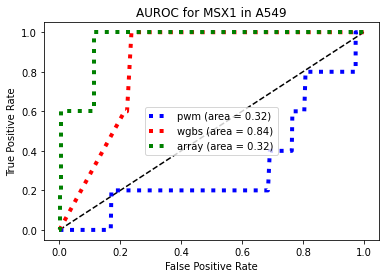

AUROC calculated for MSX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


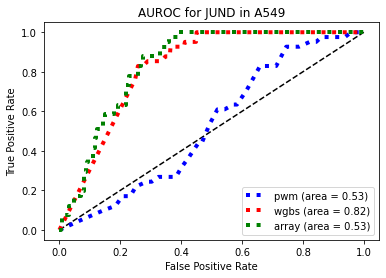

AUROC calculated for JUND in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

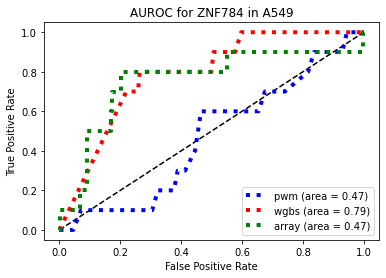

AUROC calculated for ZNF784 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

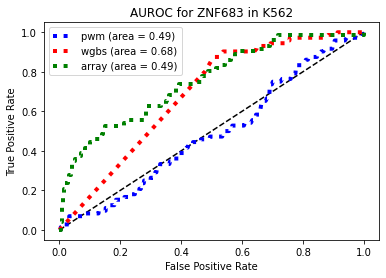

AUROC calculated for ZNF683 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


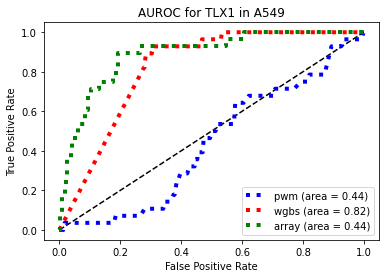

AUROC calculated for TLX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


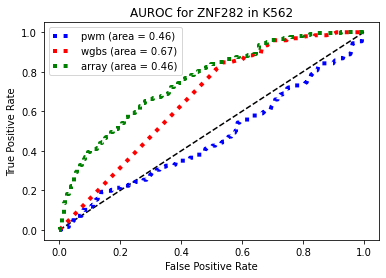

AUROC calculated for ZNF282 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


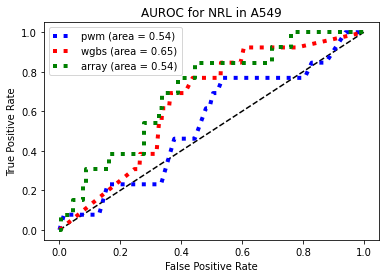

AUROC calculated for NRL in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


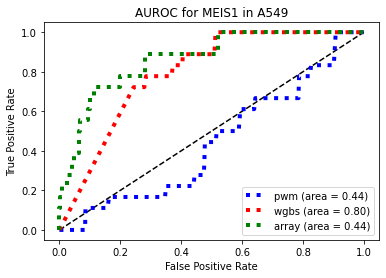

AUROC calculated for MEIS1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


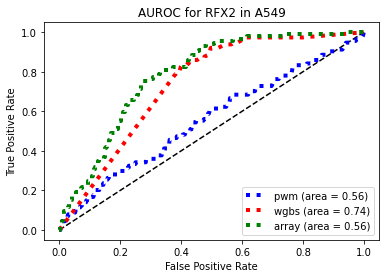

AUROC calculated for RFX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


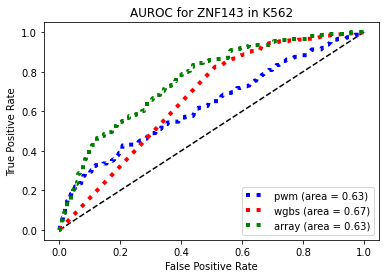

AUROC calculated for ZNF143 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


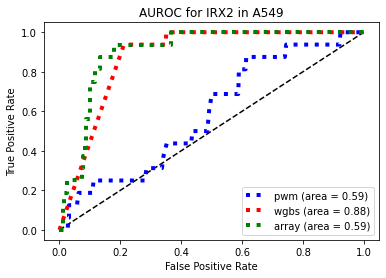

AUROC calculated for IRX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


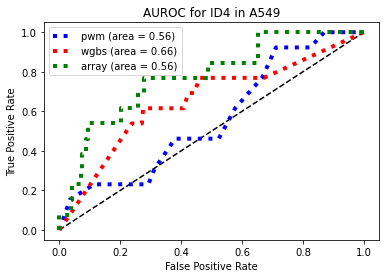

AUROC calculated for ID4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


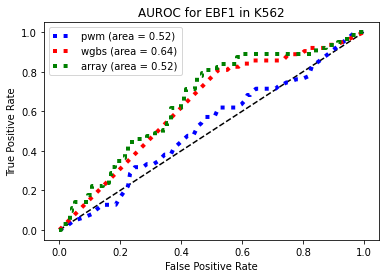

AUROC calculated for EBF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


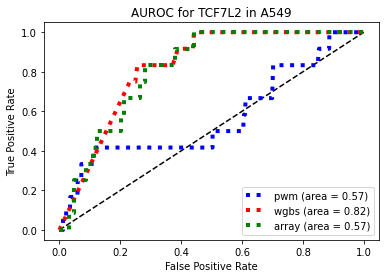

AUROC calculated for TCF7L2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


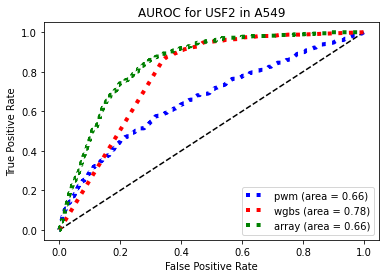

AUROC calculated for USF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


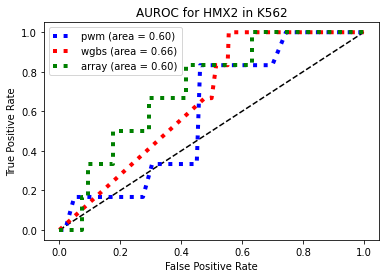

AUROC calculated for HMX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


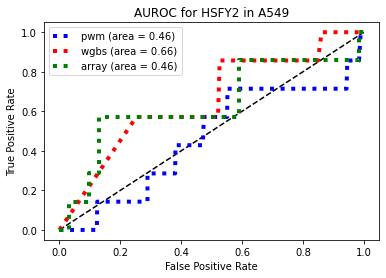

AUROC calculated for HSFY2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


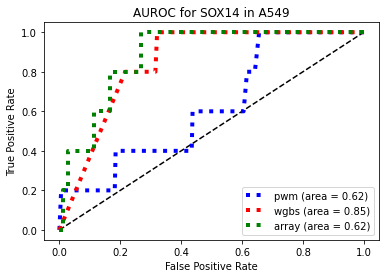

AUROC calculated for SOX14 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


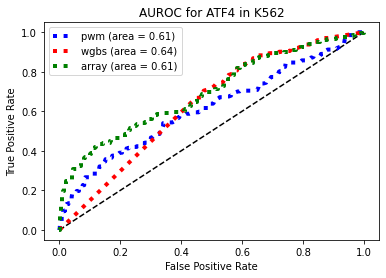

AUROC calculated for ATF4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


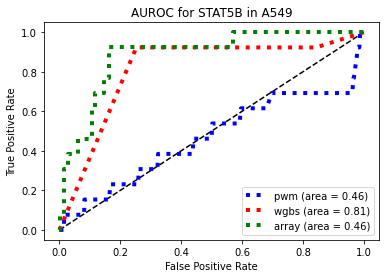

AUROC calculated for STAT5B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


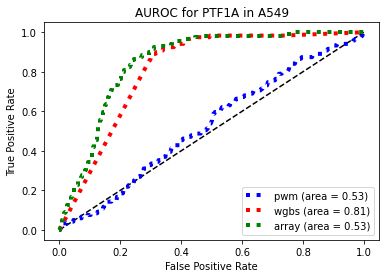

AUROC calculated for PTF1A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


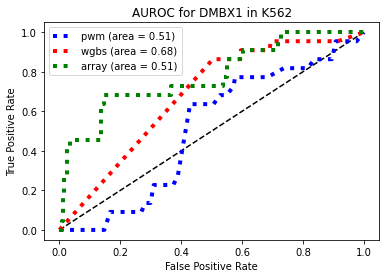

AUROC calculated for DMBX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


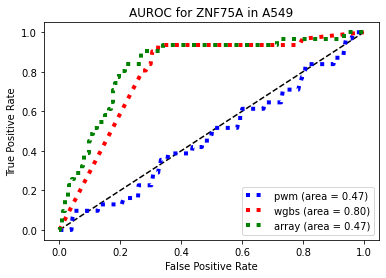

AUROC calculated for ZNF75A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


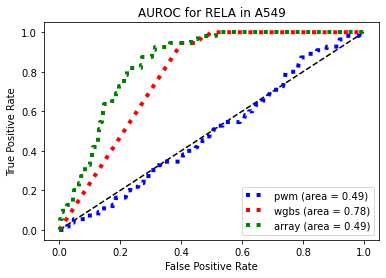

AUROC calculated for RELA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


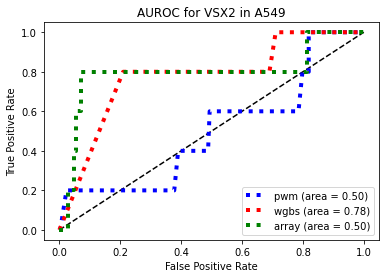

AUROC calculated for VSX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


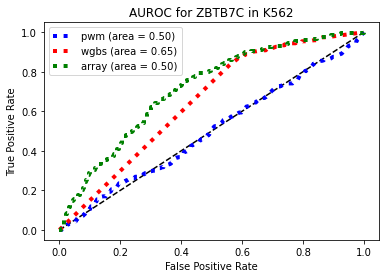

AUROC calculated for ZBTB7C in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


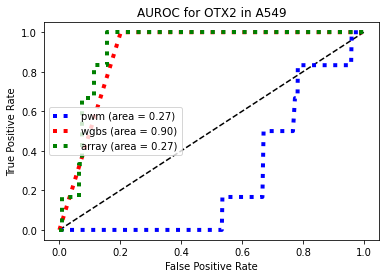

AUROC calculated for OTX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


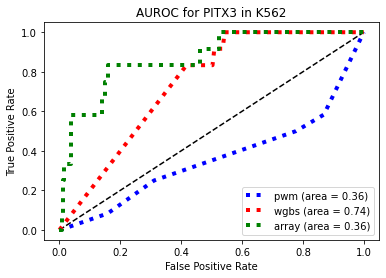

AUROC calculated for PITX3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

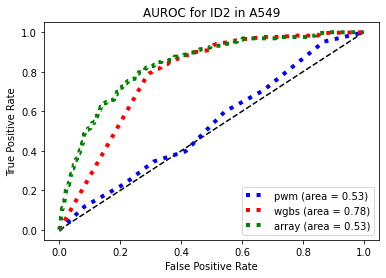

AUROC calculated for ID2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


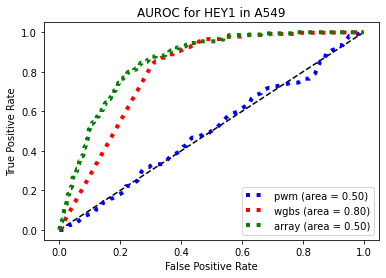

AUROC calculated for HEY1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


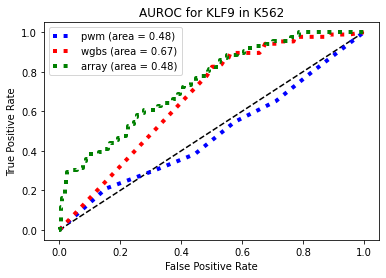

AUROC calculated for KLF9 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


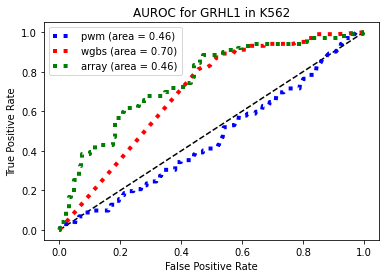

AUROC calculated for GRHL1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


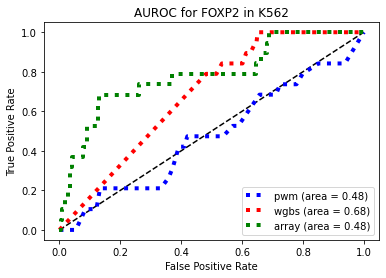

AUROC calculated for FOXP2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


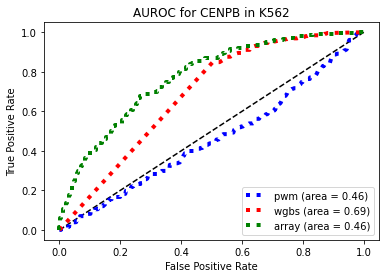

AUROC calculated for CENPB in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


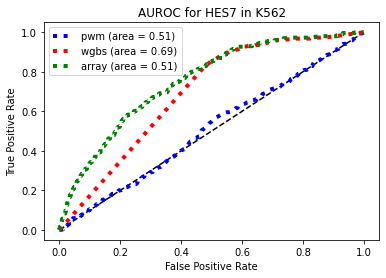

AUROC calculated for HES7 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


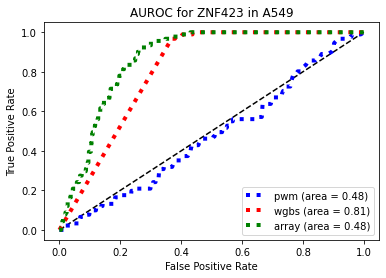

AUROC calculated for ZNF423 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


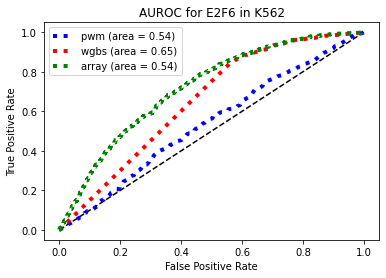

AUROC calculated for E2F6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


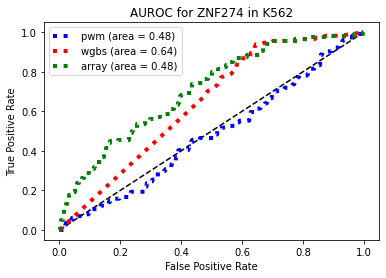

AUROC calculated for ZNF274 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


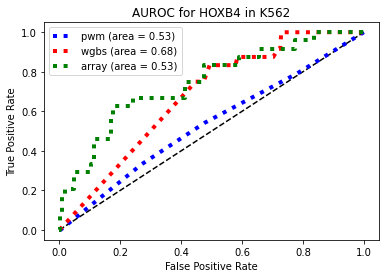

AUROC calculated for HOXB4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


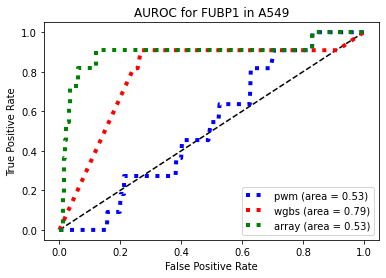

AUROC calculated for FUBP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


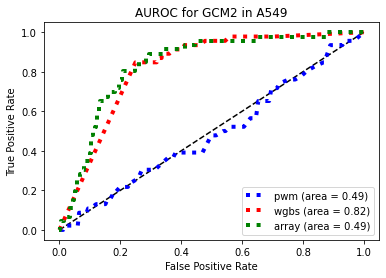

AUROC calculated for GCM2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


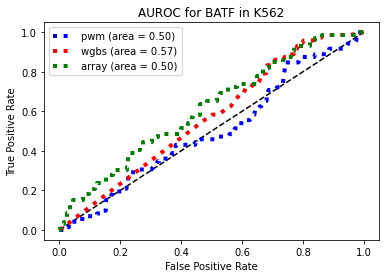

AUROC calculated for BATF in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


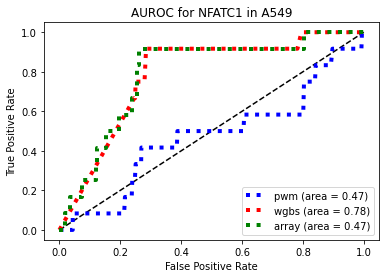

AUROC calculated for NFATC1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


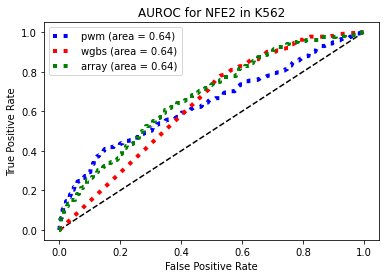

AUROC calculated for NFE2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


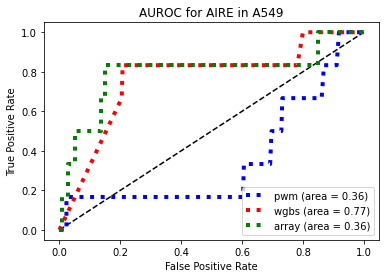

AUROC calculated for AIRE in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


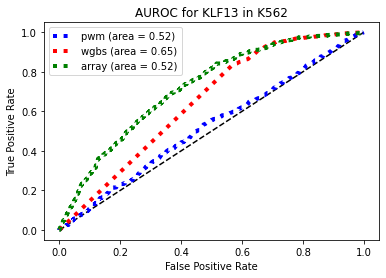

AUROC calculated for KLF13 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


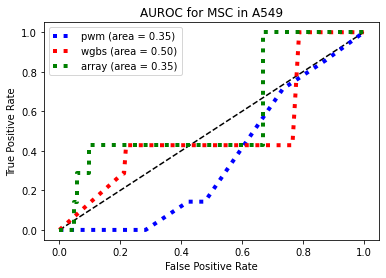

AUROC calculated for MSC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


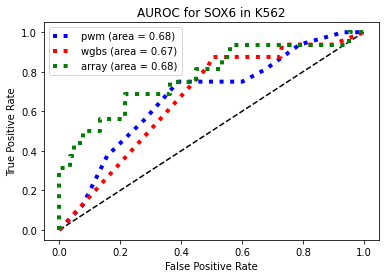

AUROC calculated for SOX6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


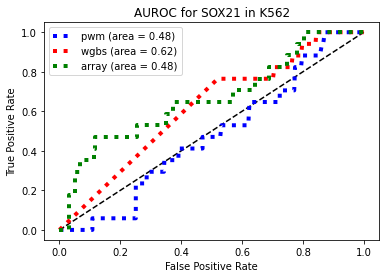

AUROC calculated for SOX21 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

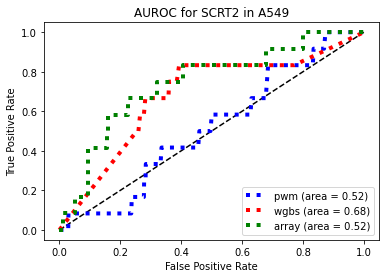

AUROC calculated for SCRT2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


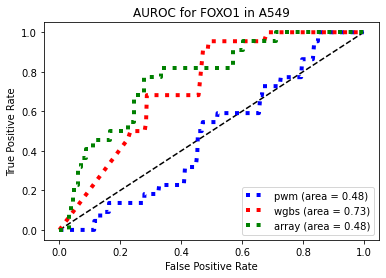

AUROC calculated for FOXO1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


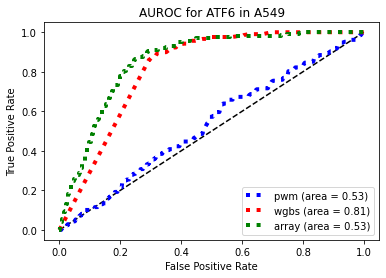

AUROC calculated for ATF6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


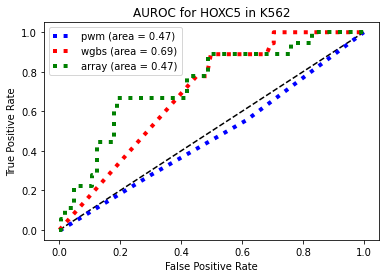

AUROC calculated for HOXC5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

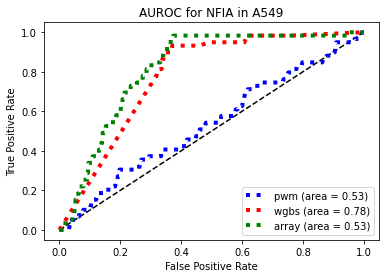

AUROC calculated for NFIA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

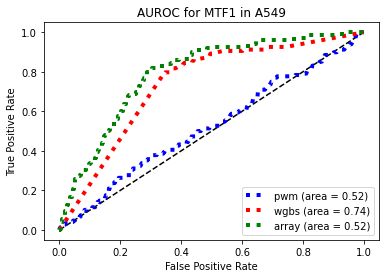

AUROC calculated for MTF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


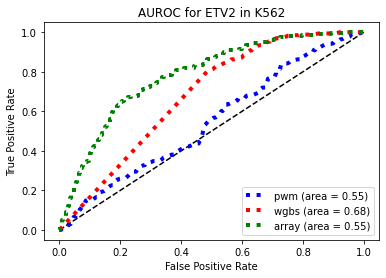

AUROC calculated for ETV2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


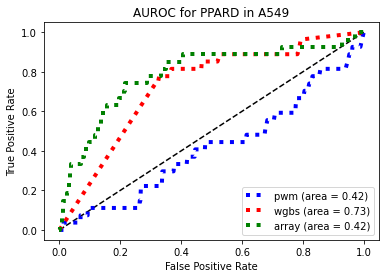

AUROC calculated for PPARD in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


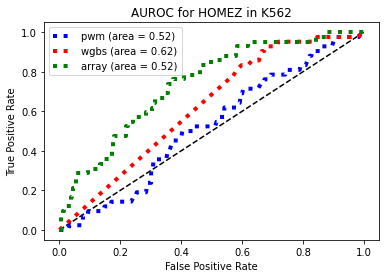

AUROC calculated for HOMEZ in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

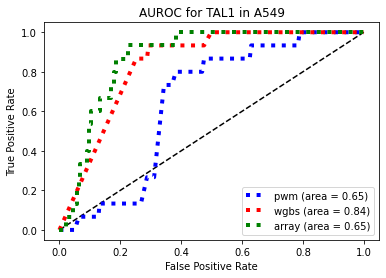

AUROC calculated for TAL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

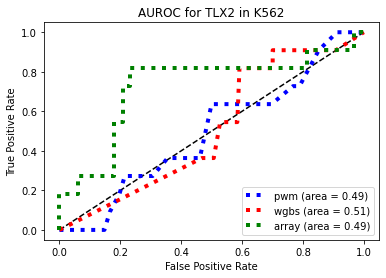

AUROC calculated for TLX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


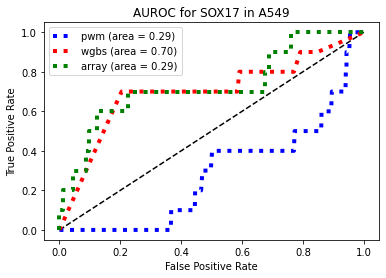

AUROC calculated for SOX17 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


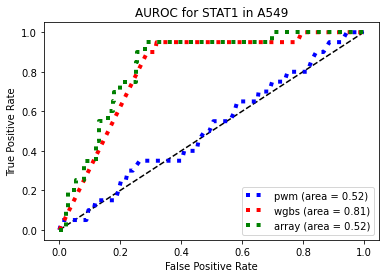

AUROC calculated for STAT1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


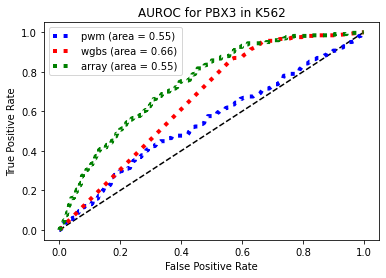

AUROC calculated for PBX3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


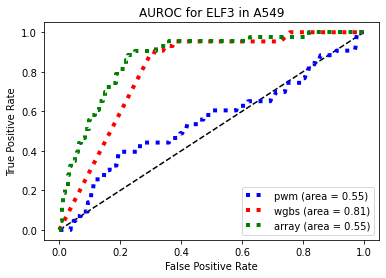

AUROC calculated for ELF3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


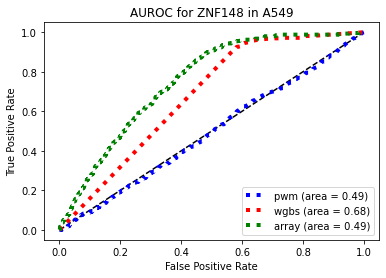

AUROC calculated for ZNF148 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


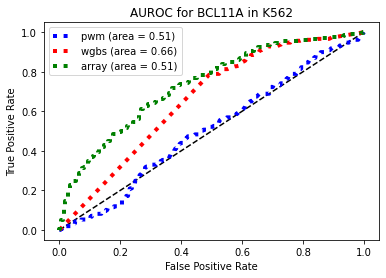

AUROC calculated for BCL11A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


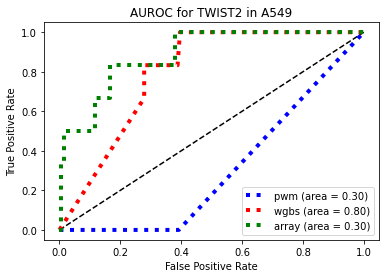

AUROC calculated for TWIST2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

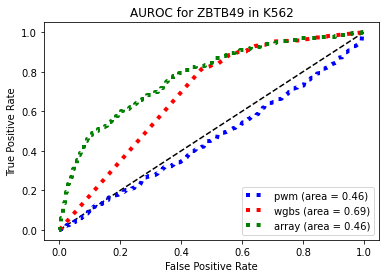

AUROC calculated for ZBTB49 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


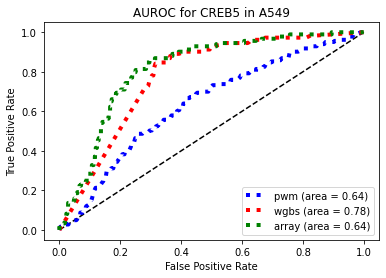

AUROC calculated for CREB5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


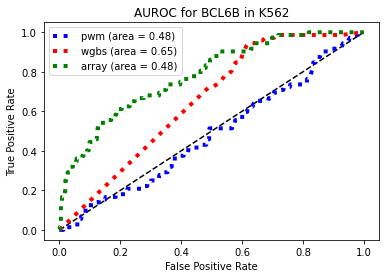

AUROC calculated for BCL6B in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

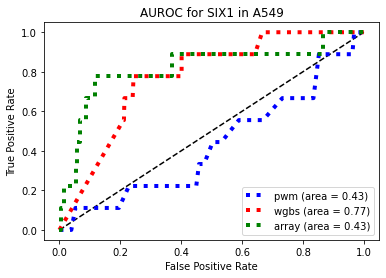

AUROC calculated for SIX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


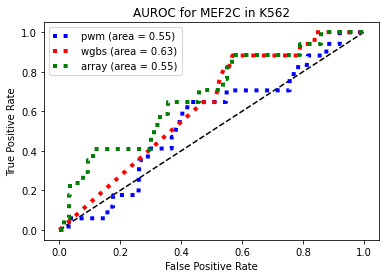

AUROC calculated for MEF2C in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


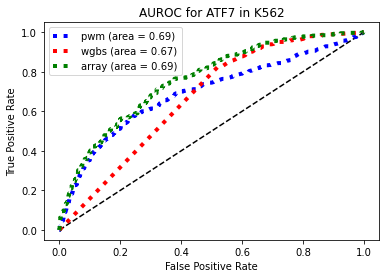

AUROC calculated for ATF7 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


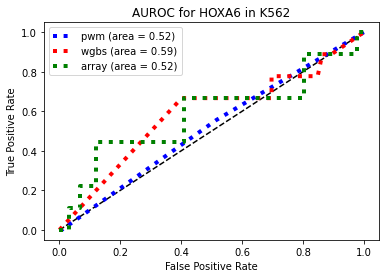

AUROC calculated for HOXA6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


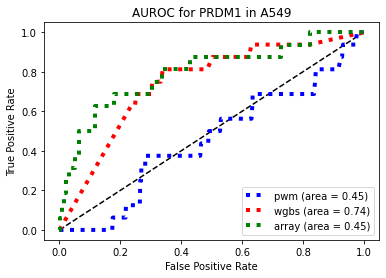

AUROC calculated for PRDM1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


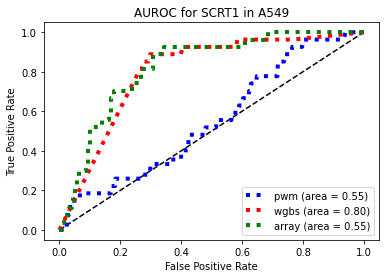

AUROC calculated for SCRT1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


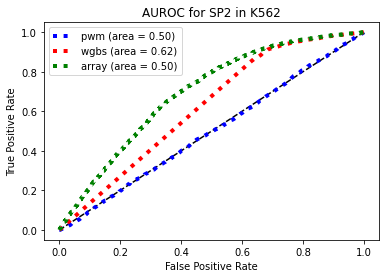

AUROC calculated for SP2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


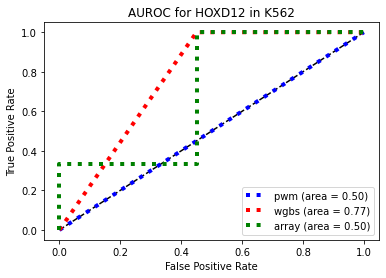

AUROC calculated for HOXD12 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

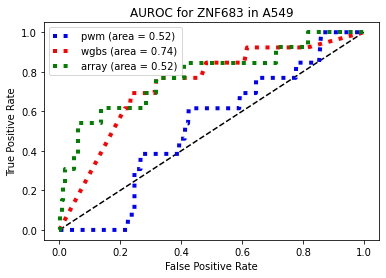

AUROC calculated for ZNF683 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


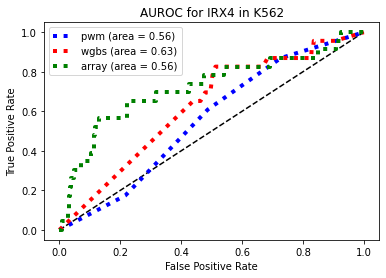

AUROC calculated for IRX4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

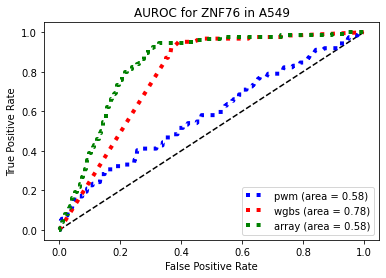

AUROC calculated for ZNF76 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


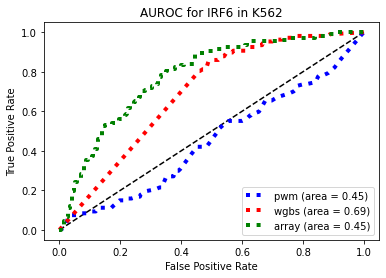

AUROC calculated for IRF6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


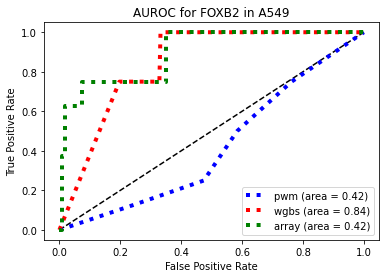

AUROC calculated for FOXB2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


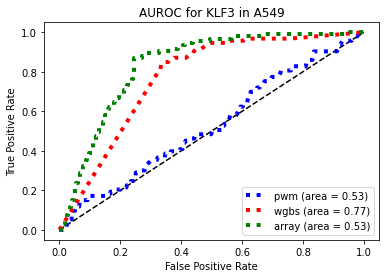

AUROC calculated for KLF3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


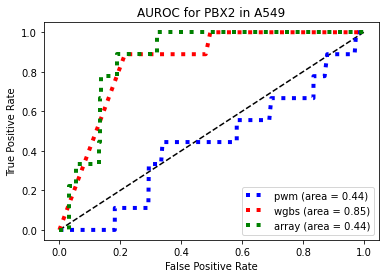

AUROC calculated for PBX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


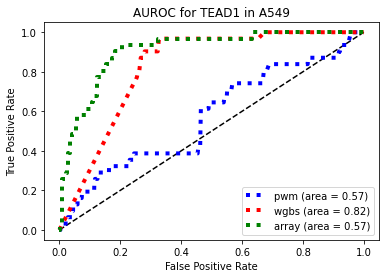

AUROC calculated for TEAD1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


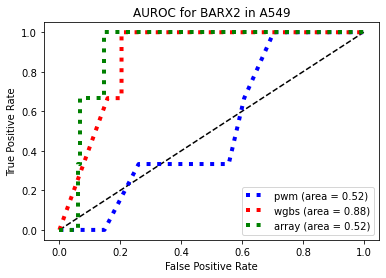

AUROC calculated for BARX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


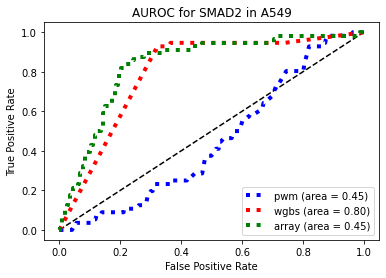

AUROC calculated for SMAD2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


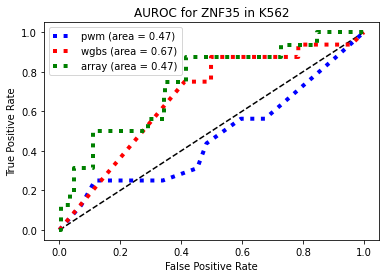

AUROC calculated for ZNF35 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


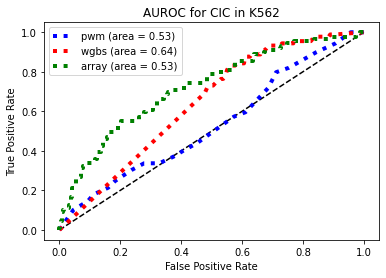

AUROC calculated for CIC in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


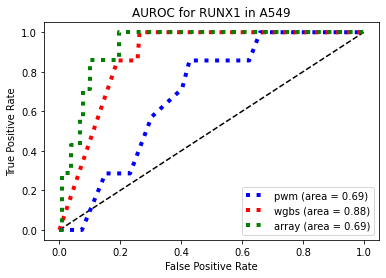

AUROC calculated for RUNX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

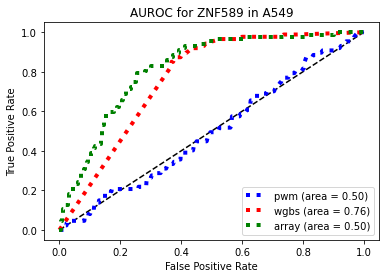

AUROC calculated for ZNF589 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


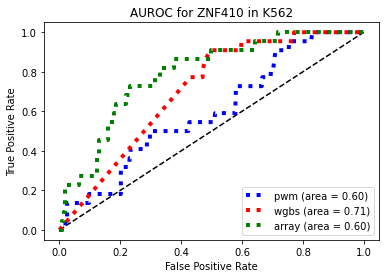

AUROC calculated for ZNF410 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


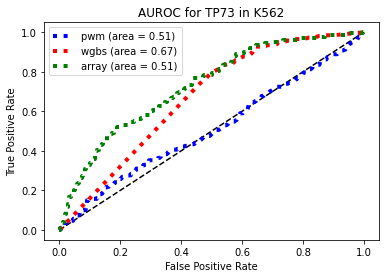

AUROC calculated for TP73 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


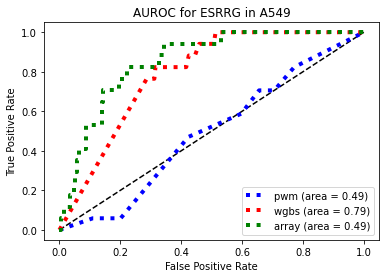

AUROC calculated for ESRRG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


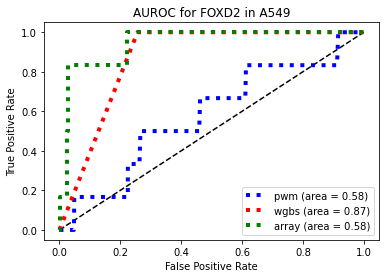

AUROC calculated for FOXD2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


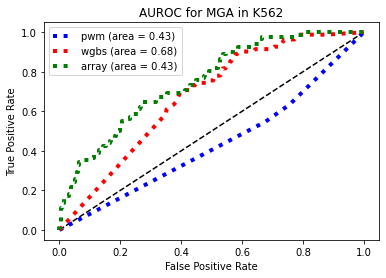

AUROC calculated for MGA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


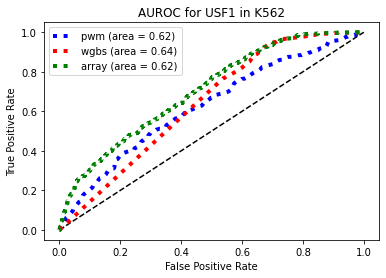

AUROC calculated for USF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


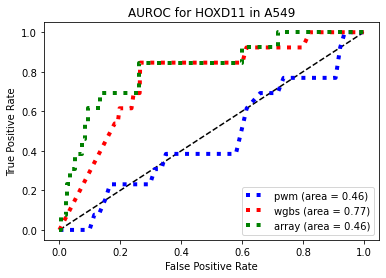

AUROC calculated for HOXD11 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


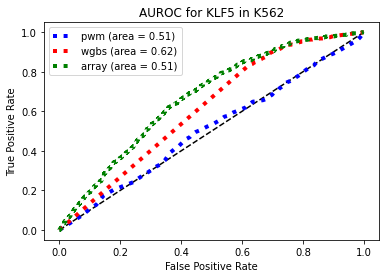

AUROC calculated for KLF5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


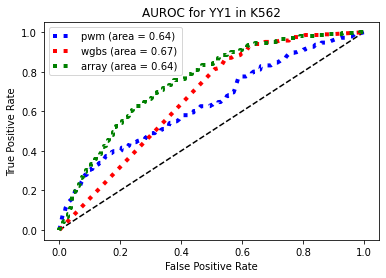

AUROC calculated for YY1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

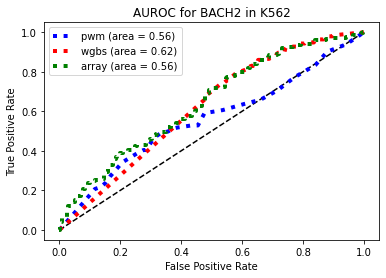

AUROC calculated for BACH2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


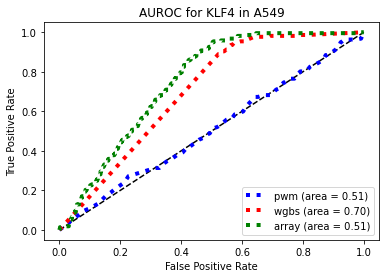

AUROC calculated for KLF4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


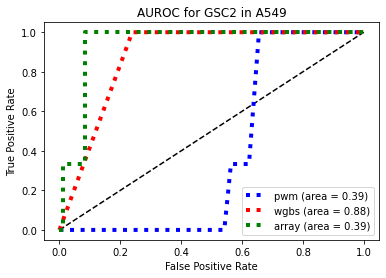

AUROC calculated for GSC2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


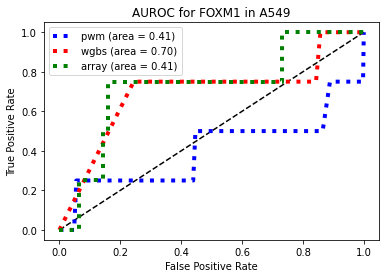

AUROC calculated for FOXM1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


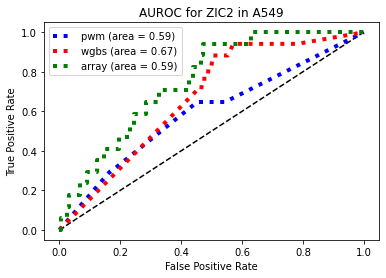

AUROC calculated for ZIC2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


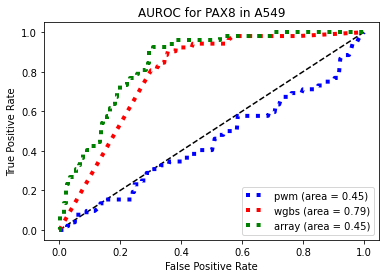

AUROC calculated for PAX8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


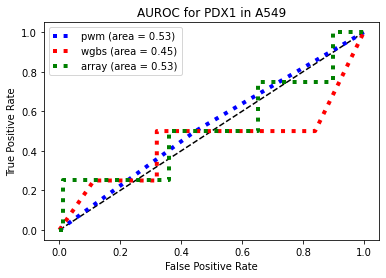

AUROC calculated for PDX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


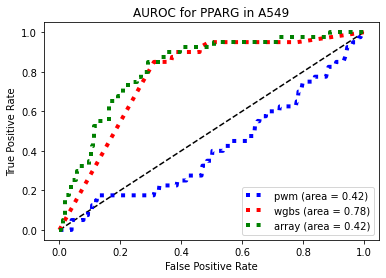

AUROC calculated for PPARG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


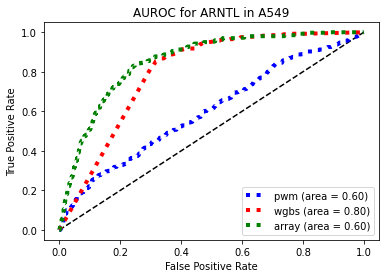

AUROC calculated for ARNTL in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


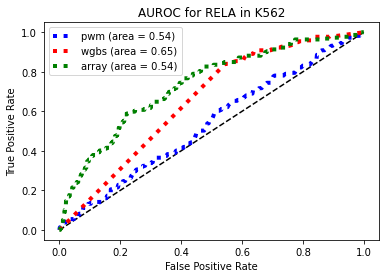

AUROC calculated for RELA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


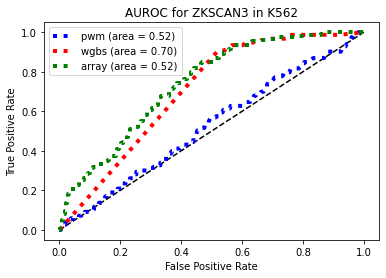

AUROC calculated for ZKSCAN3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


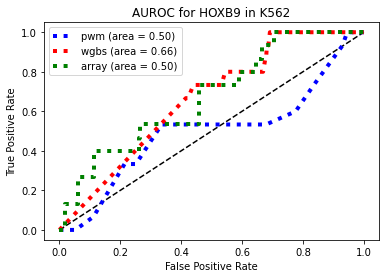

AUROC calculated for HOXB9 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


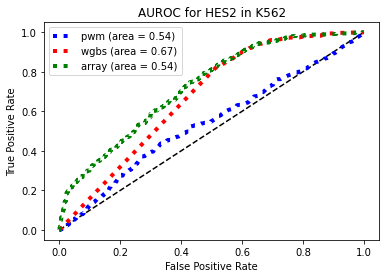

AUROC calculated for HES2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


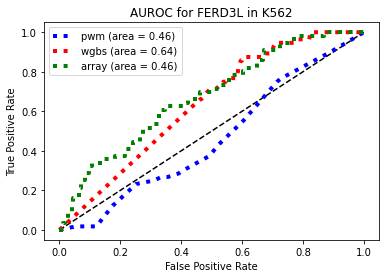

AUROC calculated for FERD3L in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


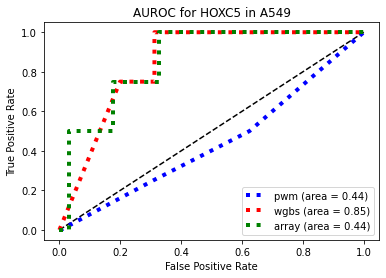

AUROC calculated for HOXC5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


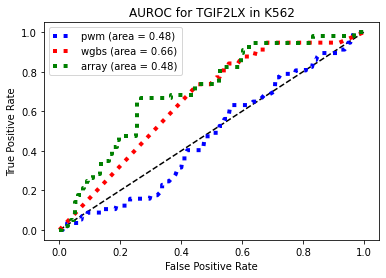

AUROC calculated for TGIF2LX in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


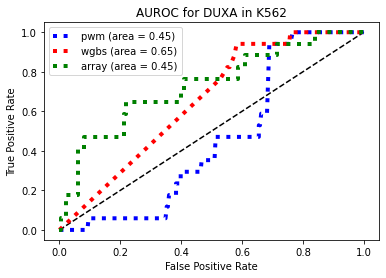

AUROC calculated for DUXA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


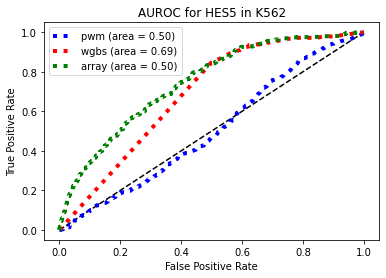

AUROC calculated for HES5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


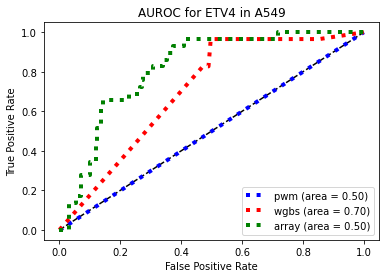

AUROC calculated for ETV4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


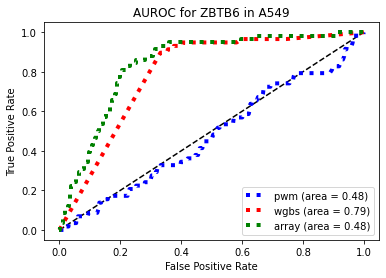

AUROC calculated for ZBTB6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


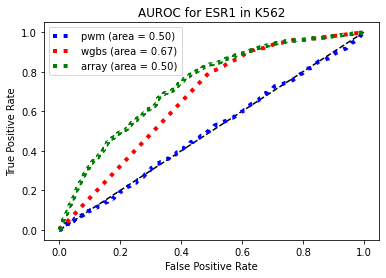

AUROC calculated for ESR1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


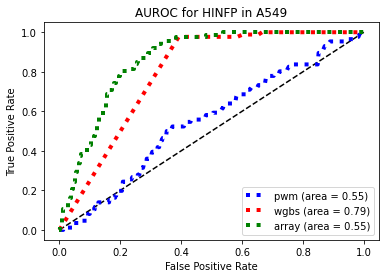

AUROC calculated for HINFP in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


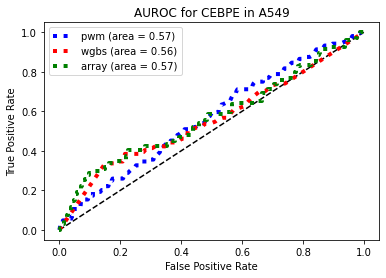

AUROC calculated for CEBPE in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


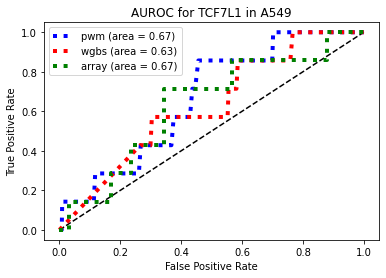

AUROC calculated for TCF7L1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


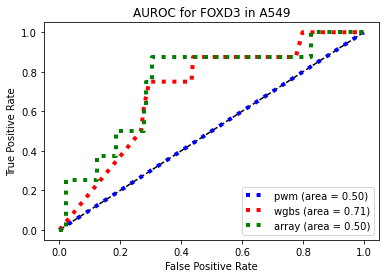

AUROC calculated for FOXD3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


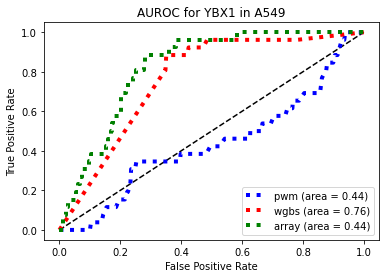

AUROC calculated for YBX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


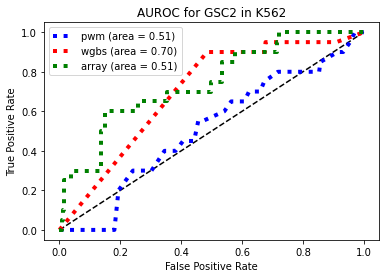

AUROC calculated for GSC2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


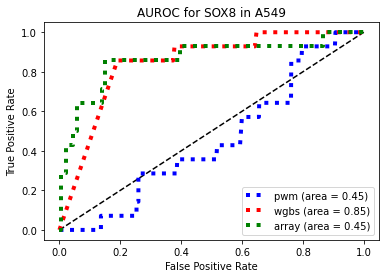

AUROC calculated for SOX8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


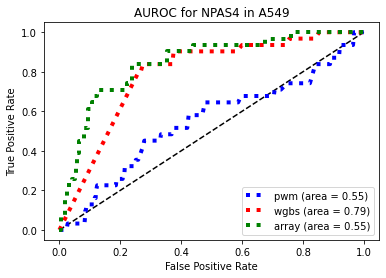

AUROC calculated for NPAS4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


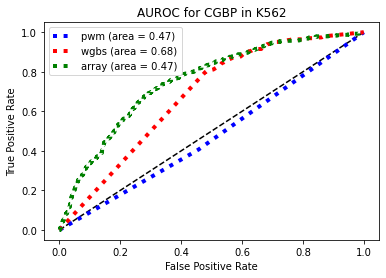

AUROC calculated for CGBP in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

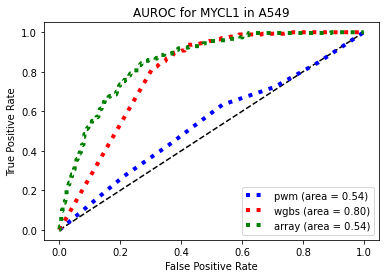

AUROC calculated for MYCL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


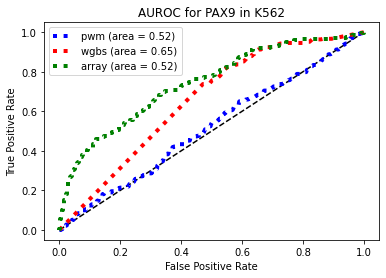

AUROC calculated for PAX9 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


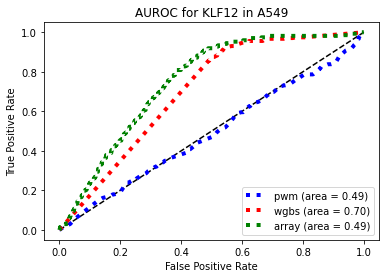

AUROC calculated for KLF12 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


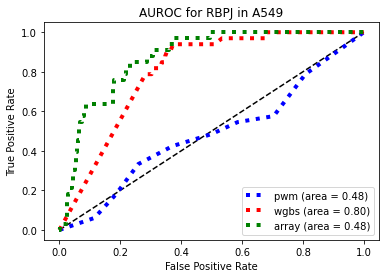

AUROC calculated for RBPJ in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


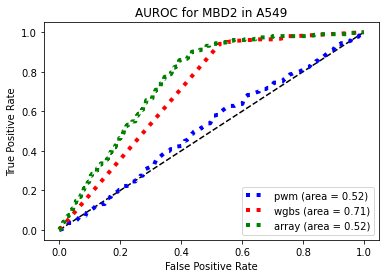

AUROC calculated for MBD2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


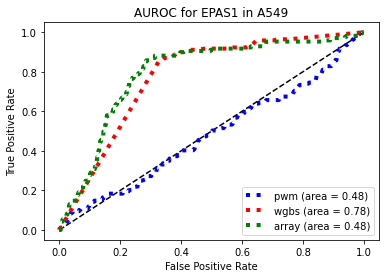

AUROC calculated for EPAS1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


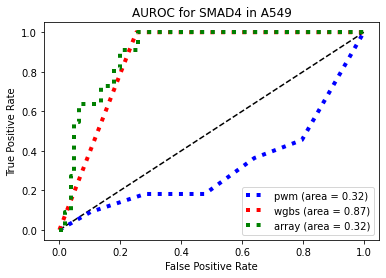

AUROC calculated for SMAD4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


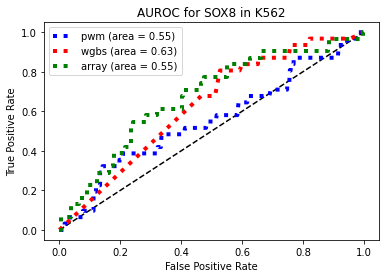

AUROC calculated for SOX8 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


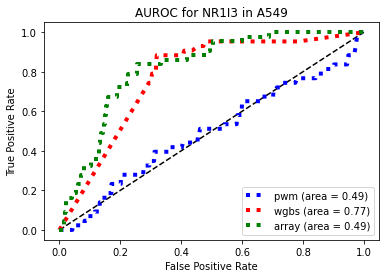

AUROC calculated for NR1I3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


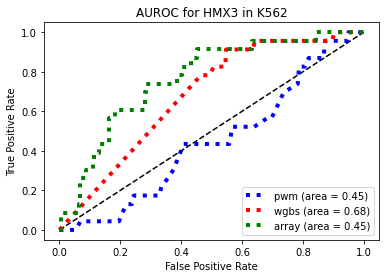

AUROC calculated for HMX3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

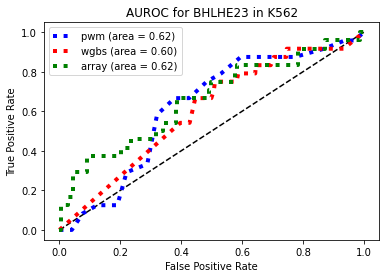

AUROC calculated for BHLHE23 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


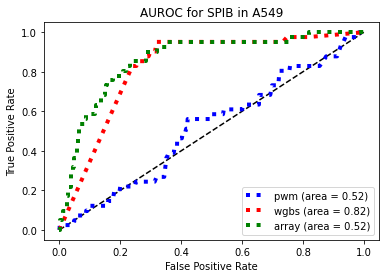

AUROC calculated for SPIB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


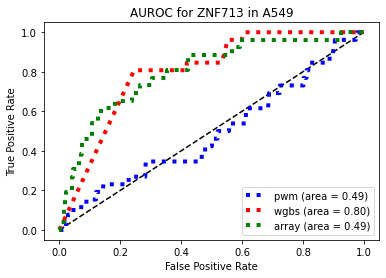

AUROC calculated for ZNF713 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


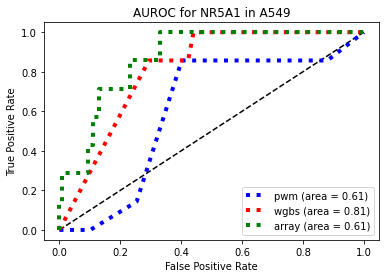

AUROC calculated for NR5A1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


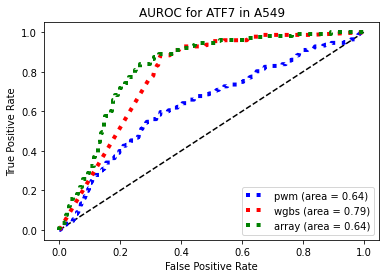

AUROC calculated for ATF7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


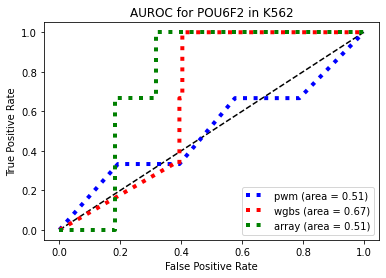

AUROC calculated for POU6F2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


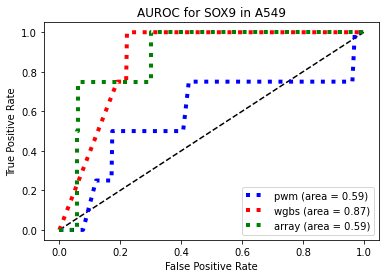

AUROC calculated for SOX9 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


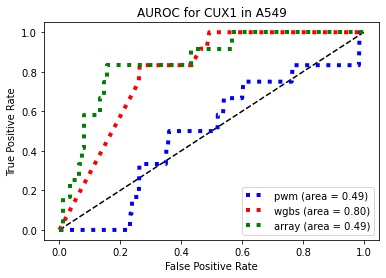

AUROC calculated for CUX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

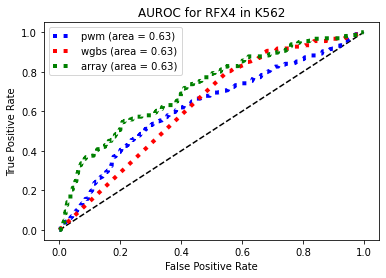

AUROC calculated for RFX4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

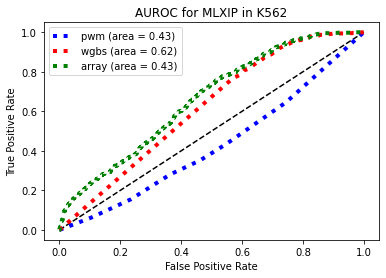

AUROC calculated for MLXIP in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


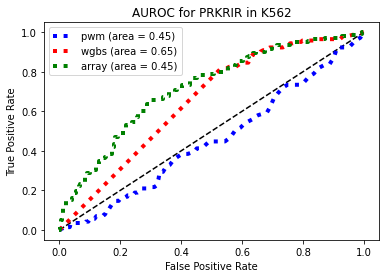

AUROC calculated for PRKRIR in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


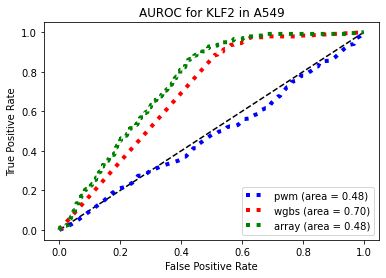

AUROC calculated for KLF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


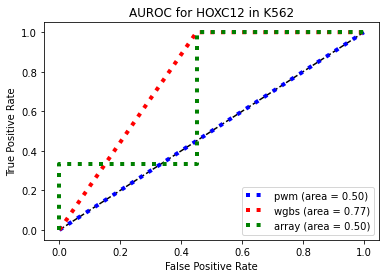

AUROC calculated for HOXC12 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

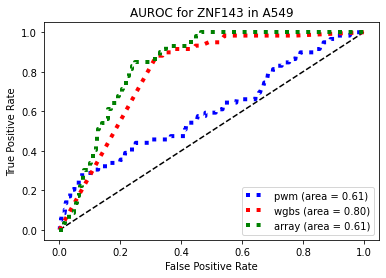

AUROC calculated for ZNF143 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

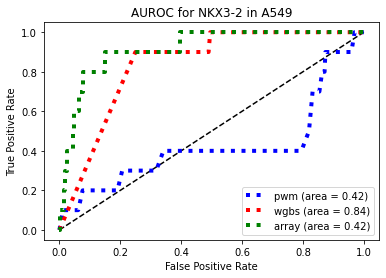

AUROC calculated for NKX3-2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


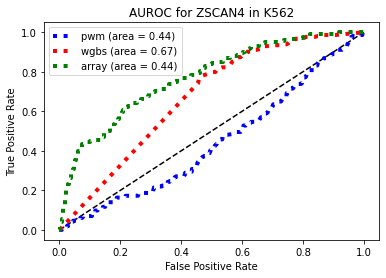

AUROC calculated for ZSCAN4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


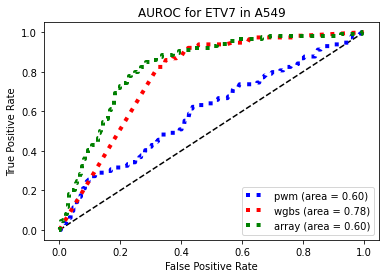

AUROC calculated for ETV7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


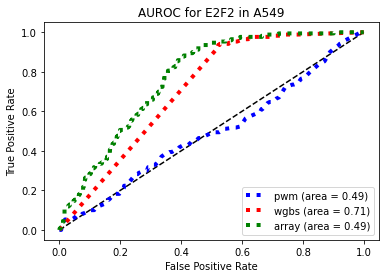

AUROC calculated for E2F2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


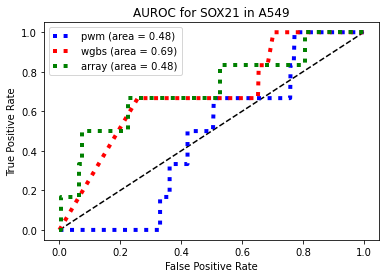

AUROC calculated for SOX21 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


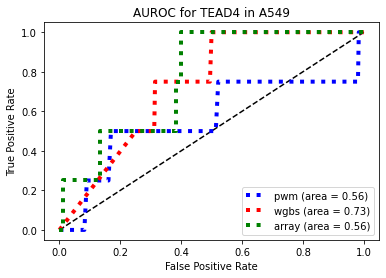

AUROC calculated for TEAD4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


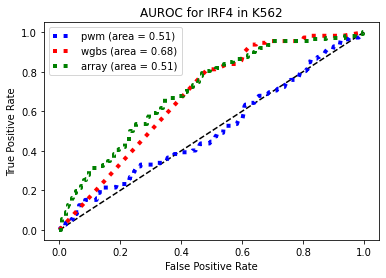

AUROC calculated for IRF4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


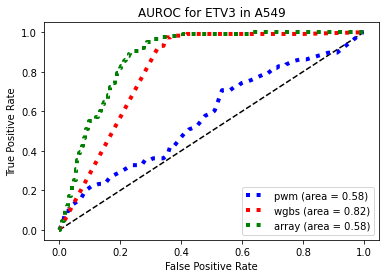

AUROC calculated for ETV3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


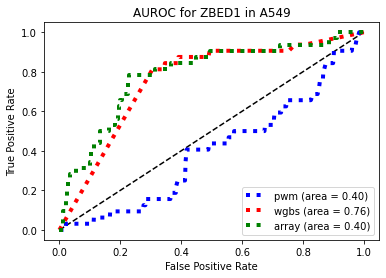

AUROC calculated for ZBED1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


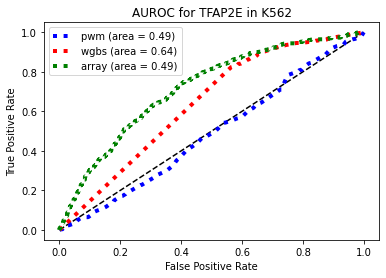

AUROC calculated for TFAP2E in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

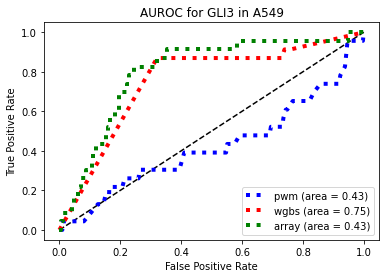

AUROC calculated for GLI3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


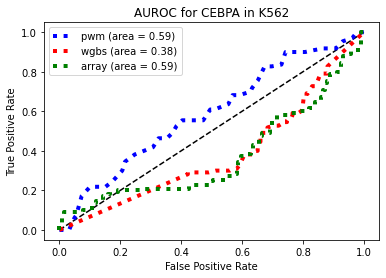

AUROC calculated for CEBPA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


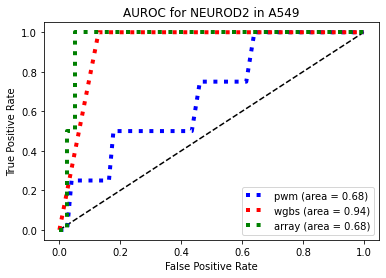

AUROC calculated for NEUROD2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


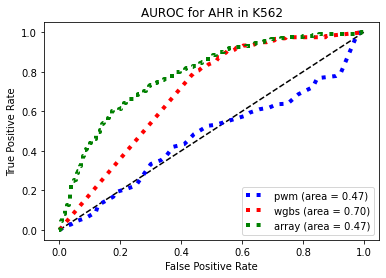

AUROC calculated for AHR in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


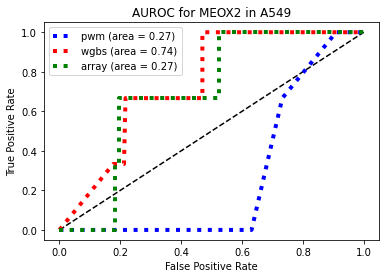

AUROC calculated for MEOX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


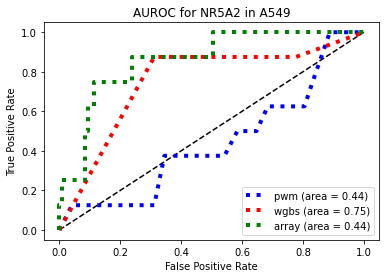

AUROC calculated for NR5A2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


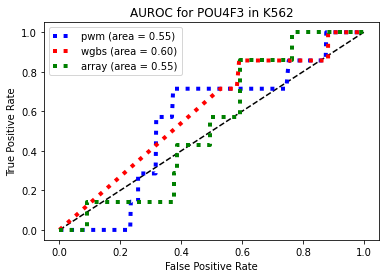

AUROC calculated for POU4F3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


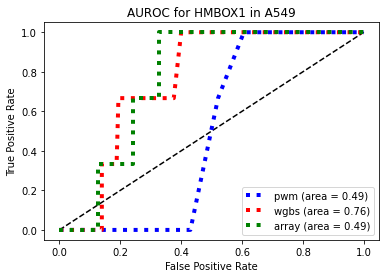

AUROC calculated for HMBOX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


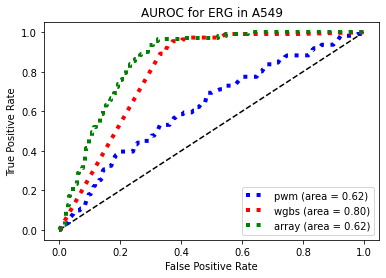

AUROC calculated for ERG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


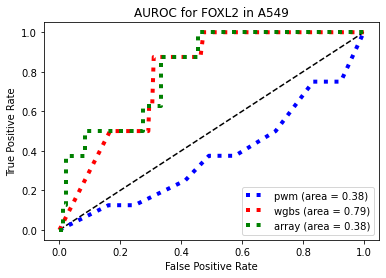

AUROC calculated for FOXL2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


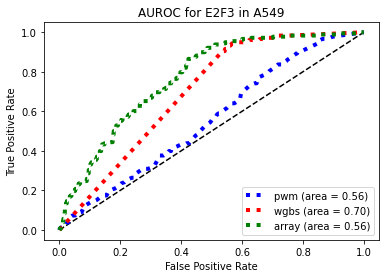

AUROC calculated for E2F3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


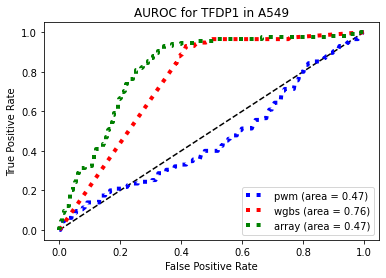

AUROC calculated for TFDP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


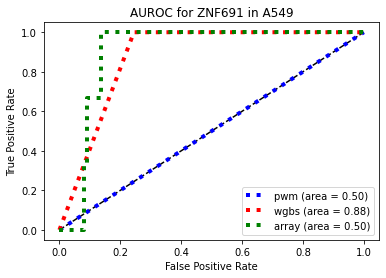

AUROC calculated for ZNF691 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


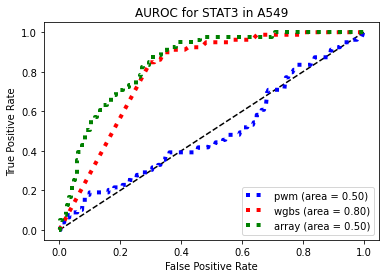

AUROC calculated for STAT3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


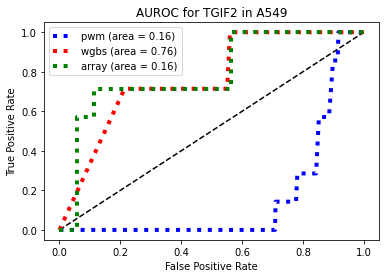

AUROC calculated for TGIF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


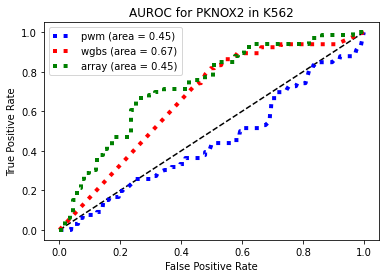

AUROC calculated for PKNOX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


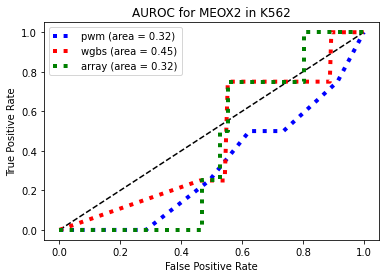

AUROC calculated for MEOX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


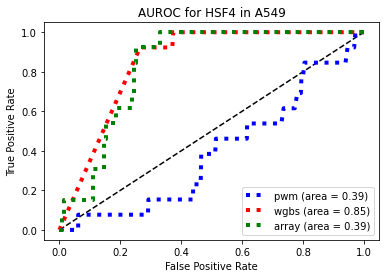

AUROC calculated for HSF4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


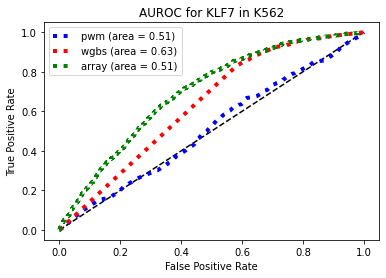

AUROC calculated for KLF7 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


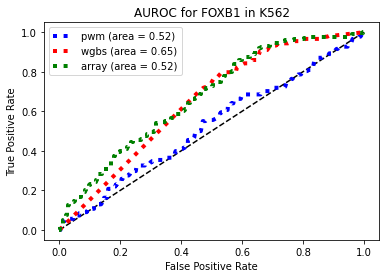

AUROC calculated for FOXB1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

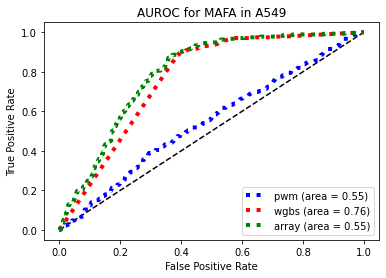

AUROC calculated for MAFA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


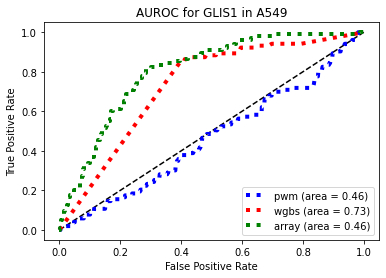

AUROC calculated for GLIS1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


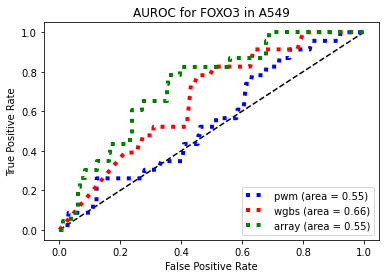

AUROC calculated for FOXO3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


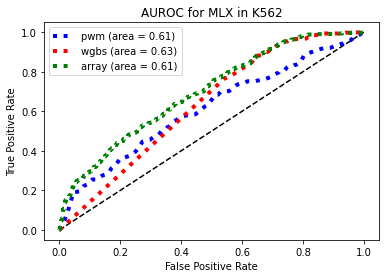

AUROC calculated for MLX in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


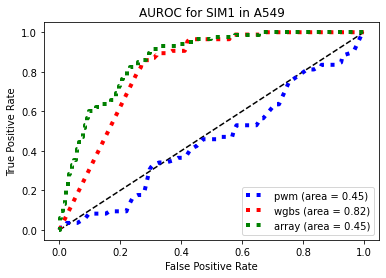

AUROC calculated for SIM1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


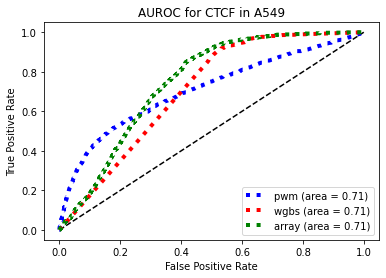

AUROC calculated for CTCF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


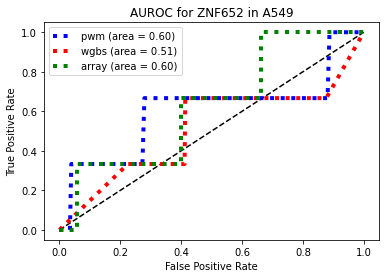

AUROC calculated for ZNF652 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


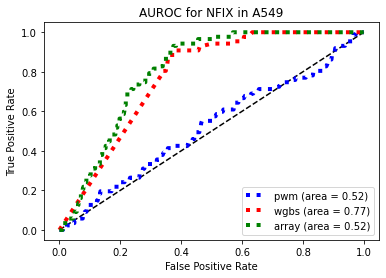

AUROC calculated for NFIX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


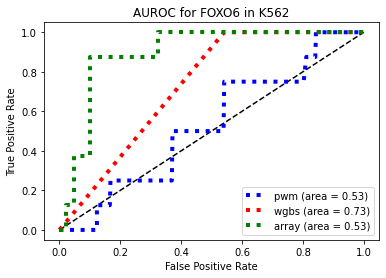

AUROC calculated for FOXO6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


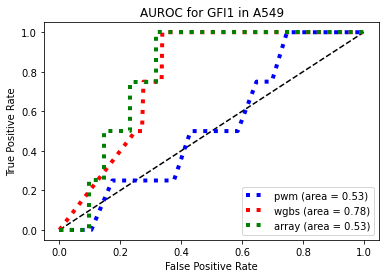

AUROC calculated for GFI1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


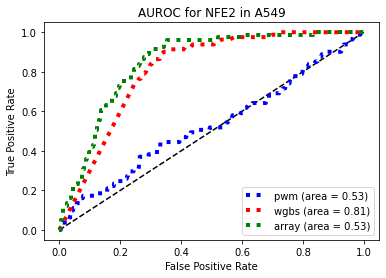

AUROC calculated for NFE2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

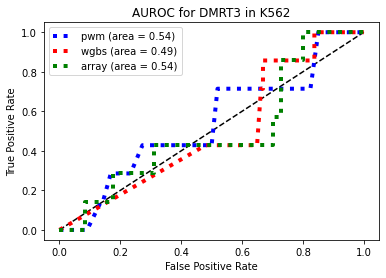

AUROC calculated for DMRT3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


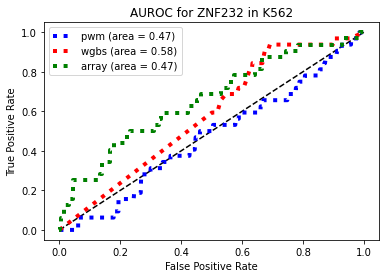

AUROC calculated for ZNF232 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


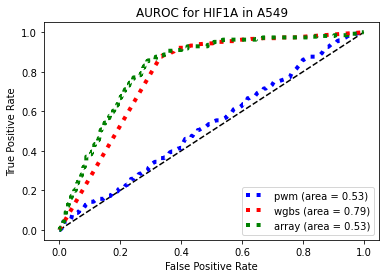

AUROC calculated for HIF1A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


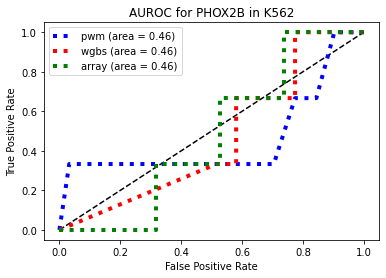

AUROC calculated for PHOX2B in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


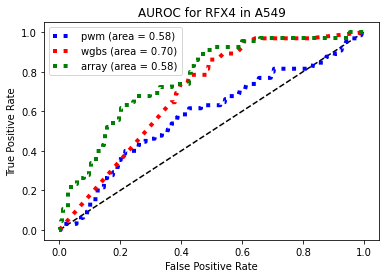

AUROC calculated for RFX4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


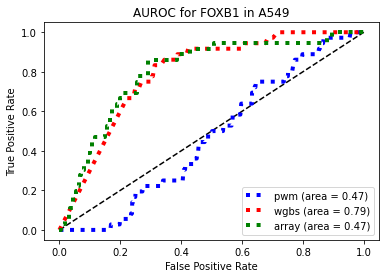

AUROC calculated for FOXB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


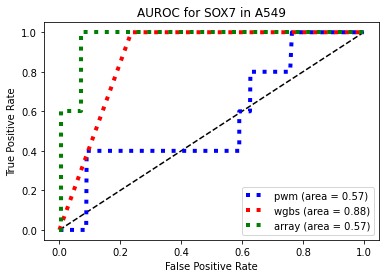

AUROC calculated for SOX7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

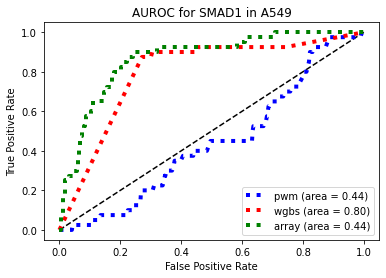

AUROC calculated for SMAD1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


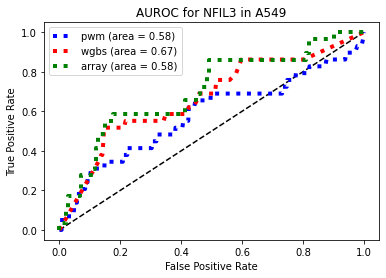

AUROC calculated for NFIL3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


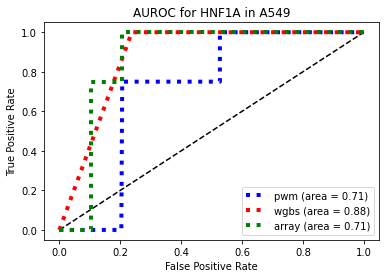

AUROC calculated for HNF1A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


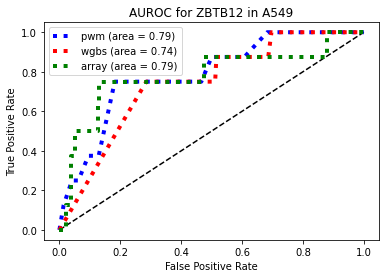

AUROC calculated for ZBTB12 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


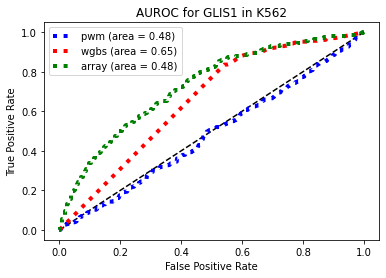

AUROC calculated for GLIS1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


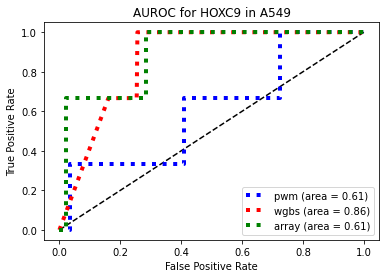

AUROC calculated for HOXC9 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


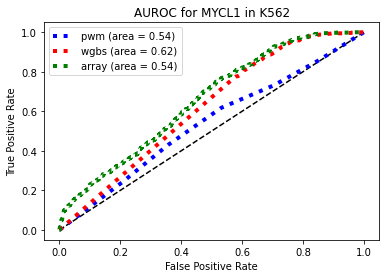

AUROC calculated for MYCL1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


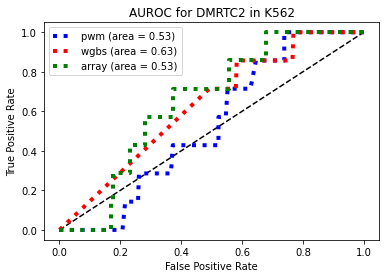

AUROC calculated for DMRTC2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

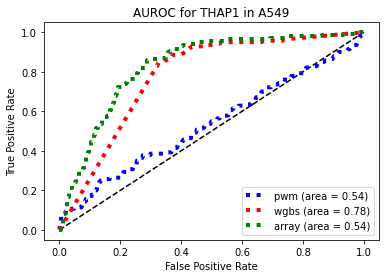

AUROC calculated for THAP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

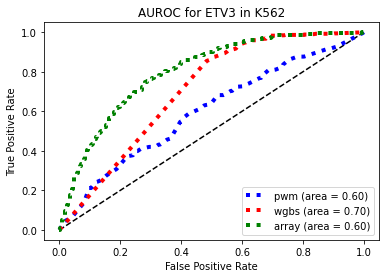

AUROC calculated for ETV3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

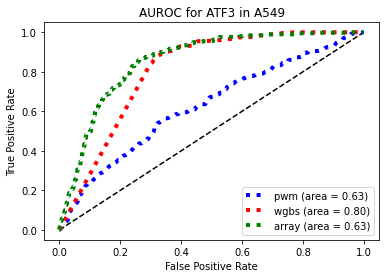

AUROC calculated for ATF3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


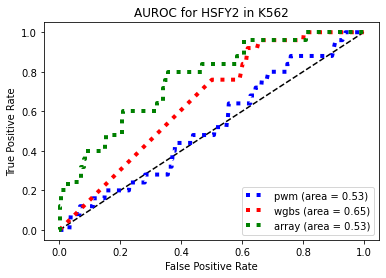

AUROC calculated for HSFY2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


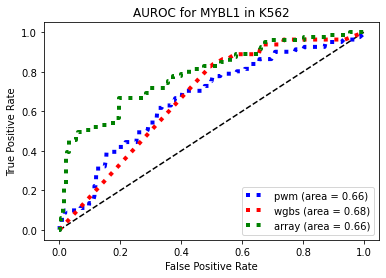

AUROC calculated for MYBL1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


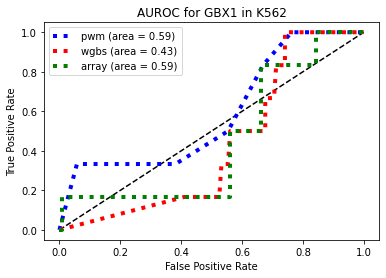

AUROC calculated for GBX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


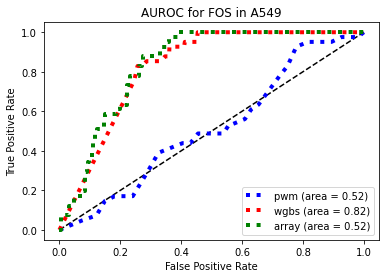

AUROC calculated for FOS in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


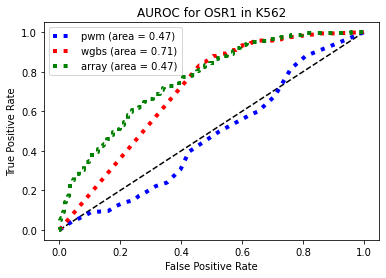

AUROC calculated for OSR1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


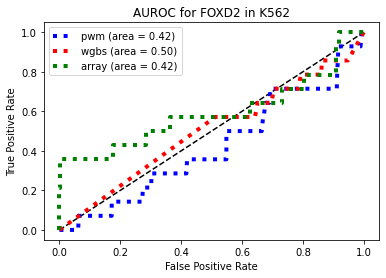

AUROC calculated for FOXD2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


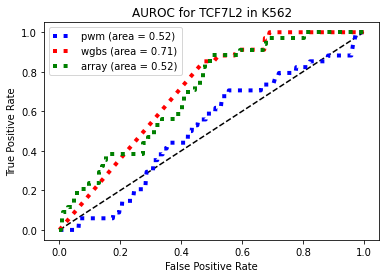

AUROC calculated for TCF7L2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

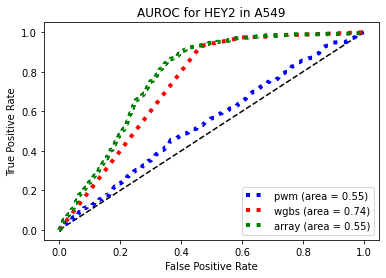

AUROC calculated for HEY2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


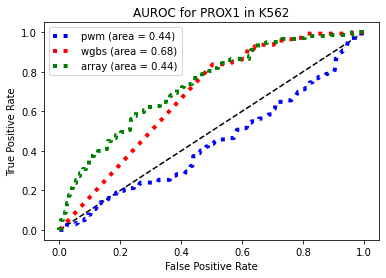

AUROC calculated for PROX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


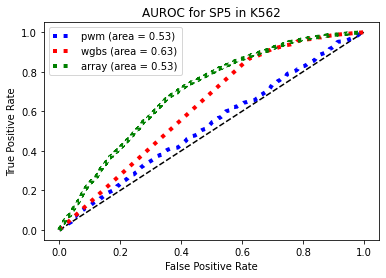

AUROC calculated for SP5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

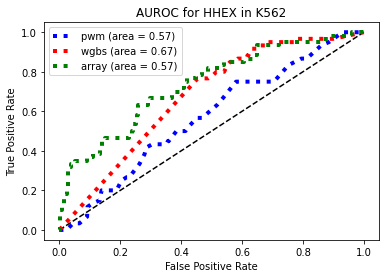

AUROC calculated for HHEX in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

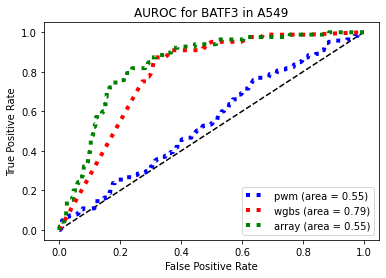

AUROC calculated for BATF3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


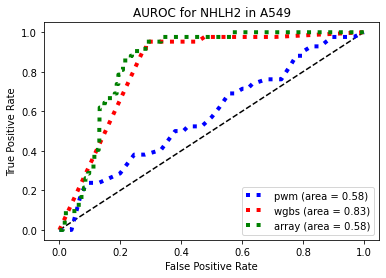

AUROC calculated for NHLH2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


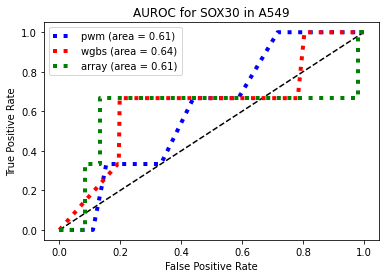

AUROC calculated for SOX30 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

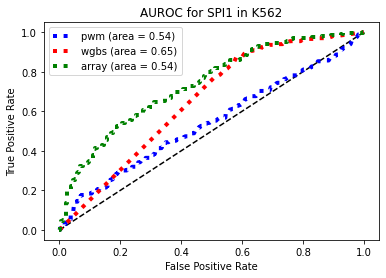

AUROC calculated for SPI1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

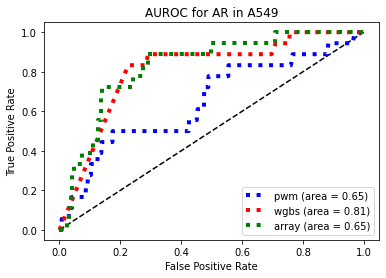

AUROC calculated for AR in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


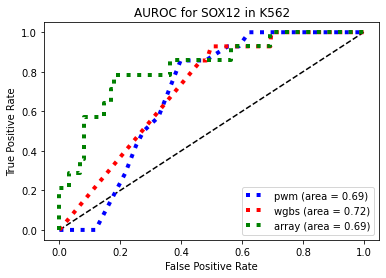

AUROC calculated for SOX12 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

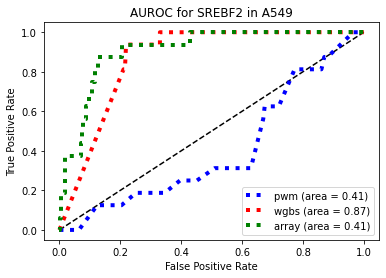

AUROC calculated for SREBF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


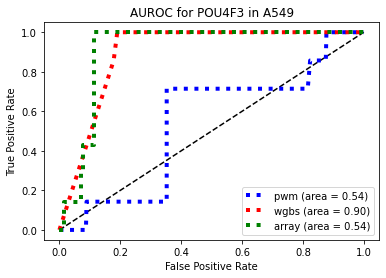

AUROC calculated for POU4F3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


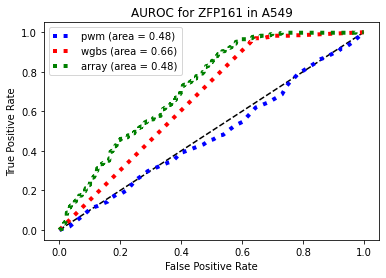

AUROC calculated for ZFP161 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


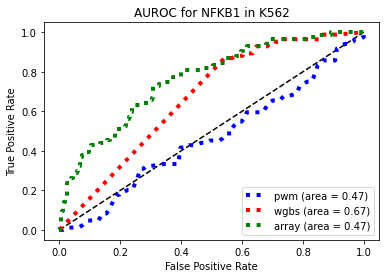

AUROC calculated for NFKB1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


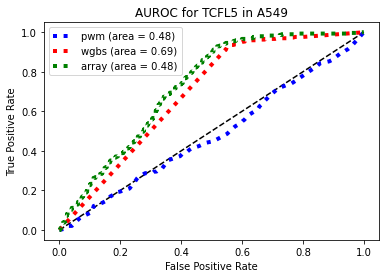

AUROC calculated for TCFL5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


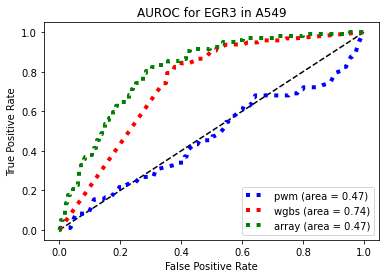

AUROC calculated for EGR3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


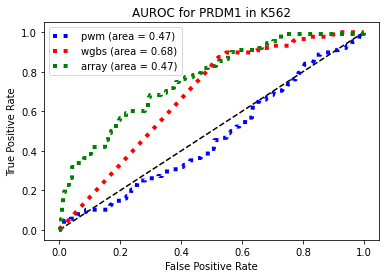

AUROC calculated for PRDM1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


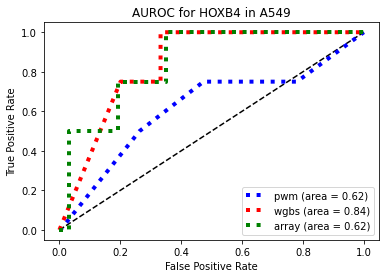

AUROC calculated for HOXB4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


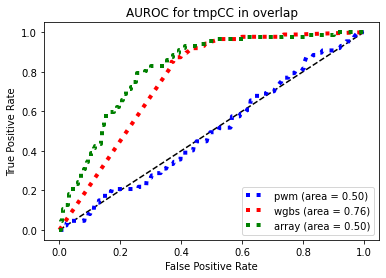

AUROC calculated for tmpCC in overlap


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


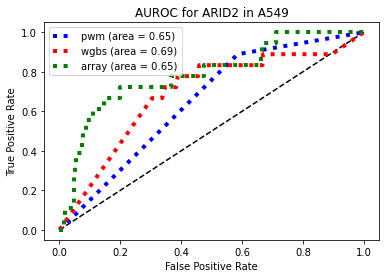

AUROC calculated for ARID2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


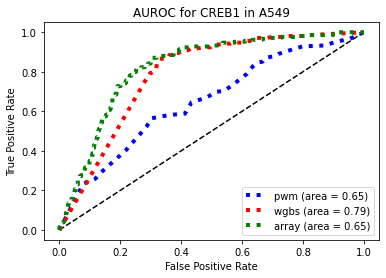

AUROC calculated for CREB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


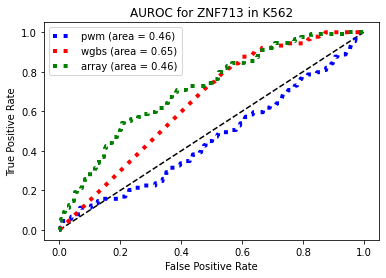

AUROC calculated for ZNF713 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


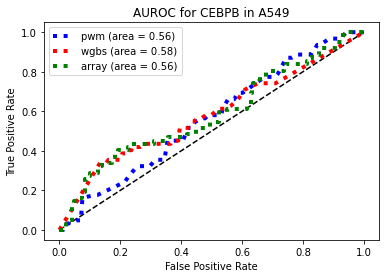

AUROC calculated for CEBPB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


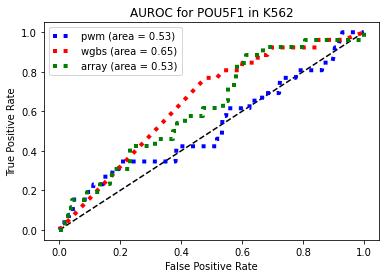

AUROC calculated for POU5F1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


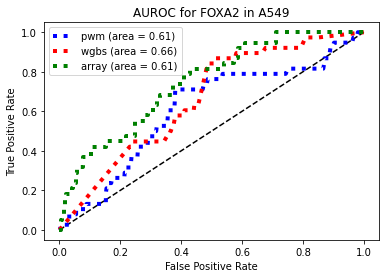

AUROC calculated for FOXA2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


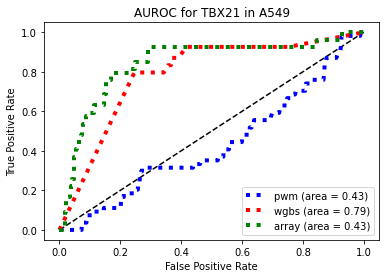

AUROC calculated for TBX21 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


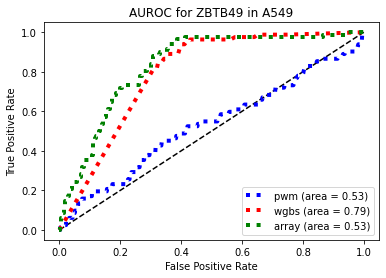

AUROC calculated for ZBTB49 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


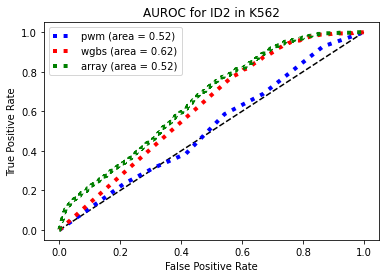

AUROC calculated for ID2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


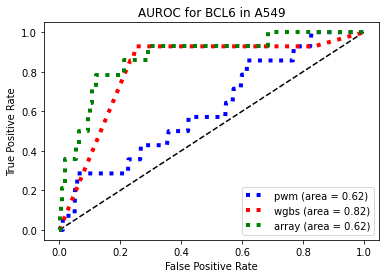

AUROC calculated for BCL6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


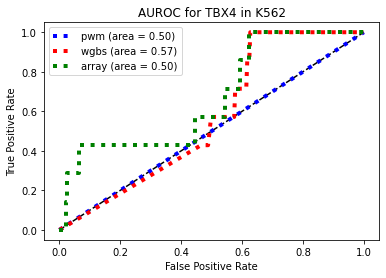

AUROC calculated for TBX4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


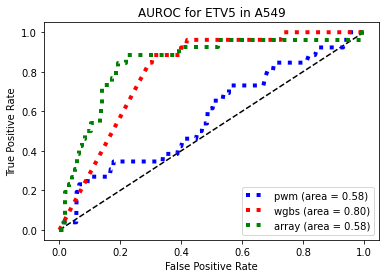

AUROC calculated for ETV5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


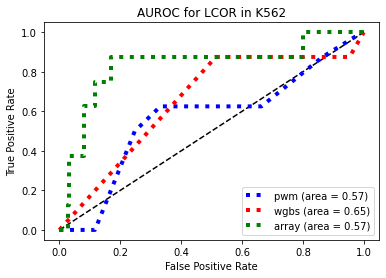

AUROC calculated for LCOR in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


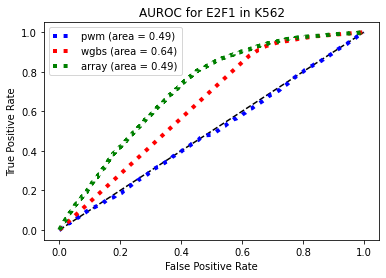

AUROC calculated for E2F1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


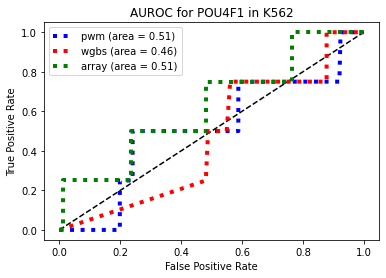

AUROC calculated for POU4F1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


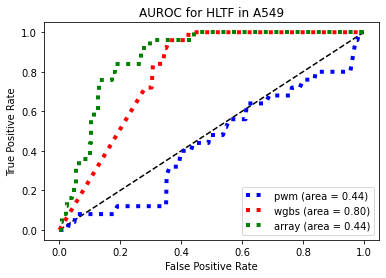

AUROC calculated for HLTF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


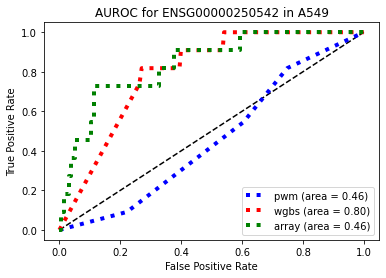

AUROC calculated for ENSG00000250542 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


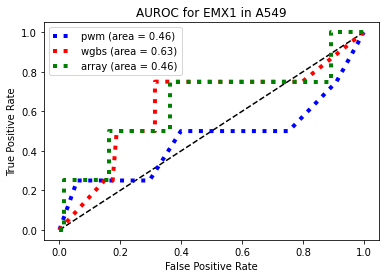

AUROC calculated for EMX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


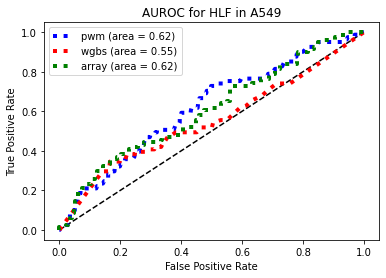

AUROC calculated for HLF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


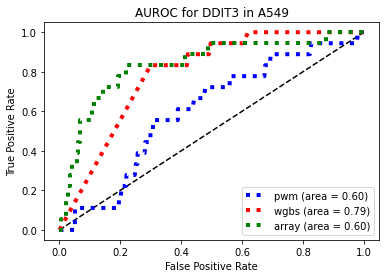

AUROC calculated for DDIT3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


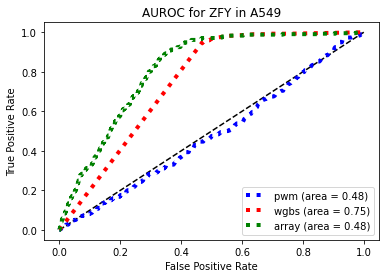

AUROC calculated for ZFY in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


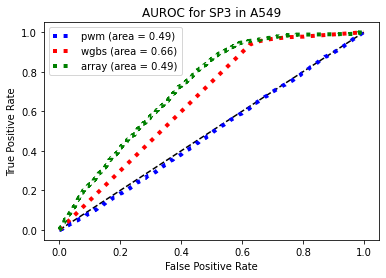

AUROC calculated for SP3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


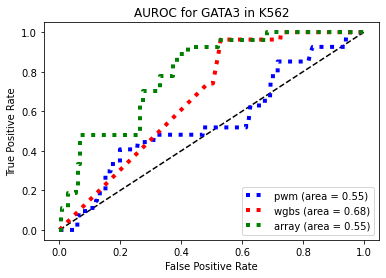

AUROC calculated for GATA3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


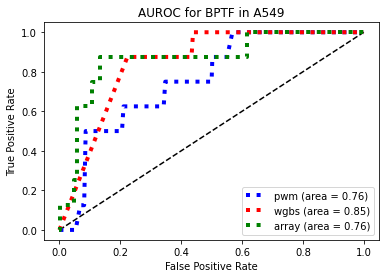

AUROC calculated for BPTF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


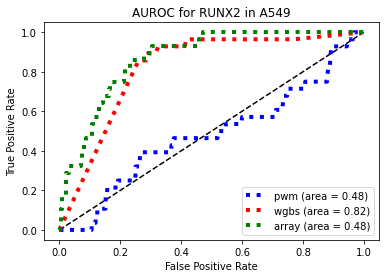

AUROC calculated for RUNX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


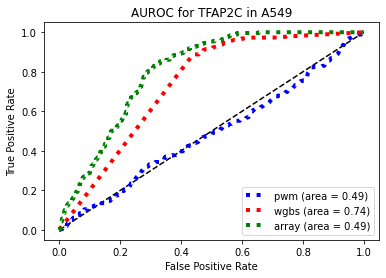

AUROC calculated for TFAP2C in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


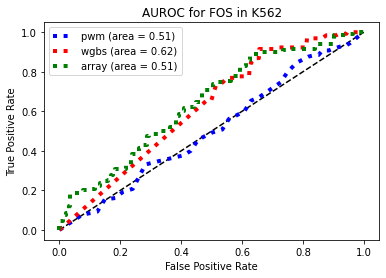

AUROC calculated for FOS in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


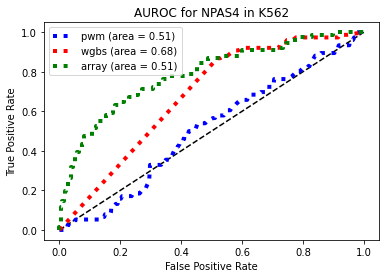

AUROC calculated for NPAS4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


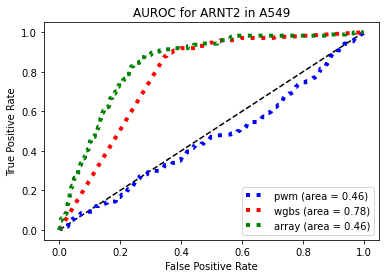

AUROC calculated for ARNT2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


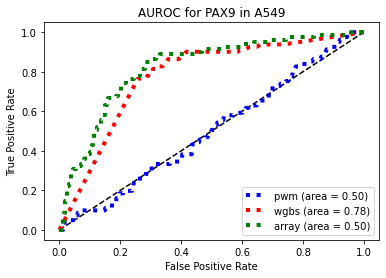

AUROC calculated for PAX9 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


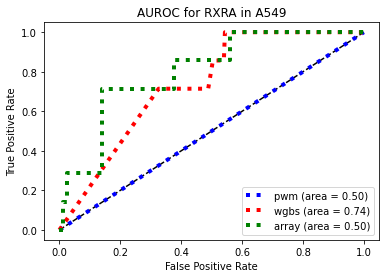

AUROC calculated for RXRA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


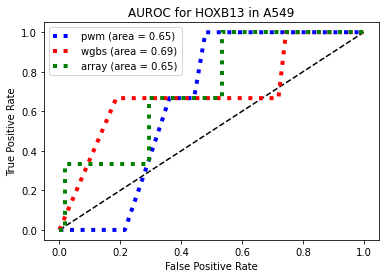

AUROC calculated for HOXB13 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


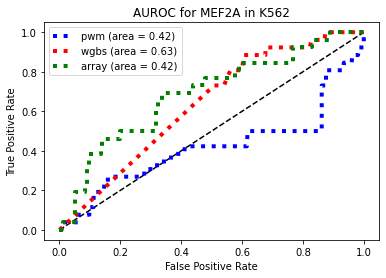

AUROC calculated for MEF2A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


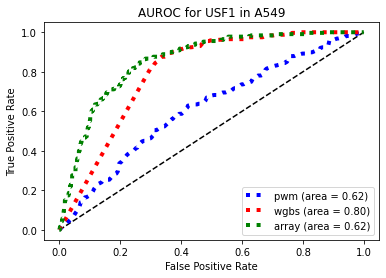

AUROC calculated for USF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


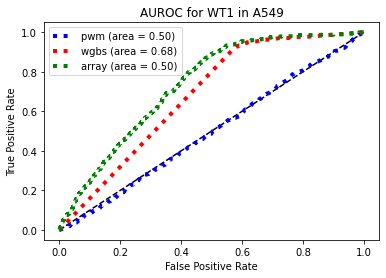

AUROC calculated for WT1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


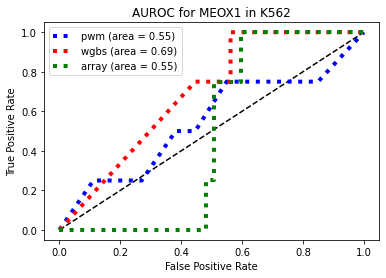

AUROC calculated for MEOX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

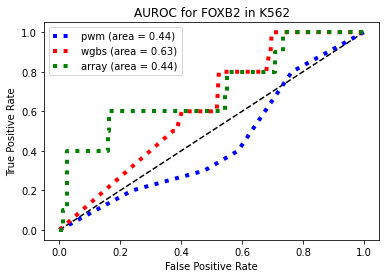

AUROC calculated for FOXB2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


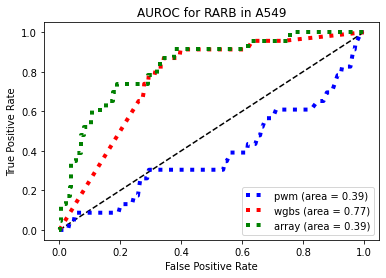

AUROC calculated for RARB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


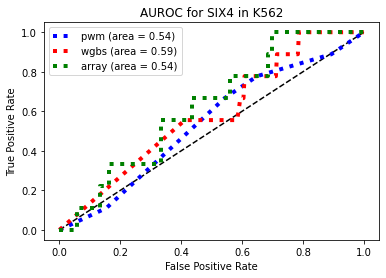

AUROC calculated for SIX4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


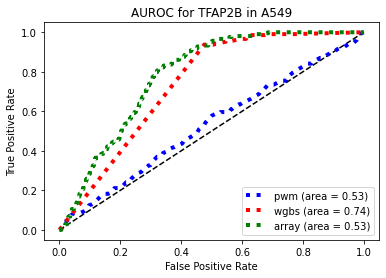

AUROC calculated for TFAP2B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


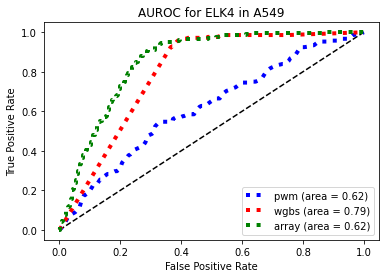

AUROC calculated for ELK4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


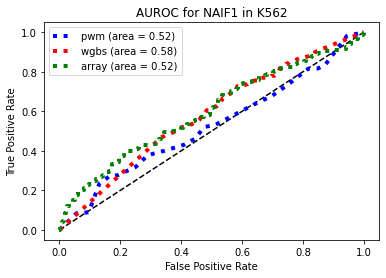

AUROC calculated for NAIF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

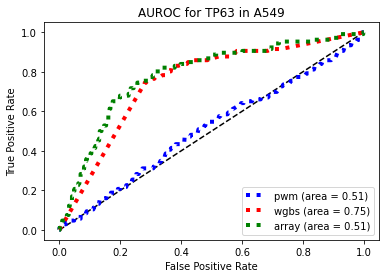

AUROC calculated for TP63 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


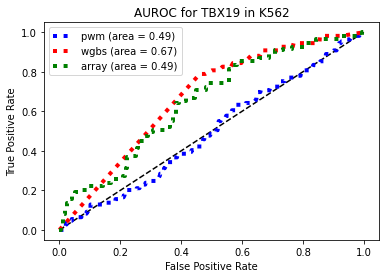

AUROC calculated for TBX19 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


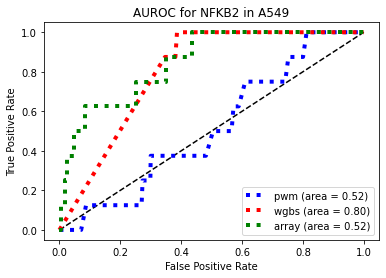

AUROC calculated for NFKB2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


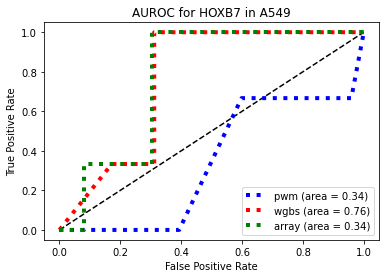

AUROC calculated for HOXB7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


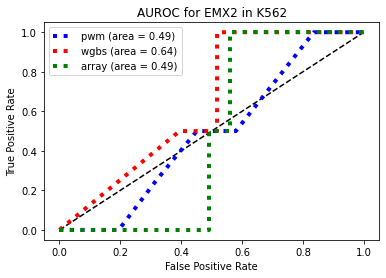

AUROC calculated for EMX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


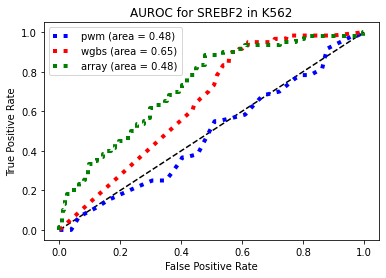

AUROC calculated for SREBF2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


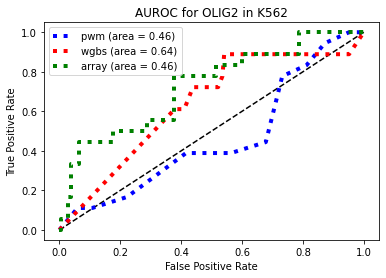

AUROC calculated for OLIG2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


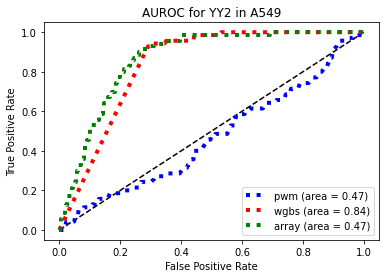

AUROC calculated for YY2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


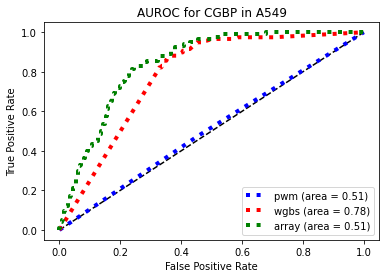

AUROC calculated for CGBP in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


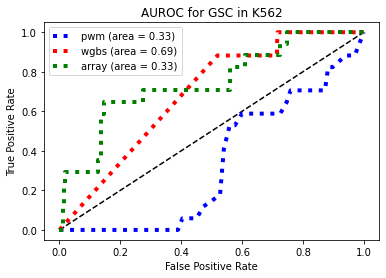

AUROC calculated for GSC in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


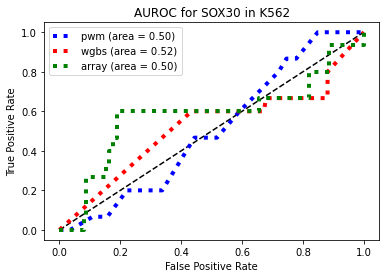

AUROC calculated for SOX30 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


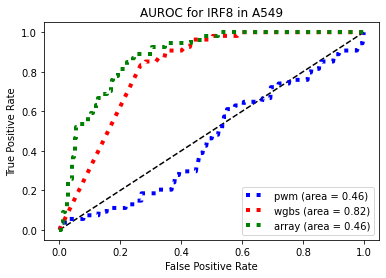

AUROC calculated for IRF8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


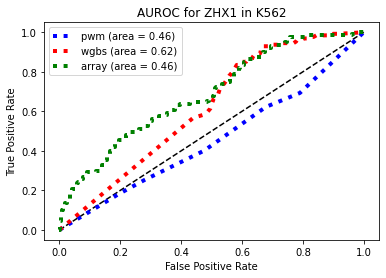

AUROC calculated for ZHX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


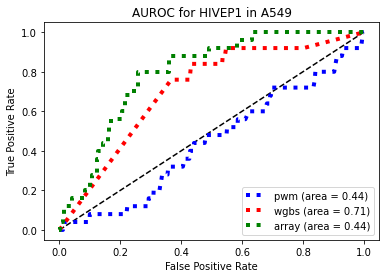

AUROC calculated for HIVEP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


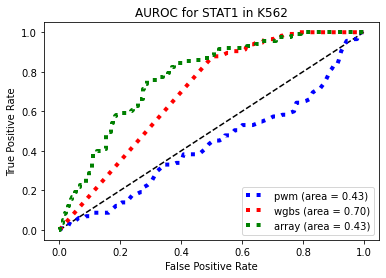

AUROC calculated for STAT1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


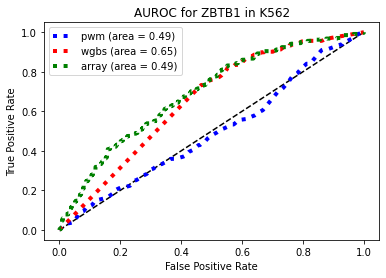

AUROC calculated for ZBTB1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


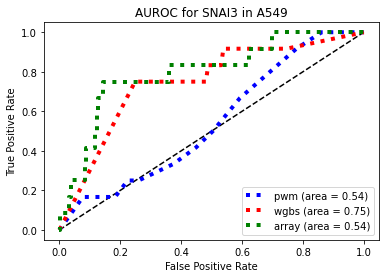

AUROC calculated for SNAI3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


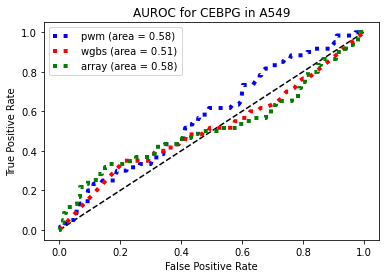

AUROC calculated for CEBPG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


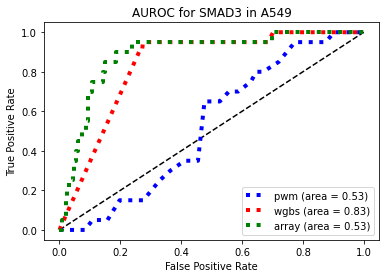

AUROC calculated for SMAD3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


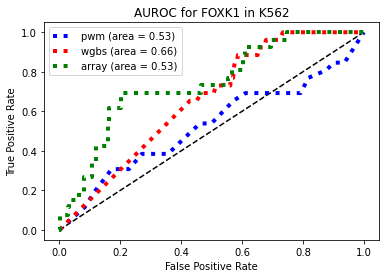

AUROC calculated for FOXK1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


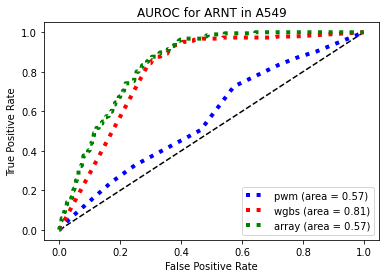

AUROC calculated for ARNT in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


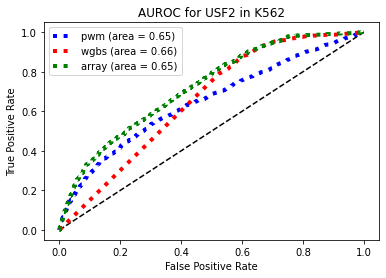

AUROC calculated for USF2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


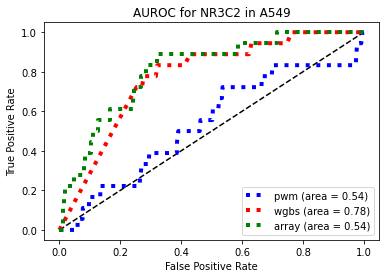

AUROC calculated for NR3C2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


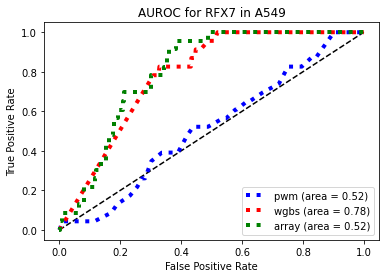

AUROC calculated for RFX7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


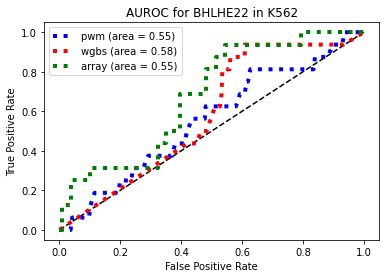

AUROC calculated for BHLHE22 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


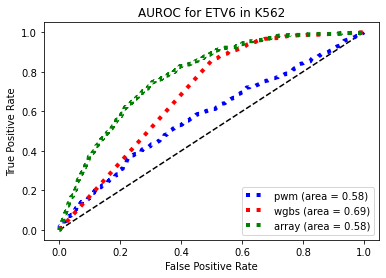

AUROC calculated for ETV6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


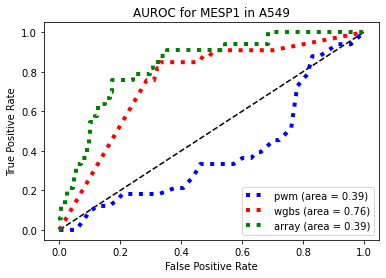

AUROC calculated for MESP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


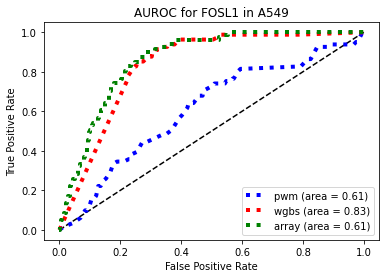

AUROC calculated for FOSL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

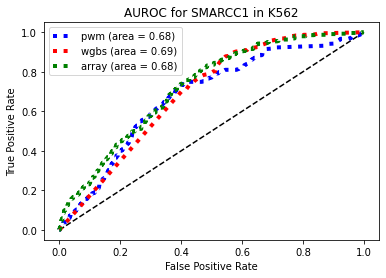

AUROC calculated for SMARCC1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


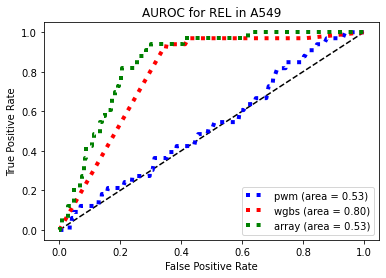

AUROC calculated for REL in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

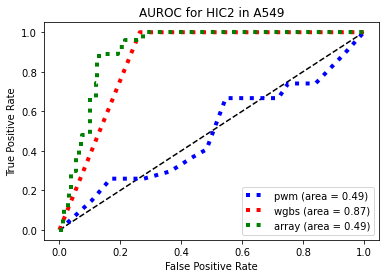

AUROC calculated for HIC2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


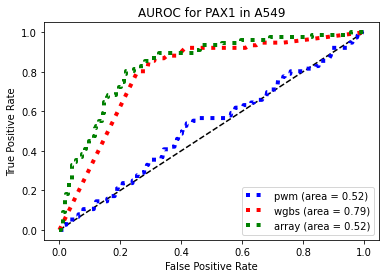

AUROC calculated for PAX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


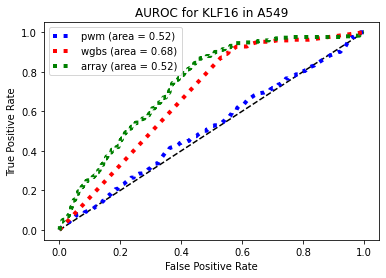

AUROC calculated for KLF16 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


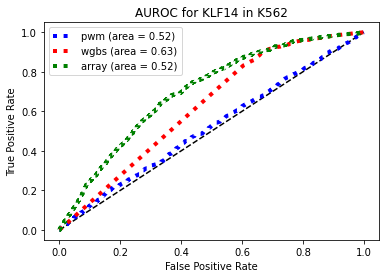

AUROC calculated for KLF14 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


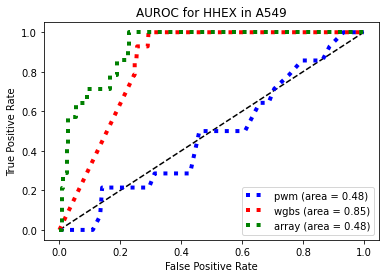

AUROC calculated for HHEX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


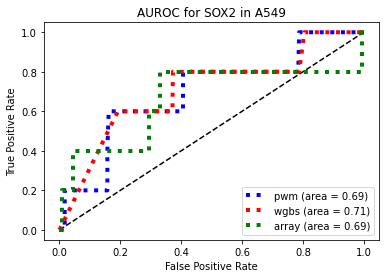

AUROC calculated for SOX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

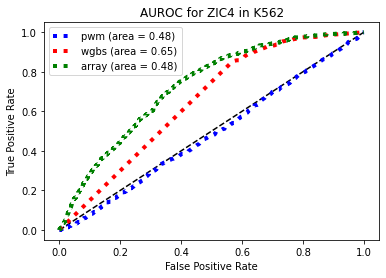

AUROC calculated for ZIC4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


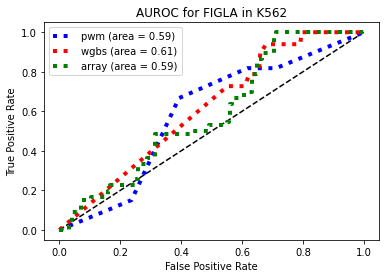

AUROC calculated for FIGLA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


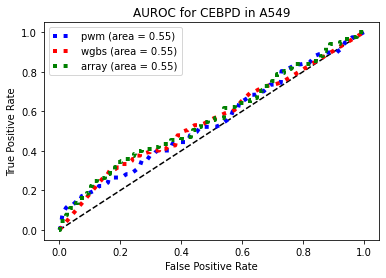

AUROC calculated for CEBPD in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


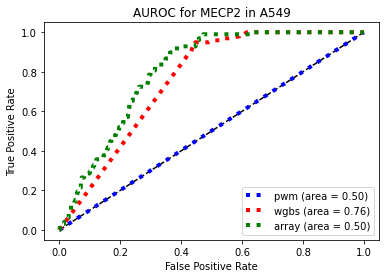

AUROC calculated for MECP2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


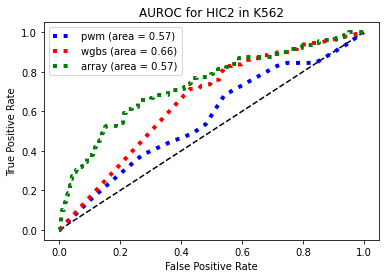

AUROC calculated for HIC2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


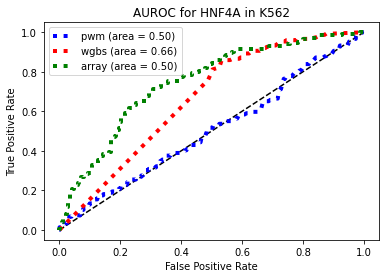

AUROC calculated for HNF4A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


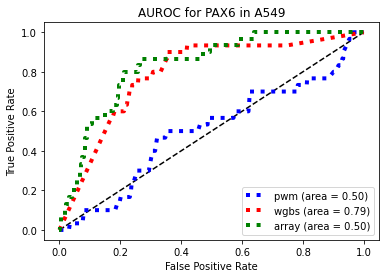

AUROC calculated for PAX6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


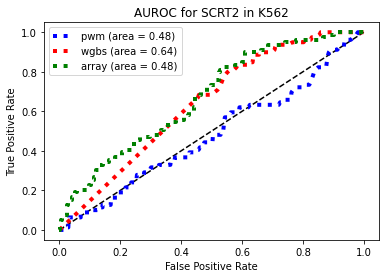

AUROC calculated for SCRT2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


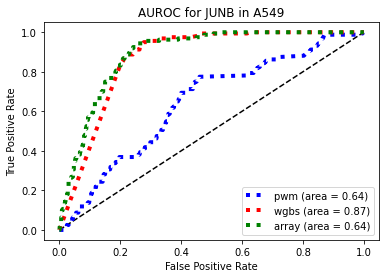

AUROC calculated for JUNB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


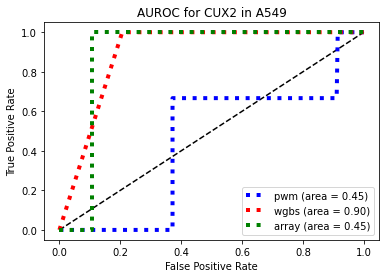

AUROC calculated for CUX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

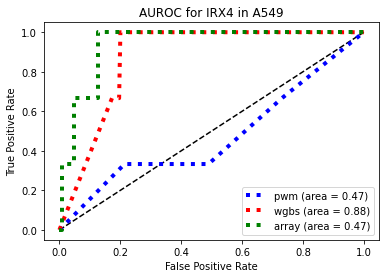

AUROC calculated for IRX4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


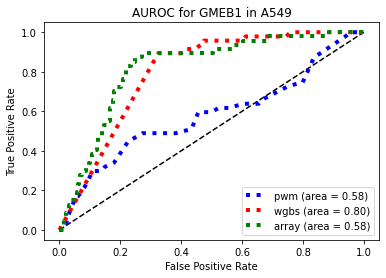

AUROC calculated for GMEB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


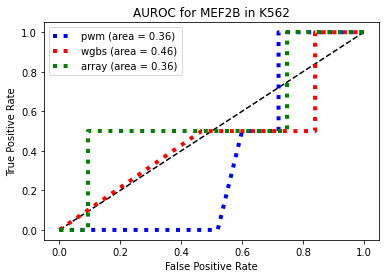

AUROC calculated for MEF2B in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

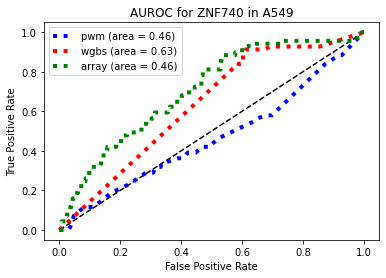

AUROC calculated for ZNF740 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


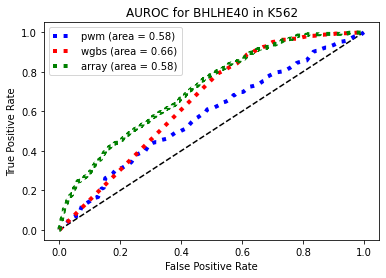

AUROC calculated for BHLHE40 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


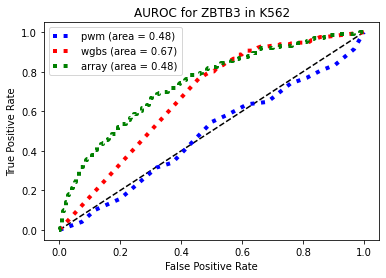

AUROC calculated for ZBTB3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

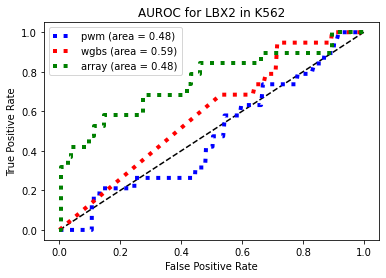

AUROC calculated for LBX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

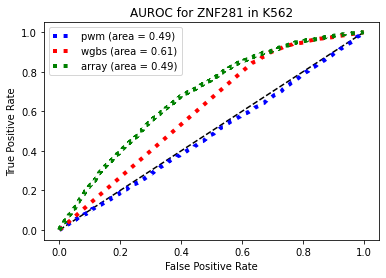

AUROC calculated for ZNF281 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


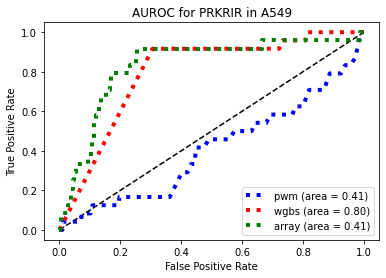

AUROC calculated for PRKRIR in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


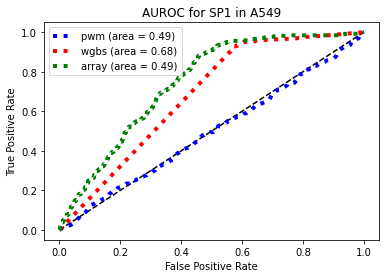

AUROC calculated for SP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

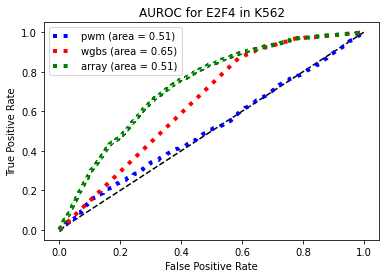

AUROC calculated for E2F4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


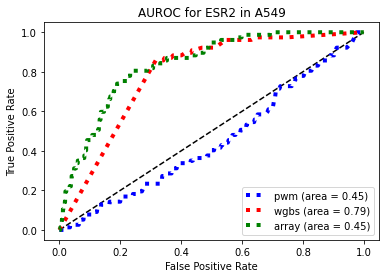

AUROC calculated for ESR2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

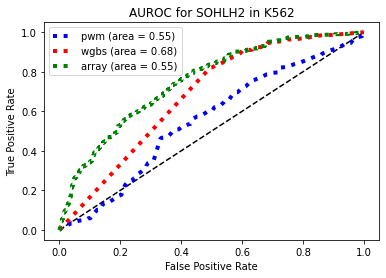

AUROC calculated for SOHLH2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


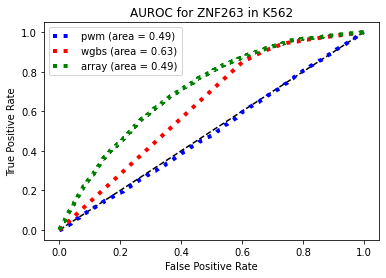

AUROC calculated for ZNF263 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


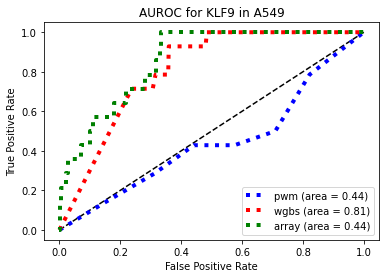

AUROC calculated for KLF9 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


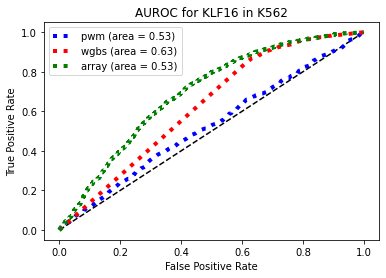

AUROC calculated for KLF16 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


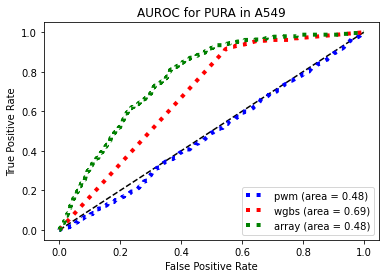

AUROC calculated for PURA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


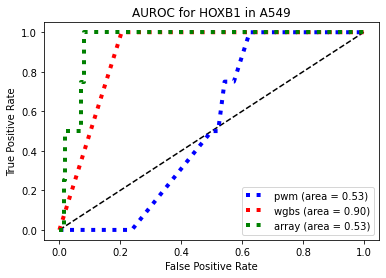

AUROC calculated for HOXB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


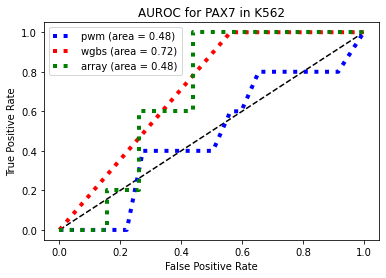

AUROC calculated for PAX7 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


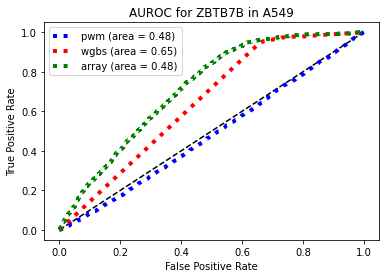

AUROC calculated for ZBTB7B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


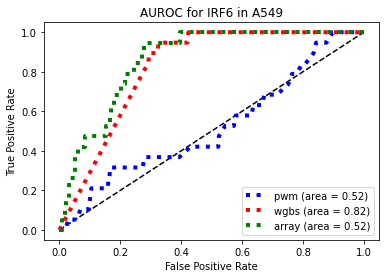

AUROC calculated for IRF6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

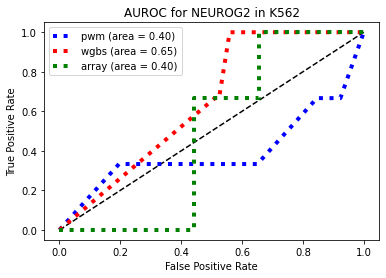

AUROC calculated for NEUROG2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


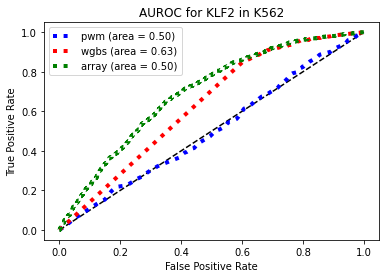

AUROC calculated for KLF2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


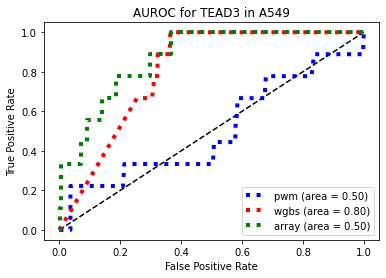

AUROC calculated for TEAD3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


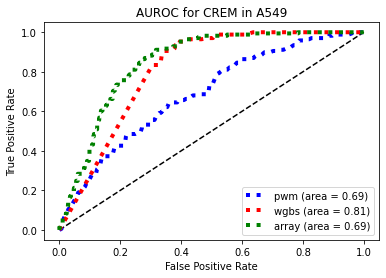

AUROC calculated for CREM in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


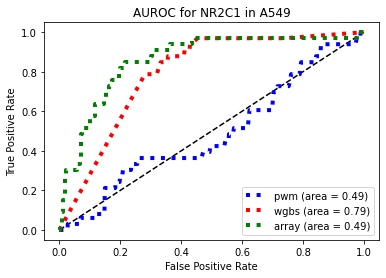

AUROC calculated for NR2C1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

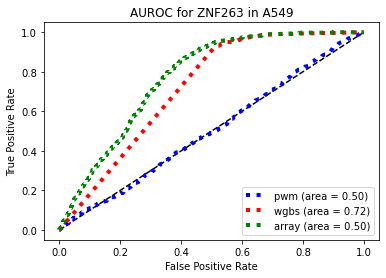

AUROC calculated for ZNF263 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


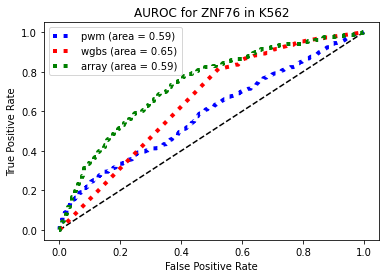

AUROC calculated for ZNF76 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


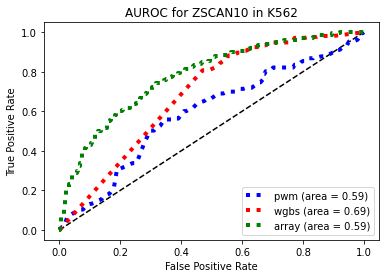

AUROC calculated for ZSCAN10 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


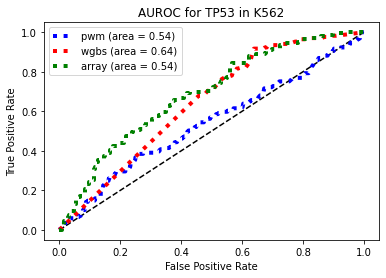

AUROC calculated for TP53 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

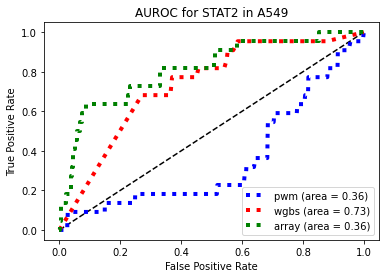

AUROC calculated for STAT2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


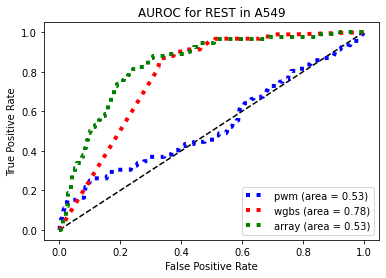

AUROC calculated for REST in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


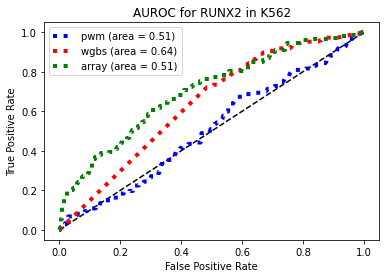

AUROC calculated for RUNX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


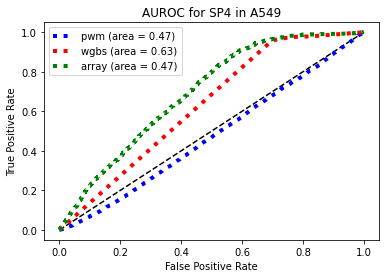

AUROC calculated for SP4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

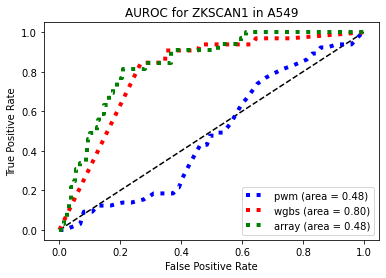

AUROC calculated for ZKSCAN1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


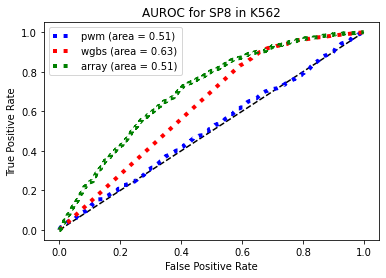

AUROC calculated for SP8 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


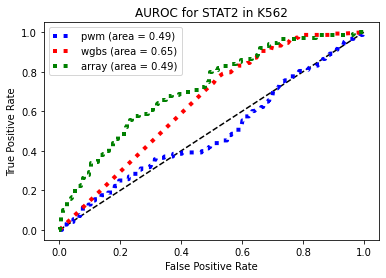

AUROC calculated for STAT2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


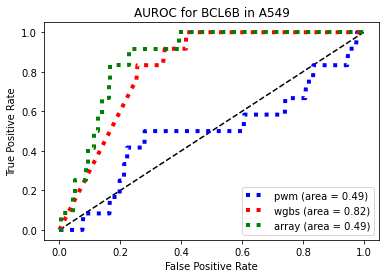

AUROC calculated for BCL6B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


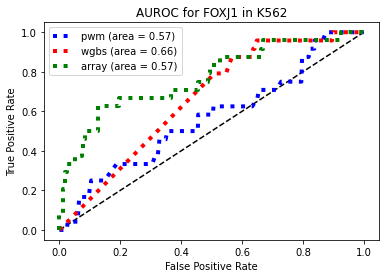

AUROC calculated for FOXJ1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

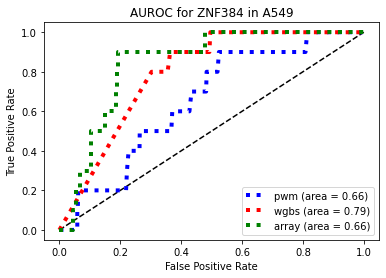

AUROC calculated for ZNF384 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


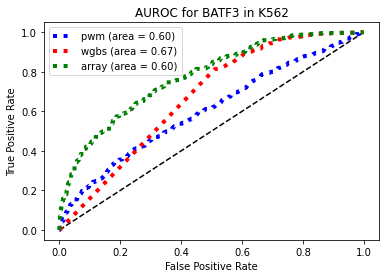

AUROC calculated for BATF3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

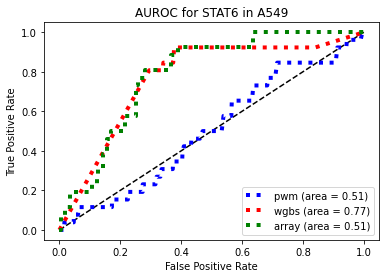

AUROC calculated for STAT6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


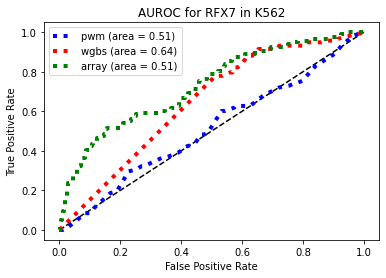

AUROC calculated for RFX7 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


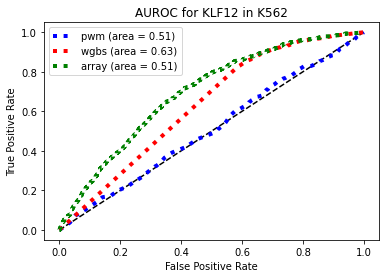

AUROC calculated for KLF12 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


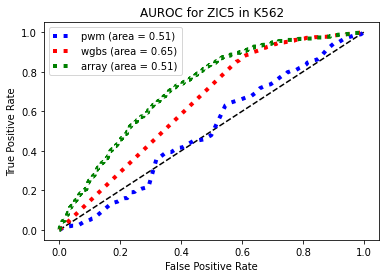

AUROC calculated for ZIC5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


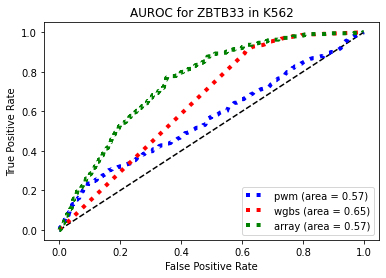

AUROC calculated for ZBTB33 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


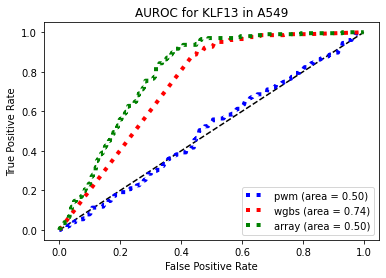

AUROC calculated for KLF13 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


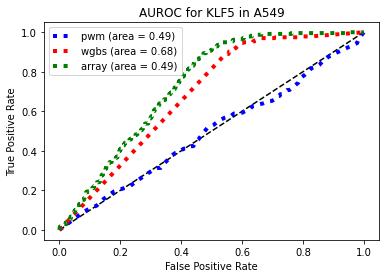

AUROC calculated for KLF5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


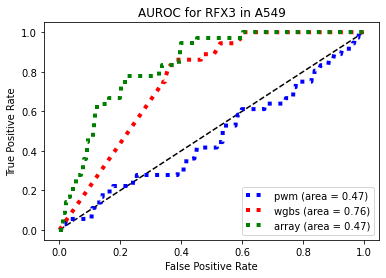

AUROC calculated for RFX3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


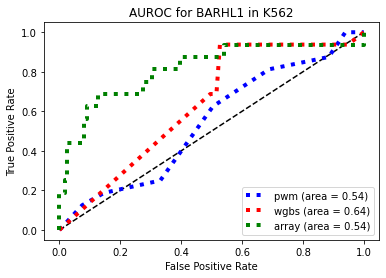

AUROC calculated for BARHL1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


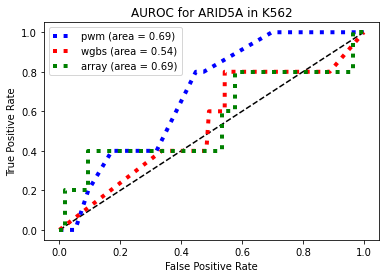

AUROC calculated for ARID5A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


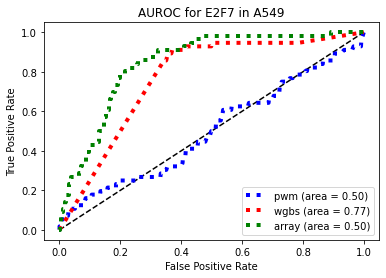

AUROC calculated for E2F7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


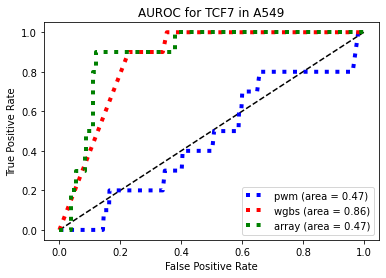

AUROC calculated for TCF7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


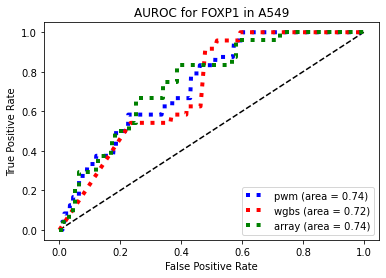

AUROC calculated for FOXP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


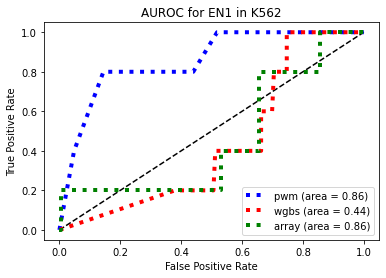

AUROC calculated for EN1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


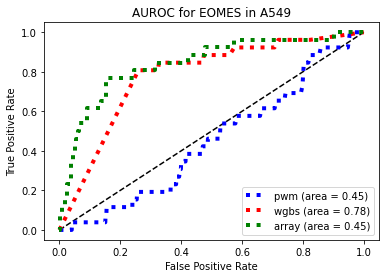

AUROC calculated for EOMES in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


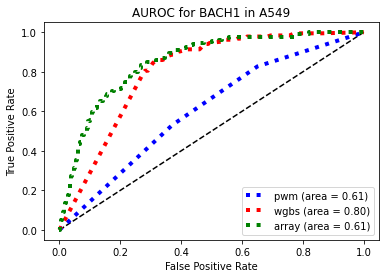

AUROC calculated for BACH1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


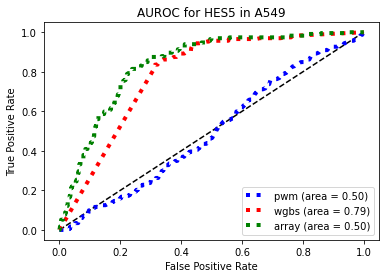

AUROC calculated for HES5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


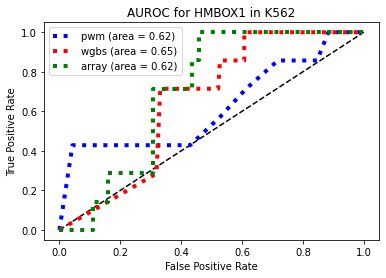

AUROC calculated for HMBOX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


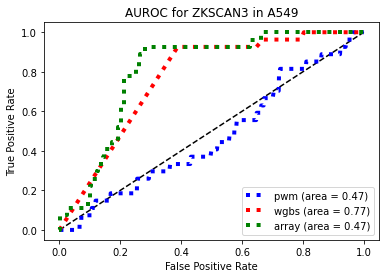

AUROC calculated for ZKSCAN3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


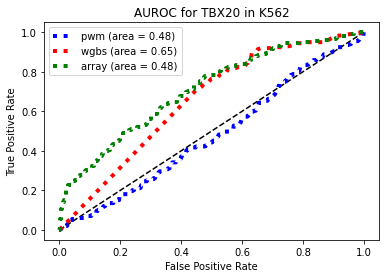

AUROC calculated for TBX20 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


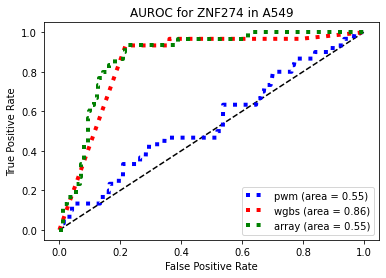

AUROC calculated for ZNF274 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


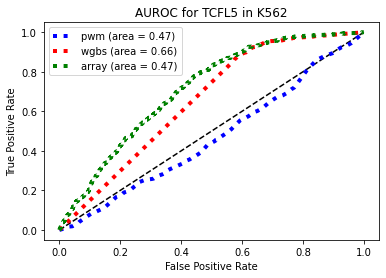

AUROC calculated for TCFL5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


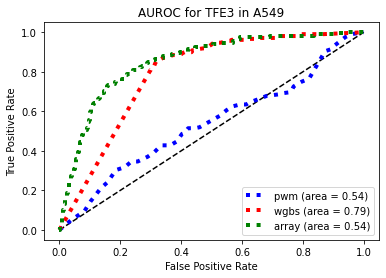

AUROC calculated for TFE3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


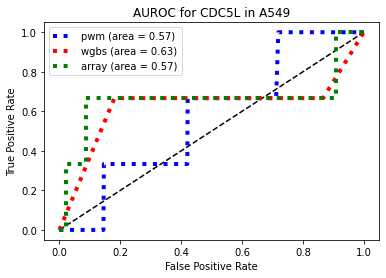

AUROC calculated for CDC5L in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


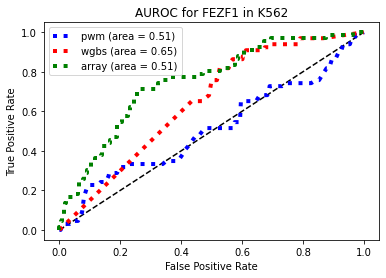

AUROC calculated for FEZF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


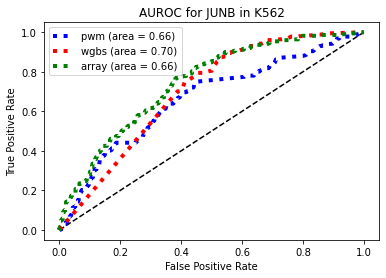

AUROC calculated for JUNB in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


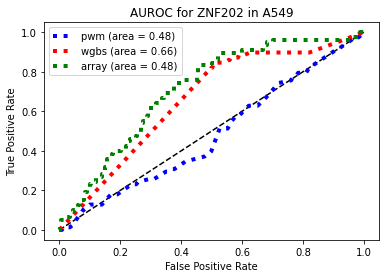

AUROC calculated for ZNF202 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


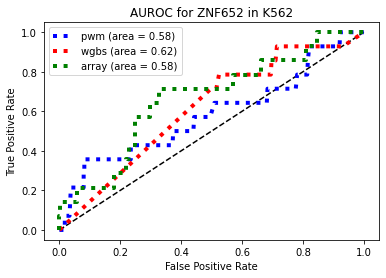

AUROC calculated for ZNF652 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


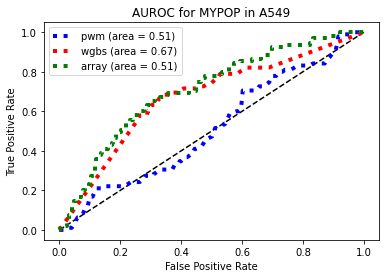

AUROC calculated for MYPOP in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

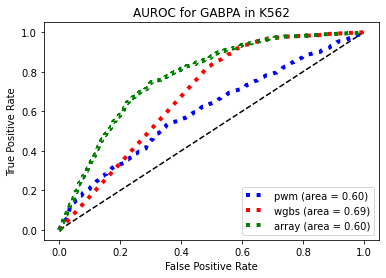

AUROC calculated for GABPA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


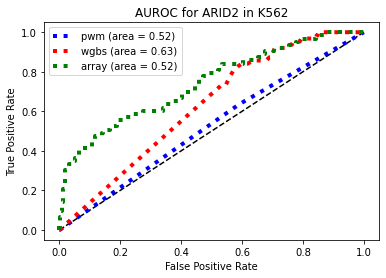

AUROC calculated for ARID2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


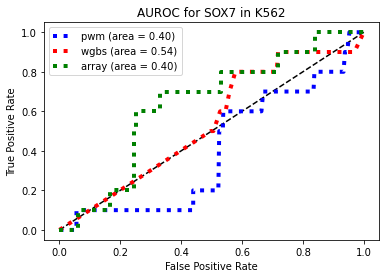

AUROC calculated for SOX7 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


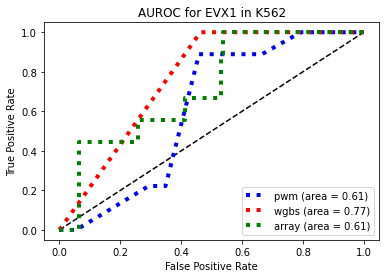

AUROC calculated for EVX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


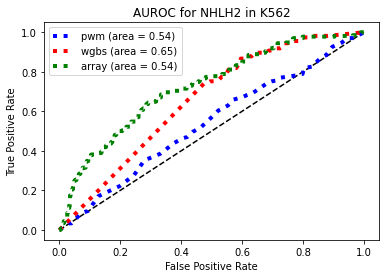

AUROC calculated for NHLH2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


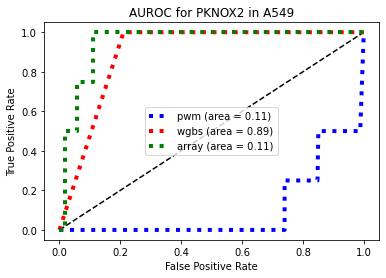

AUROC calculated for PKNOX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


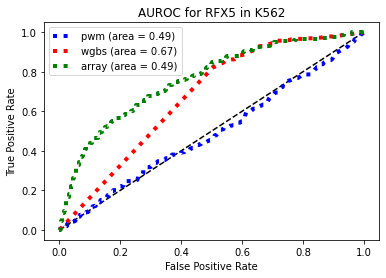

AUROC calculated for RFX5 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

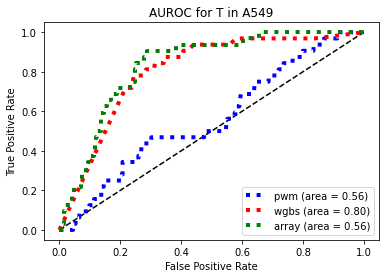

AUROC calculated for T in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


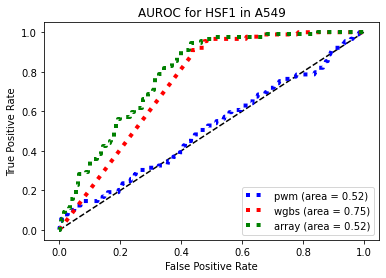

AUROC calculated for HSF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


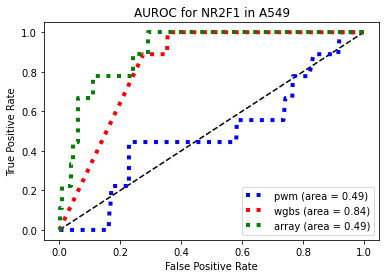

AUROC calculated for NR2F1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


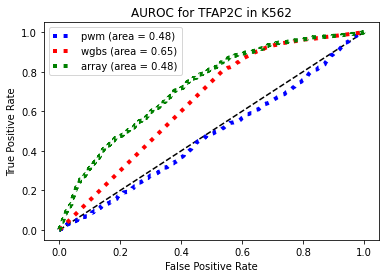

AUROC calculated for TFAP2C in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


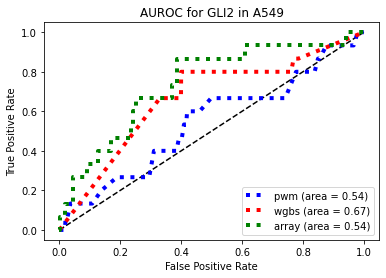

AUROC calculated for GLI2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


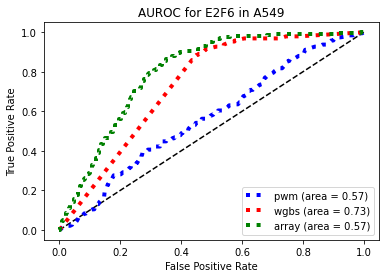

AUROC calculated for E2F6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


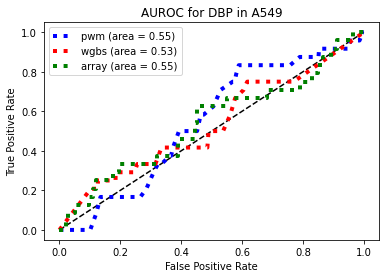

AUROC calculated for DBP in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


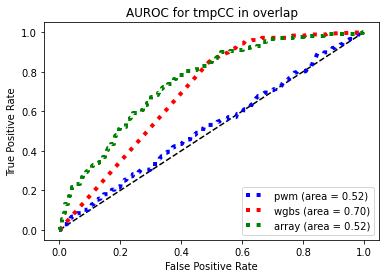

AUROC calculated for tmpCC in overlap


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

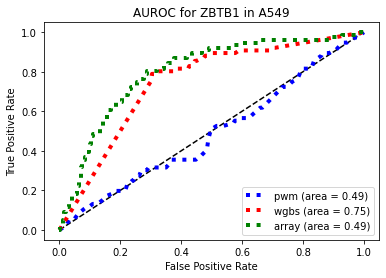

AUROC calculated for ZBTB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


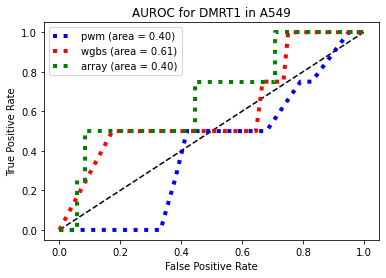

AUROC calculated for DMRT1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


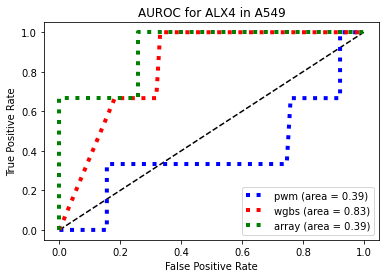

AUROC calculated for ALX4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


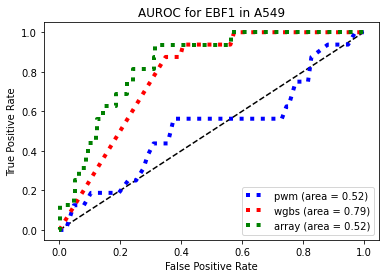

AUROC calculated for EBF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


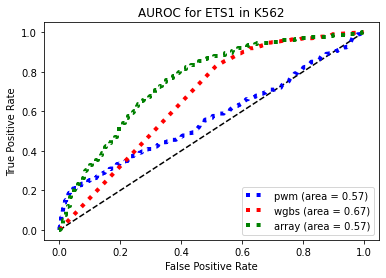

AUROC calculated for ETS1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


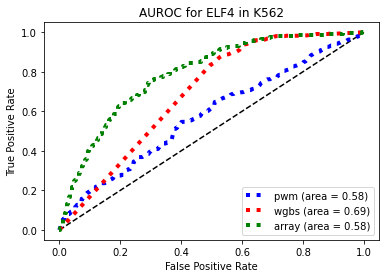

AUROC calculated for ELF4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


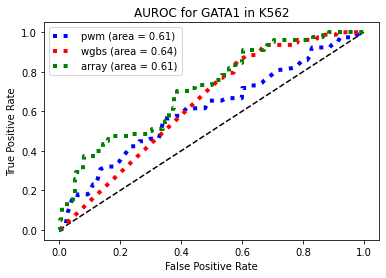

AUROC calculated for GATA1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


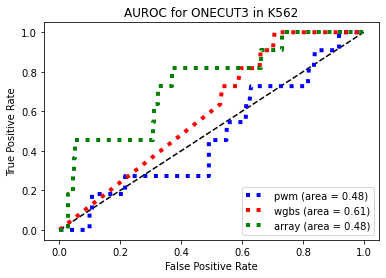

AUROC calculated for ONECUT3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


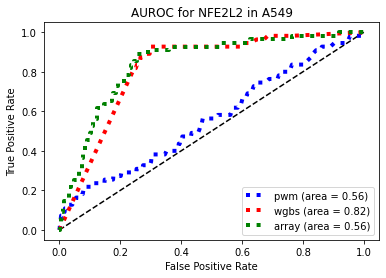

AUROC calculated for NFE2L2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


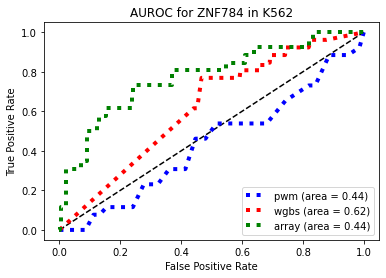

AUROC calculated for ZNF784 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


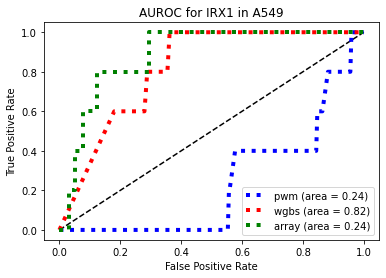

AUROC calculated for IRX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


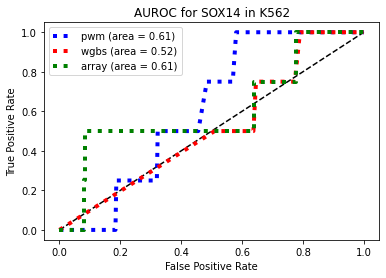

AUROC calculated for SOX14 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


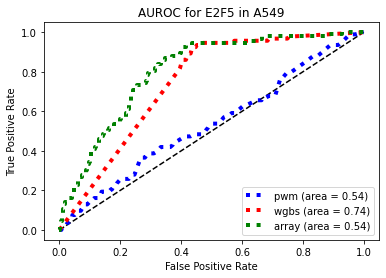

AUROC calculated for E2F5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


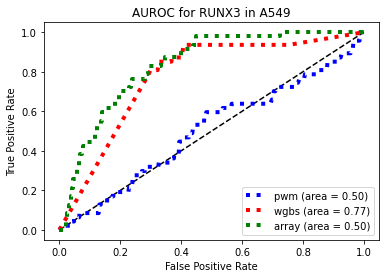

AUROC calculated for RUNX3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


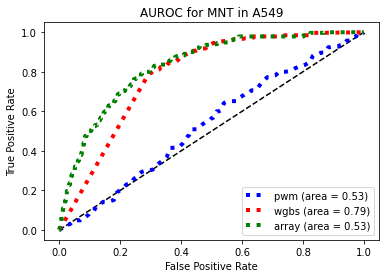

AUROC calculated for MNT in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


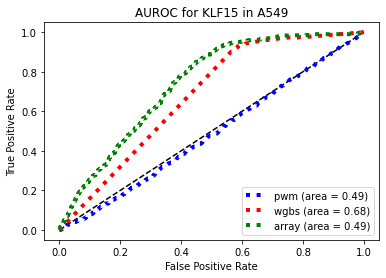

AUROC calculated for KLF15 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


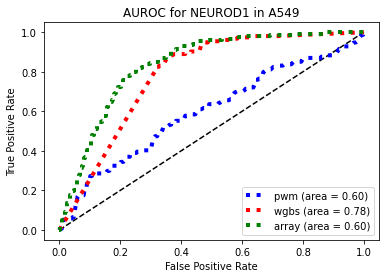

AUROC calculated for NEUROD1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


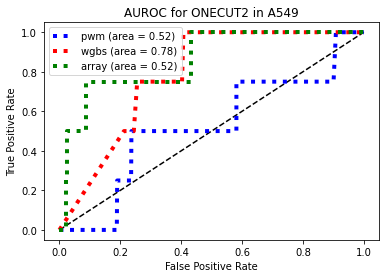

AUROC calculated for ONECUT2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


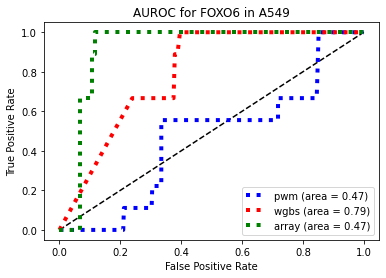

AUROC calculated for FOXO6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


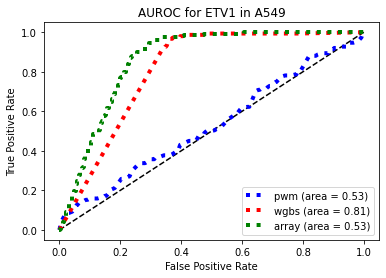

AUROC calculated for ETV1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


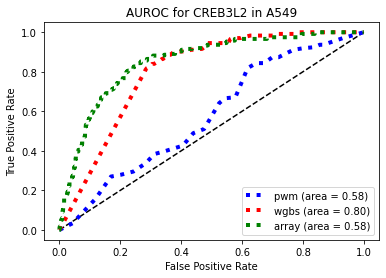

AUROC calculated for CREB3L2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


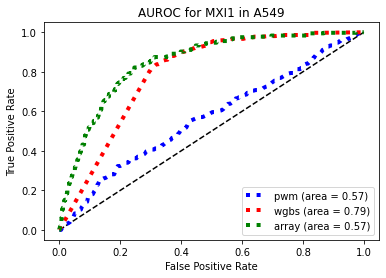

AUROC calculated for MXI1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


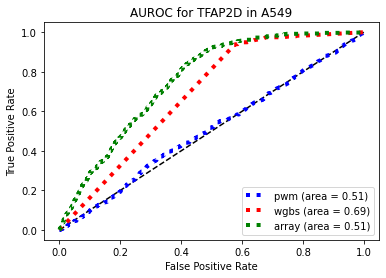

AUROC calculated for TFAP2D in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


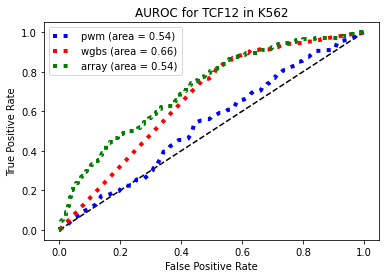

AUROC calculated for TCF12 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

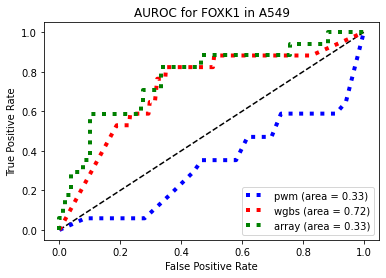

AUROC calculated for FOXK1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


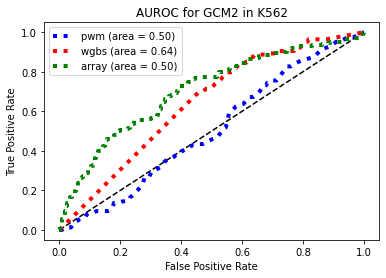

AUROC calculated for GCM2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


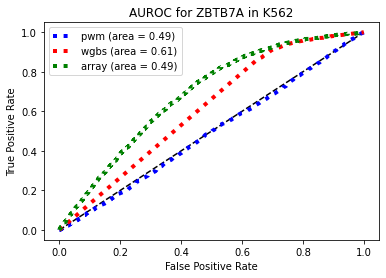

AUROC calculated for ZBTB7A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

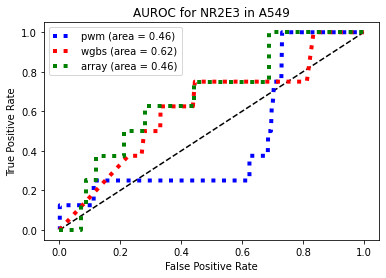

AUROC calculated for NR2E3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


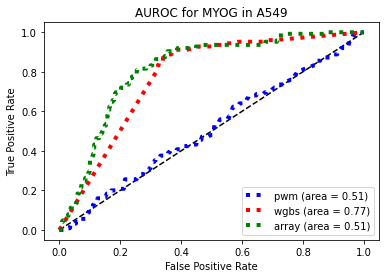

AUROC calculated for MYOG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


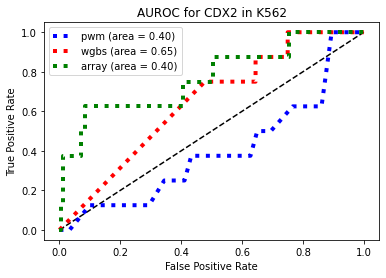

AUROC calculated for CDX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


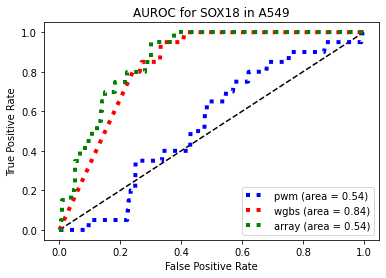

AUROC calculated for SOX18 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


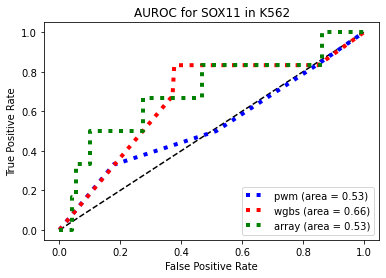

AUROC calculated for SOX11 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


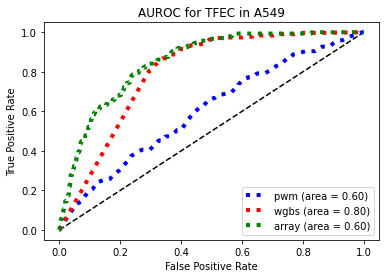

AUROC calculated for TFEC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

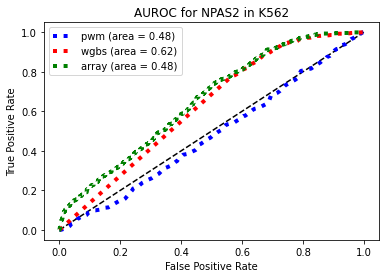

AUROC calculated for NPAS2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


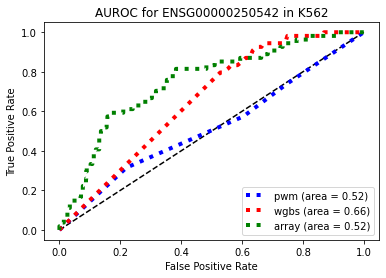

AUROC calculated for ENSG00000250542 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


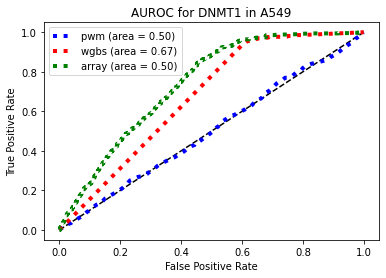

AUROC calculated for DNMT1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

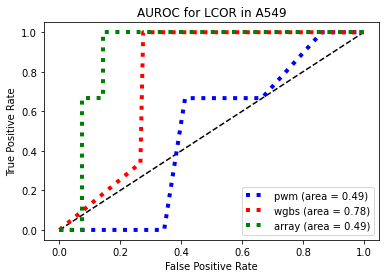

AUROC calculated for LCOR in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


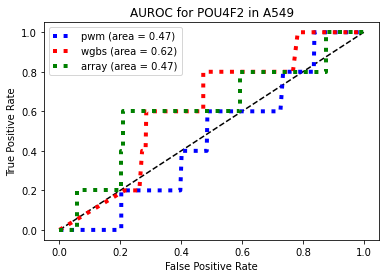

AUROC calculated for POU4F2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

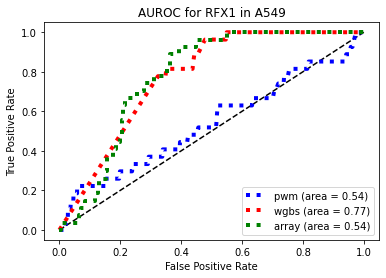

AUROC calculated for RFX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


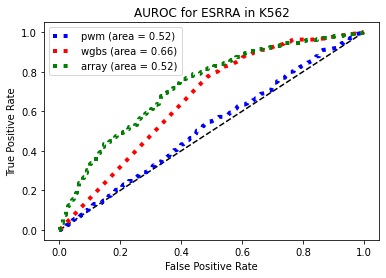

AUROC calculated for ESRRA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


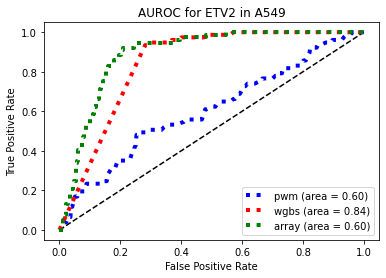

AUROC calculated for ETV2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


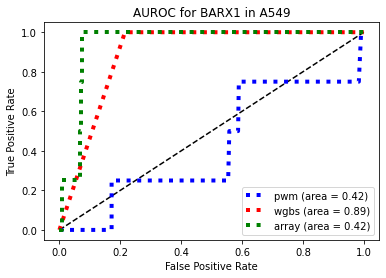

AUROC calculated for BARX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


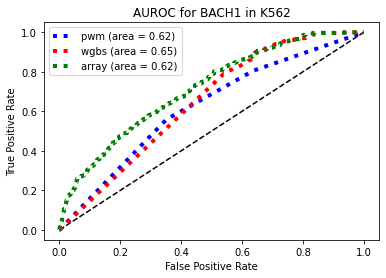

AUROC calculated for BACH1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


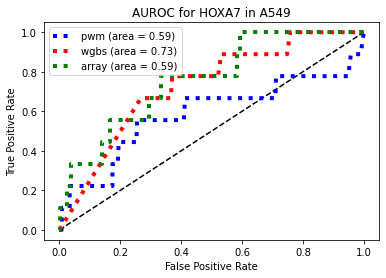

AUROC calculated for HOXA7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


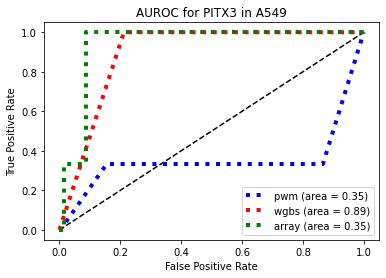

AUROC calculated for PITX3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


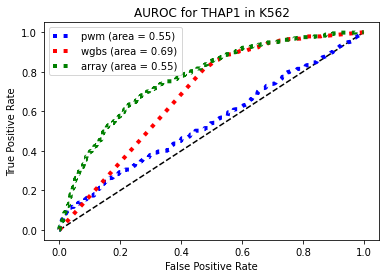

AUROC calculated for THAP1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


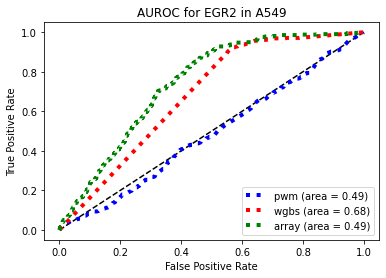

AUROC calculated for EGR2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


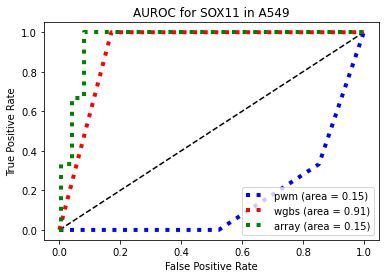

AUROC calculated for SOX11 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

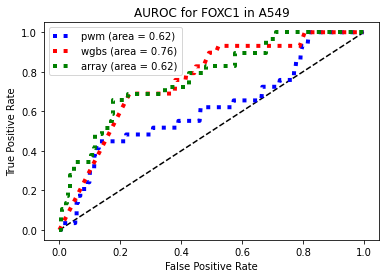

AUROC calculated for FOXC1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


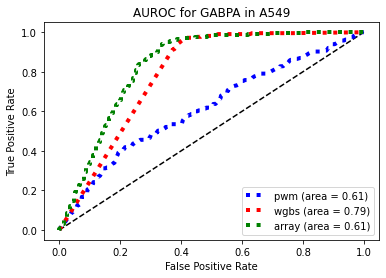

AUROC calculated for GABPA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


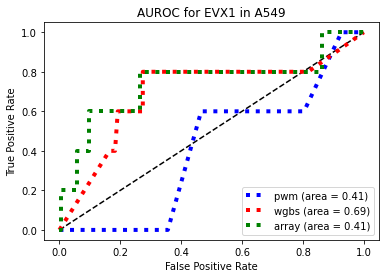

AUROC calculated for EVX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


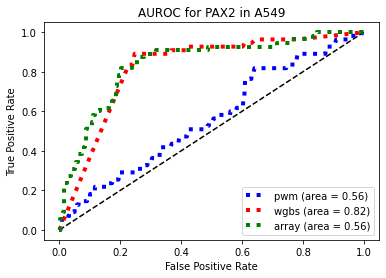

AUROC calculated for PAX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


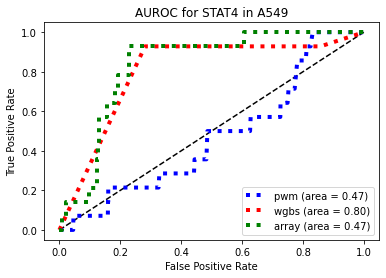

AUROC calculated for STAT4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


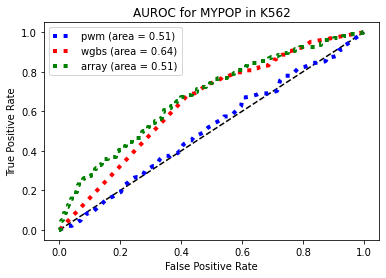

AUROC calculated for MYPOP in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


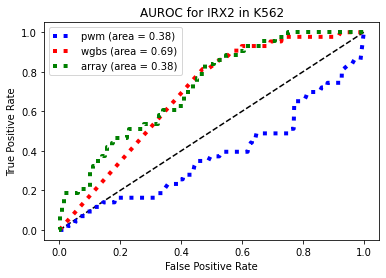

AUROC calculated for IRX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


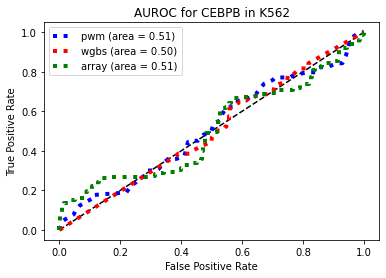

AUROC calculated for CEBPB in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


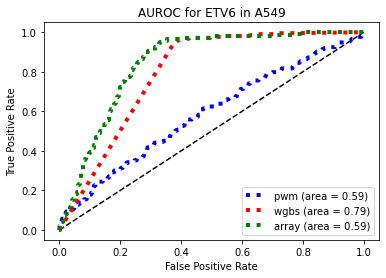

AUROC calculated for ETV6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


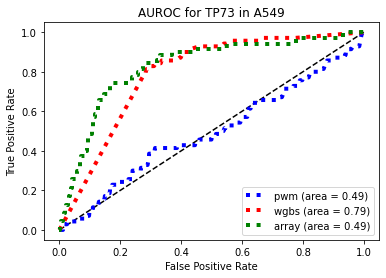

AUROC calculated for TP73 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


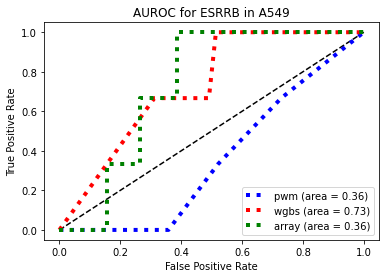

AUROC calculated for ESRRB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

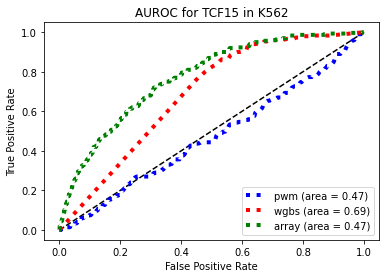

AUROC calculated for TCF15 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

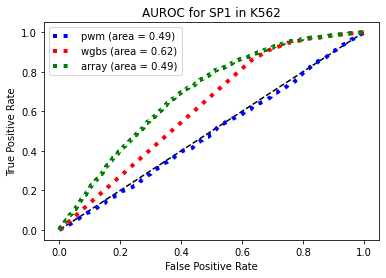

AUROC calculated for SP1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


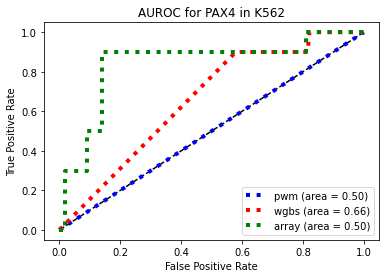

AUROC calculated for PAX4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


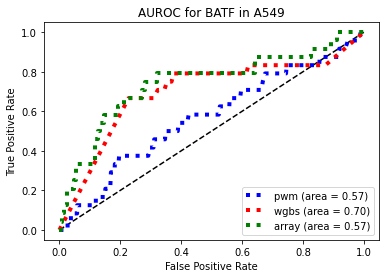

AUROC calculated for BATF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


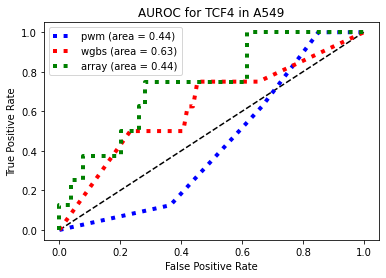

AUROC calculated for TCF4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


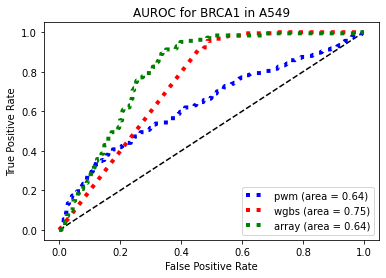

AUROC calculated for BRCA1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


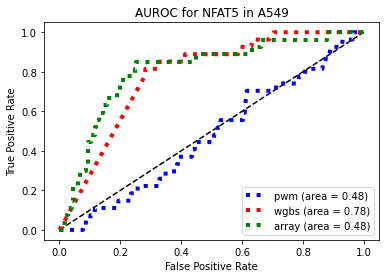

AUROC calculated for NFAT5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


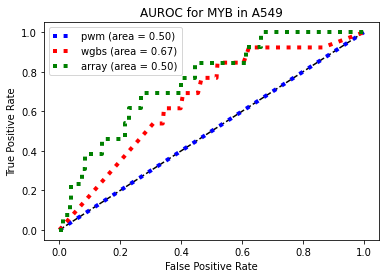

AUROC calculated for MYB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


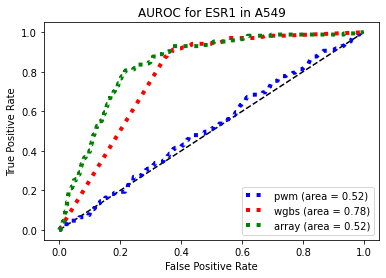

AUROC calculated for ESR1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


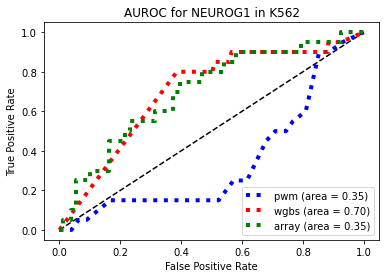

AUROC calculated for NEUROG1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


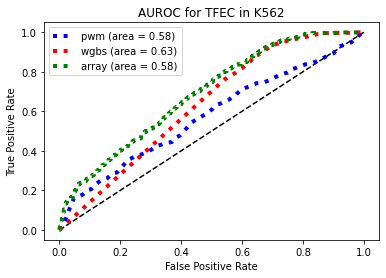

AUROC calculated for TFEC in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


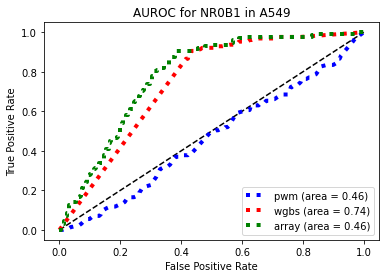

AUROC calculated for NR0B1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

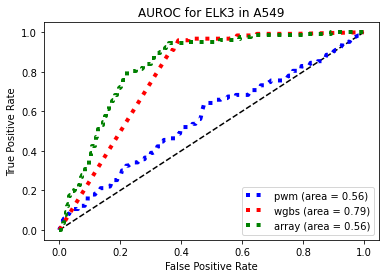

AUROC calculated for ELK3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


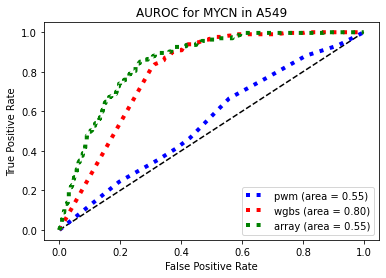

AUROC calculated for MYCN in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


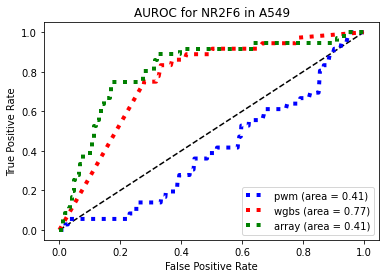

AUROC calculated for NR2F6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


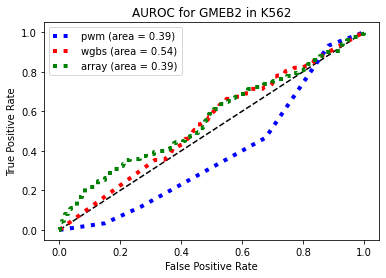

AUROC calculated for GMEB2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


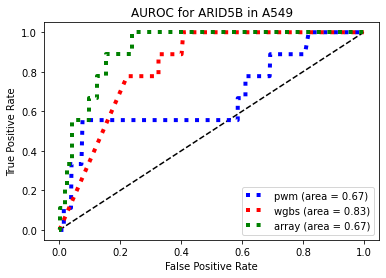

AUROC calculated for ARID5B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


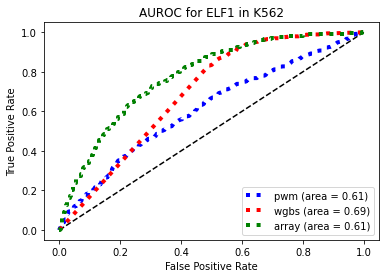

AUROC calculated for ELF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


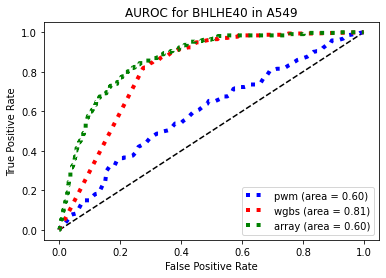

AUROC calculated for BHLHE40 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


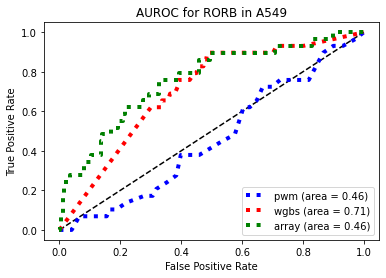

AUROC calculated for RORB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


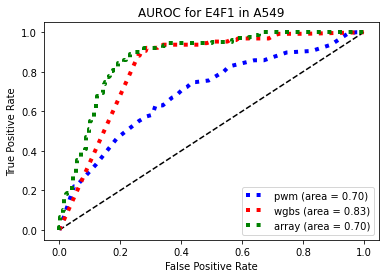

AUROC calculated for E4F1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


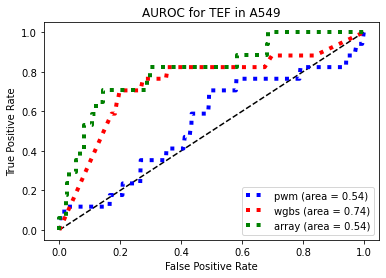

AUROC calculated for TEF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


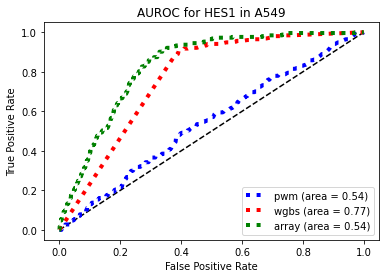

AUROC calculated for HES1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


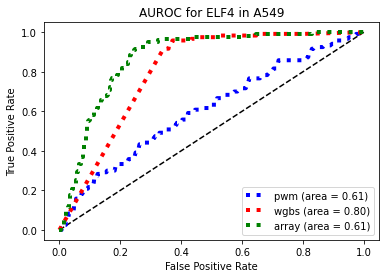

AUROC calculated for ELF4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


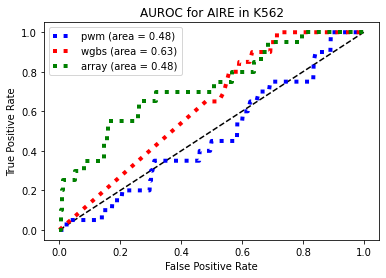

AUROC calculated for AIRE in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


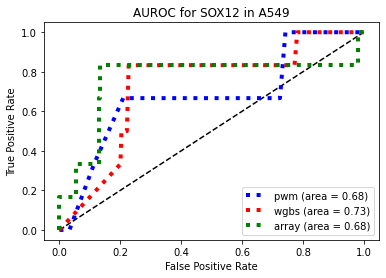

AUROC calculated for SOX12 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


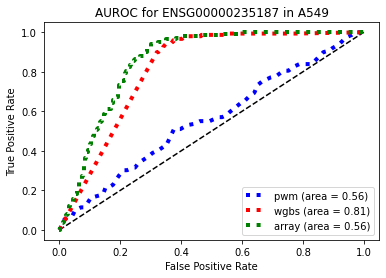

AUROC calculated for ENSG00000235187 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


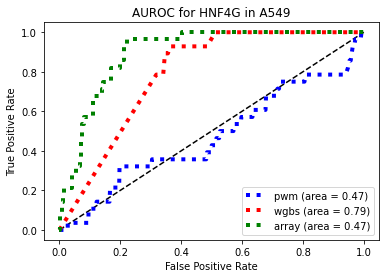

AUROC calculated for HNF4G in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

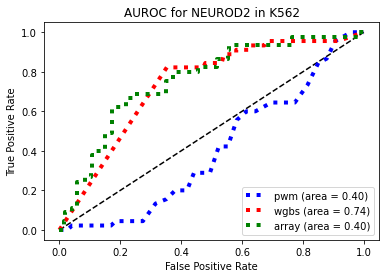

AUROC calculated for NEUROD2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

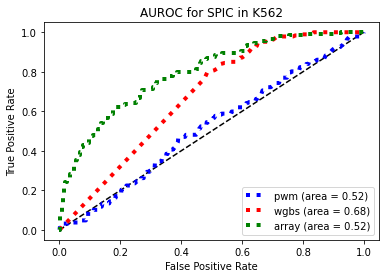

AUROC calculated for SPIC in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


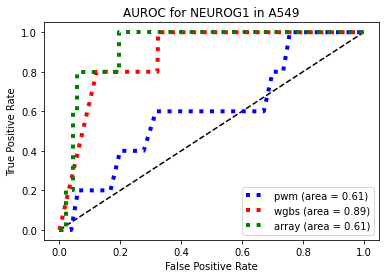

AUROC calculated for NEUROG1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


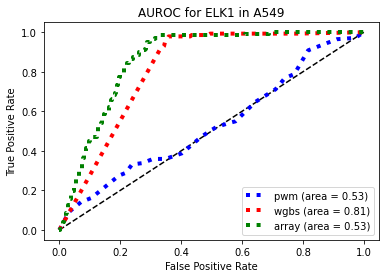

AUROC calculated for ELK1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


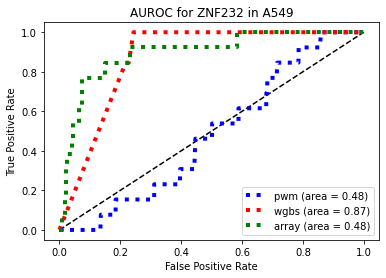

AUROC calculated for ZNF232 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


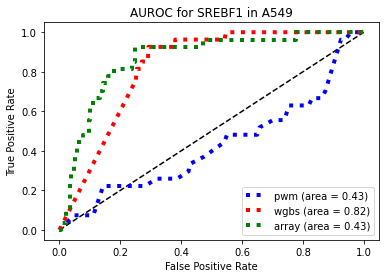

AUROC calculated for SREBF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


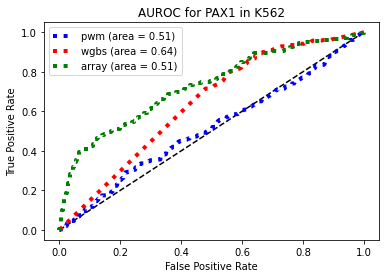

AUROC calculated for PAX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


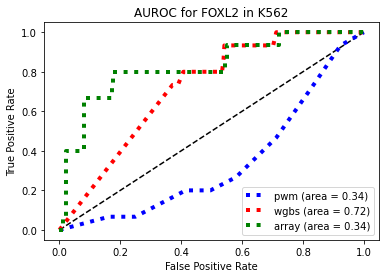

AUROC calculated for FOXL2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


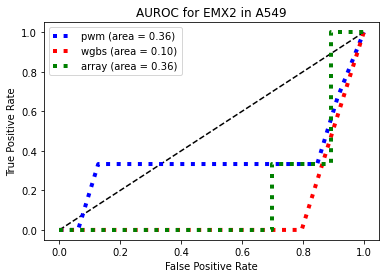

AUROC calculated for EMX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


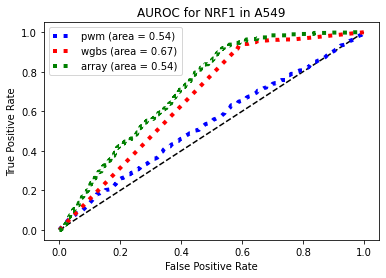

AUROC calculated for NRF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


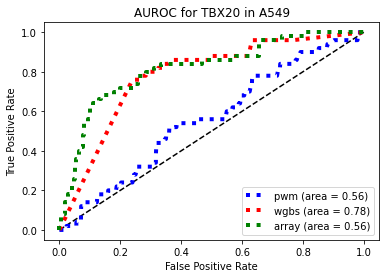

AUROC calculated for TBX20 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


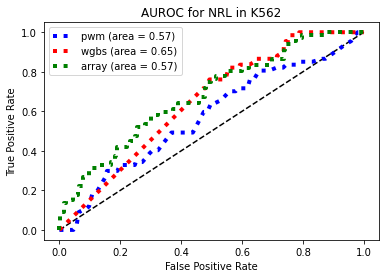

AUROC calculated for NRL in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


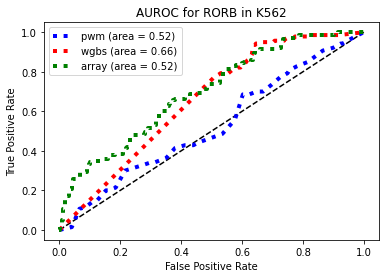

AUROC calculated for RORB in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


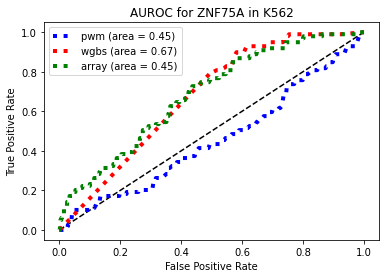

AUROC calculated for ZNF75A in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


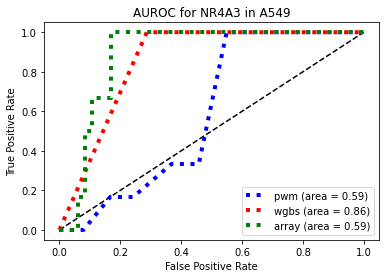

AUROC calculated for NR4A3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


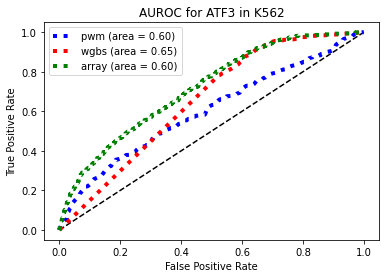

AUROC calculated for ATF3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


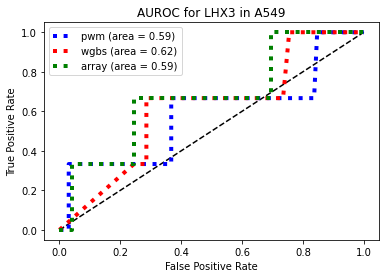

AUROC calculated for LHX3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

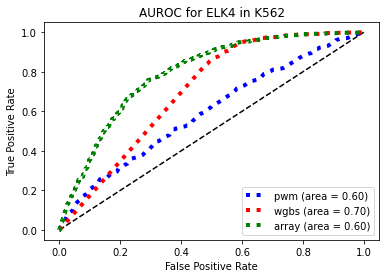

AUROC calculated for ELK4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


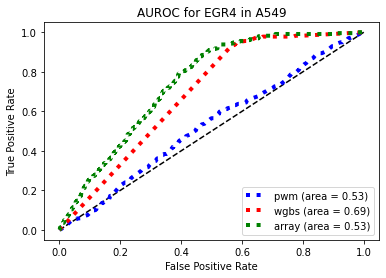

AUROC calculated for EGR4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


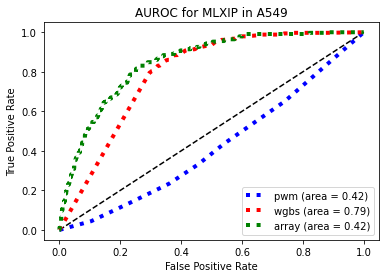

AUROC calculated for MLXIP in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

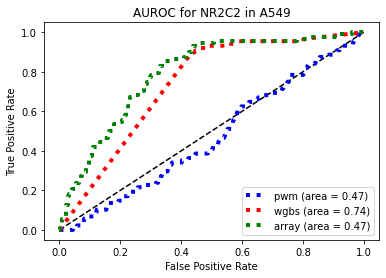

AUROC calculated for NR2C2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


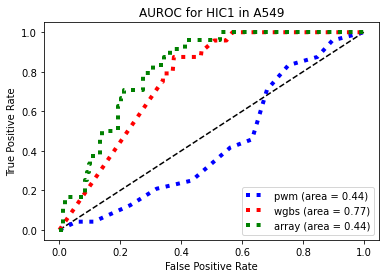

AUROC calculated for HIC1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


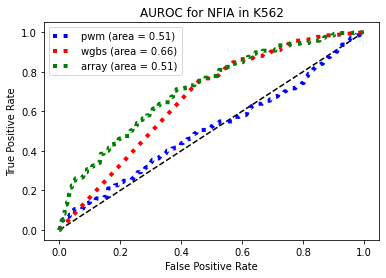

AUROC calculated for NFIA in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


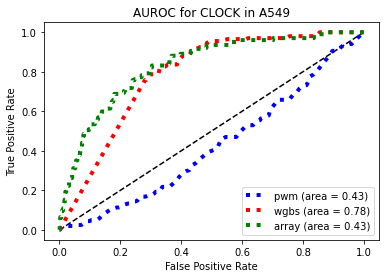

AUROC calculated for CLOCK in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


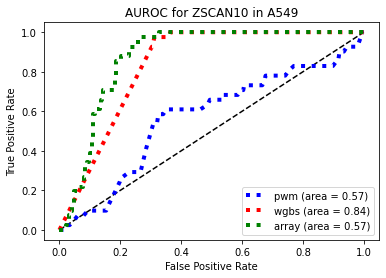

AUROC calculated for ZSCAN10 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

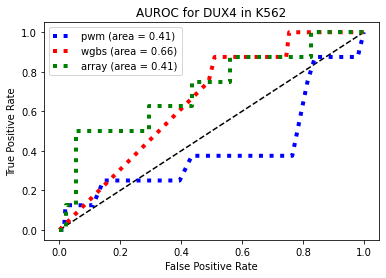

AUROC calculated for DUX4 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


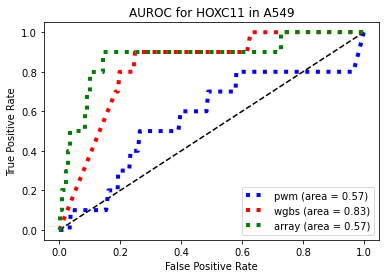

AUROC calculated for HOXC11 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


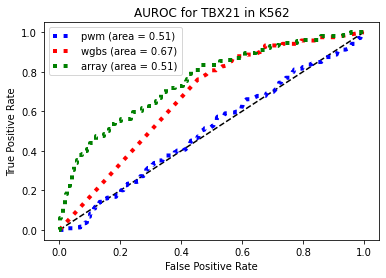

AUROC calculated for TBX21 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


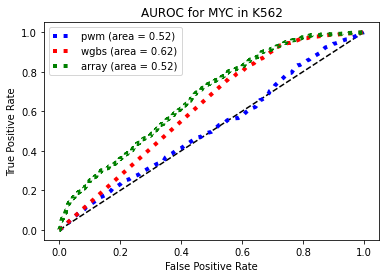

AUROC calculated for MYC in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


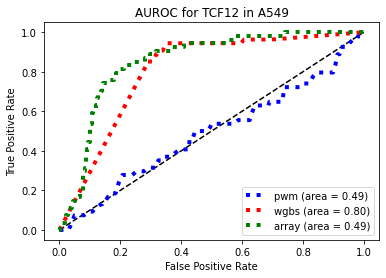

AUROC calculated for TCF12 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


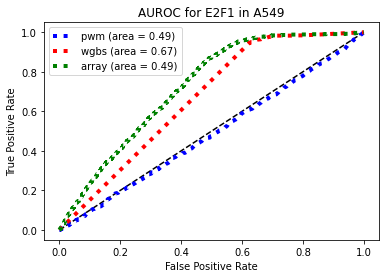

AUROC calculated for E2F1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

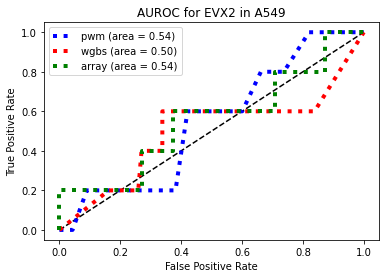

AUROC calculated for EVX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

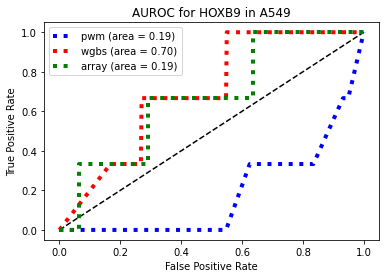

AUROC calculated for HOXB9 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


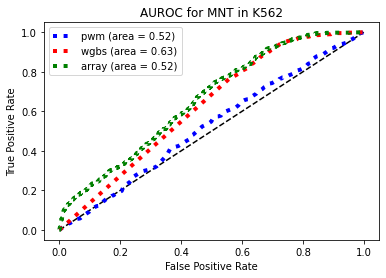

AUROC calculated for MNT in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

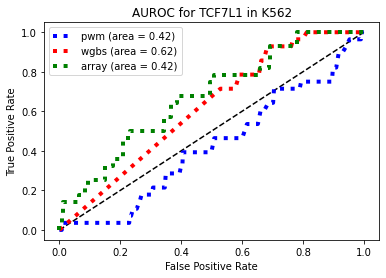

AUROC calculated for TCF7L1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

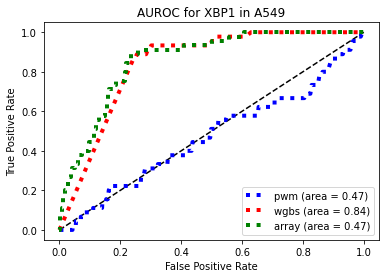

AUROC calculated for XBP1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


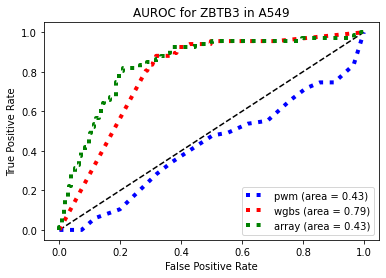

AUROC calculated for ZBTB3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


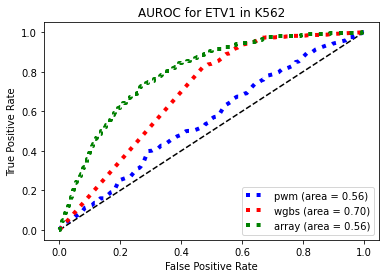

AUROC calculated for ETV1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


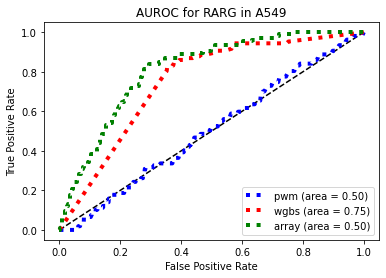

AUROC calculated for RARG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


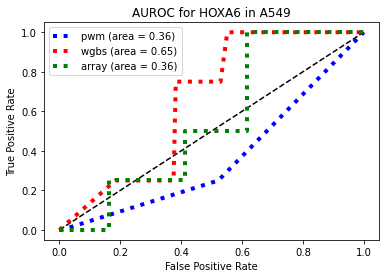

AUROC calculated for HOXA6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


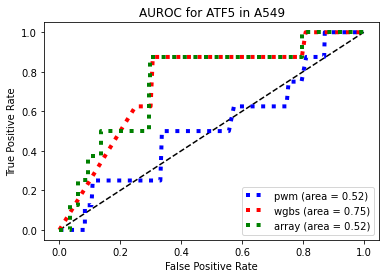

AUROC calculated for ATF5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


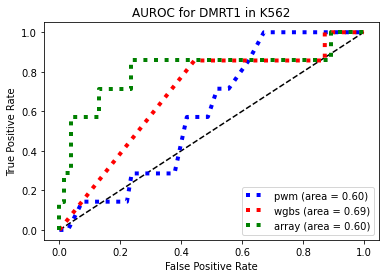

AUROC calculated for DMRT1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


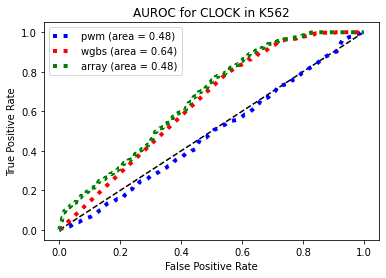

AUROC calculated for CLOCK in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


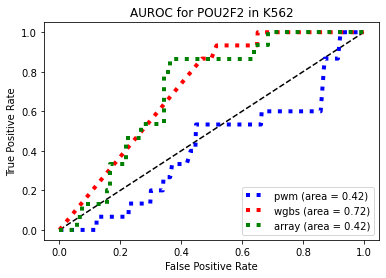

AUROC calculated for POU2F2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


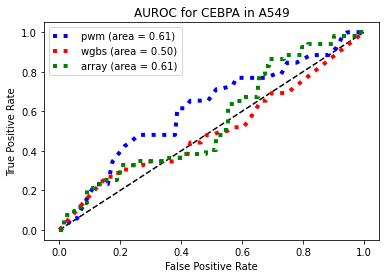

AUROC calculated for CEBPA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


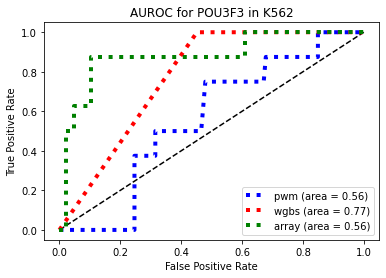

AUROC calculated for POU3F3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


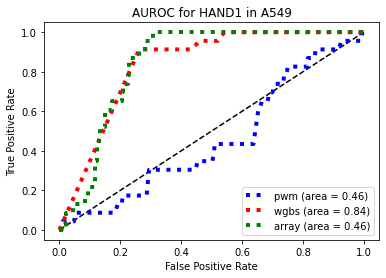

AUROC calculated for HAND1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


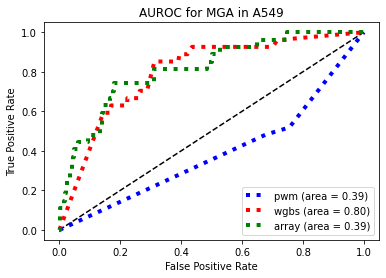

AUROC calculated for MGA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


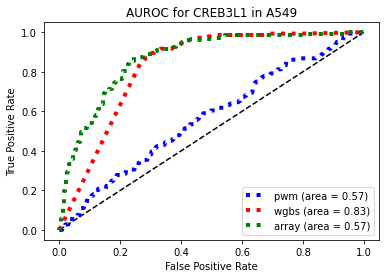

AUROC calculated for CREB3L1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


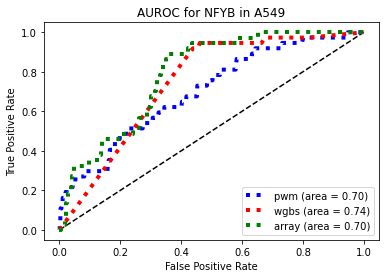

AUROC calculated for NFYB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


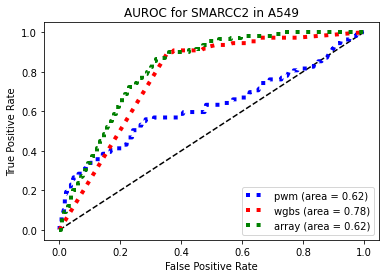

AUROC calculated for SMARCC2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


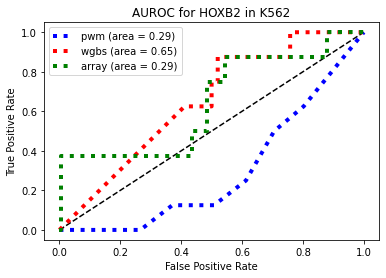

AUROC calculated for HOXB2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


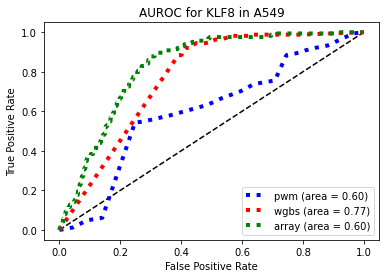

AUROC calculated for KLF8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


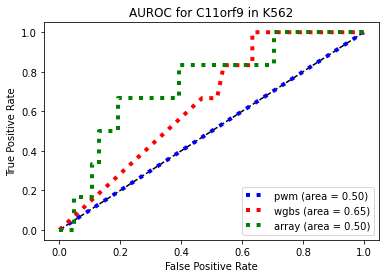

AUROC calculated for C11orf9 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


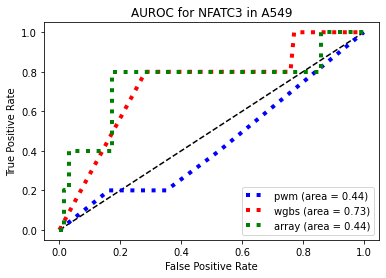

AUROC calculated for NFATC3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


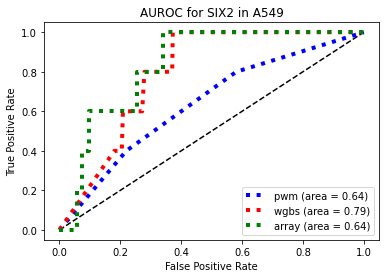

AUROC calculated for SIX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


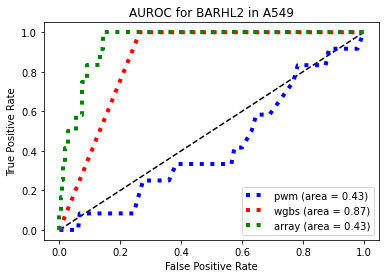

AUROC calculated for BARHL2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


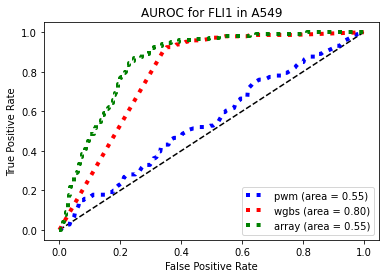

AUROC calculated for FLI1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

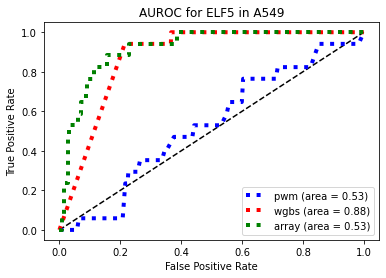

AUROC calculated for ELF5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


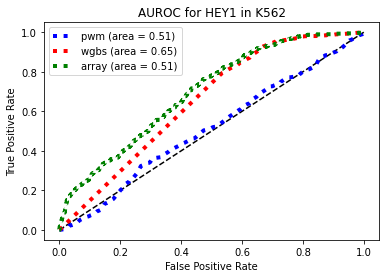

AUROC calculated for HEY1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


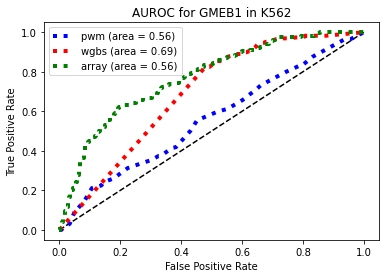

AUROC calculated for GMEB1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


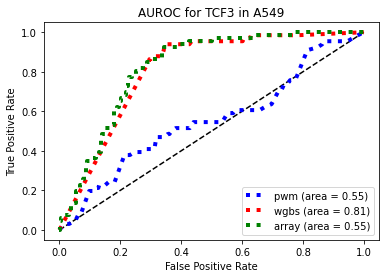

AUROC calculated for TCF3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


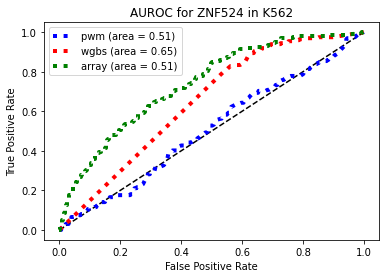

AUROC calculated for ZNF524 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


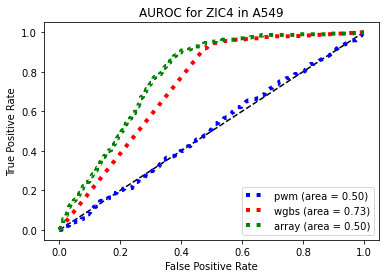

AUROC calculated for ZIC4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


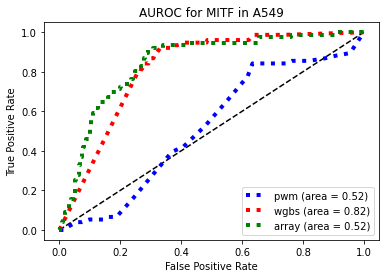

AUROC calculated for MITF in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


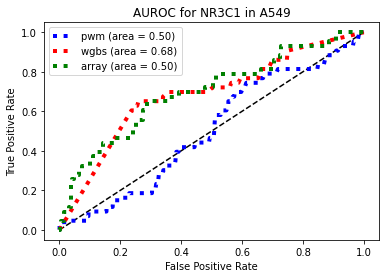

AUROC calculated for NR3C1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


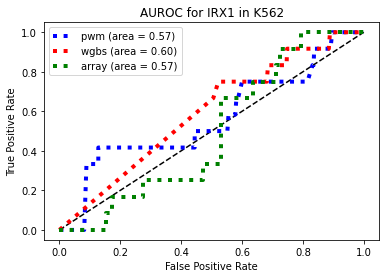

AUROC calculated for IRX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


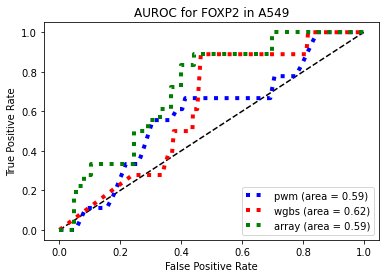

AUROC calculated for FOXP2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


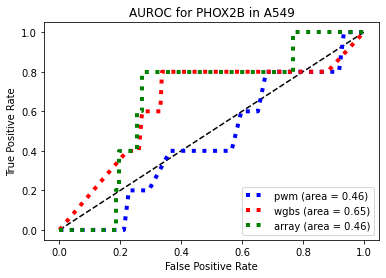

AUROC calculated for PHOX2B in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


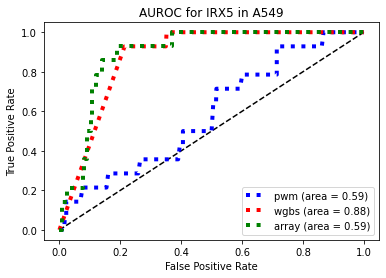

AUROC calculated for IRX5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

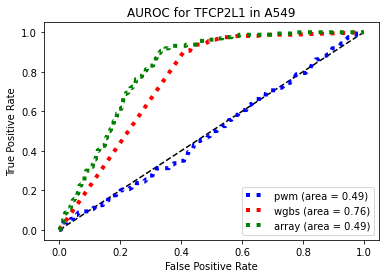

AUROC calculated for TFCP2L1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


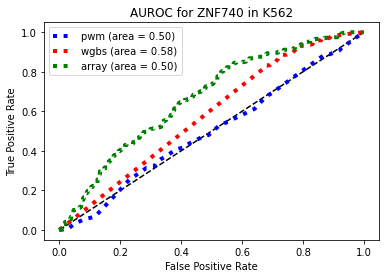

AUROC calculated for ZNF740 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


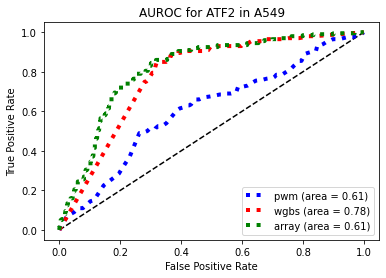

AUROC calculated for ATF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


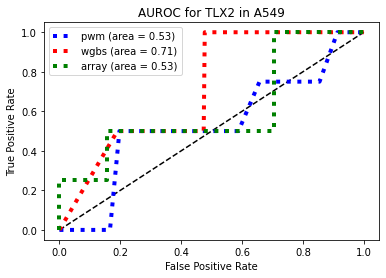

AUROC calculated for TLX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

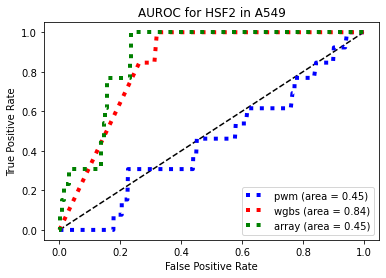

AUROC calculated for HSF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


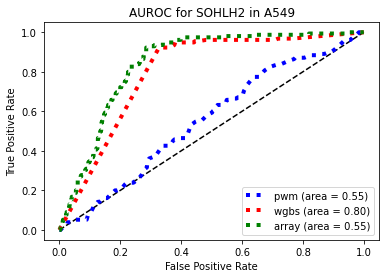

AUROC calculated for SOHLH2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


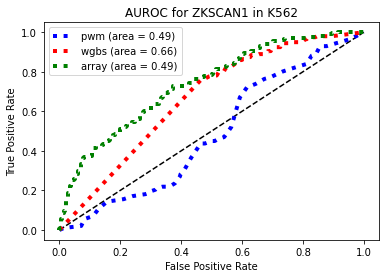

AUROC calculated for ZKSCAN1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


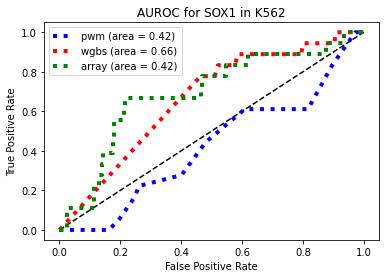

AUROC calculated for SOX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

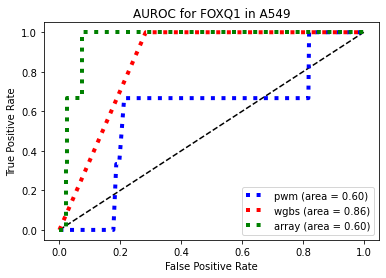

AUROC calculated for FOXQ1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


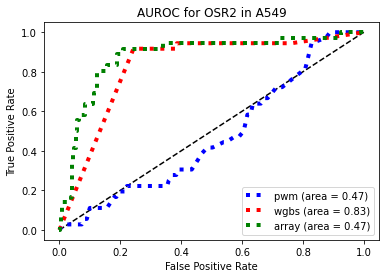

AUROC calculated for OSR2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


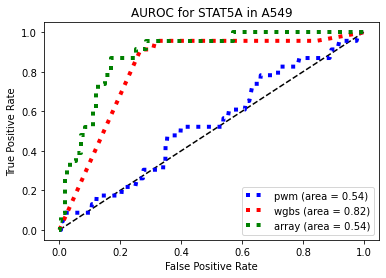

AUROC calculated for STAT5A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


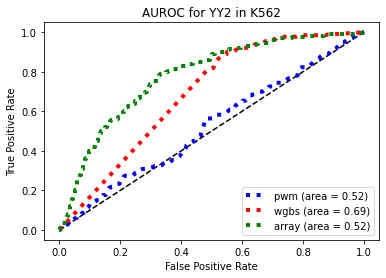

AUROC calculated for YY2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

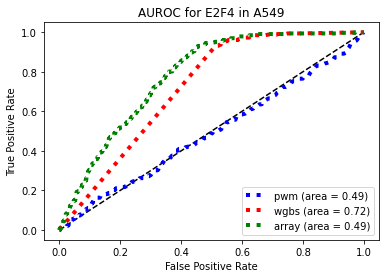

AUROC calculated for E2F4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

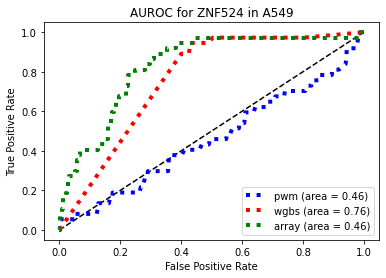

AUROC calculated for ZNF524 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


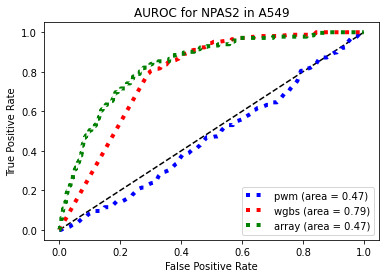

AUROC calculated for NPAS2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


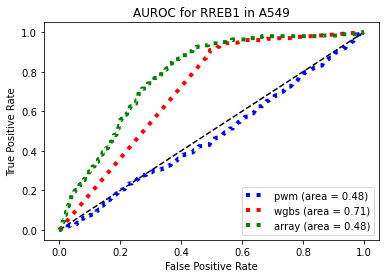

AUROC calculated for RREB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


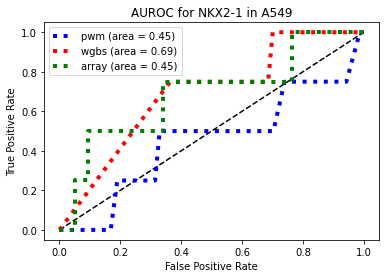

AUROC calculated for NKX2-1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

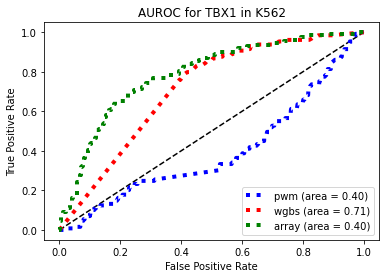

AUROC calculated for TBX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


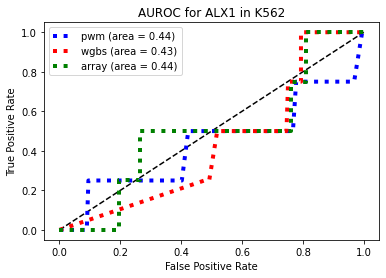

AUROC calculated for ALX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


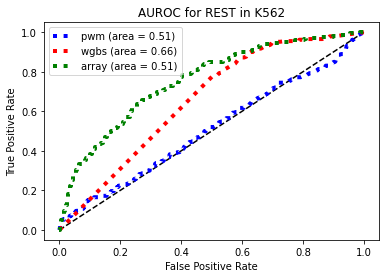

AUROC calculated for REST in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

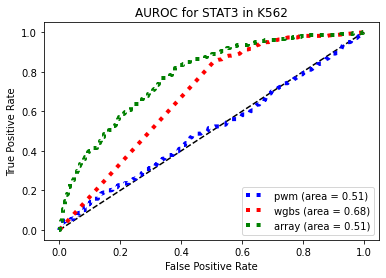

AUROC calculated for STAT3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


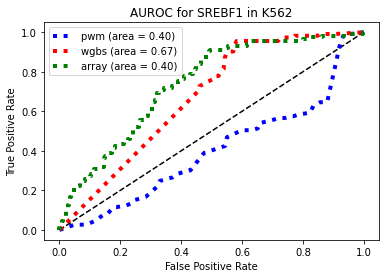

AUROC calculated for SREBF1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


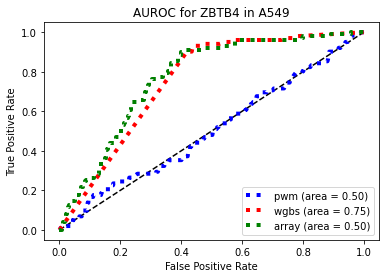

AUROC calculated for ZBTB4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


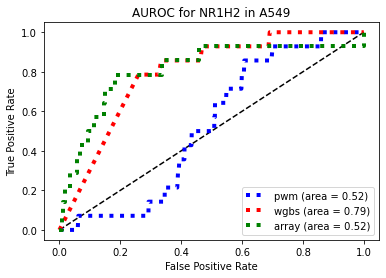

AUROC calculated for NR1H2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


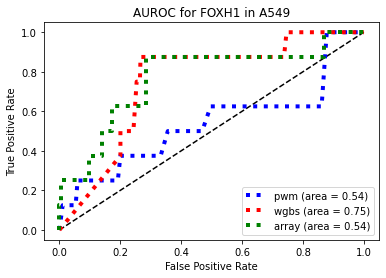

AUROC calculated for FOXH1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


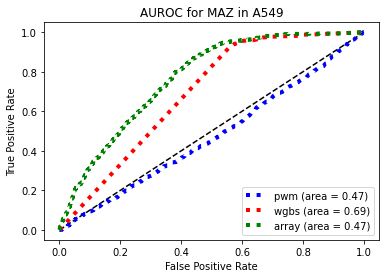

AUROC calculated for MAZ in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


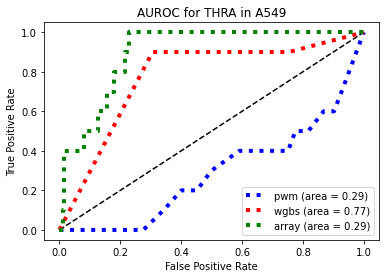

AUROC calculated for THRA in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


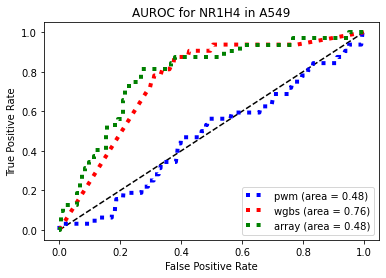

AUROC calculated for NR1H4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


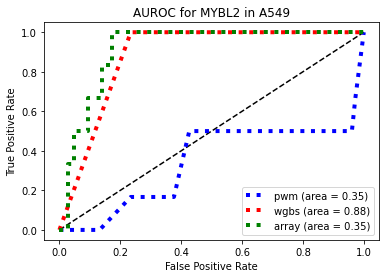

AUROC calculated for MYBL2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

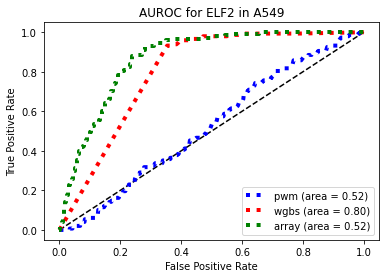

AUROC calculated for ELF2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


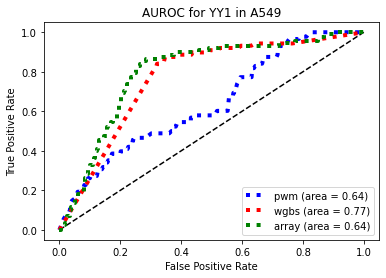

AUROC calculated for YY1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


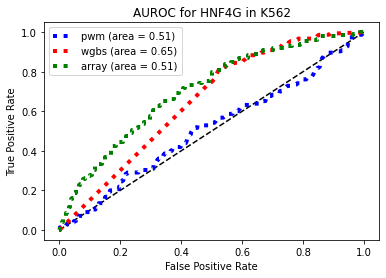

AUROC calculated for HNF4G in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


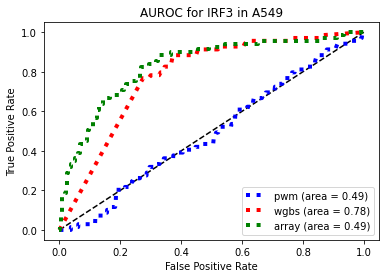

AUROC calculated for IRF3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


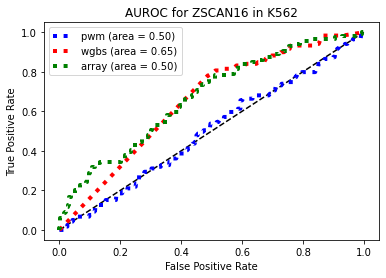

AUROC calculated for ZSCAN16 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

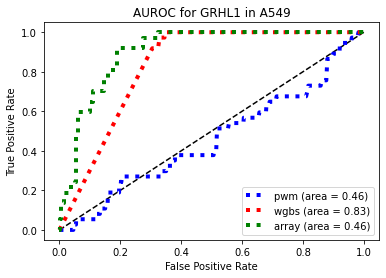

AUROC calculated for GRHL1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


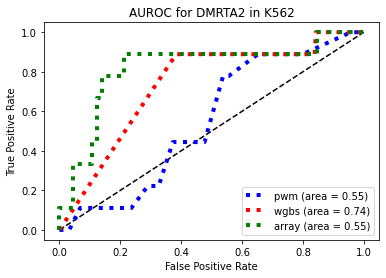

AUROC calculated for DMRTA2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


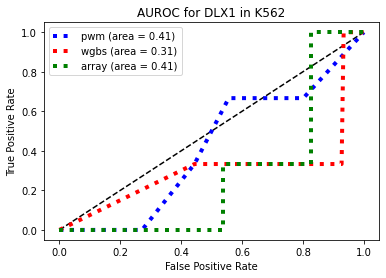

AUROC calculated for DLX1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


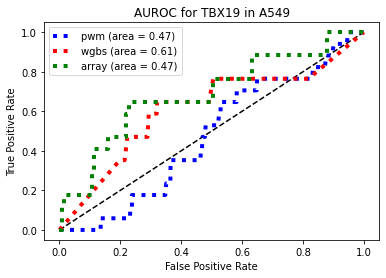

AUROC calculated for TBX19 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


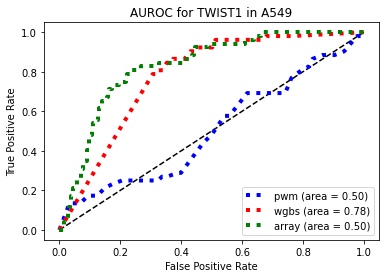

AUROC calculated for TWIST1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


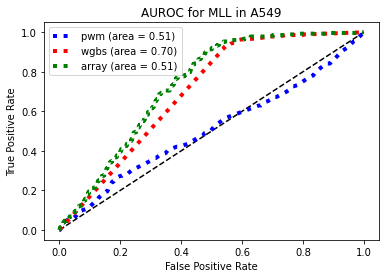

AUROC calculated for MLL in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

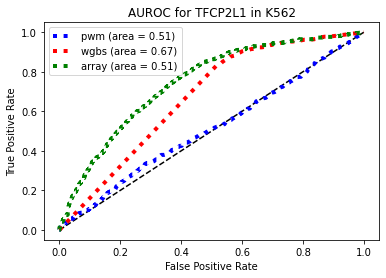

AUROC calculated for TFCP2L1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


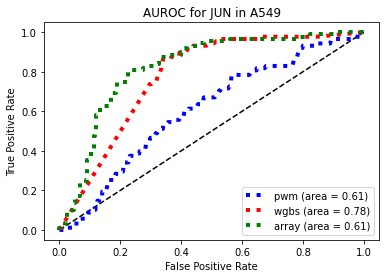

AUROC calculated for JUN in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


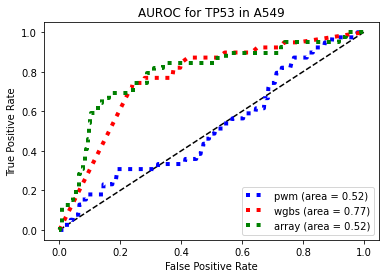

AUROC calculated for TP53 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


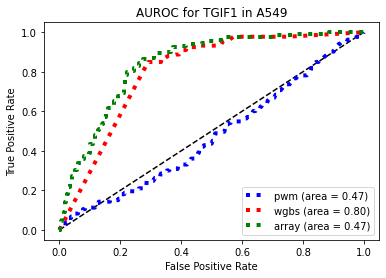

AUROC calculated for TGIF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

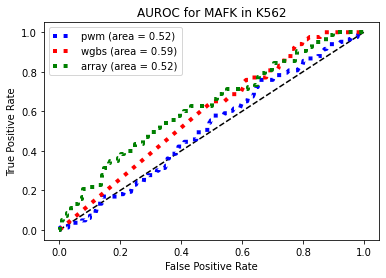

AUROC calculated for MAFK in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

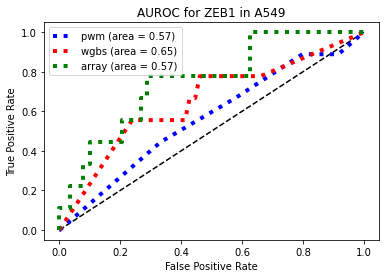

AUROC calculated for ZEB1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


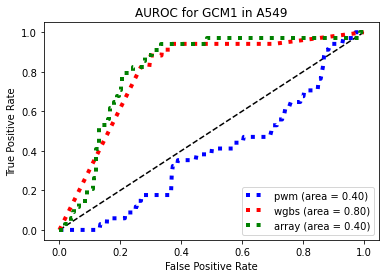

AUROC calculated for GCM1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


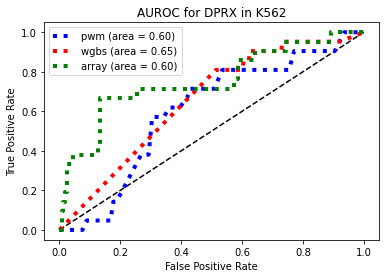

AUROC calculated for DPRX in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


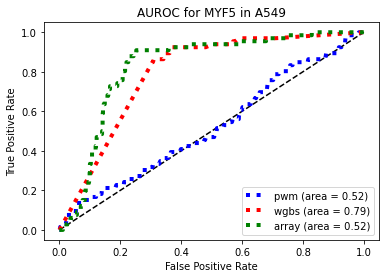

AUROC calculated for MYF5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


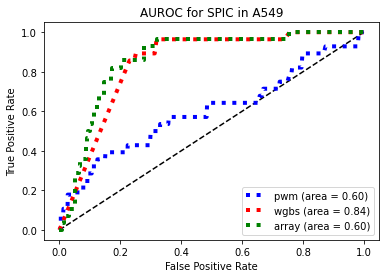

AUROC calculated for SPIC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


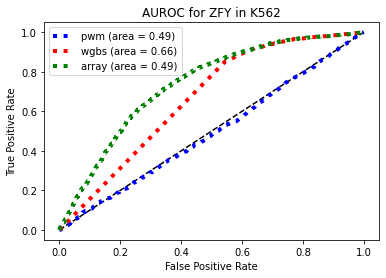

AUROC calculated for ZFY in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


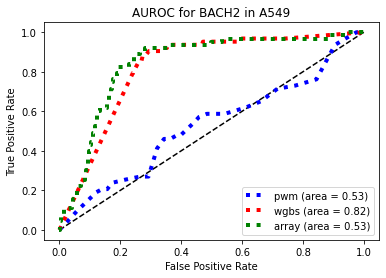

AUROC calculated for BACH2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


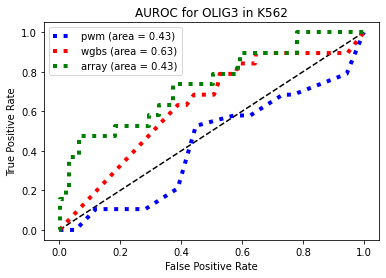

AUROC calculated for OLIG3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


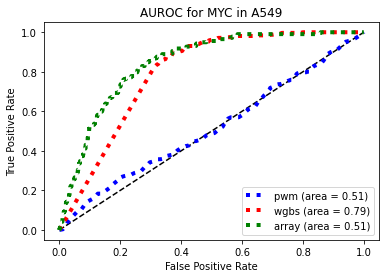

AUROC calculated for MYC in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


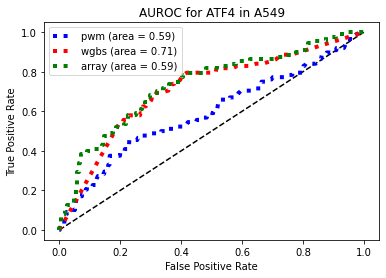

AUROC calculated for ATF4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


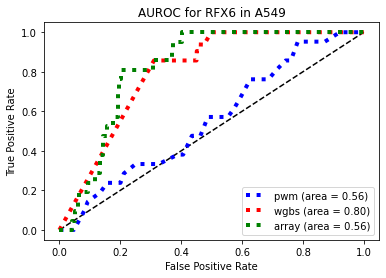

AUROC calculated for RFX6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


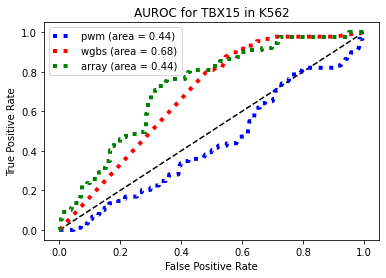

AUROC calculated for TBX15 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


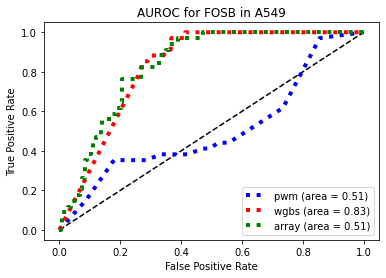

AUROC calculated for FOSB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


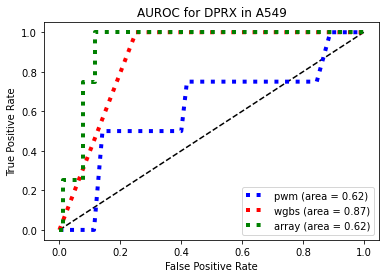

AUROC calculated for DPRX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


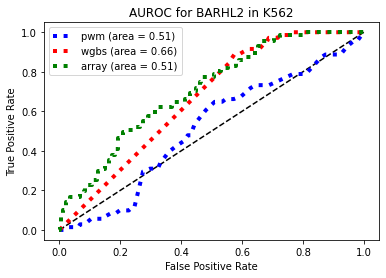

AUROC calculated for BARHL2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


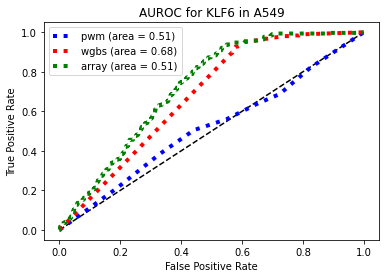

AUROC calculated for KLF6 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


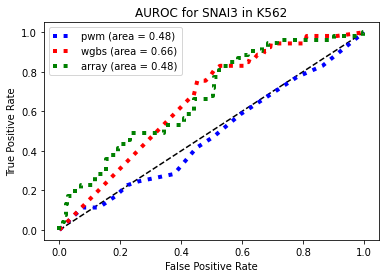

AUROC calculated for SNAI3 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


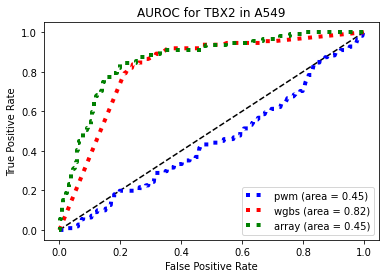

AUROC calculated for TBX2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

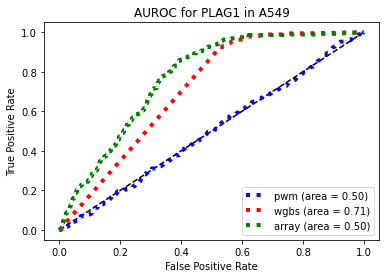

AUROC calculated for PLAG1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


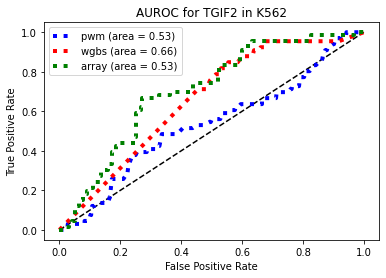

AUROC calculated for TGIF2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


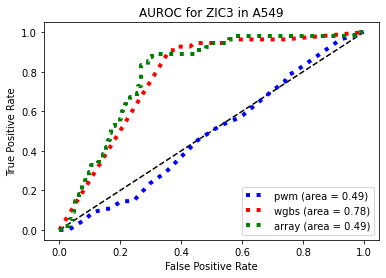

AUROC calculated for ZIC3 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


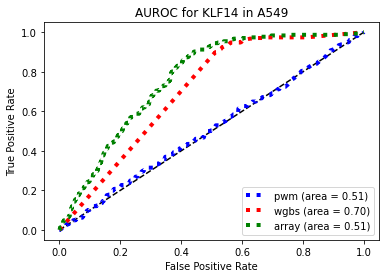

AUROC calculated for KLF14 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

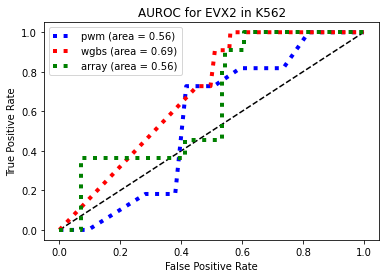

AUROC calculated for EVX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


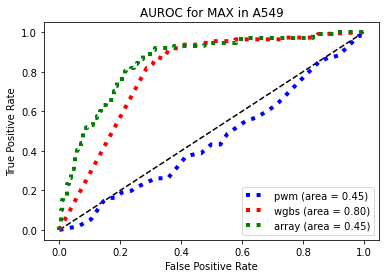

AUROC calculated for MAX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


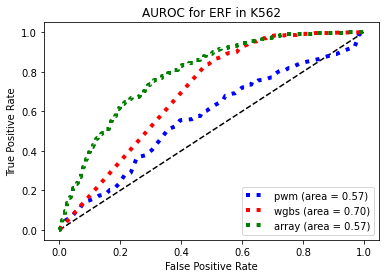

AUROC calculated for ERF in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


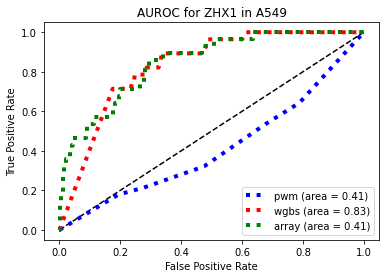

AUROC calculated for ZHX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


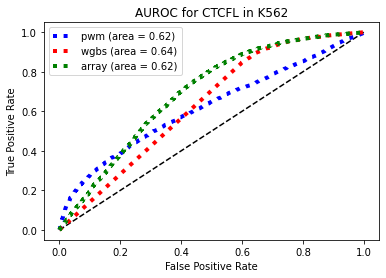

AUROC calculated for CTCFL in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

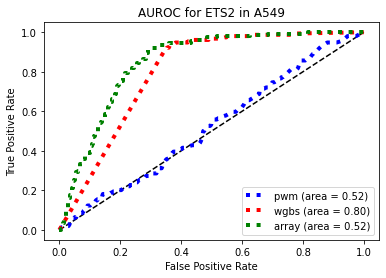

AUROC calculated for ETS2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


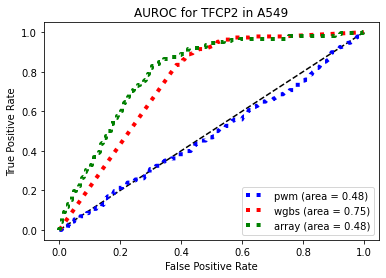

AUROC calculated for TFCP2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


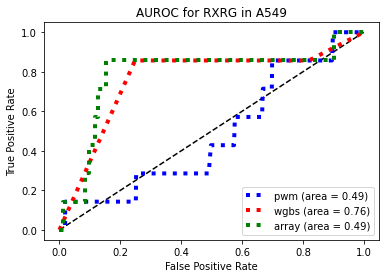

AUROC calculated for RXRG in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


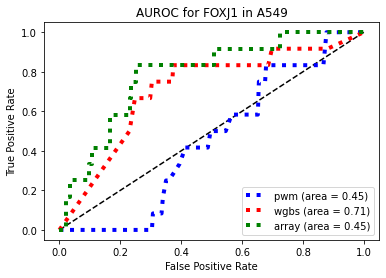

AUROC calculated for FOXJ1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


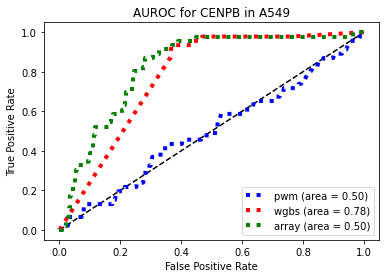

AUROC calculated for CENPB in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

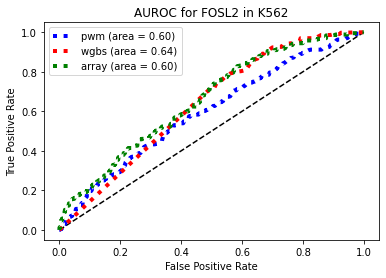

AUROC calculated for FOSL2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


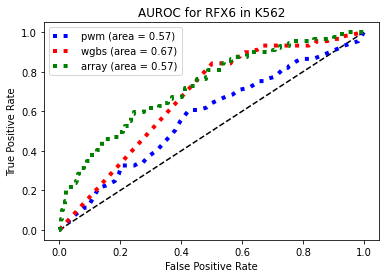

AUROC calculated for RFX6 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


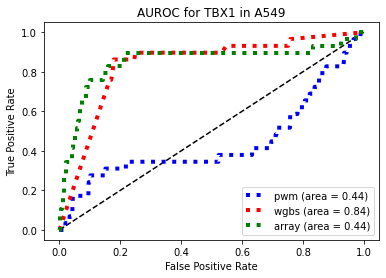

AUROC calculated for TBX1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


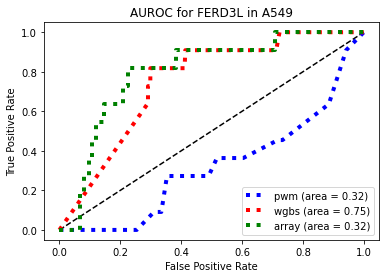

AUROC calculated for FERD3L in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


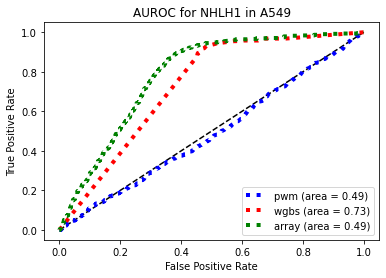

AUROC calculated for NHLH1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

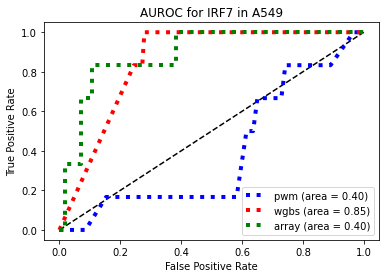

AUROC calculated for IRF7 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


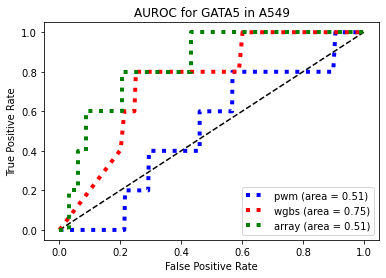

AUROC calculated for GATA5 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


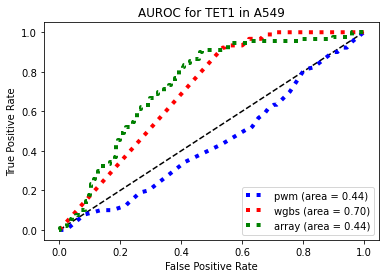

AUROC calculated for TET1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


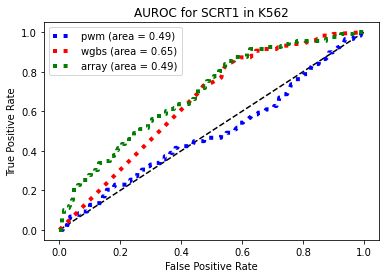

AUROC calculated for SCRT1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


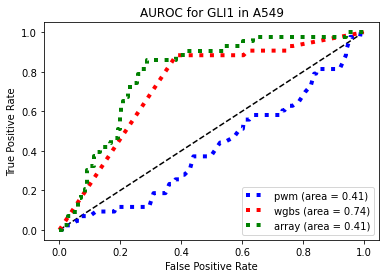

AUROC calculated for GLI1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


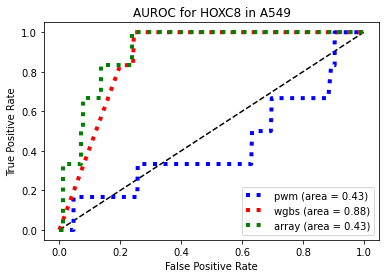

AUROC calculated for HOXC8 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

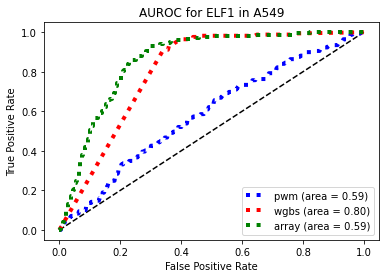

AUROC calculated for ELF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


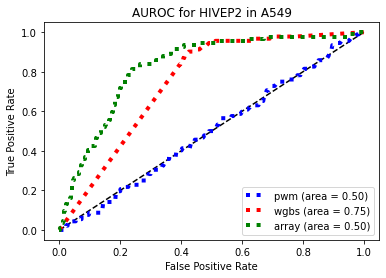

AUROC calculated for HIVEP2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


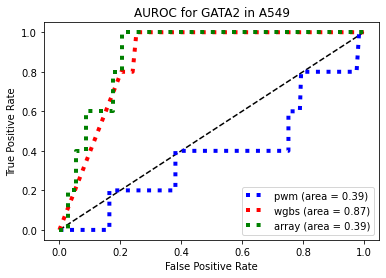

AUROC calculated for GATA2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


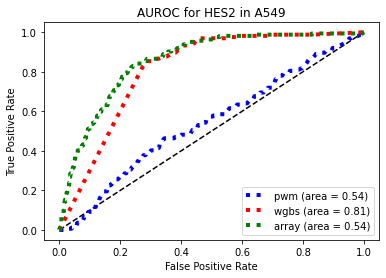

AUROC calculated for HES2 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


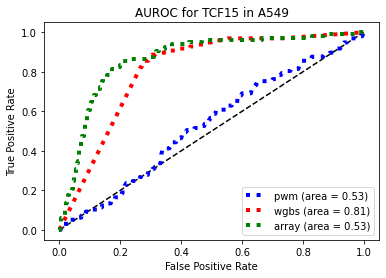

AUROC calculated for TCF15 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


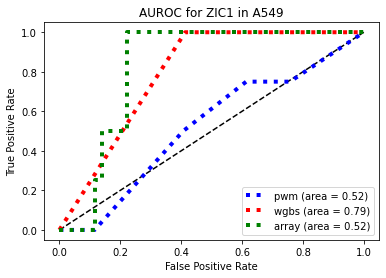

AUROC calculated for ZIC1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

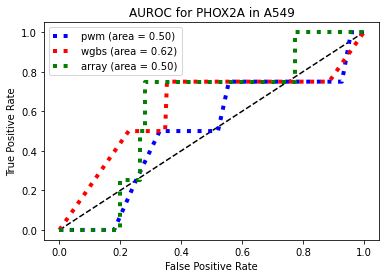

AUROC calculated for PHOX2A in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


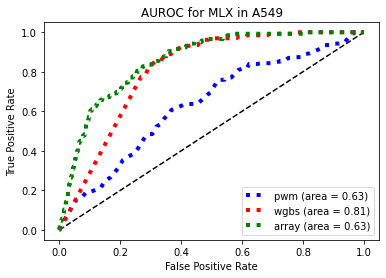

AUROC calculated for MLX in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


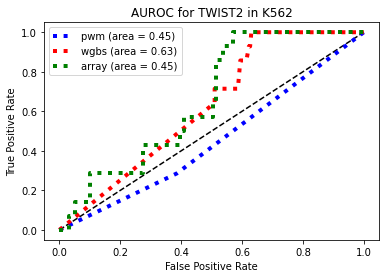

AUROC calculated for TWIST2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


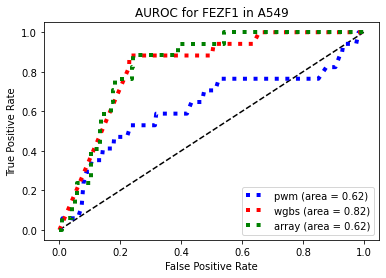

AUROC calculated for FEZF1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


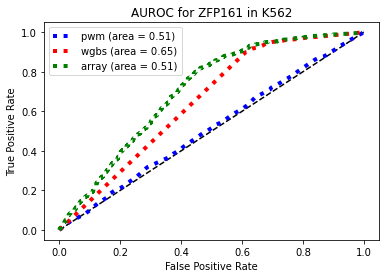

AUROC calculated for ZFP161 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


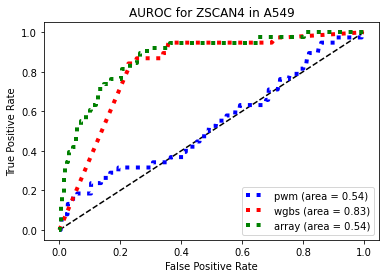

AUROC calculated for ZSCAN4 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


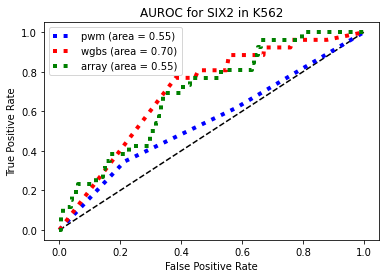

AUROC calculated for SIX2 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


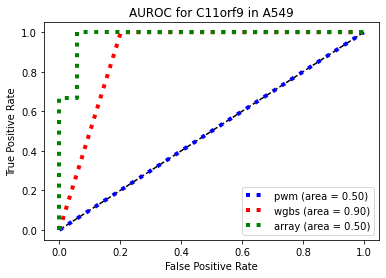

AUROC calculated for C11orf9 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the 

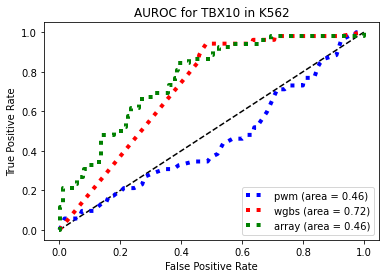

AUROC calculated for TBX10 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


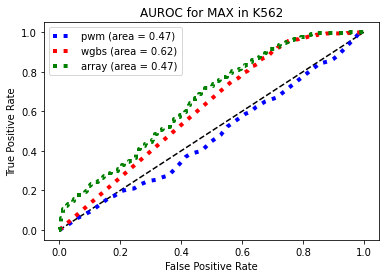

AUROC calculated for MAX in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


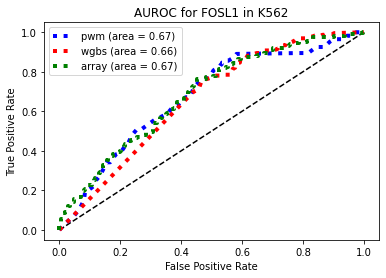

AUROC calculated for FOSL1 in K562


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


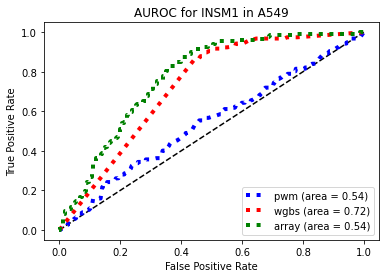

AUROC calculated for INSM1 in A549


/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:68: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return op(a, b)
/udd/redmo/.conda/envs/mypy3/lib/python3.7/site-packages/ipykernel_launcher.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


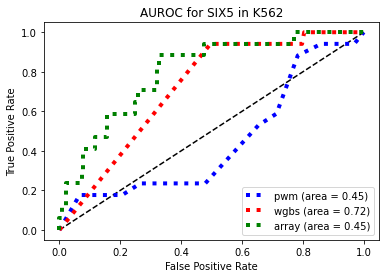

AUROC calculated for SIX5 in K562


In [92]:
plotallll(indir='../../d/tmp/redmo/data/MotifPipeline/cbus_motif_pipeline_gamma0')

# plotallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma0')
# plotallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma5')
# plotallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma10')
# plotallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma20')
# plotallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma50')
# plotallll(indir='../../d/tmp/redmo/data/MotifPipeline/camb_motif_pipeline_gamma100')
# plotallll(indir='../../d/tmp/redmo/data/MotifPipeline/camb_motif_pipeline_gamma250')
# plotallll(indir='../../d/tmp/redmo/data/MotifPipeline/camb_motif_pipeline_gamma500')



In [91]:
def plotallll(indir):
    traces = [log for log in glob.glob(indir+'/*') if not os.path.isdir(log)]
#     os.remove(indir+'/test/camb_PRE_window_methyl.txt')
    indices = [i for i, s in enumerate(traces) if 'txt' not in s]

    aurocs = pd.DataFrame()

    # os.makedirs(indir+'/test')


    # trace=traces[0]
    for i,trace in enumerate(indices):
        trace=traces[i]
    #     plt.subplot(2, 2, 3)
        if 'pc' in trace:
            combo=(trace).split('/')[7]

        elif 'd/tmp' in trace:
            combo=(trace).split('/')[8]
#             combo=trace.split('/')[8] ##change this from 7 to 8 with tmp1 dir from tmp0
        TF=combo.split('_')[1]
        cell=combo.split('_')[0]
    #     data=pd.read_csv(trace,sep='\t',names=['chr','start','end','pwm','CG','ChIPTF','array','location'])
        try:
            data=pd.read_csv(trace,sep='\t',usecols=[0,1,2,3,9,10,11],names=["chr", "start", "end",'pwm',"W1",'array','ChIPTF'])

            Col1=os.path.basename(trace).split('_')[0] #cell
            Col2=os.path.basename(trace).split('_')[1] #TF


            table2=[]
            tbl=[]
            tmpTBL2=[]
            tmpTBL=[]
            table3=[]
            tblC=[]
            tmpTBLC=[]
            data.pwm=(data.pwm-data.pwm.min())/(data.pwm.max()-data.pwm.min())
            data=data.fillna(0)
            data.ChIPTF=data.ChIPTF.replace('.',0)
            # print(data.shape)
            data.ChIPTF[(data.ChIPTF==Col2)]=1
            data=data[(data.ChIPTF==0)|(data.ChIPTF==1)]
            data.ChIPTF=pd.to_numeric(data.ChIPTF)

            if np.sum(data.ChIPTF)>5: # and np.sum(data_nonCG.ChIPTF)>5:

                plt.plot([0, 1], [0, 1], 'k--')
                fpr, tpr, thresholds = metrics.roc_curve(data.ChIPTF, data.pwm)
                roc_auc=metrics.auc(fpr, tpr)
                plt.plot(fpr, tpr,
                         label='pwm (area = {0:0.2f})'
                             ''.format(roc_auc),
                         color='b', linestyle=':', linewidth=4)

                fpr2, tpr2, thresholds = metrics.roc_curve(data.ChIPTF, 1-(data.W1/100))
                roc_auc2=metrics.auc(fpr2, tpr2)
                plt.plot(fpr2, tpr2,
                         label='wgbs (area = {0:0.2f})'
                               ''.format(roc_auc2),
                         color='r', linestyle=':', linewidth=4)

                fpr, tpr, thresholds = metrics.roc_curve(data.ChIPTF, 1-(data.array/100))
                roc_auc3=metrics.auc(fpr, tpr)
                plt.plot(fpr, tpr,
                         label='array (area = {0:0.2f})'
                             ''.format(roc_auc),
                         color='g', linestyle=':', linewidth=4)



                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.title('AUROC for '+TF+' in '+cell)
                plt.legend(loc="best")

                plt.show()

                Col1=cell
                Col2=TF
                Col3=roc_auc #motif auroc
                Col4=roc_auc2
                Col5=roc_auc3
                Col6=data.shape[0]
                column = [Col1, Col2, Col3, Col4,Col5,Col6]
                column=np.transpose(pd.DataFrame((column)))
                column.to_csv(indir+'/test/camb_PRE_window_methyl.txt',mode='a',header=False,index=False)
                aurocs=pd.concat([aurocs,column],axis=0)
                print("AUROC calculated for "+TF+" in "+cell)
        except:
            pass

In [93]:
melt,heat=heatallll(indir='../../d/tmp/redmo/data/MotifPipeline/cbus_motif_pipeline_gamma0')

# melt,heat=heatallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma0')
#     heatallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma5')
#     heatallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma10')
#     heatallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma20')
#     heatallll(indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma50')
#     heatallll(indir='../../d/tmp/redmo/data/MotifPipeline/camb_motif_pipeline_gamma100')
# heatallll(indir='../../d/tmp/redmo/data/MotifPipeline/camb_motif_pipeline_gamma250')
# heatallll(indir='../../d/tmp/redmo/data/MotifPipeline/camb_motif_pipeline_gamma500')

# except:
#     pass

ValueError: Length mismatch: Expected axis has 13 elements, new values have 25 elements

In [16]:
# indir='../../pc/redmo/data/MotifPipeline/camb_motif_pipeline_gamma0'
def heatallll(indir):
    aurocs=pd.read_csv(indir+'/test/camb_PRE_window_methyl.txt',names=['cell','TF','pwm','wgbs','array','counts'])

    aurocs.columns=['cell','TF','pwm','wgbs','array','counts']
    ##sum across cells and sort
    heat=aurocs.pivot_table(index=['TF'], columns='cell',aggfunc='first')# heat=heat[[measure]]
    heat['mean']=np.nanmean(heat,axis=1)
    heat['count']=heat.isnull().sum(axis=1)

    heat['weight']=heat['mean']*(heat['count'])
    heat=heat.sort_values(by=['weight'],ascending=False)

    heat=heat.dropna(axis=1, how='all')
    del heat['count']
    del heat['mean']
    del heat['weight']

    heat=pd.DataFrame(heat.to_records())

    heat.columns=['TF','me-A549','me-GM12878','me-HeLa','me-HepG2','me-K562','me-SKNSH',
                  'counts-A549','counts-GM12878','counts-HeLa','counts-HepG2','counts-K562','counts-SKNSH',
                  'pwm-A549','pwm-GM12878','pwm-HeLa','pwm-HepG2','pwm-K562','pwm-SKNSH',
                'wg-A549','wg-GM12878','wg-HeLa','wg-HepG2','wg-K562','wg-SKNSH']

    heat=heat[['TF','pwm-A549','me-A549','wg-A549',
               'pwm-GM12878','me-GM12878','wg-GM12878',
               'pwm-HeLa', 'me-HeLa','wg-HeLa',
               'pwm-HepG2','me-HepG2','wg-HepG2',
               'pwm-K562','me-K562','wg-K562',
               'pwm-SKNSH','me-SKNSH','wg-SKNSH']]
    heat55=heat
    heat=heat.set_index('TF')

    plt.figure(figsize=(12, 30))
    rdgn = plt.get_cmap("RdBu")
    rdgn.set_bad(color='black', alpha=0.15)
    # rdgn.set_bad(color='red')
    ax = sns.heatmap(heat,linewidth=.1,cmap=rdgn, cbar=False,mask=heat.isnull(),yticklabels=True)#cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
    #cbar_ax=cbar_ax,cbar_kws={"orientation": "horizontal"})
    mappable = ax.get_children()[0]
    plt.colorbar(mappable, ax = [ax],orientation = 'horizontal',pad=.04) #.02 with 12x60, .03 for 12x40

    plt.xticks(rotation=30)

    plt.savefig(indir+"/test/camb_auroc_heat.png",dpi=300,bbox_inches = "tight")
    plt.show

    print([(heat55['pwm-A549'].dropna().shape),(heat55['pwm-GM12878'].dropna().shape),(heat55['pwm-HeLa'].dropna().shape),(heat55['pwm-HepG2'].dropna().shape),(heat55['pwm-K562'].dropna().shape),(heat55['pwm-SKNSH'].dropna().shape)])

    box=heat55
    # box.columns=['TF','A549','GM12878','H1','HeLa','HepG2','K562','SKNSH']
    meltbox=pd.melt(box,id_vars=['TF'])
    # del box.TF
    # if measure=='auroc':
    meltbox.columns=['TF','data - cell line','AUROC']
    plt.figure(figsize=(12, 5))
    plt.xticks(rotation=30)
    g=sns.boxplot(x='data - cell line',y='AUROC', data=meltbox)
    g=sns.swarmplot(x='data - cell line',y='AUROC', data=meltbox,
                  size=2, color=".3", linewidth=0)

    g.set(ylim=(0, 1))
    plt.savefig(indir+"/test/camb_auroc_box.png",dpi=300,bbox_inches = "tight")
    # meltbox.to_csv(outdir+measure+"meltbox.txt")

    plt.show

    sns.despine(trim=True, left=True)
    # plt.show()


    t0a, p0a = stats.ttest_ind(box['pwm-A549'].dropna(),box['wg-A549'].dropna())
    t0b, p0b = stats.ttest_ind(box['pwm-A549'].dropna(),box['me-A549'].dropna())
    t1a, p1a = stats.ttest_ind(box['pwm-GM12878'].dropna(),box['wg-GM12878'].dropna())
    t1b, p1b = stats.ttest_ind(box['pwm-GM12878'].dropna(),box['me-GM12878'].dropna())
    t2a, p2a = stats.ttest_ind(box['pwm-HeLa'].dropna(),box['wg-HeLa'].dropna())
    t2b, p2b = stats.ttest_ind(box['pwm-HeLa'].dropna(),box['me-HeLa'].dropna())
    t3a, p3a = stats.ttest_ind(box['pwm-HepG2'].dropna(),box['wg-HepG2'].dropna())
    t3b, p3b = stats.ttest_ind(box['pwm-HepG2'].dropna(),box['me-HepG2'].dropna())
    t4a, p4a = stats.ttest_ind(box['pwm-K562'].dropna(),box['wg-K562'].dropna())
    t4b, p4b = stats.ttest_ind(box['pwm-K562'].dropna(),box['me-K562'].dropna())
    t5a, p5a = stats.ttest_ind(box['pwm-SKNSH'].dropna(),box['wg-SKNSH'].dropna())
    t5b, p5b = stats.ttest_ind(box['pwm-SKNSH'].dropna(),box['me-SKNSH'].dropna())


    # initialise data of lists. 
    ttest = {'WG ttest':[t0a,t1a,t2a,t3a,t4a,t5a], 'WG pvalue':[p0a,p1a,p2a,p3a,p4a,p5a], 'Me ttest':[t0b,t1b,t2b,t3b,t4b,t5b],'Me pvalue':[p0b,p1b,p2b,p3b,p4b,p5b]} 

    # Creates pandas DataFrame. 
    df_ttest = pd.DataFrame(ttest, index =['A549','GM12878', 'HeLa', 'HepG2', 'K562','SKNSH']) 

    df_ttest.to_csv(indir+"/test/camb_auroc_ttest.txt")
    meltbox.to_csv(indir+"/test/camb_auroc_meltbox.txt",sep='\t')
    return meltbox,heat